# ***Temporal-RISE***

## Introduction
This notebook presents the implementation of the **Temporal-RISE** method, an extension of the Randomized Input Sampling for Explanation (RISE) algorithm, specifically adapted to handle temporal data in the context of hydrological forecasting.

The goal of **Temporal-RISE** is to generate saliency maps for machine learning models that predict groundwater levels based on temporal sequences of meteorological data. Unlike the original RISE method, which was primarily designed for static image data, **Temporal-RISE** focuses on identifying which time steps (weeks) contribute the most to the model's predictions by perturbing input sequences over time.

### Objectives
- **Temporal Saliency Map Generation**: Highlight the most critical time steps in the input sequences that influence the model's predictions.
- **Gaussian Noise Application**: Apply temporal Gaussian noise to the time-series data, perturbing individual weeks to assess their impact.
- **Model Explanation**: Provide interpretable insights into how the model uses temporal information to predict groundwater levels.
- **Evaluation Metrics (Insertion/Deletion)**: Evaluate the quality of the temporal saliency maps using **Insertion** and **Deletion** metrics. These metrics measure how inserting or removing key temporal segments affects the model's performance.

This notebook will guide through the key steps of the **Temporal-RISE** implementation, including:
1. Preparation and loading of time-series meteorological data.
2. Application of temporal Gaussian noise to perturb individual time steps.
3. Generation of temporal saliency vectors based on the model's response to these perturbations.
4. **Evaluation** of the temporal saliency vectors using **Insertion** and **Deletion** metrics.
5. Visualization of the resulting saliency vectors.

The code and methods in this notebook are directly tied to the thesis work on applying **XAI techniques** for hydrological prediction models, with a focus on understanding temporal dependencies in the model’s decision-making process.


In [ ]:
# Dependencies

# Specify the TensorFlow version used
# TensorFlow 2.15.0 is chosen for compatibility with Keras and other dependencies.
!pip install tensorflow==2.15.0  # cuDNN 8.9, CUDA 12.2
!pip install keras==2.15.0  # Keras for high-level neural networks
# General libraries for data manipulation and numerical computations
!pip install numpy==1.25.2  # Fundamental package for numerical computing
!pip install pandas==2.0.3  # Data manipulation and analysis
# Libraries for handling spatial and raster data
!pip install rioxarray==0.15.5  # Raster I/O with xarray
!pip install rasterio==1.3.10  # Reading and writing raster datasets
!pip install geopandas==0.13.2  # Geospatial data manipulation
# Libraries for data visualization
!pip install matplotlib==3.7.1  # Comprehensive library for static, animated, and interactive visualizations
!pip install seaborn==0.13.1  # Statistical data visualization based on Matplotlib
!pip install matplotlib_scalebar==0.8.1  # Adds a scale bar to Matplotlib plots
!pip install adjustText==1.1.1  # Helps adjust text in Matplotlib for better readability
# Libraries for scientific computing and handling NetCDF data
!pip install xarray==2023.7.0  # N-D array support with labeled axes
!pip install netCDF4==1.6.5  # Reading and writing NetCDF files
!pip install cftime==1.6.3  # Provides time handling capabilities
# Other useful libraries
!pip install imageio==2.31.6  # For reading and writing image data
!pip install cmasher==1.8.0  # Colormaps for Matplotlib
!pip install great-circle-calculator==1.3.1  # Calculate great circle distances between points
!pip install geopy==2.4.1  # For geocoding and distance calculations
!pip install scipy==1.11.4  # Scientific and technical computing


In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import activations
import sys
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.models import load_model
from keras import activations
import numpy as np
import copy

In [2]:
# Mount Google Drive
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive

Mounted at /gdrive
/gdrive


#### ***Loading Data from Google Drive***

In [3]:
#### ***Loading Data from Google Drive***

# Define the base path for data storage in Google Drive
# Change the base_path to point to the correct directory where your data is stored
base_path = "./MyDrive/Water_Resources/"

# Specify different subdirectories for various data and model types
data_path = base_path + "data/training_validation_test_splits"  # Path for training, validation, and test data
model_path = base_path + "trained_models/"  # Path for trained models
modules_path = base_path + "python_modules/"  # Path for additional Python modules
xai_path = base_path + "XAI/"  # Path for XAI-related resources
results_path = xai_path + "results/"  # Path for storing results from XAI analysis

In [4]:
# IMPORT DATA FOR VOTTIGNASCO

# Paths to the .npy files containing the data for Vottignasco
v_test_OHE_path = data_path + '/Vottignasco_00425010001_test_month_OHE.npy'  # One-Hot Encoded test data
v_test_image_path = data_path + '/Vottignasco_00425010001_test_normalized_image_sequences.npy'  # Normalized image sequences for testing
v_test_target_dates_path = data_path + '/Vottignasco_00425010001_test_target_dates.npy'  # Target dates for the test data

# Load the NumPy arrays from the specified .npy files
vottingasco_test_OHE = np.load(v_test_OHE_path)  # Load One-Hot Encoded data
vottignasco_test_image = np.load(v_test_image_path)  # Load normalized image sequences
vottignasco_test_dates = np.load(v_test_target_dates_path)  # Load target dates for the test set


In [5]:
print(len(vottignasco_test_dates))
print(len(vottignasco_test_image))
print(len(vottingasco_test_OHE))

105
105
105


In [6]:
# Visualize the data for Vottignasco

# Display the One-Hot Encoded representation of the first instance in the test set
print(vottingasco_test_OHE[0], "\n")  # One-Hot Encoding of seasons for the first test instance

# Display the normalized image of the first instance in the test set
print(vottignasco_test_image[0][0], "\n")  # Normalized image sequence for the first test instance


[[1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] 

[[[-0.55874205 -0.63231546 -1.0530392 ]
  [-0.62497324 -0.24734885 -0.95617104]
  [-0.64852315 -0.29456472 -1.0120971 ]
  [-0.6475669   0.01120646 -0.9414161 ]
  [-0.6483382   0.04486901 -0.9291374 ]
  [-0.64837635  0.21673024 -0.7445328 ]
  [-0.6482272   0.01929929 -0.9028175 ]
  [-0.64826417 -0.35680774 -0.71746933]]

 [[-0.56017417 -0.30140942 -1.0722721 ]
  [-0.6341238  -0.3249078  -1.1285268 ]
  [-0.64822614 -0.2947506  -0.9674306 ]
  [-0.6474924   0.08621608 -0.8394658 ]
  [-0.6481902   0.17821798 -0.8374907 ]
  [-0.64775074  0.14878109 -0.8802751 ]
  [-0.6477138   0.09261598 -1.0055645 ]
  [-0.64804226  0.06027458 -1.1226149 ]]

 [[-0.64782256 -0.32245472 -1.1192324 ]
  [-0.64856017 -0.17655824 -0.96336424]
  [-0.64591223 -0.43483806 -1.0460285 ]
  [-0.6466841   0.08755382 -0.7752676 ]
  [-0.6481902   0.13593481 -0.814374  

#### ***Models Loading***

In [ ]:
from keras.models import load_model

# If you want to load the entire model, dropout_custom layer has to be defined:

mc_dropout = True

# Definizione della classe personalizzata doprout_custom
class doprout_custom(tf.keras.layers.SpatialDropout1D):
    def call(self, inputs, training=None):
        if mc_dropout:
            return super().call(inputs, training=True)
        else:
            return super().call(inputs, training=False)

In [ ]:
# Find the paths of the ensemble models for Vottignasco in Google Drive
import os

# Define the base directory for the Vottignasco models
base_dir = model_path + "seq2val/Vottignasco"  # Directory containing the models
lstm_suffix = 'time_dist_LSTM'  # Suffix used to identify LSTM model files

# Initialize lists to store model and weight paths
vott_lstm_models = []  # List to store paths of LSTM models
vott_lstm_weights = []  # List to store paths of model weights

def extract_index(filename):
    """Function to extract the final index from the filename."""
    return int(filename.split('_')[-1].split('.')[0])  # Extracts the numeric index from the filename

# Traverse the directory and add relevant files to their respective lists
for root, _, files in os.walk(base_dir):
    for filename in files:
        full_path = os.path.join(root, filename)  # Get the full path of the file
        if lstm_suffix in filename:  # Check if the file is an LSTM model
            if filename.endswith(".keras"):  # Check for model files
                vott_lstm_models.append(full_path)  # Add model path to the list
            else:  # Otherwise, it's a weights file
                vott_lstm_weights.append(full_path)  # Add weights path to the list

# Sort the model and weight paths based on the extracted index from the filenames
vott_lstm_models = sorted(vott_lstm_models, key=lambda x: extract_index(os.path.basename(x)))  # Sort models
vott_lstm_weights = sorted(vott_lstm_weights, key=lambda x: extract_index(os.path.basename(x)))  # Sort weights


In [ ]:
# List of paths for the loaded models and weights
vott_lstm_models_loaded = []  # List to store the loaded Vottignasco LSTM models
racc_lstm_models_loaded = []  # (Assuming this will be used later for another set of models)

# Loop to load the LSTM models
for i in range(10):
    print(f"Loading LSTM models {i+1}")  # Indicate the loading progress of LSTM models

    # Load VOTTIGNASCO model
    model_lstm_path = vott_lstm_models[i]  # Get the path for the current LSTM model
    # Load the CNN+LSTM model using the specified path
    model = load_model(model_lstm_path, custom_objects={"doprout_custom": doprout_custom})  # Load the model with custom objects
    # Append the loaded model to the list of loaded models
    vott_lstm_models_loaded.append(model)  # Add the loaded model to the list


In [ ]:
vott_lstm_models_loaded

## ***TEMPORAL RISE***

### ***Generate Masks: Gaussian-Noise 1D***

In the temporal case, the idea is to create one-dimensional masks of length T (104), where the Gaussian noise is centered on a given time step and spreads across the other time steps, decaying in the more distant ones. The formula used is that of a one-dimensional Gaussian distribution.


In [ ]:
import numpy as np
from tqdm import tqdm
import random

# Example function to generate a one-dimensional Gaussian perturbation
def gaussian_perturbation(input_size, sigma, beta):
    x = np.arange(input_size)
    x_p = np.random.randint(0, input_size)

    perturbation = beta * np.exp(-0.5 * ((x - x_p)**2 / sigma**2))
    return perturbation

# Generates N Gaussian masks
def generate_masks_gaussian(N, input_size, sigma):
    masks = np.empty((N, input_size))

    for i in tqdm(range(N), desc='Generating masks'):
        beta = random.choice([-1, 1])  # Multiplicative factor for the perturbation (can be 1 or -1) -> +1 for positive masks, -1 for negative masks.
        perturbation = gaussian_perturbation(input_size, sigma, beta)
        masks[i] = perturbation

    return masks


In [ ]:
# Function to apply additive Gaussian noise to a specific feature channel across a temporal sequence of images
def temporal_additive_GaussianNoise_oneChannel(images, masks, index_feat_to_perturb):
    masked = []

    # Iterate over each mask
    for mask in masks:
        masked_images = images.copy()  # Make a copy of the original images

        # Iterate over each image in the sequence
        for index_img, image in enumerate(images):
            # Iterate over each row of the feature to perturb
            for index_row, row in enumerate(image[:, :, index_feat_to_perturb]):
                # Iterate over each column in the row
                for index_col, col in enumerate(row):
                    # Add the corresponding mask value to the feature channel at the given position
                    masked_images[index_img][index_row, index_col, index_feat_to_perturb] = col + mask[index_img]

        masked.append(masked_images)  # Add the perturbed image sequence to the list

    return masked


### ***RISE***

In [ ]:
def ensemble_predict(models, images, x3_exp):
    # Check the type of images; if it's a list, get the length for the ensemble
    if type(images) == list:
        len_x3 = len(images)  # Number of masked images
    else:
        len_x3 = 1  # Only one image provided
        images = np.expand_dims(images, axis=0)  # Expand dimensions to match expected input shape

    # Prepare the input for the ensemble model
    Y_test = np.stack(images)  # Stack images into a NumPy array
    Y_test_x3 = np.tile(x3_exp, (len_x3, 1, 1))  # Duplicate x3_exp for each image

    # Initialize a list to collect predictions from each model
    all_preds = []

    # Iterate through the models and gather predictions
    for model in models:  # Use the models passed as a parameter
        preds = model.predict([Y_test, Y_test_x3], verbose=0)  # Make predictions
        all_preds.append(preds)  # Store predictions

    # Convert the list of predictions into a NumPy array for easier mean calculation
    all_preds_array = np.array(all_preds)

    # Calculate the mean predictions across all models (along axis 0)
    mean_preds = np.mean(all_preds_array, axis=0)

    return mean_preds  # Return the mean predictions

In [ ]:
def calculate_saliency_map(weights_array, masks):
    """
    Calculates the average saliency map given a series of predictions and masks.

    :param weights_array: Array of predictions (number of masks x prediction dimensions).
    :param masks: Array of masks (number of masks x mask dimensions).
    :return: Average saliency map.
    """
    sal = []
    # Iterate through the masks and compute the weighted saliency
    for j in range(len(masks)):
        sal_i = weights_array[j] * np.abs(masks[j])
        sal.append(sal_i)

    # Calculate the expected value of the masks (mean absolute value)
    ev_masks = np.mean(np.abs(masks), axis=0)
    # Normalize the saliency map by dividing by the expected value of the masks
    sal = (1/ev_masks) * np.mean(sal, axis=0)  # adding the fraction 1/expected_value(masks)
    return sal


In [ ]:
def explain(models, x1, x3, generate_masks_func, apply_mask_func,
            index_feat_to_perturb=None, N=1000, sigma=10.0, input_size=104):
    """
    RISE implementation

    :param models: List of pre-trained models.
    :param x1: Input images.
    :param x3: One-hot encoding input.
    :param generate_masks_func: Function to generate masks.
    :param apply_mask_func: Function to apply masks to images.
    :param index_feat_to_perturb: Indices of features to perturb.
    :param N: Maximum number of masks.
    :param sigma: Sigma value for mask generation.
    :param input_size: Input size.
    :return: Final saliency map.
    """

    # Original prediction without masks
    pred_original = ensemble_predict(models, x1, x3)  # Average ensemble prediction
    #print("original pred:", pred_original)

    # Generate and apply Gaussian masks (1D)
    masks = generate_masks_func(N, input_size, sigma)
    masked_images = apply_mask_func(x1, masks, index_feat_to_perturb)

    # Predictions on the perturbed images with the ensemble
    preds_masked = ensemble_predict(models, masked_images, x3)
    #print("pred_masked:", preds_masked)

    # Calculate the difference between original and masked predictions
    diff_pred = [abs(pred_original - pred_masked) for pred_masked in preds_masked]
    #print("diff_pred:", diff_pred)

    # Concatenate the prediction differences into a single array
    weights_array = np.concatenate(diff_pred, axis=0)

    # Calculate the saliency map
    sal = calculate_saliency_map(weights_array, masks)

    # The final saliency map is stored in `sal`
    print("Processo completato.", "\n")
    print("Mappa di salienza finale:")
    print(sal)
    return sal


### ***Evaluation: Insertion/Deletion***

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

def calculate_auc(x, y):
    """
    Calculates the area under the curve (AUC) using the trapezoidal method.

    :param x: Values on the x-axis (fraction of pixels/frames inserted).
    :param y: Values on the y-axis (calculated errors).
    :return: Area under the curve.
    """
    return np.trapz(y, x)

#### ***Insertion***

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

def update_image_with_important_frame(image, initial_image, frame):
    """
    Updates the image by inserting the most important pixels.

    :param image: Current image.
    :param initial_image: Original image.
    :param frame: Frame number to insert into the image.
    :return: Updated image.
    """
    new_image = image.copy()
    new_image[frame] =+ initial_image[frame]
    return new_image


def insertion(models, original_images, x3, important_indices, initial_blurred_images):
    """
    Calculates the insertion metric for a given explanation.

    :param models: List of pre-trained models.
    :param original_images: Original image.
    :param x3: One-hot encoding for prediction.
    :param important_indices: Indices of the pixels in order of importance.
    :param initial_blurred_images: Initial image with all pixels set to zero.
    :return: List of errors at each insertion step.
    """

    # Original prediction
    original_prediction = ensemble_predict(models, original_images, x3)[0]
    print("Original prediction:", original_prediction)

    # List to store the images where frames are gradually inserted
    insertion_images = [initial_blurred_images]

    # Prediction on the initial image (all pixels set to zero)
    I_prime = initial_blurred_images.copy()

    # Gradually add the most important frames. Create a list with images updated step by step.
    for frame in important_indices:
        #print(frame)
        I_prime = update_image_with_important_frame(I_prime, original_images, frame)
        insertion_images.append(I_prime)

    # Compute predictions on images with gradually inserted frames
    new_predictions = ensemble_predict(models, insertion_images, x3)

    # For each prediction, calculate the MSE relative to the original instance prediction
    errors = [mean_squared_error(original_prediction, masked_pred) for masked_pred in new_predictions[1:]]

    # MSE for the initial image with all blurred frames
    initial_error = mean_squared_error(original_prediction, new_predictions[0])
    print(f"Initial Prediction with ALL Blurred Frame, pred: {new_predictions[0]}, error: {initial_error}")

    only_inserted_frame_new_predictions = new_predictions[1:]
    for t, error in enumerate(errors):
      print(f"Frame {important_indices[t]}, new prediction: {only_inserted_frame_new_predictions[t]}, error: {error}")

    total_errors = [initial_error] + errors

    # Normalize the fraction of pixels inserted
    x = np.linspace(0, 1, len(total_errors))
    print("len total errors: ", len(total_errors))

    # Calculate the AUC
    auc = calculate_auc(x, total_errors)
    print(f"Area under the curve (AUC): {auc}")

    # Plot the error curve and area under the curve (AUC)
    plt.plot(x, total_errors, label='Error curve')
    plt.fill_between(x, total_errors, color='skyblue', alpha=0.4)
    plt.text(x[-1] * 0.95, max(total_errors) * 0.9, f'AUC: {auc:.2f}',
         horizontalalignment='right')  # Text on the right
    plt.xlabel('Fraction of pixels inserted')
    plt.ylabel('Mean Squared Error')
    plt.title('Insertion Metric Curve')
    plt.legend()
    plt.show()

    return total_errors, auc


In [ ]:
def get_errors_from_insertion(test_image, test_OHE, nr_instance, important_indices, initial_blurred_images, models):
  original_images = test_image[nr_instance].copy()
  print(important_indices, "\n")
  x3 = test_OHE[nr_instance].copy()

  errors = insertion(models, original_images, x3, important_indices, initial_blurred_images)

  return errors

#### ***Deletion***

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error

def update_image_by_removing_frame(image, important_indices, frame):
    """
    Updates the image by removing the most important pixels.

    :param image: Current image.
    :param important_indices: Indices of important pixels.
    :param frame: Frame number to remove.
    :return: Updated image.
    """
    new_image = image.copy()
    new_image[frame] = np.zeros((5, 8, 3))  # Set the specified frame to zeros
    return new_image

def deletion(models, original_images, x3, important_indices):
    """
    Calculates the deletion metric for a given explanation.

    :param models: List of pre-trained models.
    :param original_images: Original image.
    :param x3: One-hot encoding for prediction.
    :param important_indices: Indices of pixels in order of importance.
    :return: List of errors at each deletion step.
    """
    # Original prediction
    original_prediction = ensemble_predict(models, original_images, x3).flatten()
    print("Original prediction:", original_prediction)

    # List to store images where frames are gradually removed
    deletions_images = []

    # Initialization
    I_prime = original_images.copy()

    # Gradually remove the most important frames
    for frame in important_indices:
        I_prime = update_image_by_removing_frame(I_prime, important_indices, frame)
        deletions_images.append(I_prime)

    # Compute predictions on all images with gradually removed frames
    new_predictions = ensemble_predict(models, deletions_images, x3)

    # Calculate the MSE with respect to the original prediction
    errors = [mean_squared_error(original_prediction, masked_pred) for masked_pred in new_predictions]

    initial_error = 0.0  # No error since we start with the original images
    print(f"Initial Prediction with Original Images, prediction: {original_prediction}, error: {initial_error}")
    for t, error in enumerate(errors):
        print(f"Removed frame {important_indices[t]}, new prediction: {new_predictions[t]}, error: {error}")

    total_errors = [initial_error] + errors  # Initial error + errors for all removed pixels

    # Normalize the fraction of pixels removed
    x = np.arange(len(total_errors)) / len(total_errors)

    # Calculate the AUC
    auc = calculate_auc(x, total_errors)
    print(f"Area under the curve (AUC): {auc}")

    # Plot the error curve and area under the curve (AUC)
    plt.plot(x, total_errors, label='Error curve')
    plt.fill_between(x, total_errors, color='lightcoral', alpha=0.4)
    # Position the AUC text to the right of the title
    plt.text(1.02, 1.02, f'AUC: {auc:.2f}',
             horizontalalignment='left',
             transform=plt.gca().transAxes,  # Coordinates with respect to the axes (from 0 to 1)
             fontsize=11)
    plt.xlabel('Fraction of pixels removed')
    plt.ylabel('Mean Squared Error')
    plt.title('Deletion Metric Curve')
    plt.legend()
    plt.show()

    return total_errors, auc


In [ ]:
def get_errors_from_deletion(test_image, test_OHE, nr_instance, important_indices, models):
  original_images = test_image[nr_instance].copy()
  print("Importants indices -> ", important_indices, "\n")
  x3 = test_OHE[nr_instance].copy()

  errors = deletion(models, original_images, x3, important_indices)

  return errors

## ***Testing and Evaluation***

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import imageio
from IPython.display import Image

def get_season(day):
    """
    Determine the season based on the day of the year.

    :param day: Day of the year (1 to 365)
    :return: Season as a string ('Spring', 'Summer', 'Autumn', 'Winter')
    """
    spring = np.arange(80, 172)
    summer = np.arange(172, 264)
    fall = np.arange(264, 355)

    if day in spring:
        season = 'Spring'
    elif day in summer:
        season = 'Summer'
    elif day in fall:
        season = 'Autumn'
    else:
        season = 'Winter'

    return season

# Map seasons to colors
season_colors = {
    'Winter': 'blue',
    'Spring': 'green',
    'Summer': 'yellow',
    'Autumn': 'orange'
}

def gif_sv(saliency_vectors, test_dates, test_images_dates, input_size=104):
    """
    Generates a list of images (in numpy array format) from temporal saliency vectors
    and corresponding dates to create a GIF.

    Parameters:
    - saliency_vectors: Array of temporal saliency vectors (temp_vott_sm_all_instances)
    - test_dates: Array of dates associated with the vectors (vottignasco_test_dates)
    - test_images_dates: Array of dates for the images (vottignasco_test_images_dates)
    - input_size: Size of the input (default: 104)

    Returns:
    - image_list: List of images (in numpy array format) converted from matplotlib figures
    """
    image_list = []

    # Create frames for each saliency vector
    for i, sal_vector in enumerate(saliency_vectors):
        # Convert dates to pandas datetime
        dates = pd.to_datetime(test_images_dates[i])

        # Extract days and identify seasons
        tm_days = [date.timetuple().tm_yday for date in dates]
        seasons = [get_season(tm_yday) for tm_yday in tm_days]

        # Create a list of colors for the data based on the season
        colors = [season_colors[season] for season in seasons]

        # Create the plot
        fig, ax = plt.subplots(figsize=(12, 6))  # Set figure size

        # Plot the saliency vector line
        ax.plot(np.arange(input_size), sal_vector, color='black')

        # Add colored bands for the seasons
        for j in range(input_size - 1):
            ax.axvspan(j, j + 1, color=colors[j], alpha=0.05)

        # Set the title with instance and date
        ax.set_title(f"Temporal Saliency Vector for Instance nr: {i}, Date: {test_dates[i][0].astype(str).split('T')[0]}")
        ax.set_xlabel('time-step')
        ax.set_ylabel('saliency')

        # Set x-axis ticks
        x_ticks = np.arange(0, input_size, 4)
        if x_ticks[-1] != input_size - 1:
            x_ticks = np.append(x_ticks, input_size - 1)

        x_labels = [f't-{input_size-j}' for j in x_ticks]
        ax.set_xticks(x_ticks)
        ax.set_xticklabels(x_labels, rotation=45)

        max_value = np.max(saliency_vectors)  # Maximum value for y-axis
        # Set y-axis range
        ax.set_ylim(0.00, max_value)
        ax.set_yticks(np.arange(0.00, max_value, 0.25))  # Set y-ticks for better visualization
        ax.set_xticks(np.arange(0, input_size, 5))  # Set x-ticks

        # Add a legend for the seasons
        handles = [plt.Line2D([0], [0], color=color, lw=4, alpha=0.3) for color in season_colors.values()]
        labels = season_colors.keys()
        ax.legend(handles, labels, title='Season', bbox_to_anchor=(1.05, 1), loc='upper left')

        # Use tight_layout to avoid cutting off the legend
        fig.tight_layout()

        # Convert the figure to a numpy array image
        fig.canvas.draw()
        image_array = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
        image_array = image_array.reshape(fig.canvas.get_width_height()[::-1] + (3,))

        # Append the image to the list
        image_list.append(image_array)

        # Close the figure
        plt.close(fig)

    return image_list


### ***Vottignasco: Explaination for all Test-Set instances***

In [ ]:
from tqdm import tqdm

# Initialize a list to store normalized saliency vectors for all test instances
temp_sv_vott_norm_all_instances = []

# Load the pre-trained models for explanation
models = vott_lstm_models_loaded
index_prec = 0  # Index to perturb precipitation

# Loop over all instances in the Vottignasco test image set
for i, istance in tqdm(enumerate(vottignasco_test_image), desc='Explaining instance in Test-Set'):
    print("Instance nr ->", i, "in Test-Set")

    # Create a copy of the one-hot encoded representation of the current instance
    x3 = vottingasco_test_OHE[i].copy()

    # Calculate the saliency vector for the current instance
    saliency_vec_i = explain(
        models,
        istance,
        x3,
        generate_masks_gaussian,
        temporal_additive_GaussianNoise_oneChannel,
        index_prec,
        N=1000,          # Number of perturbations
        sigma=8.0,       # Standard deviation for Gaussian noise
        input_size=104   # Size of the input
    )

    # Append the saliency vector to the list
    temp_sv_vott_norm_all_instances.append(saliency_vec_i)

# Save the array of saliency vectors
array_to_save = np.array(temp_sv_vott_norm_all_instances)
file_dest_path = '/content/temp_sv_vott_norm_all_instances.npy'  # Complete file path on Google Drive
np.save(file_dest_path, array_to_save)  # Save the NumPy array as a .npy file


Explaining istance in Test-Set: 0it [00:00, ?it/s]

Istance nr -> 0 in Test-Set



Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 52158.23it/s]
Explaining istance in Test-Set: 1it [00:21, 21.12s/it]

Processo completato. 

Mappa di salienza finale:
[0.0590491  0.06029509 0.06165198 0.06312714 0.06472795 0.06646164
 0.068335   0.07035408 0.07252379 0.0748475  0.07732657 0.07996
 0.08274425 0.08567328 0.088739   0.0919322  0.09524394 0.09866743
 0.10220017 0.10584624 0.10961837 0.11353957 0.11764407 0.12197736
 0.12659538 0.13156258 0.13694912 0.14282707 0.14926579 0.15632675
 0.16405798 0.17248881 0.1816253  0.19144718 0.20190683 0.21293059
 0.22442243 0.23626965 0.24834975 0.26053768 0.2727125  0.2847627
 0.29658977 0.30810993 0.31925407 0.3299663  0.34020164 0.34992309
 0.35909876 0.36769917 0.37569519 0.38305677 0.38975246 0.39574993
 0.40101728 0.40552511 0.40924913 0.41217308 0.41429187 0.41561462
 0.41616765 0.4159973  0.41517267 0.41378826 0.41196664 0.40986105
 0.40765772 0.40557772 0.4038778  0.40284948 0.40281597 0.40412595
 0.40714402 0.41223755 0.41976037 0.43003443 0.44333082 0.45985206
 0.47971769 0.50295465 0.52949341 0.55916992 0.59173283 0.62685453
 0.66414481 0.703


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 61405.52it/s]
Explaining istance in Test-Set: 2it [00:44, 22.53s/it]

Processo completato. 

Mappa di salienza finale:
[0.07240382 0.07402978 0.07576267 0.07760763 0.07956933 0.08165155
 0.08385686 0.08618605 0.08863772 0.09120773 0.09388893 0.09667094
 0.0995404  0.10248155 0.10547735 0.10851113 0.11156869 0.11464078
 0.11772567 0.12083166 0.12397912 0.12720189 0.13054776 0.13407784
 0.13786465 0.14198903 0.14653572 0.15158803 0.15722162 0.16349826
 0.17045973 0.17812301 0.18647699 0.19548154 0.20506906 0.21514836
 0.22561054 0.23633607 0.24720226 0.25809025 0.26889073 0.27950812
 0.28986275 0.29989122 0.30954512 0.31878838 0.32759376 0.3359388
 0.34380185 0.35115843 0.35797854 0.36422511 0.3698539  0.37481498
 0.37905565 0.38252468 0.38517757 0.38698235 0.38792563 0.38801846
 0.38730169 0.3858505  0.38377786 0.38123657 0.3784197  0.3755591
 0.37292188 0.37080482 0.36952681 0.36941964 0.37081779 0.37404774
 0.37941769 0.38720845 0.39766591 0.41099543 0.42735809 0.44686827
 0.46959179 0.49554383 0.52468585 0.55692088 0.59208739 0.62995244
 0.67020522 0.7


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 50151.90it/s]
Explaining istance in Test-Set: 3it [01:05, 21.99s/it]

Processo completato. 

Mappa di salienza finale:
[0.05558502 0.05670443 0.05790072 0.05917569 0.0605312  0.06196938
 0.06349279 0.0651047  0.06680933 0.06861224 0.07052066 0.07254397
 0.07469409 0.07698602 0.07943826 0.08207328 0.08491782 0.08800304
 0.0913644  0.09504115 0.09907535 0.10351033 0.10838859 0.11374917
 0.11962472 0.12603835 0.13300094 0.14050899 0.14854367 0.15707115
 0.16604449 0.17540676 0.1850951  0.19504519 0.20519534 0.21548981
 0.22588078 0.23632874 0.2468015  0.25727169 0.26771343 0.27809847
 0.28839229 0.29855082 0.30851813 0.31822547 0.32759194 0.33652685
 0.34493347 0.35271404 0.35977533 0.36603438 0.37142364 0.37589523
 0.37942399 0.38200904 0.38367424 0.38446761 0.38446011 0.38374426
 0.38243307 0.38065941 0.3785763  0.37635807 0.37420234 0.3723327
 0.37100152 0.37049243 0.37112161 0.373237   0.3772144  0.38344935
 0.39234408 0.40428901 0.41963913 0.43868653 0.46163161 0.48855621
 0.51940279 0.55396335 0.59188086 0.6326639  0.6757133  0.7203571
 0.76588955 0.8


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 49465.80it/s]
Explaining istance in Test-Set: 4it [01:29, 22.66s/it]

Processo completato. 

Mappa di salienza finale:
[0.07017866 0.07188939 0.0737028  0.07562427 0.07765886 0.07981108
 0.08208457 0.08448182 0.08700382 0.08964986 0.09241731 0.09530175
 0.09829728 0.10139726 0.10459538 0.10788714 0.11127161 0.11475322
 0.11834328 0.1220611  0.12593426 0.12999803 0.13429383 0.13886691
 0.14376359 0.14902816 0.15469994 0.1608107  0.16738257 0.17442664
 0.1819423  0.18991713 0.19832756 0.20713993 0.21631197 0.22579452
 0.23553338 0.2454711  0.25554862 0.26570661 0.2758865  0.286031
 0.29608425 0.3059915  0.31569839 0.32515005 0.33429005 0.34305944
 0.35139614 0.35923473 0.36650696 0.37314311 0.37907427 0.38423574
 0.38857144 0.39203933 0.39461754 0.39631078 0.39715647 0.3972298
 0.39664716 0.39556727 0.39419    0.39275297 0.39152668 0.39080889
 0.39091896 0.39219263 0.39497702 0.39962526 0.40648972 0.41591259
 0.42821305 0.4436705  0.46250454 0.48485339 0.51075338 0.54012305
 0.57275503 0.60831855 0.64637317 0.68639274 0.72779649 0.76998302
 0.81236259 0.85


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 46696.77it/s]
Explaining istance in Test-Set: 5it [01:49, 21.74s/it]

Processo completato. 

Mappa di salienza finale:
[0.05711734 0.058655   0.060307   0.06207482 0.06395943 0.06596159
 0.06808216 0.07032263 0.07268569 0.07517594 0.07780069 0.08057072
 0.08350107 0.08661157 0.08992724 0.09347819 0.09729911 0.10142822
 0.10590559 0.11077108 0.11606198 0.12181055 0.12804192 0.13477237
 0.14200825 0.14974553 0.15796985 0.16665679 0.17577236 0.18527342
 0.19510809 0.20521629 0.21553044 0.22597673 0.23647687 0.24695057
 0.25731846 0.26750534 0.27744326 0.28707412 0.29635138 0.30524059
 0.31371869 0.32177224 0.32939474 0.33658342 0.34333601 0.34964769
 0.3555088  0.36090336 0.36580878 0.37019675 0.37403543 0.37729274
 0.37994068 0.38196034 0.38334715 0.38411607 0.38430634 0.3839853
 0.38325128 0.3822355  0.38110287 0.3800521  0.37931504 0.37915539
 0.37986665 0.38176901 0.38520474 0.39053144 0.3981127  0.40830578
 0.42144628 0.4378302  0.4576946  0.48119843 0.50840543 0.53927145
 0.5736378  0.61123194 0.65167555 0.69449942 0.73916349 0.78508007
 0.83163812 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 50259.48it/s]
Explaining istance in Test-Set: 6it [02:14, 22.66s/it]

Processo completato. 

Mappa di salienza finale:
[0.07299941 0.07329418 0.07367911 0.07416823 0.07477655 0.07551985
 0.0764145  0.07747717 0.07872454 0.0801731  0.08183891 0.08373757
 0.08588434 0.08829456 0.0909843  0.09397132 0.0972762  0.10092355
 0.104943   0.10936995 0.11424547 0.11961549 0.12552882 0.13203407
 0.13917548 0.14698786 0.15549114 0.16468505 0.17454467 0.18501774
 0.19602428 0.20745908 0.21919683 0.23109967 0.24302584 0.25483859
 0.26641384 0.27764588 0.2884505  0.29876547 0.30854883 0.31777554
 0.32643321 0.33451756 0.34202828 0.34896558 0.35532778 0.36111006
 0.36630434 0.37090026 0.37488704 0.37825593 0.38100317 0.38313294
 0.38466031 0.38561401 0.38603882 0.38599787 0.38557483 0.38487609
 0.38403314 0.38320509 0.38258121 0.38238313 0.38286624 0.38431943
 0.38706242 0.3914399  0.39781157 0.40653817 0.41796355 0.43239402
 0.45007686 0.47118015 0.49577657 0.52383334 0.55520943 0.58966066
 0.62685142 0.66637169 0.70775679 0.75050788 0.79411117 0.83805478
 0.8818425  0


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 11575.79it/s]
Explaining istance in Test-Set: 7it [02:43, 24.68s/it]

Processo completato. 

Mappa di salienza finale:
[0.08930362 0.09120138 0.093203   0.09531086 0.09752653 0.09985074
 0.1022834  0.10482373 0.10747056 0.11022271 0.11307965 0.11604229
 0.11911382 0.12230075 0.12561376 0.12906843 0.13268571 0.13649191
 0.14051833 0.14480046 0.1493768  0.15428753 0.15957304 0.16527248
 0.17142243 0.17805566 0.18519993 0.19287687 0.20110075 0.20987714
 0.21920142 0.22905716 0.23941443 0.25022823 0.26143719 0.27296296
 0.28471043 0.29656905 0.30841547 0.32011738 0.33153823 0.34254264
 0.3530017  0.36279788 0.37182893 0.38001074 0.38727895 0.39358973
 0.39891973 0.40326579 0.40664443 0.40909134 0.41066103 0.41142636
 0.41147818 0.41092465 0.40989058 0.4085164  0.40695712 0.40538126
 0.4039697  0.40291472 0.40241895 0.40269436 0.40396086 0.40644448
 0.41037489 0.4159822  0.42349291 0.43312539 0.44508476 0.45955765
 0.47670687 0.49666603 0.5195341  0.54536977 0.57418542 0.60594069
 0.64053565 0.6778042  0.71750819 0.75933352 0.80288934 0.8477118
 0.89327323 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 23246.80it/s]
Explaining istance in Test-Set: 8it [03:03, 23.49s/it]

Processo completato. 

Mappa di salienza finale:
[0.09128985 0.09228305 0.09333433 0.09445137 0.09564322 0.09692057
 0.09829606 0.09978462 0.10140382 0.10317433 0.10512033 0.1072699
 0.10965543 0.11231395 0.11528728 0.11862212 0.12236982 0.12658598
 0.13132965 0.13666206 0.142645   0.14933856 0.15679833 0.16507212
 0.17419622 0.18419149 0.19505952 0.20677926 0.21930457 0.23256303
 0.24645639 0.26086275 0.27564049 0.29063361 0.30567807 0.32060855
 0.3352651  0.34949905 0.36317787 0.37618874 0.38844059 0.39986488
 0.41041501 0.42006458 0.42880478 0.4366411  0.44358949 0.44967245
 0.45491519 0.45934226 0.46297499 0.46582997 0.467919   0.46925052
 0.46983286 0.46967917 0.46881405 0.46728147 0.46515372 0.46254062
 0.45959831 0.45653664 0.45362401 0.45118862 0.44961509 0.44933546
 0.45081439 0.45452862 0.46094168 0.47047582 0.48348343 0.50022127
 0.52083027 0.54532344 0.57358337 0.60536944 0.6403335  0.67804185
 0.71800055 0.7596812  0.80254478 0.84606164 0.88972701 0.93307179
 0.97566915 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 43505.32it/s]
Explaining istance in Test-Set: 9it [03:27, 23.54s/it]

Processo completato. 

Mappa di salienza finale:
[0.0665474  0.06808197 0.06973142 0.07150386 0.07340893 0.07545833
 0.07766638 0.08005062 0.08263239 0.08543732 0.08849567 0.09184238
 0.09551676 0.09956179 0.104023   0.10894691 0.11437924 0.12036291
 0.12693599 0.1341298  0.14196707 0.15046037 0.15961057 0.16940551
 0.17981876 0.1908085  0.20231682 0.21426948 0.22657648 0.23913374
 0.25182586 0.26453009 0.27712117 0.28947673 0.3014825  0.31303693
 0.32405456 0.33446783 0.3442273  0.35330019 0.36166781 0.3693221
 0.37626177 0.38248863 0.38800434 0.39280811 0.39689556 0.40025908
 0.40288976 0.40478103 0.40593379 0.40636271 0.40610298 0.4052167
 0.40379802 0.40197599 0.39991474 0.39781084 0.39588824 0.39439165
 0.39357945 0.39371689 0.39507037 0.39790291 0.40247062 0.40901962
 0.41778296 0.42897676 0.44279546 0.45940566 0.47893906 0.50148456
 0.52708028 0.55570607 0.58727744 0.62164134 0.65857461 0.69778534
 0.73891733 0.78155761 0.82524681 0.86949178 0.91378017 0.95759613
 1.00043642 1.0


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 41435.46it/s]
Explaining istance in Test-Set: 10it [03:48, 22.61s/it]

Processo completato. 

Mappa di salienza finale:
[0.10702708 0.10709832 0.10720738 0.10736817 0.10759784 0.10791741
 0.10835234 0.10893333 0.10969701 0.11068678 0.11195345 0.11355588
 0.11556123 0.11804485 0.1210894  0.12478322 0.12921751 0.13448238
 0.14066166 0.14782677 0.15602997 0.16529778 0.1756253  0.18697221
 0.19926132 0.2123799  0.22618386 0.24050431 0.25515598 0.26994635
 0.2846849  0.29919149 0.31330348 0.32688115 0.33981123 0.35200848
 0.36341537 0.37400009 0.38375293 0.39268163 0.4008058  0.40815109
 0.41474348 0.42060429 0.42574631 0.43017155 0.43387097 0.43682615
 0.43901306 0.44040741 0.44099121 0.44075976 0.43972851 0.43793905
 0.4354639  0.43240973 0.42891917 0.42517109 0.42137964 0.41779214
 0.41468591 0.41236405 0.41115018 0.41138201 0.41340384 0.41755806
 0.42417577 0.43356685 0.44600978 0.46174149 0.48094756 0.50375295
 0.53021337 0.56030759 0.59393075 0.6308892  0.6708974  0.71357787
 0.758465   0.80501378 0.85261403 0.90061004 0.94832508 0.99508886
 1.04026594 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 47922.31it/s]
Explaining istance in Test-Set: 11it [04:11, 22.85s/it]

Processo completato. 

Mappa di salienza finale:
[0.06579015 0.06742627 0.06919155 0.07110079 0.07317195 0.07542691
 0.07789211 0.08059928 0.08358585 0.08689514 0.09057593 0.0946813
 0.09926651 0.10438598 0.11008924 0.11641634 0.12339332 0.1310283
 0.13930914 0.14820318 0.15765924 0.16761163 0.17798559 0.18870305
 0.19968801 0.21087076 0.22219053 0.2335967  0.24504848 0.25651365
 0.26796648 0.27938534 0.29075006 0.30203929 0.31322803 0.32428541
 0.33517276 0.34584229 0.35623629 0.36628723 0.37591875 0.38504751
 0.39358601 0.40144613 0.40854299 0.41479912 0.42014842 0.42453988
 0.42794083 0.43033993 0.43174977 0.43220923 0.43178575 0.43057732
 0.42871408 0.42635955 0.42371078 0.42099751 0.41847972 0.41644354
 0.41519537 0.41505448 0.41634433 0.41938336 0.42447585 0.43190352
 0.44191844 0.45473753 0.47053841 0.48945653 0.51158269 0.53696052
 0.5655833  0.5973899  0.63225977 0.67000768 0.71037889 0.75304616
 0.79760961 0.84360087 0.89049208 0.93771    0.98465475 1.03072175
 1.07532529 1.1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 47274.68it/s]
Explaining istance in Test-Set: 12it [04:34, 22.82s/it]

Processo completato. 

Mappa di salienza finale:
[0.0688244  0.07090911 0.07316185 0.0755885  0.0781939  0.08098196
 0.08395588 0.08711874 0.09047419 0.09402749 0.09778659 0.10176345
 0.10597519 0.11044515 0.11520353 0.12028752 0.12574086 0.13161263
 0.13795535 0.1448224  0.1522649  0.16032827 0.16904864 0.17844944
 0.18853847 0.19930562 0.21072157 0.22273753 0.23528603 0.24828273
 0.26162906 0.27521538 0.28892455 0.30263538 0.31622595 0.32957645
 0.34257146 0.35510166 0.36706481 0.37836629 0.38891927 0.39864455
 0.40747066 0.41533403 0.42217982 0.42796335 0.43265226 0.43622938
 0.43869614 0.44007616 0.44041884 0.43980252 0.43833691 0.43616458
 0.43346149 0.43043657 0.42733037 0.42441307 0.42198176 0.42035718
 0.41987957 0.42090354 0.42379165 0.42890634 0.43659989 0.44720256
 0.46100891 0.47826294 0.49914306 0.52374801 0.55208534 0.58406382
 0.61949086 0.65807567 0.69943796 0.74312129 0.78860984 0.83534675
 0.88275255 0.93024246 0.97724177 1.02319926 1.06759868 1.1099688
 1.14989211 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 46182.09it/s]
Explaining istance in Test-Set: 13it [04:58, 23.11s/it]

Processo completato. 

Mappa di salienza finale:
[0.10726743 0.10891647 0.11063721 0.1124372  0.11432656 0.11631865
 0.11843083 0.12068528 0.12310982 0.1257387  0.12861321 0.1317821
 0.13530165 0.13923526 0.14365254 0.1486277  0.1542372  0.1605567
 0.16765732 0.17560127 0.18443721 0.19419537 0.20488313 0.21648113
 0.22894068 0.2421826  0.25609805 0.27055137 0.28538487 0.30042535
 0.31549168 0.33040274 0.34498504 0.35907915 0.37254452 0.3852625
 0.39713745 0.4080963  0.4180869  0.42707569 0.43504503 0.4419905
 0.44791847 0.45284397 0.45678901 0.45978129 0.46185358 0.46304376
 0.46339576 0.46296179 0.46180575 0.46000816 0.45767222 0.45493069
 0.45195263 0.44894911 0.44617659 0.44393675 0.44257204 0.44245637
 0.44398117 0.44753758 0.45349614 0.46218558 0.47387262 0.48874462
 0.50689657 0.52832385 0.55292131 0.58048918 0.61074511 0.64334151
 0.67788647 0.71396618 0.7511666  0.78909234 0.82738106 0.86571217
 0.90380972 0.94143952 0.97840167 1.01451982 1.04962891 1.08356345
 1.11614818 1.147


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 31985.60it/s]
Explaining istance in Test-Set: 14it [05:20, 22.86s/it]

Processo completato. 

Mappa di salienza finale:
[0.06947966 0.07095178 0.07255321 0.07430673 0.07623952 0.07838382
 0.08077738 0.08346394 0.08649352 0.08992245 0.09381315 0.0982335
 0.10325574 0.10895494 0.11540688 0.12268549 0.13085982 0.13999066
 0.15012681 0.16130121 0.17352702 0.18679376 0.20106388 0.21627001
 0.23231336 0.24906371 0.26636139 0.28402138 0.30183957 0.31960047
 0.33708593 0.35408369 0.3703949  0.38583992 0.40026194 0.41352841
 0.4255305  0.43618128 0.44541317 0.45317543 0.45943228 0.46416206
 0.4673578  0.46902907 0.46920514 0.46793891 0.46531117 0.46143439
 0.45645553 0.45055713 0.44395639 0.43690219 0.42967023 0.42255681
 0.41587202 0.409933   0.40505779 0.40156018 0.39974562 0.39990778
 0.40232542 0.40725899 0.41494634 0.42559721 0.43938646 0.45644619
 0.47685745 0.50064244 0.52775831 0.55809379 0.59146935 0.62764158
 0.66631132 0.70713486 0.74973685 0.79372296 0.83869091 0.88423849
 0.92996783 0.97548648 1.02040602 1.06434018 1.10690415 1.14771717
 1.18640932 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 44022.21it/s]
Explaining istance in Test-Set: 15it [05:42, 22.77s/it]

Processo completato. 

Mappa di salienza finale:
[0.06737675 0.06931806 0.07147587 0.07387871 0.07655941 0.07955555
 0.08290968 0.08666926 0.09088624 0.09561611 0.10091633 0.10684413
 0.11345381 0.12079346 0.12890161 0.13780382 0.1475098  0.15801101
 0.16927922 0.18126593 0.19390275 0.20710268 0.22076214 0.23476381
 0.24897996 0.26327636 0.27751652 0.29156609 0.30529725 0.31859268
 0.33134887 0.34347848 0.35491145 0.36559492 0.3754918  0.3845784
 0.39284135 0.40027425 0.40687452 0.41264093 0.417572   0.4216657
 0.42492038 0.42733696 0.42892217 0.42969265 0.4296794  0.42893254
 0.42752578 0.42556062 0.42316986 0.42052029 0.4178143  0.41528989
 0.41321893 0.41190291 0.41166615 0.41284604 0.41578097 0.42079623
 0.42818932 0.43821565 0.45107622 0.46690817 0.485779   0.50768475
 0.53255196 0.56024293 0.5905637  0.62327407 0.65809877 0.69473909
 0.73288416 0.7722211  0.81244327 0.85325607 0.89437974 0.93554919
 0.97651084 1.01701711 1.0568196  1.09566204 1.13327486 1.16937277
 1.20365677 1.2


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 49248.00it/s]
Explaining istance in Test-Set: 16it [06:04, 22.43s/it]

Processo completato. 

Mappa di salienza finale:
[0.06196597 0.06358773 0.06538878 0.06740025 0.06965966 0.072212
 0.07511067 0.07841834 0.08220757 0.08656089 0.09157007 0.09733448
 0.10395796 0.11154418 0.12019024 0.12997883 0.14096912 0.15318761
 0.1666197  0.18120371 0.19682828 0.21333422 0.23052087 0.2481564
 0.26599085 0.28377005 0.30124893 0.31820268 0.33443499 0.34978297
 0.3641191  0.37735051 0.38941641 0.40028406 0.40994416 0.41840584
 0.42569188 0.43183433 0.43687094 0.44084246 0.4437911  0.4457601
 0.44679436 0.44694208 0.44625705 0.44480155 0.44264941 0.43988926
 0.43662767 0.43299227 0.42913459 0.42523257 0.4214925  0.41815003
 0.41546963 0.41374206 0.41327934 0.41440673 0.41745182 0.42273115
 0.43053516 0.4411128  0.45465743 0.47129533 0.49107831 0.51398097
 0.53990302 0.56867588 0.60007294 0.63382183 0.66961751 0.70713461
 0.74603812 0.7859915  0.82666211 0.86772408 0.90885923 0.9497569
 0.99011362 1.0296335  1.06803004 1.10502931 1.14037464 1.17383193
 1.20519513 1.2342


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 42973.55it/s]
Explaining istance in Test-Set: 17it [06:27, 22.50s/it]

Processo completato. 

Mappa di salienza finale:
[0.07604769 0.078112   0.08037518 0.08286955 0.08563332 0.08871097
 0.09215341 0.09601768 0.10036618 0.10526515 0.11078243 0.11698431
 0.12393163 0.13167519 0.14025093 0.14967515 0.15994064 0.17101408
 0.1828354  0.19531938 0.20835956 0.22183397 0.23561207 0.24956208
 0.26355756 0.27748275 0.29123581 0.30473011 0.31789342 0.33066556
 0.34299485 0.35483415 0.3661368  0.37685314 0.38692797 0.39629916
 0.40489767 0.41264899 0.41947587 0.42530219 0.43005761 0.43368284
 0.4361349  0.43739239 0.43746028 0.43637423 0.43420421 0.43105728
 0.42707947 0.42245653 0.41741326 0.41221128 0.40714495 0.40253557
 0.39872383 0.39606102 0.3948994  0.39558247 0.39843572 0.40375838
 0.41181666 0.42283855 0.43701026 0.45447408 0.47532723 0.4996213
 0.52736157 0.55850565 0.59296087 0.63057996 0.67115509 0.71441079
 0.75999694 0.80748368 0.8563607  0.90604314 0.95588603 1.00520756
 1.05331983 1.09956389 1.14334443 1.18415947 1.22162123 1.25546596
 1.28555297 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 39904.33it/s]
Explaining istance in Test-Set: 18it [06:48, 22.19s/it]

Processo completato. 

Mappa di salienza finale:
[0.07817799 0.07922452 0.08046198 0.08192531 0.08365475 0.08569603
 0.08810034 0.09092391 0.09422724 0.09807364 0.10252732 0.10765085
 0.11350215 0.12013117 0.1275766  0.13586286 0.14499774 0.15497102
 0.16575427 0.17730176 0.18955251 0.20243293 0.21585997 0.229744
 0.24399141 0.25850634 0.27319165 0.28794913 0.30267901 0.31727926
 0.33164489 0.34566753 0.35923572 0.37223586 0.38455405 0.39607846
 0.40670239 0.41632742 0.42486675 0.43224838 0.43841815 0.44334267
 0.4470122  0.44944344 0.45068245 0.45080735 0.44993071 0.44820121
 0.44580425 0.44296108 0.43992638 0.43698412 0.43444209 0.43262525
 0.43186835 0.4325082  0.4348756  0.43928709 0.44603641 0.45538565
 0.4675562  0.48271981 0.50099034 0.52241698 0.5469799  0.57458888
 0.60508577 0.63825055 0.67381083 0.71145383 0.75083961 0.79161415
 0.83342086 0.87590934 0.91874064 0.96158886 1.00413922 1.04608371
 1.08711551 1.1269239  1.1651913  1.20159378 1.23580602 1.26751063
 1.29641101 1.3


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 46081.63it/s]
Explaining istance in Test-Set: 19it [07:11, 22.29s/it]

Processo completato. 

Mappa di salienza finale:
[0.0506325  0.05218132 0.05393317 0.05592222 0.05818816 0.06077668
 0.06373978 0.06713593 0.07102996 0.07549261 0.08059956 0.08642997
 0.09306446 0.10058231 0.10905811 0.11855777 0.12913396 0.14082134
 0.1536316  0.16754871 0.18252467 0.19847609 0.21528197 0.23278302
 0.25078292 0.26905187 0.2873325  0.30534846 0.3228152  0.33945255
 0.35499808 0.36922    0.38192845 0.39298365 0.40230034 0.40984802
 0.41564729 0.41976298 0.42229543 0.42337091 0.4231325  0.42173235
 0.41932594 0.41606851 0.41211391 0.40761535 0.402728   0.39761281
 0.3924411  0.38739948 0.38269436 0.37855561 0.37523858 0.37302389
 0.37221448 0.37312938 0.37609419 0.38142845 0.38943067 0.40036206
 0.41443067 0.43177737 0.4524653  0.47647408 0.50369908 0.53395615
 0.56699082 0.60249114 0.64010272 0.67944469 0.7201252  0.76175542
 0.80396127 0.8463923  0.88872747 0.9306777  0.97198562 1.01242259
 1.0517839  1.08988264 1.12654316 1.16159503 1.19486819 1.22619014
 1.25538571 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 28701.96it/s]
Explaining istance in Test-Set: 20it [07:32, 22.09s/it]

Processo completato. 

Mappa di salienza finale:
[0.06369856 0.06479485 0.06613547 0.06777179 0.06976343 0.07217856
 0.07509395 0.07859438 0.08277158 0.08772228 0.09354557 0.10033936
 0.10819609 0.11719784 0.1274111  0.13888147 0.15162878 0.16564276
 0.18087985 0.1972611  0.21467139 0.23296004 0.25194265 0.27140421
 0.29110343 0.31077815 0.33015206 0.34894238 0.36686865 0.38366209
 0.3990754  0.41289198 0.42493429 0.43507033 0.44321773 0.44934515
 0.45347087 0.45565885 0.4560129  0.45466965 0.45179126 0.44755872
 0.44216629 0.4358178  0.42872472 0.42110621 0.41319078 0.40521902
 0.3974468  0.39014822 0.38361743 0.37816857 0.37413338 0.37185582
 0.37168401 0.37395946 0.37900436 0.38710783 0.39851198 0.41339916
 0.43188105 0.45399093 0.47967952 0.50881516 0.54118843 0.57652102
 0.61447822 0.65468395 0.69673699 0.74022652 0.78474581 0.82990235
 0.87532406 0.92066127 0.96558497 1.00978258 1.05295246 1.09479879
 1.13502817 1.17334896 1.20947388 1.24312589 1.27404671 1.30200716
 1.32681808 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 45771.86it/s]
Explaining istance in Test-Set: 21it [07:55, 22.22s/it]

Processo completato. 

Mappa di salienza finale:
[0.05849622 0.05954182 0.06082445 0.06238454 0.06426721 0.06652219
 0.06920366 0.07236979 0.07608211 0.08040443 0.08540143 0.0911367
 0.09767031 0.10505574 0.11333628 0.12254099 0.13268033 0.14374199
 0.1556871  0.16844763 0.18192534 0.19599292 0.21049751 0.22526659
 0.24011584 0.25485816 0.26931287 0.28331386 0.29671587 0.30939819
 0.32126564 0.33224705 0.34229181 0.35136531 0.35944406 0.36651118
 0.37255299 0.37755697 0.38151146 0.38440716 0.38624042 0.38701812
 0.38676375 0.38552442 0.38337787 0.38043902 0.37686505 0.37285827
 0.36866615 0.36457798 0.36091811 0.35803603 0.35629385 0.35605222
 0.35765576 0.36141931 0.36761599 0.37646818 0.38814191 0.40274499
 0.42032881 0.44089317 0.46439337 0.4907484  0.51984898 0.55156404
 0.58574461 0.62222413 0.66081489 0.70130084 0.74342773 0.78689243
 0.83133366 0.87632682 0.92138538 0.96597044 1.00950866 1.05141734
 1.09113366 1.12814449 1.16201267 1.19239681 1.2190629  1.24188722
 1.26085188 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 41232.20it/s]
Explaining istance in Test-Set: 22it [08:16, 21.87s/it]

Processo completato. 

Mappa di salienza finale:
[0.05825256 0.06051072 0.06314755 0.06622611 0.06981582 0.07399115
 0.07882955 0.08440836 0.09080064 0.09807017 0.10626565 0.11541483
 0.12551902 0.13654904 0.14844311 0.16110749 0.17441996 0.18823596
 0.20239667 0.21673795 0.23109895 0.24532935 0.25929446 0.27287778
 0.28598113 0.29852281 0.31043426 0.32165601 0.33213365 0.34181426
 0.35064407 0.35856755 0.36552828 0.37147162 0.37634917 0.38012443
 0.38277916 0.3843195  0.38478108 0.38423213 0.38277437 0.38054141
 0.37769511 0.3744207  0.37092136 0.36741304 0.36412018 0.36127233
 0.35910165 0.35784098 0.35772175 0.3589716  0.36181095 0.36644883
 0.37307776 0.38186834 0.39296409 0.40647727 0.42248629 0.44103513
 0.46213465 0.48576554 0.51188205 0.54041561 0.57127731 0.60435857
 0.63952941 0.67663449 0.71548724 0.75586322 0.79749393 0.84006266
 0.88320377 0.92650675 0.96952542 1.01179221 1.05283642 1.09220451
 1.12948044 1.16430345 1.19638168 1.22550016 1.25152317 1.2743911
 1.2941132  1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 34003.55it/s]
Explaining istance in Test-Set: 23it [08:38, 21.90s/it]

Processo completato. 

Mappa di salienza finale:
[0.08730299 0.08934127 0.09177727 0.09467056 0.09808573 0.10209159
 0.10675997 0.11216371 0.11837418 0.12545785 0.13347217 0.14246075
 0.15244807 0.16343403 0.17538889 0.18824917 0.20191516 0.21625081
 0.23108624 0.24622323 0.2614434  0.27651857 0.29122229 0.30534146
 0.31868696 0.3311023  0.34246951 0.35271201 0.36179447 0.36971976
 0.37652359 0.38226742 0.38703017 0.39089967 0.39396444 0.3963066
 0.39799648 0.39908975 0.39962705 0.39963672 0.39914006 0.39815915
 0.3967261  0.39489311 0.39274204 0.39039244 0.38800673 0.38579201
 0.38399768 0.38290917 0.38283817 0.38411025 0.38705126 0.39197351
 0.39916295 0.40886801 0.42129067 0.43657953 0.45482506 0.47605665
 0.50024124 0.5272837  0.55702888 0.58926575 0.62373375 0.66013168
 0.69812881 0.73737783 0.77752872 0.81824213 0.85920093 0.90011856
 0.9407429  0.98085539 1.02026548 1.0588014  1.09629887 1.13258967
 1.16749222 1.20080612 1.23231174 1.2617756  1.28896083 1.31364154
 1.33561886 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 47610.61it/s]
Explaining istance in Test-Set: 24it [08:59, 21.53s/it]

Processo completato. 

Mappa di salienza finale:
[0.07206074 0.07454802 0.07745881 0.08085942 0.08482191 0.08942277
 0.09474087 0.10085456 0.10783807 0.11575709 0.12466399 0.1345929
 0.14555527 0.15753632 0.17049294 0.18435325 0.19901793 0.21436315
 0.23024459 0.24650207 0.26296418 0.27945258 0.29578566 0.3117815
 0.32726051 0.34204778 0.35597562 0.3688866  0.38063716 0.39110185
 0.400178   0.40779044 0.4138956  0.41848461 0.42158458 0.42325797
 0.42359989 0.4227338  0.42080629 0.41798175 0.41443799 0.41036336
 0.40595586 0.40142423 0.3969906  0.39289409 0.38939441 0.38677448
 0.38534106 0.38542239 0.38736234 0.39151051 0.39820865 0.40777385
 0.42047984 0.43653786 0.45607896 0.47913951 0.50565164 0.53543955
 0.56822251 0.60362443 0.64118935 0.68040181 0.72071036 0.76155249
 0.802379   0.84267587 0.8819824  0.91990436 0.95612179 0.99039149
 1.02254487 1.05248178 1.08016169 1.10559292 1.12882127 1.14991863
 1.1689723  1.18607557 1.20131992 1.21478906 1.22655495 1.23667594
 1.24519695 1.2


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 52748.59it/s]
Explaining istance in Test-Set: 25it [09:20, 21.40s/it]

Processo completato. 

Mappa di salienza finale:
[0.07537512 0.07883842 0.08289311 0.08761727 0.09309141 0.09939593
 0.1066078  0.11479672 0.12402094 0.13432293 0.14572543 0.15822824
 0.17180607 0.18640772 0.20195659 0.2183524  0.23547374 0.25318094
 0.27131894 0.28971966 0.30820382 0.32658223 0.34465672 0.36222138
 0.37906429 0.39497054 0.40972666 0.42312659 0.43497929 0.44511724
 0.45340537 0.45974958 0.46410382 0.4664751  0.4669257  0.46557227
 0.46258188 0.45816534 0.45256851 0.44606253 0.43893404 0.4314764
 0.42398264 0.4167409  0.4100323  0.40413115 0.39930687 0.395827
 0.39396017 0.39397829 0.39615718 0.40077479 0.40810687 0.41841975
 0.43196045 0.44894457 0.4695425  0.49386505 0.52194928 0.55374605
 0.58911028 0.62779518 0.66945167 0.71363356 0.7598091  0.80737859
 0.85569727 0.90410208 0.95194023 0.99859717 1.04352172 1.0862461
 1.12639951 1.16371442 1.19802566 1.22926295 1.25743834 1.28262986
 1.30496342 1.32459427 1.34168976 1.35641445 1.36891862 1.37933053
 1.38775286 1.394


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 28202.69it/s]
Explaining istance in Test-Set: 26it [09:41, 21.30s/it]

Processo completato. 

Mappa di salienza finale:
[0.10525809 0.10749604 0.11016361 0.11333309 0.11708443 0.12150453
 0.12668574 0.1327235  0.13971304 0.14774483 0.15689904 0.167239
 0.17880413 0.19160289 0.20560648 0.22074437 0.23690231 0.25392356
 0.27161359 0.28974795 0.30808241 0.32636421 0.34434312 0.36178079
 0.37845788 0.39417821 0.40877027 0.42208664 0.43400198 0.44441049
 0.45322378 0.46036969 0.46579243 0.46945461 0.47134069 0.47146205
 0.46986292 0.46662665 0.46188147 0.45580482 0.44862547 0.4406227
 0.43212245 0.42349042 0.41512305 0.40743721 0.40085988 0.39581876
 0.39273455 0.39201489 0.3940496  0.39920619 0.40782466 0.42021014
 0.43662261 0.45726329 0.48225789 0.51163802 0.54532293 0.58310449
 0.62463867 0.66944667 0.71692747 0.76638236 0.81704943 0.86814438
 0.91890263 0.96861758 1.01667058 1.0625502  1.10585995 1.14631568
 1.18373507 1.21802181 1.24914747 1.27713316 1.30203264 1.32391781
 1.34286712 1.35895691 1.37225566 1.38282097 1.39069917 1.39592713
 1.39853638 1.39


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 52678.36it/s]
Explaining istance in Test-Set: 27it [10:03, 21.56s/it]

Processo completato. 

Mappa di salienza finale:
[0.12784476 0.13074162 0.13409665 0.13797405 0.14244321 0.14757763
 0.15345317 0.16014552 0.1677268  0.17626128 0.18580032 0.19637691
 0.20799999 0.22064955 0.23427291 0.24878298 0.26405916 0.27995081
 0.29628333 0.31286594 0.3295002  0.34598816 0.36213902 0.37777362
 0.39272675 0.40684736 0.41999754 0.43205108 0.44289256 0.45241758
 0.46053465 0.46716846 0.47226451 0.47579408 0.47775907 0.47819588
 0.47717805 0.47481729 0.47126336 0.46670295 0.46135823 0.45548537
 0.44937338 0.44334323 0.43774708 0.43296723 0.42941408 0.42752249
 0.4277458  0.43054675 0.4363847  0.44569889 0.45888765 0.47628407
 0.49812956 0.52454692 0.55551607 0.59085555 0.6302135  0.67307127
 0.71876149 0.76650084 0.8154352  0.86469263 0.91343834 0.96092484
 1.00653182 1.04979156 1.09039856 1.12820396 1.16319752 1.19548076
 1.22523509 1.25268851 1.27808357 1.30164862 1.32357355 1.3439906
 1.36296076 1.38046572 1.39640565 1.41060298 1.42281195 1.43273425
 1.4400398  1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 30583.88it/s]
Explaining istance in Test-Set: 28it [10:24, 21.52s/it]

Processo completato. 

Mappa di salienza finale:
[0.15096836 0.15489244 0.15940038 0.16454826 0.1703895  0.17697201
 0.18433492 0.19250487 0.20149242 0.21128869 0.22186273 0.23316009
 0.24510286 0.25759138 0.27050761 0.28371987 0.29708834 0.31047087
 0.32372822 0.33672845 0.3493498  0.36148228 0.37302784 0.38389962
 0.39402057 0.40332195 0.41174196 0.41922501 0.4257215  0.43118839
 0.43559044 0.43890197 0.44110913 0.44221251 0.44223014 0.44120068
 0.43918695 0.43627972 0.43260151 0.4283104  0.42360327 0.41871831
 0.41393594 0.40957791 0.40600378 0.40360459 0.4027935  0.40399345
 0.40762249 0.41407736 0.42371659 0.43684421 0.45369546 0.47442551
 0.49910214 0.5277029  0.56011672 0.59614973 0.63553471 0.6779431
 0.72299884 0.77029283 0.81939709 0.86987774 0.92130595 0.97326626
 1.02536168 1.07721548 1.12846953 1.17877975 1.22780924 1.27522033
 1.3206668  1.36378799 1.40420617 1.44152865 1.47535517 1.50529082
 1.5309633  1.55204293 1.56826299 1.57943758 1.58547512 1.58638554
 1.58228105 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 46940.83it/s]
Explaining istance in Test-Set: 29it [10:45, 21.17s/it]

Processo completato. 

Mappa di salienza finale:
[0.09565147 0.10088771 0.10678792 0.11339985 0.12076513 0.12891665
 0.13787601 0.14765109 0.15823417 0.16960079 0.18170964 0.19450356
 0.20791168 0.22185261 0.23623817 0.25097724 0.26597915 0.28115595
 0.29642316 0.31169863 0.32689954 0.3419379  0.35671498 0.37111578
 0.38500436 0.39822139 0.41058479 0.4218944  0.43194079 0.44051811
 0.44743971 0.45255498 0.45576531 0.45703711 0.45641024 0.45400104
 0.45000017 0.44466626 0.4383169  0.43131895 0.42407935 0.41703747
 0.41065904 0.40543104 0.40185651 0.40044779 0.40171713 0.40616375
 0.41425737 0.42641903 0.44300101 0.46426824 0.49038348 0.52139848
 0.55725187 0.59777363 0.64269463 0.69165895 0.74423684 0.7999362
 0.85821162 0.91847096 0.9800803  1.04236875 1.10463483 1.166156
 1.22620229 1.2840542  1.33902402 1.39047874 1.43786208 1.48071288
 1.51867718 1.55151248 1.57908334 1.60134931 1.61834712 1.6301702
 1.63694865 1.63883298 1.63598378 1.62856843 1.61676463 1.60076917
 1.58080916 1.557


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 33427.14it/s]
Explaining istance in Test-Set: 30it [11:08, 21.96s/it]

Processo completato. 

Mappa di salienza finale:
[0.12115726 0.12507127 0.12953484 0.13459474 0.14029657 0.14668341
 0.15379408 0.16166119 0.17030913 0.1797518  0.18999048 0.20101169
 0.21278523 0.2252625  0.23837516 0.25203407 0.26612878 0.28052731
 0.29507658 0.30960343 0.32391644 0.33780889 0.35106293 0.36345543
 0.37476529 0.38478232 0.39331713 0.40021134 0.40534721 0.4086557
 0.4101222  0.40978935 0.40775688 0.40417891 0.39925923 0.39324548
 0.38642298 0.3791087  0.3716459  0.36439942 0.35775164 0.35209884
 0.34784781 0.34541214 0.34520805 0.34764921 0.35313999 0.36206693
 0.37478798 0.39161956 0.41282171 0.43858233 0.46900167 0.50407889
 0.54370242 0.58764594 0.63557086 0.68703559 0.74151099 0.79840014
 0.85706045 0.91682571 0.97702608 1.03700458 1.0961295  1.1538026
 1.20946381 1.2625932  1.3127112  1.35937789 1.40219217 1.44079129
 1.47485126 1.50408843 1.52826227 1.5471796  1.56069987 1.56874111
 1.57128585 1.56838612 1.56016656 1.54682479 1.52862844 1.50590877
 1.47905114 1.4


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 57515.31it/s]
Explaining istance in Test-Set: 31it [11:31, 22.00s/it]

Processo completato. 

Mappa di salienza finale:
[0.09669733 0.10140473 0.10675785 0.11283097 0.11969967 0.12743747
 0.13611135 0.14577608 0.1564675  0.16819526 0.1809356  0.19462516
 0.20915701 0.22437961 0.24009977 0.25608936 0.27209536 0.28785215
 0.30309437 0.3175689  0.33104482 0.34332069 0.35422903 0.36363858
 0.3714548  0.37761935 0.38210914 0.38493506 0.38614077 0.38580131
 0.38402166 0.38093521 0.37670213 0.37150796 0.36556246 0.35909899
 0.3523743  0.34566877 0.3392867  0.33355629 0.32882865 0.32547553
 0.32388511 0.32445563 0.3275868  0.33366892 0.34306997 0.35612128
 0.37310207 0.39422401 0.41961651 0.44931422 0.48324782 0.52123973
 0.56300561 0.60816258 0.65624423 0.70672141 0.75902759 0.81258608
 0.86683658 0.92125814 0.97538617 1.02882169 1.08123237 1.13234556
 1.18193478 1.22980168 1.27575593 1.31959549 1.36108954 1.39996609
 1.43590529 1.46853968 1.49746132 1.52223581 1.54242229 1.55759802
 1.56738553 1.57147992 1.56967328 1.56187359 1.54811587 1.52856416
 1.50350447 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 22324.85it/s]
Explaining istance in Test-Set: 32it [11:52, 21.75s/it]

Processo completato. 

Mappa di salienza finale:
[0.11561699 0.12096727 0.12685467 0.13332715 0.14043509 0.14823029
 0.15676447 0.16608714 0.17624263 0.18726636 0.19918034 0.21198801
 0.22566886 0.24017324 0.25541806 0.27128393 0.28761459 0.30421882
 0.32087514 0.33733883 0.35335064 0.36864642 0.38296647 0.39606412
 0.40771295 0.41771272 0.42589438 0.43212464 0.43631089 0.43840659
 0.43841758 0.43640875 0.43251035 0.42692293 0.41991958 0.4118444
 0.40310644 0.39416913 0.38553583 0.37773285 0.37129177 0.36673281
 0.36455083 0.36520485 0.36911132 0.37664073 0.38811671 0.40381638
 0.42397074 0.44876414 0.47833184 0.51275527 0.55205488 0.59618083
 0.64500219 0.69829586 0.7557365  0.81688932 0.88120724 0.9480342
 1.01661552 1.08611565 1.15564282 1.22427879 1.29111141 1.35526686
 1.41593871 1.47241087 1.5240729  1.5704265  1.61108378 1.64575825
 1.67425069 1.69643217 1.7122268  1.72159659 1.72453046 1.72103899
 1.71115574 1.69494515 1.67251606 1.64403917 1.6097657  1.57004422
 1.52533227 1.4


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 44030.07it/s]
Explaining istance in Test-Set: 33it [12:12, 21.40s/it]

Processo completato. 

Mappa di salienza finale:
[0.17700718 0.1779991  0.17936897 0.1811822  0.18351011 0.18642854
 0.19001563 0.19434838 0.1994981  0.20552448 0.21246865 0.22034546
 0.22913595 0.23878085 0.24917635 0.26017326 0.27158033 0.28317192
 0.29469938 0.30590492 0.31653603 0.32635898 0.33516964 0.34280104
 0.3491275  0.35406591 0.35757491 0.35965299 0.3603363  0.35969672
 0.35784032 0.3549065  0.35106727 0.34652673 0.3415203  0.33631363
 0.33120092 0.3265027  0.32256291 0.31974523 0.31842828 0.31899966
 0.3218483  0.32735501 0.33588122 0.34775623 0.36326373 0.38262865
 0.40600568 0.43347079 0.4650168  0.50055326 0.53991065 0.58284752
 0.62905939 0.67818749 0.72982581 0.78352561 0.83879696 0.89510817
 0.9518846  1.00850881 1.06432466 1.11864712 1.17077898 1.22003419
 1.26576565 1.30739429 1.34443484 1.37651452 1.40338153 1.42490255
 1.44105022 1.45188348 1.45752453 1.45813601 1.45390161 1.44501222
 1.43165856 1.41403038 1.39232138 1.36673851 1.33751379 1.30491655
 1.26926376 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 23057.54it/s]
Explaining istance in Test-Set: 34it [12:34, 21.35s/it]

Processo completato. 

Mappa di salienza finale:
[0.11325403 0.11781998 0.12280961 0.12824873 0.13416133 0.14056845
 0.14748682 0.1549274  0.16289366 0.17137984 0.1803691  0.1898317
 0.1997234  0.209984   0.22053627 0.23128532 0.24211848 0.2529059
 0.26350197 0.27374765 0.283474   0.29250702 0.30067376 0.3078098
 0.31376774 0.31842629 0.32169924 0.32354354 0.32396555 0.3230249
 0.32083547 0.31756335 0.31342252 0.30866868 0.30359244 0.29851272
 0.29377117 0.28972805 0.28675942 0.28525535 0.28561818 0.28826005
 0.2935985  0.30204948 0.31401722 0.3298811  0.34998014 0.37459622
 0.40393767 0.43812477 0.47717846 0.52101335 0.56943502 0.62214168
 0.67872926 0.7386994  0.80146937 0.86638384 0.93272794 0.99974195
 1.06663748 1.13261534 1.19688479 1.25868359 1.31729804 1.37208159
 1.42247073 1.46799644 1.50829032 1.54308435 1.57220472 1.59556043
 1.61312824 1.62493633 1.63104878 1.631553   1.62655173 1.61616035
 1.60050943 1.57975172 1.55407207 1.52369837 1.48891166 1.45005342
 1.40752874 1.361


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 48143.99it/s]
Explaining istance in Test-Set: 35it [12:53, 20.92s/it]

Processo completato. 

Mappa di salienza finale:
[0.11263414 0.11570946 0.11920429 0.12316235 0.12762808 0.13264509
 0.13825409 0.14449014 0.15137933 0.15893488 0.16715293 0.17600827
 0.18545057 0.19540157 0.20575386 0.21637185 0.22709504 0.23774387
 0.24812745 0.25805281 0.26733446 0.27580345 0.28331512 0.28975493
 0.29504223 0.29913226 0.30201651 0.30372223 0.30431144 0.30387987
 0.30255621 0.30050183 0.29791095 0.29501127 0.29206486 0.28936898
 0.28725644 0.28609477 0.28628339 0.28824791 0.29243046 0.29927537
 0.30921001 0.32262116 0.33982879 0.36105986 0.38642565 0.41590642
 0.44934642 0.48646069 0.52685327 0.57004415 0.61550123 0.66267276
 0.71101639 0.76002225 0.80922867 0.8582307  0.90668244 0.95429466
 1.0008292  1.04609147 1.08992198 1.1321874  1.17277132 1.21156468
 1.24845592 1.28332055 1.31601063 1.34634436 1.37409659 1.39899139
 1.42069798 1.43883165 1.45296125 1.46262475 1.46735352 1.4667052
 1.46030346 1.44788113 1.42932158 1.40469233 1.3742647  1.33851494
 1.29810512 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 47028.73it/s]
Explaining istance in Test-Set: 36it [13:16, 21.26s/it]

Processo completato. 

Mappa di salienza finale:
[0.1135807  0.11581379 0.11844255 0.12150844 0.12505285 0.12911531
 0.13373106 0.13892797 0.14472283 0.15111699 0.15809164 0.16560309
 0.17357861 0.18191352 0.19047048 0.19908154 0.20755381 0.21567865
 0.2232441  0.23004925 0.23591907 0.2407175  0.24435722 0.2468048
 0.24808072 0.24825499 0.24743937 0.24577802 0.24343814 0.24060204
 0.23746151 0.23421517 0.23106842 0.228236   0.22594633 0.22444676
 0.22400904 0.2249337  0.22755244 0.23222737 0.23934616 0.24931232
 0.26253042 0.27938651 0.30022486 0.32532297 0.35486725 0.3889325
 0.42746773 0.47029077 0.5170926  0.56745135 0.62085435 0.67672565
 0.73445562 0.79342936 0.85305077 0.91276028 0.97204479 1.03043994
 1.087525   1.1429121  1.19623116 1.24711291 1.29517186 1.33999154
 1.38111405 1.41803613 1.45021339 1.47707416 1.49804353 1.51257692
 1.52020124 1.52055989 1.51345643 1.49889099 1.47708349 1.44847908
 1.41373382 1.37368147 1.32928541 1.28158188 1.23162162 1.18041632
 1.12889501 1.0


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 52004.31it/s]
Explaining istance in Test-Set: 37it [13:36, 21.12s/it]

Processo completato. 

Mappa di salienza finale:
[0.09194982 0.09634937 0.10123759 0.10663882 0.11256993 0.11903786
 0.12603689 0.1335461  0.14152697 0.14992156 0.15865146 0.16761773
 0.1767021  0.18576938 0.19467121 0.20325097 0.21134957 0.21881172
 0.22549251 0.23126367 0.23601933 0.23968087 0.24220081 0.24356559
 0.24379726 0.24295414 0.24113067 0.23845649 0.23509499 0.23124136
 0.22712021 0.22298279 0.21910373 0.21577722 0.2133124  0.21202808
 0.21224651 0.21428637 0.21845509 0.22504088 0.23430492 0.24647423
 0.26173584 0.28023284 0.30206251 0.32727669 0.35588424 0.387855
 0.42312465 0.46159957 0.50316083 0.54766638 0.59495075 0.64482152
 0.69705228 0.75137205 0.80745151 0.86488734 0.9231865  0.98175316
 1.03988195 1.09676119 1.15148951 1.20310748 1.25064362 1.29317066
 1.32986507 1.36006108 1.38329067 1.39930353 1.4080649  1.4097337
 1.40462681 1.39317691 1.37589126 1.35331711 1.32601695 1.29455464
 1.25949114 1.22138723 1.18080984 1.13833824 1.0945668  1.05010175
 1.00555101 0.96


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 42180.09it/s]
Explaining istance in Test-Set: 38it [13:58, 21.33s/it]

Processo completato. 

Mappa di salienza finale:
[0.12062634 0.122361   0.12438396 0.12671661 0.12937579 0.1323721
 0.13570803 0.13937629 0.14335836 0.14762353 0.15212845 0.15681732
 0.16162282 0.16646753 0.17126594 0.17592672 0.18035545 0.18445746
 0.18814106 0.19132116 0.19392333 0.1958884  0.19717731 0.19777609
 0.19770032 0.19699863 0.19575466 0.1940872  0.19214845 0.19012069
 0.18821189 0.18665081 0.1856821  0.18556181 0.1865533  0.1889236
 0.19293974 0.19886499 0.20695453 0.21745046 0.23057596 0.24652866
 0.26547321 0.28753341 0.31278409 0.34124332 0.3728654  0.40753548
 0.44506651 0.48519917 0.52760557 0.57189679 0.61763435 0.6643448
 0.71153657 0.75871754 0.80541163 0.85117296 0.89559612 0.93832175
 0.97903712 1.01747218 1.0533918  1.0865859  1.11685871 1.14401912
 1.16787338 1.18822129 1.20485667 1.21757222 1.22616865 1.2304674
 1.23032612 1.22565558 1.2164364  1.20273412 1.18471048 1.16262938
 1.13685601 1.10784856 1.07614247 1.04232847 1.00702638 0.97085727
 0.93441674 0.898


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 42511.85it/s]
Explaining istance in Test-Set: 39it [14:20, 21.40s/it]

Processo completato. 

Mappa di salienza finale:
[0.09576163 0.09936357 0.10330223 0.10759275 0.11224557 0.11726468
 0.12264559 0.12837318 0.13441954 0.14074193 0.14728121 0.15396104
 0.16068806 0.16735345 0.17383612 0.18000741 0.18573726 0.19090137
 0.19538876 0.19910895 0.20199806 0.20402318 0.20518478 0.20551704
 0.20508657 0.20398994 0.2023507  0.20031657 0.19805707 0.1957621
 0.1936412  0.19192342 0.19085738 0.19071087 0.19176949 0.19433358
 0.19871308 0.20521979 0.214157   0.22580673 0.24041508 0.25817658
 0.27921889 0.30358925 0.33124409 0.36204341 0.39575066 0.43203892
 0.47050298 0.51067664 0.55205384 0.5941117  0.63633359 0.67823015
 0.71935688 0.75932674 0.79781737 0.83457249 0.869398   0.90215321
 0.93273845 0.96108035 0.98711622 1.01077938 1.03198699 1.05063189
 1.06657968 1.07967168 1.08973336 1.09658765 1.10007109 1.10005082
 1.09644011 1.08921051 1.07839952 1.06411345 1.04652604 1.0258739
 1.00244992 0.9765956  0.94869291 0.91915568 0.88842029 0.85693533
 0.82515005 0.7


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 46824.49it/s]
Explaining istance in Test-Set: 40it [14:44, 22.14s/it]

Processo completato. 

Mappa di salienza finale:
[0.09278476 0.09628421 0.10008171 0.10418659 0.1086027  0.11332669
 0.11834624 0.1236383  0.12916759 0.13488555 0.14072997 0.14662554
 0.15248538 0.15821378 0.16370977 0.16887166 0.17360186 0.17781189
 0.18142691 0.18438979 0.18666412 0.18823654 0.18911802 0.18934452
 0.18897706 0.18810132 0.18682694 0.18528652 0.1836343  0.18204447
 0.18070902 0.17983512 0.17964198 0.1803572  0.18221288 0.18544148
 0.19027182 0.19692522 0.20561207 0.21652887 0.22985555 0.24575315
 0.26436139 0.28579603 0.31014567 0.3374677  0.36778338 0.40107185
 0.43726343 0.47623231 0.51778939 0.56167578 0.60755796 0.65502563
 0.70359316 0.7527058  0.80175131 0.85007733 0.89701417 0.94190177
 0.98411865 1.02310992 1.05841106 1.08966435 1.11662576 1.1391617
 1.15723648 1.17089279 1.18022852 1.1853733  1.18646777 1.18364781
 1.17703505 1.1667342  1.1528368  1.13543079 1.11461456 1.09051402
 1.06330067 1.03320834 1.00054613 0.9657049  0.92915534 0.89143645
 0.8531347  0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 39086.96it/s]
Explaining istance in Test-Set: 41it [15:04, 21.66s/it]

Processo completato. 

Mappa di salienza finale:
[0.1351679  0.13688739 0.13886037 0.14110606 0.14364002 0.14647234
 0.14960559 0.15303263 0.15673447 0.16067831 0.16481629 0.16908496
 0.17340614 0.17768902 0.18183382 0.18573683 0.18929625 0.19241856
 0.19502463 0.19705496 0.19847382 0.19927198 0.19946823 0.1991099
 0.19827283 0.19706115 0.19560695 0.19407009 0.1926378  0.19152393
 0.19096743 0.19122962 0.19259014 0.1953412  0.19978038 0.20620193
 0.21488687 0.22609229 0.2400401  0.25690562 0.27680667 0.29979358
 0.32584097 0.35484218 0.38660711 0.42086432 0.45726762 0.49540716
 0.53482447 0.57503028 0.61552371 0.65581136 0.69542472 0.7339348
 0.77096329 0.8061897  0.83935485 0.87026076 0.89876768 0.92478864
 0.94828216 0.9692436  0.98769569 1.00367861 1.01724033 1.02842765
 1.03727864 1.043817   1.04804893 1.04996257 1.04953034 1.04671357
 1.04146928 1.03375831 1.02355414 1.01085201 0.9956777  0.97809563
 0.95821597 0.93620032 0.91226542 0.88668425 0.8597838  0.8319387
 0.80356044 0.77


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 41972.42it/s]
Explaining istance in Test-Set: 42it [15:25, 21.45s/it]

Processo completato. 

Mappa di salienza finale:
[0.10420509 0.10834534 0.11284317 0.11769709 0.12289534 0.12841368
 0.13421355 0.14024062 0.14642427 0.15267804 0.1589015  0.16498344
 0.17080642 0.17625236 0.18120876 0.18557493 0.18926772 0.19222627
 0.19441551 0.19582814 0.19648549 0.19643728 0.19576078 0.19455969
 0.1929631  0.19112462 0.18922179 0.18745569 0.18605047 0.1852525
 0.18532878 0.18656417 0.18925715 0.1937139  0.20024058 0.20913414
 0.22067171 0.23509942 0.252621   0.27338701 0.29748528 0.32493316
 0.35567199 0.38956422 0.42639337 0.46586704 0.50762303 0.55123859
 0.59624262 0.64213027 0.68837955 0.73446868 0.77989317 0.82418136
 0.86690693 0.90769763 0.94623938 0.98227586 1.0156039  1.04606573
 1.07353945 1.09792904 1.11915526 1.13714837 1.15184324 1.16317677
 1.17108758 1.17551733 1.17641352 1.17373345 1.1674494  1.15755518
 1.14407417 1.12706881 1.10665109 1.08299312 1.05633658 1.02699918
 0.99537665 0.96193847 0.9272168  0.89178841 0.85625111 0.8211965
 0.78718215 0.7


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 26802.89it/s]
Explaining istance in Test-Set: 43it [15:46, 21.37s/it]

Processo completato. 

Mappa di salienza finale:
[0.09808463 0.10172942 0.1055987  0.10968495 0.11397542 0.1184514
 0.12308756 0.12785135 0.13270263 0.1375934  0.14246794 0.14726333
 0.15191045 0.15633569 0.16046326 0.16421845 0.16753146 0.17034199
 0.17260415 0.17429141 0.17540111 0.17595815 0.17601725 0.17566393
 0.17501372 0.17421021 0.17342206 0.17283951 0.17267097 0.17313981
 0.1744818  0.17694298 0.18077794 0.18624808 0.1936196  0.20316063
 0.21513728 0.22980811 0.24741673 0.26818239 0.29228845 0.31986895
 0.35099375 0.38565328 0.42374425 0.46505806 0.50927411 0.55595975
 0.60457841 0.65450612 0.7050559  0.75550748 0.80513959 0.85326105
 0.89923736 0.94251037 0.98260976 1.01915641 1.05185875 1.08050409
 1.10494692 1.12509635 1.14090453 1.15235713 1.15946695 1.16227071
 1.1608293  1.15523067 1.14559496 1.13208089 1.11489237 1.09428449
 1.07056777 1.04411023 1.01533641 0.98472323 0.9527924  0.92009947
 0.88721982 0.85473197 0.82319891 0.79314866 0.76505506 0.73932036
 0.71626099 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 49037.83it/s]
Explaining istance in Test-Set: 44it [16:11, 22.40s/it]

Processo completato. 

Mappa di salienza finale:
[0.10952071 0.11229235 0.11524311 0.11836439 0.1216424  0.12505757
 0.12858427 0.13219067 0.13583896 0.13948591 0.14308374 0.14658136
 0.14992581 0.15306403 0.15594463 0.15851998 0.16074827 0.16259585
 0.1640399  0.16507137 0.16569854 0.16595089 0.16588325 0.16557976
 0.16515701 0.16476553 0.16458893 0.16484007 0.16575421 0.1675798
 0.1705678  0.17496124 0.18098618 0.18884507 0.19871267 0.2107342
 0.22502478 0.24166906 0.26072038 0.28219871 0.30608751 0.33232962
 0.36082293 0.39141677 0.42390985 0.45805081 0.49354191 0.53004634
 0.56719881 0.60461891 0.64192589 0.67875339 0.71476249 0.74965156
 0.78316193 0.81507875 0.8452274  0.87346603 0.89967553 0.92374828
 0.94557716 0.96504608 0.98202312 0.99635713 1.00787808 1.01640161
 1.02173753 1.02370205 1.02213324 1.01690896 1.00796602 0.99531935
 0.97907923 0.95946445 0.93680932 0.91156239 0.8842756  0.85558338
 0.82617294 0.79674806 0.76799021 0.74052114 0.71487123 0.69145671
 0.67056745 0.6


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 23916.48it/s]
Explaining istance in Test-Set: 45it [16:32, 22.09s/it]

Processo completato. 

Mappa di salienza finale:
[0.1083934  0.11105386 0.11379204 0.11659364 0.1194417  0.1223166
 0.12519611 0.12805546 0.13086751 0.13360309 0.13623136 0.13872045
 0.14103831 0.14315379 0.14503816 0.14666705 0.14802278 0.14909731
 0.14989559 0.15043941 0.15077146 0.15095953 0.15110032 0.15132261
 0.15178922 0.15269718 0.15427577 0.15678193 0.16049306 0.16569724
 0.17268139 0.18171796 0.19305125 0.20688416 0.2233667  0.24258703
 0.26456594 0.28925528 0.31654039 0.34624635 0.37814713 0.41197667
 0.4474405  0.48422661 0.52201443 0.56048136 0.5993065  0.63817207
 0.67676303 0.71476606 0.7518688  0.78776033 0.82213339 0.85468872
 0.88514099 0.91322604 0.93870816 0.96138662 0.98110049 0.99773112
 1.01120193 1.02147586 1.02855083 1.03245398 1.03323566 1.03096394
 1.02572037 1.01759763 1.00669932 0.99314198 0.9770593  0.95860796
 0.9379747  0.9153836  0.89110269 0.86544871 0.83878877 0.81153792
 0.78415168 0.75711303 0.73091431 0.70603481 0.682916   0.66193684
 0.64339215 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 39618.24it/s]
Explaining istance in Test-Set: 46it [16:54, 21.98s/it]

Processo completato. 

Mappa di salienza finale:
[0.10989746 0.11268384 0.11564988 0.11878331 0.12206476 0.12546678
 0.12895331 0.13247937 0.13599141 0.13942829 0.14272302 0.14580539
 0.14860535 0.1510571  0.15310365 0.1547016  0.1558257  0.15647295
 0.15666573 0.15645383 0.15591521 0.15515541 0.15430606 0.15352251
 0.15298134 0.15287794 0.15342469 0.15484975 0.1573966  0.16132377
 0.16690421 0.17442341 0.18417508 0.19645337 0.21154034 0.22968835
 0.25109735 0.27588833 0.30407593 0.3355441  0.37003006 0.40712145
 0.44627018 0.48682342 0.52806877 0.56928715 0.60980531 0.64903999
 0.68652791 0.72193906 0.75507403 0.78584838 0.81426839 0.84040249
 0.86435202 0.886224   0.90610759 0.92405527 0.94006932 0.95409378
 0.96601232 0.97565217 0.9827943  0.98718984 0.98858235 0.98673481
 0.98145951 0.97264791 0.96029702 0.94452839 0.92559642 0.90388393
 0.87988498 0.85417692 0.82738579 0.80014965 0.77308468 0.74675742
 0.72166506 0.69822379 0.67676431 0.6575323  0.64069211 0.62633197
 0.61446947 0


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 43784.16it/s]
Explaining istance in Test-Set: 47it [17:15, 21.66s/it]

Processo completato. 

Mappa di salienza finale:
[0.13669533 0.13902288 0.14142785 0.14390084 0.14642871 0.14899395
 0.15157429 0.15414227 0.15666512 0.1591048  0.16141843 0.16355916
 0.16547757 0.16712375 0.16845009 0.1694149  0.16998699 0.17015092
 0.16991299 0.16930758 0.16840327 0.16730821 0.16617389 0.16519667
 0.16461628 0.16471118 0.1657907  0.16818436 0.17222905 0.17825483
 0.18657013 0.19744685 0.21110606 0.22770467 0.24732394 0.26996076
 0.29552264 0.32382791 0.35461146 0.38753655 0.42221177 0.4582115
 0.49509774 0.53244069 0.56983586 0.60691612 0.64335799 0.67888238
 0.7132508  0.74625828 0.77772483 0.80748659 0.83538809 0.86127627
 0.88499672 0.90639215 0.92530288 0.94156896 0.9550334  0.96554625
 0.97296931 0.9771815  0.97808517 0.9756136  0.96974012 0.96048876
 0.94794594 0.93227217 0.91371198 0.89259991 0.86936028 0.84449909
 0.81858738 0.79223685 0.76607007 0.74068885 0.71664422 0.69441169
 0.67437359 0.65680948 0.64189397 0.62970052 0.62020966 0.61331998
 0.60886056 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 48307.00it/s]
Explaining istance in Test-Set: 48it [17:37, 21.62s/it]

Processo completato. 

Mappa di salienza finale:
[0.10749376 0.11017713 0.11296545 0.11583385 0.11874964 0.12167219
 0.12455355 0.12733977 0.12997314 0.13239529 0.13455087 0.13639165
 0.13788054 0.13899524 0.13973106 0.14010291 0.14014632 0.13991761
 0.13949363 0.13897112 0.13846612 0.13811341 0.13806617 0.13849558
 0.13959019 0.14155467 0.14460748 0.14897696 0.1548955  0.16259141
 0.17227857 0.1841442  0.19833573 0.21494786 0.23401175 0.25548762
 0.27926258 0.30515399 0.33291856 0.36226597 0.39287526 0.42441212
 0.45654487 0.48895776 0.52136054 0.5534941  0.58513224 0.61608024
 0.64617082 0.67525824 0.70321119 0.72990524 0.75521519 0.77900813
 0.80113768 0.82143989 0.83973148 0.85581048 0.8694598  0.88045351
 0.88856571 0.89358181 0.89531154 0.89360334 0.88835946 0.87955122
 0.8672333  0.85155624 0.83277562 0.81125619 0.78746944 0.76198316
 0.73544243 0.7085426  0.68199627 0.6564973  0.63268588 0.61111838
 0.59224496 0.57639656 0.56378127 0.55448867 0.5485002  0.54570289
 0.54590473 0


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 27301.51it/s]
Explaining istance in Test-Set: 49it [17:59, 21.98s/it]

Processo completato. 

Mappa di salienza finale:
[0.10642883 0.10977401 0.11321554 0.1167272  0.12027567 0.12382044
 0.12731429 0.13070444 0.13393442 0.13694678 0.13968631 0.14210383
 0.1441601  0.14582951 0.14710338 0.14799245 0.14852862 0.1487658
 0.1487801  0.14866943 0.14855278 0.14856929 0.1488771  0.14965212
 0.15108634 0.15338572 0.15676721 0.16145478 0.16767416 0.17564618
 0.18557872 0.19765746 0.21203584 0.22882493 0.24808404 0.26981328
 0.29394874 0.32036162 0.34886126 0.37920247 0.41109612 0.44422213
 0.47824315 0.5128174  0.54760933 0.5822969  0.61657527 0.65015684
 0.68276823 0.71414537 0.74402765 0.77215263 0.79825248 0.82205313
 0.84327694 0.86164907 0.87690749 0.88881572 0.89717733 0.90185055
 0.90276142 0.89991416 0.89339741 0.88338582 0.87013694 0.85398361
 0.8353228  0.81460178 0.79230289 0.76892802 0.74498367 0.72096768
 0.69735792 0.67460338 0.65311747 0.63327323 0.61539988 0.59978005
 0.58664697 0.57618105 0.56850574 0.56368269 0.56170679 0.56250214
 0.56592012 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 43557.27it/s]
Explaining istance in Test-Set: 50it [18:20, 21.59s/it]

Processo completato. 

Mappa di salienza finale:
[0.09840793 0.10055913 0.10278233 0.10506529 0.1073926  0.10974551
 0.11210197 0.11443694 0.11672302 0.11893155 0.12103414 0.12300481
 0.12482271 0.12647543 0.12796269 0.12930037 0.1305244  0.13169428
 0.13289554 0.13424087 0.13586927 0.13794313 0.14064322 0.14416198
 0.14869573 0.15443691 0.16156702 0.17025125 0.18063498 0.1928423
 0.20697587 0.22311768 0.24132966 0.26165367 0.28411027 0.3086961
 0.33538016 0.36409919 0.39475287 0.42719956 0.46125323 0.49668222
 0.53321025 0.57051973 0.60825726 0.64604105 0.6834695  0.7201306
 0.75561147 0.78950768 0.82143199 0.85102232 0.87794871 0.90191906
 0.92268346 0.94003712 0.95382165 0.96392522 0.97028164 0.97286926
 0.9717099  0.96686874 0.95845523 0.94662523 0.93158431 0.91359143
 0.89296247 0.87007264 0.84535673 0.81930643 0.79246401 0.76541175
 0.73875729 0.71311496 0.68908387 0.66722379 0.64803052 0.63191228
 0.61916954 0.60997998 0.60439055 0.60231758 0.60355516 0.6077912
 0.61462941 0.623


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 24733.34it/s]
Explaining istance in Test-Set: 51it [18:42, 21.60s/it]

Processo completato. 

Mappa di salienza finale:
[0.08306274 0.08507615 0.08722011 0.08948562 0.09185879 0.09432019
 0.09684432 0.09939953 0.1019483  0.1044482  0.10685367 0.10911861
 0.11119989 0.1130615  0.11467917 0.11604506 0.11717195 0.11809664
 0.1188821  0.11961821 0.1204212  0.12143177 0.12281242 0.12474418
 0.12742297 0.13105604 0.1358583  0.14204869 0.14984638 0.15946646
 0.17111488 0.18498225 0.2012361  0.22001155 0.24140021 0.265438
 0.29209243 0.32125104 0.3527125  0.38618265 0.42127695 0.45753064
 0.49441636 0.53136791 0.56780735 0.6031721  0.63693888 0.66864184
 0.69788371 0.72434027 0.74775926 0.76795569 0.7848055  0.79823909
 0.80823589 0.81482022 0.81805846 0.81805711 0.81496105 0.80895154
 0.80024372 0.78908331 0.77574293 0.76051813 0.74372368 0.72569034
 0.7067622  0.68729454 0.66765176 0.64820495 0.62932847 0.61139513
 0.59476967 0.57980058 0.56681086 0.55608809 0.54787506 0.54236163
 0.53967876 0.53989502 0.54301576 0.54898467 0.55768701 0.56895394
 0.58256734 0.5


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 41961.50it/s]
Explaining istance in Test-Set: 52it [19:03, 21.37s/it]

Processo completato. 

Mappa di salienza finale:
[0.09429157 0.09591397 0.09754886 0.09918273 0.1008001  0.10238375
 0.10391534 0.10537629 0.10674911 0.10801903 0.10917622 0.11021825
 0.11115302 0.11200182 0.11280252 0.11361252 0.11451134 0.11560248
 0.11701416 0.11889872 0.12143018 0.12479992 0.12921031 0.13486654
 0.14196704 0.15069334 0.1612002  0.17360687 0.18799052 0.2043822
 0.22276559 0.24307852 0.2652167  0.28903921 0.31437502 0.34103002
 0.36879393 0.39744676 0.4267643  0.45652261 0.48650109 0.51648415
 0.54626155 0.57562732 0.60437779 0.63230892 0.65921355 0.68487902
 0.7090859  0.73160826 0.75221587 0.77067845 0.78677199 0.80028666
 0.81103586 0.81886567 0.82366406 0.82536906 0.82397559 0.81954033
 0.81218439 0.80209365 0.78951672 0.77476046 0.75818333 0.74018694
 0.72120609 0.70169819 0.68213226 0.66297849 0.64469847 0.62773662
 0.61251261 0.59941494 0.58879511 0.58096225 0.57617774 0.57464974
 0.57652737 0.58189481 0.59076559 0.60307748 0.61868877 0.63737658
 0.65883798 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 22979.09it/s]
Explaining istance in Test-Set: 53it [19:24, 21.34s/it]

Processo completato. 

Mappa di salienza finale:
[0.12908458 0.13019802 0.13123522 0.13218026 0.13301775 0.13373367
 0.13431621 0.13475687 0.13505156 0.13520183 0.13521616 0.13511125
 0.13491333 0.13465957 0.13439927 0.13419509 0.13412393 0.1342773
 0.13476098 0.13569347 0.13720297 0.13942277 0.14248495 0.14651307
 0.15161481 0.15787567 0.16535518 0.17408646 0.18407926 0.19532584
 0.20780842 0.22150637 0.2364018  0.2524825  0.26974156 0.28817406
 0.30777099 0.32851137 0.35035339 0.37322563 0.39701947 0.42158378
 0.44672281 0.47219793 0.49773348 0.52302615 0.54775701 0.57160453
 0.59425717 0.61542377 0.63484106 0.65227775 0.66753581 0.68044967
 0.69088454 0.69873488 0.70392387 0.70640426 0.70616063 0.70321284
 0.69762016 0.68948572 0.67896069 0.66624803 0.6516055  0.63534761
 0.61784643 0.59953047 0.58088134 0.56242713 0.54473196 0.52838105
 0.51396145 0.50203903 0.49313356 0.48769403 0.48607688 0.4885298
 0.49518258 0.50604569 0.52101593 0.5398875  0.56236634 0.58808572
 0.61662153 0.6


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 40057.53it/s]
Explaining istance in Test-Set: 54it [19:45, 21.28s/it]

Processo completato. 

Mappa di salienza finale:
[0.06946286 0.07058755 0.07171539 0.07283818 0.07394725 0.07503392
 0.07609018 0.07710951 0.07808802 0.07902568 0.07992775 0.08080625
 0.08168142 0.08258298 0.08355134 0.08463841 0.08590827 0.0874375
 0.08931529 0.09164332 0.09453535 0.09811651 0.10252214 0.10789601
 0.11438789 0.12215009 0.13133298 0.14207927 0.15451711 0.16875201
 0.1848579  0.20286789 0.22276531 0.24447602 0.26786317 0.29272533
 0.31879887 0.34576522 0.37326245 0.40090076 0.42828006 0.45500798
 0.48071644 0.5050751  0.52780081 0.54866259 0.56748251 0.58413328
 0.59853349 0.61064167 0.6204502  0.6279795  0.63327339 0.63639524
 0.63742533 0.63645881 0.63360431 0.62898277 0.62272667 0.61497947
 0.60589559 0.59564113 0.58439527 0.57235255 0.55972555 0.54674788
 0.53367673 0.52079452 0.5084092  0.4968526  0.4864767  0.47764765
 0.47073767 0.46611488 0.46413169 0.46511189 0.46933711 0.47703312
 0.48835647 0.50338239 0.52209441 0.54437701 0.57001197 0.5986795
 0.62996484 0.6


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 27651.96it/s]
Explaining istance in Test-Set: 55it [20:06, 21.30s/it]

Processo completato. 

Mappa di salienza finale:
[0.04915124 0.04969669 0.05031136 0.05099957 0.05176494 0.05261027
 0.05353756 0.05454818 0.05564328 0.05682453 0.0580952  0.05946167
 0.06093515 0.06253383 0.06428505 0.06622749 0.06841327 0.07090959
 0.07379999 0.07718492 0.0811815  0.08592241 0.09155343 0.09822974
 0.10611052 0.11535179 0.12609766 0.1384701  0.15255816 0.16840742
 0.18601116 0.20530453 0.22616312 0.24840638 0.27180599 0.29609816
 0.32099826 0.34621562 0.37146663 0.39648433 0.42102395 0.44486409
 0.46780421 0.48965974 0.51025589 0.52942193 0.54698689 0.5627781
 0.57662285 0.58835376 0.59781735 0.60488496 0.60946474 0.61151302
 0.61104313 0.60813028 0.60291167 0.59558157 0.58638242 0.57559337
 0.56351805 0.55047354 0.53678183 0.52276443 0.50874035 0.49502673
 0.48194114 0.46980429 0.45894193 0.44968466 0.44236506 0.4373116
 0.43483956 0.43523962 0.43876509 0.44561915 0.45594332 0.46980825
 0.48720749 0.50805448 0.53218266 0.55934837 0.58923604 0.62146555
 0.65560158 0.6


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 43951.63it/s]
Explaining istance in Test-Set: 56it [20:28, 21.41s/it]

Processo completato. 

Mappa di salienza finale:
[0.05164454 0.05215705 0.05272573 0.05335147 0.05403512 0.05477778
 0.05558137 0.05644931 0.05738752 0.05840559 0.05951818 0.06074667
 0.06212082 0.06368059 0.06547768 0.06757693 0.07005716 0.07301138
 0.07654631 0.08078089 0.08584399 0.09187123 0.09900111 0.10737057
 0.11711008 0.12833857 0.14115798 0.15564769 0.17185863 0.1898072
 0.20946914 0.23077375 0.25359916 0.27776941 0.30305441 0.32917349
 0.35580301 0.382588   0.40915679 0.43513744 0.46017386 0.48393995
 0.50615015 0.52656553 0.54499523 0.56129394 0.5753563  0.58710985
 0.59650759 0.6035217  0.60813915 0.61036001 0.61019856 0.6076871
 0.60288183 0.59586989 0.58677641 0.57577014 0.56306673 0.54892862
 0.53366156 0.51760788 0.50113742 0.48463728 0.46850144 0.45312124
 0.43887727 0.42613299 0.41522971 0.40648284 0.40017874 0.39657171
 0.3958809  0.39828668 0.40392639 0.41288955 0.42521276 0.44087446
 0.45979031 0.48180962 0.50671372 0.53421687 0.56397044 0.59557062
 0.62856984 0.6


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 29068.57it/s]
Explaining istance in Test-Set: 57it [20:49, 21.35s/it]

Processo completato. 

Mappa di salienza finale:
[0.05212448 0.05255063 0.05303512 0.05357989 0.05418722 0.05486018
 0.05560326 0.0564232  0.05732992 0.05833777 0.05946682 0.0607443
 0.06220619 0.06389875 0.06588004 0.06822124 0.07100773 0.07433976
 0.07833246 0.08311517 0.08882977 0.09562784 0.10366655 0.11310328
 0.1240888  0.13675935 0.15122784 0.16757456 0.18583803 0.20600642
 0.22801049 0.25171837 0.27693298 0.30339261 0.3307748  0.35870404
 0.38676296 0.41450691 0.44148092 0.46723831 0.49135937 0.51346867
 0.53324968 0.55045543 0.56491462 0.57653307 0.58529077 0.5912354
 0.59447328 0.59515878 0.59348315 0.5896635  0.58393263 0.57653001
 0.56769425 0.55765739 0.54664104 0.53485467 0.522496   0.50975358
 0.49681137 0.48385498 0.47107917 0.45869591 0.44694219 0.4360866
 0.42643387 0.41832612 0.41214026 0.40828096 0.40716888 0.40922471
 0.41484955 0.42440292 0.43817978 0.45638814 0.47912892 0.50637967
 0.53798366 0.57364573 0.61293591 0.6553015  0.70008746 0.74656416
 0.79396053 0.84


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 43229.11it/s]
Explaining istance in Test-Set: 58it [21:10, 21.33s/it]

Processo completato. 

Mappa di salienza finale:
[0.05968635 0.05994253 0.06023871 0.06057997 0.06097233 0.06142312
 0.06194155 0.06253936 0.06323172 0.06403832 0.06498451 0.06610272
 0.06743383 0.06902861 0.070949   0.07326919 0.07607619 0.07946983
 0.08356183 0.08847379 0.09433379 0.10127155 0.10941215 0.1188684
 0.1297326  0.14206824 0.15590255 0.17122101 0.18796452 0.20602975
 0.22527268 0.24551489 0.26655174 0.2881614  0.31011364 0.33217768
 0.35412834 0.37575053 0.39684184 0.41721365 0.436691   0.45511155
 0.47232401 0.48818644 0.50256476 0.5153318  0.52636728 0.53555903
 0.54280558 0.54802024 0.55113648 0.55211434 0.55094731 0.54766904
 0.54235913 0.53514729 0.52621539 0.5157969  0.50417387 0.49167154
 0.47865118 0.46550169 0.45263067 0.44045543 0.42939426 0.41985814
 0.41224271 0.40692045 0.40423278 0.40448222 0.40792444 0.4147608
 0.42513151 0.43911007 0.45669927 0.4778291  0.50235676 0.53006864
 0.56068425 0.59386193 0.62920622 0.66627659 0.70459778 0.74367128
 0.78298802 0.8


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 27392.80it/s]
Explaining istance in Test-Set: 59it [21:34, 21.86s/it]

Processo completato. 

Mappa di salienza finale:
[0.05151846 0.05208305 0.05269439 0.05335753 0.05407933 0.05486913
 0.05573963 0.05670783 0.05779619 0.05903374 0.06045722 0.06211202
 0.06405284 0.06634384 0.06905816 0.07227673 0.07608625 0.08057649
 0.08583699 0.09195346 0.09900419 0.10705672 0.11616514 0.126368
 0.13768707 0.15012681 0.1636744  0.17830014 0.19395813 0.21058689
 0.22810996 0.24643625 0.26546017 0.28506167 0.30510597 0.32544346
 0.34590969 0.36632568 0.38649897 0.4062253  0.42529148 0.44347915
 0.46056979 0.47635046 0.4906201  0.50319586 0.51391891 0.52265926
 0.52931933 0.53383605 0.53618179 0.53636428 0.53442613 0.53044422
 0.52452949 0.51682708 0.50751704 0.49681521 0.48497401 0.47228262
 0.45906607 0.44568279 0.43252017 0.41998817 0.40851085 0.39851624
 0.39042506 0.38463894 0.38152893 0.38142506 0.38460745 0.39129952
 0.4016633  0.41579672 0.43373267 0.45543908 0.48081973 0.50971517
 0.54190355 0.57710148 0.61496531 0.65509351 0.69703117 0.74027765
 0.78429785 0.8


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 44821.00it/s]
Explaining istance in Test-Set: 60it [21:54, 21.43s/it]

Processo completato. 

Mappa di salienza finale:
[0.05416792 0.05413751 0.05418397 0.05432538 0.05458264 0.05497987
 0.05554479 0.0563092  0.05730946 0.05858699 0.06018878 0.06216776
 0.06458302 0.06749979 0.07098902 0.07512654 0.0799916  0.08566497
 0.09222637 0.09975144 0.10830836 0.11795418 0.12873107 0.14066277
 0.15375125 0.16797399 0.18328192 0.19959832 0.21681886 0.23481292
 0.25342631 0.27248527 0.29180161 0.31117871 0.33041772 0.34932358
 0.36771024 0.38540456 0.40224872 0.41810106 0.4328355  0.44633997
 0.45851438 0.46926876 0.47852205 0.48620201 0.49224639 0.49660539
 0.49924492 0.50015046 0.49933067 0.49682058 0.49268386 0.48701413
 0.47993554 0.47160265 0.46219997 0.45194119 0.44106809 0.4298489
 0.41857596 0.40756231 0.39713728 0.387641   0.37941833 0.37281256
 0.36815936 0.36578155 0.36598477 0.36905404 0.37525076 0.38480962
 0.39793436 0.41479185 0.43550361 0.46013466 0.48868    0.52104981
 0.55705505 0.59639603 0.63865667 0.68330692 0.72971533 0.77717183
 0.82491964 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 41320.75it/s]
Explaining istance in Test-Set: 61it [22:16, 21.60s/it]

Processo completato. 

Mappa di salienza finale:
[0.05296793 0.05361248 0.05427782 0.05497142 0.0557049  0.05649522
 0.05736604 0.05834921 0.05948619 0.0608294  0.06244329 0.06440495
 0.06680416 0.06974257 0.0733321  0.07769222 0.08294624 0.08921657
 0.09661894 0.10525596 0.11521007 0.12653639 0.139256   0.15335025
 0.16875696 0.18536901 0.20303604 0.22156946 0.24075042 0.26034037
 0.28009289 0.2997657  0.31913144 0.33798614 0.35615468 0.37349292
 0.38988677 0.40524865 0.41951214 0.43262563 0.44454596 0.45523253
 0.46464265 0.4727286  0.47943654 0.48470749 0.48848025 0.49069617
 0.49130503 0.49027194 0.48758418 0.48325771 0.47734264 0.46992734
 0.461141   0.45115464 0.44018057 0.42847056 0.41631279 0.40402762
 0.39196247 0.38048564 0.36997941 0.36083259 0.3534326  0.34815741
 0.34536762 0.34539863 0.3485532  0.35509427 0.36523826 0.37914873
 0.39693057 0.41862489 0.44420466 0.47357137 0.50655286 0.54290242
 0.58229949 0.62435198 0.66860076 0.71452647 0.76155911 0.80909079
 0.85649162 0


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 43900.57it/s]
Explaining istance in Test-Set: 62it [22:37, 21.30s/it]

Processo completato. 

Mappa di salienza finale:
[0.05561017 0.05566097 0.05578738 0.05600168 0.05631842 0.05675504
 0.05733267 0.0580771  0.05901979 0.06019908 0.0616614  0.0634624
 0.06566805 0.06835539 0.07161294 0.07554041 0.08024776 0.08585322
 0.09248014 0.10025264 0.10928994 0.11969931 0.13156804 0.14495459
 0.15987942 0.17631631 0.19418502 0.21334626 0.23360026 0.25468964
 0.27630745 0.29811015 0.31973479 0.34081874 0.3610197  0.38003365
 0.39760848 0.41355209 0.42773441 0.44008391 0.45057981 0.45924168
 0.46611794 0.47127469 0.47478603 0.47672638 0.47716516 0.47616394
 0.47377591 0.47004741 0.46502135 0.45874226 0.4512625  0.44264971
 0.43299471 0.42241981 0.41108662 0.39920284 0.38702686 0.37486936
 0.36309086 0.35209469 0.34231538 0.33420318 0.32820625 0.32475234
 0.32423198 0.32698482 0.3332899  0.34335977 0.35733783 0.37529775
 0.39724379 0.42311139 0.45276776 0.48601261 0.52257993 0.56214121
 0.60431101 0.64865511 0.69470103 0.74195062 0.78989364 0.83802156
 0.88584063 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 29306.61it/s]
Explaining istance in Test-Set: 63it [23:00, 21.88s/it]

Processo completato. 

Mappa di salienza finale:
[0.0670186  0.06751643 0.06807184 0.06870257 0.06943051 0.07028243
 0.0712907  0.07249393 0.07393768 0.07567488 0.07776626 0.08028042
 0.08329356 0.08688892 0.09115573 0.09618764 0.10208075 0.10893109
 0.11683174 0.12586953 0.13612162 0.14765187 0.16050745 0.17471552
 0.19028035 0.20718086 0.22536863 0.24476636 0.26526671 0.2867315
 0.30899117 0.33184466 0.35505985 0.3783748  0.4015003  0.42412409
 0.44591717 0.46654239 0.48566529 0.50296668 0.51815613 0.53098523
 0.54125918 0.54884547 0.55367858 0.55576028 0.55515567 0.55198566
 0.54641717 0.53865248 0.52891923 0.51746208 0.5045371  0.49040891
 0.47535069 0.45964627 0.44359351 0.42750797 0.41172553 0.39660323
 0.38251747 0.36985952 0.35902848 0.35042255 0.34442955 0.34141772
 0.34172743 0.34566398 0.35349124 0.36542514 0.38162643 0.40219174
 0.42714317 0.45641703 0.48985326 0.52718791 0.56805088 0.6119711
 0.65838998 0.70668287 0.75618645 0.80622913 0.85616065 0.90537775
 0.95334329 0.9


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 29519.89it/s]
Explaining istance in Test-Set: 64it [23:19, 21.19s/it]

Processo completato. 

Mappa di salienza finale:
[0.08580202 0.08540035 0.0850529  0.08477872 0.08460037 0.08454428
 0.08464124 0.08492684 0.08544189 0.08623301 0.08735302 0.08886143
 0.09082476 0.09331671 0.09641799 0.10021584 0.10480293 0.11027564
 0.11673155 0.12426608 0.13296808 0.14291465 0.15416503 0.16675391
 0.18068454 0.19592206 0.21238785 0.22995568 0.24845038 0.2676499
 0.287291   0.30707872 0.32669877 0.34583201 0.36416932 0.38142525
 0.39734911 0.41173241 0.42441229 0.43527122 0.44423375 0.4512613
 0.45634621 0.45950616 0.4607796  0.46022287 0.45790886 0.45392734
 0.44838616 0.44141309 0.43315749 0.42379152 0.41351057 0.40253291
 0.39109869 0.37946859 0.36792211 0.3567558  0.34628082 0.33681997
 0.32870332 0.32226271 0.31782474 0.31570312 0.316191   0.31955432
 0.32602726 0.33581035 0.34907113 0.36594677 0.38654723 0.41095743
 0.43923635 0.47141189 0.50747039 0.54734103 0.59087628 0.63783088
 0.68784314 0.74042281 0.7949501  0.85068894 0.90681564 0.96246089
 1.01676021 1.0


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 38145.99it/s]
Explaining istance in Test-Set: 65it [23:42, 21.65s/it]

Processo completato. 

Mappa di salienza finale:
[0.04370889 0.04393979 0.0442605  0.04469434 0.04527004 0.04602262
 0.04699422 0.04823496 0.04980349 0.05176738 0.05420302 0.05719514
 0.06083563 0.06522179 0.07045399 0.07663265 0.08385472 0.09220975
 0.10177558 0.11261369 0.12476444 0.13824205 0.15302976 0.16907525
 0.18628683 0.20453103 0.22363214 0.24337448 0.2635077  0.28375537
 0.30382633 0.32342797 0.34228002 0.36012722 0.37674945 0.391968
 0.40564758 0.41769412 0.42804913 0.43668182 0.44358032 0.44874338
 0.45217377 0.45387407 0.45384559 0.45209029 0.44861574 0.44344241
 0.43661259 0.42819982 0.41831789 0.40712807 0.39484387 0.38173241
 0.36811221 0.35434745 0.34083914 0.32801397 0.31631182 0.30617289
 0.29802538 0.29227451 0.28929335 0.28941573 0.29293143 0.30008327
 0.31106592 0.32602599 0.34506262 0.36822819 0.39552827 0.42692053
 0.46231208 0.50155534 0.5444427  0.59070068 0.63998462 0.69187529
 0.74587848 0.80142905 0.85789992 0.91461634 0.9708749  1.02596616
 1.07919928 1.1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 40194.19it/s]
Explaining istance in Test-Set: 66it [24:03, 21.39s/it]

Processo completato. 

Mappa di salienza finale:
[0.05047202 0.05102036 0.05167511 0.05246124 0.05340929 0.05455623
 0.05594625 0.05763149 0.05967247 0.06213817 0.06510553 0.06865824
 0.07288481 0.07787566 0.08371954 0.09049929 0.09828732 0.1071412
 0.11709969 0.12817966 0.14037398 0.15365041 0.16795151 0.183195
 0.19927467 0.21606133 0.23340392 0.25113077 0.26905114 0.28695743
 0.30462822 0.3218322  0.33833318 0.35389595 0.36829265 0.38130941
 0.39275276 0.40245544 0.41028127 0.41612889 0.41993418 0.42167138
 0.42135294 0.41902821 0.41478118 0.40872765 0.40101204 0.39180435
 0.38129773 0.3697068  0.35726724 0.34423637 0.33089461 0.31754724
 0.30452551 0.29218623 0.28090863 0.27108805 0.26312588 0.25741649
 0.25433203 0.25420706 0.25732476 0.26390652 0.27410604 0.28800831
 0.30563301 0.32694131 0.35184473 0.3802148  0.41189216 0.44669438
 0.48442183 0.52486121 0.56778649 0.61295748 0.66011596 0.70897992
 0.75923668 0.81053573 0.86248285 0.91463704 0.96651194 1.01758295
 1.06730099 1.11


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 35905.53it/s]
Explaining istance in Test-Set: 67it [24:25, 21.56s/it]

Processo completato. 

Mappa di salienza finale:
[0.04372151 0.04439909 0.04520937 0.0461803  0.04734588 0.04874713
 0.05043311 0.05246174 0.05490042 0.05782628 0.06132576 0.06549355
 0.07043049 0.07624052 0.08302661 0.09088568 0.09990301 0.11014632
 0.12166006 0.13446048 0.14853181 0.16382396 0.1802517  0.1976955
 0.21600349 0.23499448 0.25446168 0.27417676 0.29389423 0.31335614
 0.33229717 0.3504502  0.36755262 0.38335318 0.39761936 0.41014485
 0.42075638 0.42931958 0.43574282 0.4399789  0.44202423 0.44191569
 0.43972587 0.43555737 0.42953717 0.42181182 0.41254417 0.40191181
 0.39010733 0.37733976 0.36383689 0.34984746 0.33564254 0.32151541
 0.30777943 0.29476379 0.2828071  0.27224954 0.2634241  0.256648
 0.25221506 0.25038997 0.25140481 0.25545822 0.26271673 0.2733181
 0.2873754  0.30498123 0.32621077 0.35112257 0.37975647 0.41212773
 0.44821744 0.48795935 0.53122433 0.57780411 0.62739655 0.67959552
 0.73388787 0.78966008 0.84621541 0.90280115 0.95864356 1.01298662
 1.06512994 1.114


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 36415.21it/s]
Explaining istance in Test-Set: 68it [24:46, 21.30s/it]

Processo completato. 

Mappa di salienza finale:
[0.09442822 0.09439809 0.09444487 0.09459426 0.09487866 0.09533841
 0.09602291 0.0969915  0.09831395 0.10007019 0.10234917 0.10524654
 0.10886124 0.11329097 0.11862704 0.12494904 0.13232007 0.14078304
 0.15035839 0.16104335 0.17281237 0.18561831 0.19939367 0.21405145
 0.22948532 0.24556891 0.26215454 0.27907177 0.29612624 0.3130995
 0.32975046 0.34581886 0.36103126 0.37510954 0.38778162 0.39879382
 0.4079239  0.41499334 0.41987768 0.42251357 0.42290168 0.42110517
 0.41724399 0.41148607 0.40403651 0.39512655 0.38500333 0.37392176
 0.36213882 0.34991049 0.33749101 0.32513376 0.31309325 0.30162726
 0.29099864 0.28147614 0.27333389 0.26684955 0.26230106 0.25996238
 0.26009859 0.26296094 0.26878235 0.27777374 0.29012147 0.30598584
 0.32550032 0.3487711  0.37587615 0.40686326 0.44174624 0.48049899
 0.52304729 0.56925855 0.6189302  0.67177797 0.7274255  0.78539718
 0.84511604 0.90590866 0.96701808 1.02762548 1.08687972 1.14393326
 1.19798128 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 38683.56it/s]
Explaining istance in Test-Set: 69it [25:07, 21.26s/it]

Processo completato. 

Mappa di salienza finale:
[0.04754759 0.04833566 0.04931158 0.05050804 0.05196195 0.05371474
 0.05581266 0.05830699 0.06125421 0.06471606 0.06875936 0.07345559
 0.07888004 0.08511043 0.09222476 0.10029838 0.10939997 0.11958668
 0.13089822 0.14335057 0.15692948 0.17158477 0.18722615 0.20372147
 0.22089818 0.23854816 0.25643579 0.27430856 0.29190865 0.30898433
 0.3252996  0.34064109 0.35482191 0.36768243 0.37908871 0.38892959
 0.3971132  0.403564   0.40822101 0.41103751 0.41198273 0.41104507
 0.40823695 0.40360052 0.39721382 0.38919627 0.37971301 0.36897691
 0.3572478  0.34482852 0.33205795 0.31930158 0.30694053 0.29536029
 0.28494027 0.27604492 0.269017   0.264173   0.26180013 0.26215452
 0.26545968 0.27190488 0.28164271 0.29478596 0.3114039  0.33151815
 0.35509901 0.38206263 0.41226982 0.44552697 0.48158921 0.52016592
 0.56092808 0.60351677 0.64755193 0.69264044 0.73838272 0.78437731
 0.83022361 0.87552302 0.91987964 0.96290162 1.00420452 1.04341754
 1.08019314 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 22524.35it/s]
Explaining istance in Test-Set: 70it [25:29, 21.50s/it]

Processo completato. 

Mappa di salienza finale:
[0.06313403 0.06331092 0.06365404 0.06420601 0.06501785 0.06614981
 0.06767204 0.06966483 0.07221816 0.07543048 0.07940637 0.08425296
 0.09007506 0.09696913 0.10501638 0.11427563 0.12477658 0.13651436
 0.14944611 0.16348997 0.17852662 0.19440312 0.21093842 0.22792972
 0.24515895 0.2623989  0.27941853 0.29598764 0.31188097 0.32688212
 0.3407875  0.35341049 0.36458573 0.37417336 0.38206273 0.38817524
 0.39246584 0.39492306 0.39556749 0.39444904 0.39164345 0.38724863
 0.38138141 0.37417525 0.365779   0.35635692 0.34608956 0.33517517
 0.32383111 0.31229481 0.30082387 0.28969511 0.2792026  0.26965471
 0.26137062 0.25467638 0.24990078 0.24737112 0.2474086  0.25032323
 0.2564077  0.26592993 0.27912417 0.29618058 0.31723397 0.34235235
 0.37152687 0.40466424 0.44158332 0.48201677 0.52561826 0.57197481
 0.62062314 0.67106827 0.72280222 0.77532071 0.82813642 0.88078748
 0.93284135 0.98389441 1.03356856 1.08150648 1.12736732 1.17082461
 1.21156757 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 40722.98it/s]
Explaining istance in Test-Set: 71it [25:53, 22.33s/it]

Processo completato. 

Mappa di salienza finale:
[0.05531835 0.0566021  0.05815249 0.06001557 0.06224319 0.06489309
 0.06802866 0.07171848 0.07603554 0.08105607 0.08685797 0.09351887
 0.10111374 0.10971203 0.11937445 0.13014931 0.1420685  0.1551433
 0.16936017 0.18467671 0.20101842 0.2182764  0.23630661 0.25493107
 0.27394106 0.29310245 0.31216275 0.33085947 0.34892885 0.36611442
 0.38217452 0.39688824 0.41005977 0.4215209  0.43113222 0.43878328
 0.44439237 0.44790628 0.44930053 0.44858018 0.44578156 0.44097449
 0.43426512 0.4257988  0.41576263 0.40438717 0.3919468  0.37875825
 0.36517694 0.351591   0.33841292 0.32606916 0.31498826 0.30558801
 0.2982627  0.29337113 0.29122627 0.29208716 0.29615351 0.30356306
 0.31439173 0.32865609 0.3463177  0.36728865 0.39143776 0.41859681
 0.44856648 0.4811217  0.51601648 0.55298822 0.59176182 0.63205372
 0.67357621 0.71604189 0.75916826 0.80268203 0.8463227  0.88984491
 0.93301897 0.97562958 1.01747265 1.05835112 1.09807055 1.13643586
 1.17325035 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 35731.48it/s]
Explaining istance in Test-Set: 72it [26:13, 21.71s/it]

Processo completato. 

Mappa di salienza finale:
[0.06760506 0.06858492 0.06979081 0.0712639  0.07305036 0.07520125
 0.07777217 0.08082265 0.08441536 0.08861512 0.0934878  0.09909916
 0.10551375 0.11279376 0.12099796 0.13018042 0.14038894 0.15166296
 0.16403051 0.17750427 0.19207641 0.20771246 0.22434452 0.24186456
 0.26011859 0.27890313 0.29796472 0.31700387 0.33568343 0.3536415
 0.37050761 0.3859208  0.39954757 0.41109792 0.42033824 0.42710018
 0.43128556 0.43286764 0.4318895  0.42846006 0.42274826 0.41497576
 0.40540828 0.39434579 0.38211217 0.36904463 0.35548409 0.341767
 0.32821961 0.31515487 0.30287214 0.29165925 0.28179626 0.27356002
 0.26722879 0.26308589 0.26142196 0.26253521 0.26672924 0.27430837
 0.2855703  0.30079612 0.32023787 0.34410414 0.37254432 0.40563253
 0.44335247 0.48558483 0.53209859 0.58254789 0.63647521 0.69332133
 0.75244154 0.81312711 0.87463003 0.93618932 0.9970566  1.05651968
 1.11392265 1.16868224 1.2203     1.26837064 1.3125867  1.35273989
 1.38871923 1.42


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 32623.23it/s]
Explaining istance in Test-Set: 73it [26:36, 22.13s/it]

Processo completato. 

Mappa di salienza finale:
[0.06293635 0.06404458 0.06540307 0.06706977 0.06911441 0.07161992
 0.07468364 0.07841791 0.08294983 0.08841979 0.09497824 0.10278039
 0.11197843 0.12271128 0.135092   0.14919371 0.16503522 0.182568
 0.20166666 0.22212473 0.24365721 0.26591063 0.28847991 0.31093051
 0.33282319 0.35373849 0.37329824 0.39118172 0.40713552 0.42097682
 0.43259087 0.44192385 0.44897299 0.45377532 0.45639655 0.45692136
 0.45544563 0.45207125 0.44690349 0.44005086 0.43162711 0.42175488
 0.4105704  0.39822876 0.38490904 0.37081882 0.35619749 0.34131794
 0.32648623 0.31203891 0.2983379  0.28576293 0.27470182 0.26553928
 0.25864484 0.2543609  0.25299192 0.25479533 0.2599751  0.26867778
 0.28099143 0.29694674 0.31652007 0.33963779 0.36618137 0.39599275
 0.42887955 0.46462009 0.50296781 0.54365525 0.58639757 0.6308957
 0.67683924 0.72390922 0.77178078 0.8201258  0.86861531 0.91692175
 0.96472083 1.01169292 1.05752418 1.10190757 1.14454403 1.18514442
 1.22343257 1.25


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 39471.72it/s]
Explaining istance in Test-Set: 74it [26:56, 21.50s/it]

Processo completato. 

Mappa di salienza finale:
[0.13271187 0.13301317 0.13338367 0.13384326 0.13441705 0.1351363
 0.13603936 0.13717257 0.13859087 0.14035796 0.14254589 0.14523378
 0.14850542 0.15244571 0.15713578 0.16264702 0.16903434 0.17632919
 0.18453322 0.19361326 0.20349837 0.21407951 0.22521179 0.23671923
 0.24840124 0.26004024 0.27140966 0.28228169 0.29243456 0.30165912
 0.30976474 0.31658465 0.3219806  0.3258469  0.32811352 0.3287482
 0.32775725 0.3251851  0.32111267 0.3156547  0.30895655 0.30119071
 0.29255352 0.28326225 0.27355281 0.26367795 0.25390586 0.24451888
 0.23581196 0.22809049 0.22166714 0.21685737 0.21397346 0.21331692
 0.21516945 0.2197828  0.22736812 0.23808545 0.25203462 0.26924825
 0.28968815 0.3132456  0.33974619 0.36895897 0.40060944 0.43439536
 0.470004   0.50712941 0.54548822 0.58483277 0.62496082 0.66572107
 0.70701448 0.74879119 0.79104327 0.83379341 0.87707972 0.92093718
 0.96537631 1.01036051 1.05578412 1.10145413 1.14707919 1.19226934
 1.23654916 1.2


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 36487.44it/s]
Explaining istance in Test-Set: 75it [27:16, 20.93s/it]

Processo completato. 

Mappa di salienza finale:
[0.10914684 0.10945364 0.10992964 0.11061005 0.1115344  0.11274642
 0.11429366 0.11622685 0.11859891 0.12146351 0.12487328 0.12887747
 0.13351919 0.13883226 0.14483773 0.15154026 0.15892461 0.16695258
 0.17556069 0.18465899 0.19413145 0.20383804 0.21361869 0.22329903
 0.23269748 0.24163343 0.24993553 0.25744967 0.26404575 0.2696228
 0.27411195 0.27747726 0.2797142  0.2808464  0.28092085 0.28000233
 0.27816767 0.27550042 0.27208667 0.26801224 0.26336167 0.25821895
 0.25266978 0.24680514 0.24072543 0.23454471 0.22839419 0.22242443
 0.21680573 0.2117263  0.20738848 0.20400303 0.2017824  0.20093352
 0.20165102 0.20411162 0.20847007 0.21485674 0.22337686 0.23411091
 0.24711561 0.26242504 0.28005143 0.29998524 0.32219463 0.34662429
 0.37319405 0.40179773 0.43230261 0.46454994 0.49835687 0.53351967
 0.56981815 0.60702096 0.64489107 0.68319102 0.72168733 0.76015369
 0.79837283 0.83613699 0.87324733 0.9095127  0.9447483  0.97877481
 1.01141847 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 32888.25it/s]
Explaining istance in Test-Set: 76it [27:38, 21.39s/it]

Processo completato. 

Mappa di salienza finale:
[0.08715507 0.08796551 0.0888682  0.0898817  0.09102767 0.09233092
 0.09381934 0.09552365 0.09747684 0.0997135  0.10226875 0.10517692
 0.10846996 0.11217556 0.11631509 0.12090147 0.12593697 0.1314113
 0.13729996 0.14356322 0.15014567 0.15697674 0.16397203 0.17103538
 0.1780617  0.18494022 0.19155782 0.19780229 0.2035653  0.20874482
 0.21324718 0.2169888  0.21989776 0.22191538 0.22299812 0.22311969
 0.22227341 0.22047463 0.21776278 0.21420287 0.2098858  0.2049274
 0.19946609 0.19365907 0.18767761 0.18170171 0.17591478 0.17049863
 0.16562937 0.16147429 0.15818981 0.15592054 0.15479933 0.15494805
 0.15647902 0.15949669 0.16409922 0.17037961 0.17842582 0.1883196
 0.20013352 0.21392626 0.22973619 0.24757392 0.26741469 0.28919205
 0.31279433 0.33806533 0.36481031 0.39280717 0.42182213 0.45162767
 0.48202031 0.51283533 0.54395625 0.57531789 0.60690271 0.63873133
 0.67084868 0.7033077  0.73615229 0.76940135 0.80303542 0.83698705
 0.87113587 0.90


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 34215.20it/s]
Explaining istance in Test-Set: 77it [27:59, 21.18s/it]

Processo completato. 

Mappa di salienza finale:
[0.09166609 0.09184369 0.09213208 0.09255535 0.09314015 0.09391558
 0.09491294 0.09616538 0.0977074  0.09957406 0.10180001 0.10441819
 0.10745812 0.11094383 0.11489146 0.11930639 0.12418044 0.12948901
 0.13518885 0.14121666 0.14748917 0.15390474 0.16034691 0.16668948
 0.17280283 0.17856067 0.18384642 0.18855858 0.19261443 0.19595196
 0.19853007 0.20032737 0.20134012 0.20157981 0.2010708  0.19984839
 0.19795757 0.19545246 0.19239645 0.18886289 0.18493613 0.18071267
 0.17630195 0.17182663 0.16742191 0.16323381 0.15941624 0.15612702
 0.15352327 0.15175658 0.15096861 0.15128767 0.15282657 0.15568201
 0.15993524 0.16565365 0.17289273 0.18169797 0.1921061  0.20414547
 0.21783553 0.23318552 0.25019262 0.26884019 0.28909642 0.3109139
 0.33423054 0.35897168 0.38505355 0.41238732 0.44088349 0.47045562
 0.50102297 0.53251134 0.56485206 0.59797903 0.63182416 0.666312
 0.70135403 0.73684376 0.77265309 0.80863074 0.84460282 0.88037556
 0.91573996 0.95


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 25523.98it/s]
Explaining istance in Test-Set: 78it [28:22, 21.74s/it]

Processo completato. 

Mappa di salienza finale:
[0.07557429 0.07583202 0.07605411 0.07623792 0.07638209 0.07648711
 0.07655589 0.07659444 0.07661256 0.07662442 0.076649   0.07671026
 0.07683686 0.07706137 0.07741882 0.07794456 0.07867153 0.0796271
 0.08082977 0.08228603 0.0839879  0.08591146 0.08801659 0.09024817
 0.09253852 0.09481104 0.09698457 0.09897812 0.10071553 0.10212967
 0.10316592 0.10378474 0.10396317 0.10369545 0.10299271 0.10188193
 0.10040435 0.09861345 0.09657269 0.09435308 0.09203074 0.08968456
 0.08739404 0.0852375  0.08329069 0.08162596 0.08031208 0.07941457
 0.0789966  0.07912026 0.07984799 0.08124396 0.08337524 0.08631246
 0.09013007 0.09490591 0.10072035 0.10765498 0.11579102 0.12520774
 0.13598085 0.14818133 0.16187453 0.17711983 0.19397067 0.21247506
 0.2326762  0.25461322 0.27832171 0.30383381 0.33117766 0.36037595
 0.39144359 0.42438429 0.45918614 0.49581654 0.53421653 0.57429518
 0.61592452 0.65893548 0.70311567 0.74820919 0.7939191  0.83991254
 0.8858284  0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 35335.93it/s]
Explaining istance in Test-Set: 79it [28:44, 21.88s/it]

Processo completato. 

Mappa di salienza finale:
[0.09817549 0.09818441 0.09815605 0.09808323 0.09795864 0.0977753
 0.09752713 0.09720969 0.09682096 0.09636217 0.09583846 0.09525934
 0.09463882 0.09399494 0.09334885 0.09272328 0.09214058 0.09162055
 0.09117827 0.09082234 0.09055365 0.09036496 0.09024135 0.09016148
 0.09009953 0.09002754 0.08991802 0.0897464  0.08949328 0.08914611
 0.08870039 0.08816007 0.08753734 0.08685182 0.08612907 0.08539887
 0.08469318 0.08404418 0.08348255 0.08303629 0.08273016 0.08258597
 0.08262381 0.08286407 0.08333026 0.0840525  0.08507119 0.08644087
 0.08823356 0.09054133 0.09347749 0.097176   0.10178866 0.10747986
 0.11441894 0.12277049 0.13268368 0.14428144 0.15765134 0.1728392
 0.18984673 0.20863362 0.2291238  0.25121506 0.27479067 0.2997316
 0.3259279  0.35328835 0.38174771 0.41127135 0.4418571  0.47353443
 0.50636079 0.54041496 0.57578731 0.61256682 0.65082495 0.69059739
 0.73186475 0.77453453 0.81842709 0.86326821 0.90869083 0.95424707
 0.99943009 1.04


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 30366.22it/s]
Explaining istance in Test-Set: 80it [29:06, 21.93s/it]

Processo completato. 

Mappa di salienza finale:
[0.07374909 0.07432775 0.07502576 0.07586595 0.07687423 0.07807947
 0.07951305 0.08120809 0.08319821 0.08551588 0.08819022 0.09124441
 0.09469282 0.09853808 0.10276851 0.10735613 0.11225588 0.11740596
 0.12272975 0.12813882 0.13353692 0.13882439 0.14390237 0.14867654
 0.15305993 0.15697482 0.16035384 0.1631404  0.1652889  0.16676485
 0.16754522 0.16761907 0.1669886  0.1656704  0.16369688 0.16111765
 0.15800055 0.15443238 0.15051896 0.14638458 0.14217091 0.13803515
 0.13414769 0.13068923 0.12784723 0.12581187 0.12477137 0.12490685
 0.12638676 0.12936135 0.1339574  0.14027376 0.14837814 0.15830541
 0.17005756 0.18360548 0.19889211 0.21583698 0.23434163 0.25429563
 0.2755831  0.29808932 0.32170733 0.34634436 0.37192766 0.39840956
 0.42577127 0.45402478 0.48321267 0.5134049  0.5446928  0.57717976
 0.61096934 0.64615138 0.68278749 0.72089725 0.76044685 0.80134137
 0.84342162 0.88646568 0.93019477 0.97428251 1.01836655 1.06206131
 1.10497116 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 35825.79it/s]
Explaining istance in Test-Set: 81it [29:28, 21.79s/it]

Processo completato. 

Mappa di salienza finale:
[0.06046918 0.06092338 0.06147401 0.06213978 0.06294144 0.06390134
 0.0650428  0.06638918 0.06796257 0.06978225 0.07186293 0.0742128
 0.0768317  0.07970951 0.08282505 0.08614558 0.08962709 0.09321544
 0.09684806 0.10045626 0.1039677  0.10730888 0.11040737 0.11319384
 0.11560359 0.11757797 0.11906569 0.12002417 0.12042115 0.12023646
 0.119464   0.11811364 0.11621281 0.11380733 0.11096132 0.10775586
 0.10428648 0.10065984 0.09698977 0.09339354 0.08998876 0.08689132
 0.08421479 0.08207109 0.08057228 0.07983304 0.07997325 0.08112006
 0.08340878 0.08698217 0.09198749 0.09857143 0.10687283 0.11701394
 0.12909115 0.14316644 0.15926097 0.17735201 0.19737408 0.21922419
 0.24277072 0.26786476 0.29435238 0.32208653 0.35093744 0.38080074
 0.41160323 0.44330606 0.47590571 0.50943283 0.54394896 0.5795412
 0.61631454 0.65438171 0.69385046 0.73480829 0.77730519 0.82133518
 0.86681834 0.91358518 0.96136595 1.00978745 1.05837938 1.10659155
 1.15382141 1.1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 20790.95it/s]
Explaining istance in Test-Set: 82it [29:49, 21.60s/it]

Processo completato. 

Mappa di salienza finale:
[0.06439154 0.06506789 0.06581246 0.06663672 0.06755357 0.06857723
 0.0697229  0.07100636 0.07244331 0.07404857 0.07583508 0.0778128
 0.07998744 0.0823592  0.0849214  0.08765931 0.09054902 0.09355662
 0.09663771 0.09973742 0.10279111 0.10572576 0.10846237 0.1109192
 0.11301591 0.1146784  0.11584393 0.11646606 0.11651893 0.11600015
 0.11493205 0.11336088 0.11135419 0.1089967  0.10638513 0.10362296
 0.10081558 0.09806658 0.09547534 0.09313636 0.09113987 0.08957377
 0.08852648 0.08809015 0.08836414 0.08945807 0.09149447 0.0946104
 0.09895815 0.10470474 0.1120302  0.12112475 0.13218492 0.14540879
 0.16099046 0.17911366 0.19994452 0.22362314 0.25025387 0.27989424
 0.31254291 0.34812772 0.38649553 0.42740593 0.47053146 0.51546607
 0.56174289 0.60886031 0.65631395 0.70363019 0.75039672 0.79628554
 0.84106564 0.88460393 0.92685546 0.9678449  1.00764234 1.04633672
 1.08400989 1.12071383 1.15645319 1.19117456 1.22476351 1.2570495
 1.28781811 1.316


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 36392.46it/s]
Explaining istance in Test-Set: 83it [30:11, 21.65s/it]

Processo completato. 

Mappa di salienza finale:
[0.08154585 0.08235619 0.08323823 0.08420805 0.0852838  0.08648525
 0.08783306 0.08934761 0.09104755 0.09294802 0.09505867 0.09738163
 0.09990968 0.10262476 0.10549704 0.10848466 0.11153424 0.11458204
 0.11755575 0.12037682 0.12296323 0.12523256 0.12710542 0.12850914
 0.12938171 0.1296757  0.12936212 0.12843365 0.12690696 0.12482354
 0.12224882 0.11926941 0.11598858 0.11252074 0.1089855  0.10550223
 0.10218593 0.09914498 0.0964808  0.09428955 0.09266518 0.09170351
 0.09150659 0.09218669 0.09386934 0.09669496 0.10081871 0.1064084
 0.11364037 0.12269383 0.13374384 0.14695365 0.16246704 0.18040132
 0.20084142 0.22383564 0.24939311 0.27748328 0.30803719 0.34095067
 0.37608907 0.41329347 0.45238773 0.49318609 0.53550049 0.57914692
 0.62395013 0.66974592 0.71638069 0.76370814 0.81158332 0.85985488
 0.90835654 0.95689896 1.00526369 1.05320011 1.10042645 1.14663519
 1.19150241 1.23470021 1.2759108  1.31484063 1.35123284 1.38487707
 1.41561566 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 27666.00it/s]
Explaining istance in Test-Set: 84it [30:32, 21.54s/it]

Processo completato. 

Mappa di salienza finale:
[0.08839978 0.08881945 0.08938543 0.09012328 0.09105942 0.09222007
 0.09362993 0.09531056 0.09727857 0.09954375 0.10210731 0.10496035
 0.10808282 0.11144304 0.11499787 0.11869352 0.12246693 0.12624752
 0.12995911 0.13352209 0.13685535 0.13987843 0.1425135  0.14468763
 0.14633523 0.14740091 0.14784258 0.14763487 0.14677235 0.14527235
 0.1431767  0.14055214 0.13748899 0.13409823 0.13050735 0.12685558
 0.12328934 0.11995869 0.11701528 0.1146121  0.1129048  0.11205413
 0.11222875 0.1136075  0.11638021 0.12074606 0.12690893 0.13506929
 0.14541294 0.1580976  0.17323914 0.1908998  0.21108088 0.23372191
 0.25870722 0.28587885 0.31505376 0.34604189 0.37866165 0.41275014
 0.44816669 0.48478966 0.52250797 0.56120952 0.60076938 0.64104057
 0.68184974 0.72299921 0.76427551 0.80546306 0.84636046 0.88679615
 0.92664024 0.96581026 1.00426972 1.04201989 1.07908627 1.11550182
 1.15128916 1.18644388 1.22092054 1.25462289 1.287399   1.31904209
 1.34929716 1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 36450.34it/s]
Explaining istance in Test-Set: 85it [30:54, 21.73s/it]

Processo completato. 

Mappa di salienza finale:
[0.1233331  0.12286628 0.12235441 0.12180107 0.12121196 0.1205949
 0.11995978 0.11931829 0.11868332 0.11806828 0.11748617 0.11694846
 0.11646402 0.11603811 0.11567149 0.11535988 0.11509389 0.11485934
 0.1146381  0.11440939 0.11415146 0.11384346 0.11346739 0.1130099
 0.11246376 0.11182887 0.11111274 0.11033032 0.10950338 0.10865944
 0.10783056 0.10705212 0.10636189 0.10579957 0.105407   0.10522919
 0.10531612 0.10572521 0.10652443 0.10779554 0.10963718 0.11216713
 0.11552336 0.11986307 0.12535959 0.13219672 0.14056102 0.15063248
 0.1625746  0.17652507 0.19258827 0.2108304  0.23127779 0.25391842
 0.27870607 0.30556642 0.33440395 0.36510889 0.39756328 0.43164578
 0.46723478 0.50421009 0.54245313 0.58184614 0.62227087 0.66360693
 0.70573047 0.74851324 0.79182226 0.83552004 0.87946503 0.92351206
 0.96751227 1.0113121  1.05475115 1.09765896 1.139851   1.18112461
 1.22125579 1.25999779 1.29708249 1.33222498 1.36513159 1.39551107
 1.42308784 1.4


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 34315.69it/s]
Explaining istance in Test-Set: 86it [31:20, 22.83s/it]

Processo completato. 

Mappa di salienza finale:
[0.08677735 0.08785851 0.08913266 0.09062123 0.09234558 0.09432594
 0.09658013 0.09912197 0.1019594  0.10509247 0.10851125 0.11219402
 0.1161058  0.12019767 0.12440694 0.12865836 0.13286652 0.13693903
 0.14078051 0.14429688 0.14739969 0.15001025 0.15206321 0.15350974
 0.15432009 0.15448552 0.15401974 0.15295949 0.1513643  0.14931526
 0.14691285 0.14427376 0.14152733 0.13881181 0.13627098 0.13405171
 0.13230271 0.13117445 0.1308203  0.13139845 0.13307412 0.1360215
 0.14042481 0.1464779  0.15438198 0.16434112 0.17655561 0.19121319
 0.20847896 0.22848442 0.25131686 0.27700997 0.30553664 0.33680466
 0.37065583 0.40686852 0.44516376 0.48521422 0.52665593 0.56910181
 0.61215666 0.65543261 0.69856443 0.7412238  0.78313175 0.82406852
 0.86388008 0.90248098 0.93985295 0.97603939 1.01113555 1.04527484
 1.07861176 1.11130212 1.14348192 1.17524605 1.2066288  1.23758808
 1.26799514 1.29763166 1.326195   1.35331201 1.37856069 1.40149791
 1.42169091 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 39364.29it/s]
Explaining istance in Test-Set: 87it [31:42, 22.73s/it]

Processo completato. 

Mappa di salienza finale:
[0.08680097 0.08811943 0.08958997 0.09123063 0.09305831 0.0950875
 0.0973289  0.09978783 0.10246255 0.10534268 0.10840787 0.11162681
 0.11495687 0.11834442 0.12172592 0.12502979 0.12817891 0.1310937
 0.13369552 0.1359102  0.13767157 0.13892482 0.13962943 0.13976176
 0.13931685 0.13830954 0.13677464 0.13476611 0.13235525 0.12962816
 0.12668266 0.12362513 0.12056773 0.11762637 0.11491976 0.11256967
 0.11070239 0.10945114 0.10895916 0.10938297 0.1108953  0.11368707
 0.117968   0.12396502 0.13191824 0.14207402 0.15467515 0.16994841
 0.18809029 0.20925193 0.23352516 0.26093102 0.29141292 0.32483533
 0.36098904 0.39960224 0.44035666 0.48290655 0.52689837 0.57198899
 0.61786053 0.66423082 0.71085894 0.75754632 0.804134   0.8504971
 0.8965377  0.94217678 0.98734618 1.03198082 1.07601147 1.11935826
 1.16192478 1.20359309 1.24421969 1.28363259 1.32163002 1.35798071
 1.39242624 1.42468536 1.4544604  1.48144572 1.50533787 1.52584755
 1.54271286 1.55


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 35943.68it/s]
Explaining istance in Test-Set: 88it [32:02, 21.82s/it]

Processo completato. 

Mappa di salienza finale:
[0.08369327 0.08362295 0.08361714 0.08369361 0.08387162 0.08417143
 0.08461336 0.0852167  0.08599825 0.08697058 0.08814021 0.08950569
 0.09105593 0.09276894 0.09461126 0.09653831 0.0984958  0.10042212
 0.10225173 0.10391911 0.10536294 0.10653003 0.10737876 0.10788152
 0.10802625 0.10781692 0.10727323 0.10642962 0.10533405 0.10404667
 0.10263862 0.10119128 0.09979594 0.09855406 0.09757804 0.09699256
 0.09693627 0.09756373 0.09904739 0.10157931 0.10537221 0.11065948
 0.11769371 0.12674297 0.13808457 0.15199562 0.16874022 0.18855347
 0.21162275 0.23806788 0.26792197 0.30111589 0.33746904 0.3766894
 0.41838435 0.46208257 0.50726536 0.55340396 0.59999831 0.64661246
 0.69290225 0.73863264 0.78368316 0.82804178 0.87178868 0.915072
 0.95807816 1.00099955 1.04400243 1.087198   1.13061942 1.17420706
 1.2178036  1.26115907 1.30394483 1.34577399 1.38622513 1.42486601
 1.46127456 1.49505568 1.5258532  1.55335777 1.57731181 1.59751268
 1.61381537 1.62


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 31918.91it/s]
Explaining istance in Test-Set: 89it [32:25, 22.32s/it]

Processo completato. 

Mappa di salienza finale:
[0.11530282 0.11486323 0.11438397 0.113868   0.11331939 0.11274332
 0.1121459  0.11153397 0.11091467 0.11029509 0.10968169 0.10907984
 0.10849336 0.10792419 0.10737226 0.10683559 0.1063106  0.10579262
 0.10527662 0.10475798 0.10423326 0.10370097 0.10316223 0.10262127
 0.10208588 0.10156779 0.10108299 0.10065219 0.10030138 0.10006266
 0.09997541 0.10008775 0.10045841 0.10115876 0.10227503 0.10391026
 0.1061859  0.10924262 0.11323994 0.1183546  0.12477716 0.1327069
 0.14234502 0.15388638 0.16751033 0.18337144 0.20159116 0.22225139
 0.24539091 0.27100525 0.29904998 0.32944699 0.36209259 0.39686621
 0.43363808 0.47227479 0.51264179 0.55460236 0.59801345 0.64271897
 0.68854165 0.73527524 0.78267851 0.83047279 0.87834433 0.92595209
 0.97294052 1.01895627 1.06366642 1.10677567 1.14804004 1.18727476
 1.22435565 1.2592138  1.29182455 1.32219261 1.35033516 1.37626513
 1.3999765  1.42143338 1.4405641  1.45726132 1.47138834 1.48279113
 1.49131507 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 38858.82it/s]
Explaining istance in Test-Set: 90it [32:45, 21.65s/it]

Processo completato. 

Mappa di salienza finale:
[0.06700614 0.06801044 0.06909223 0.07025185 0.07148771 0.07279576
 0.07416906 0.07559739 0.07706695 0.07856015 0.08005568 0.0815288
 0.08295182 0.08429493 0.0855272  0.08661784 0.08753747 0.08825949
 0.08876137 0.0890258  0.08904163 0.08880468 0.08831828 0.08759377
 0.08665077 0.08551761 0.08423167 0.08283992 0.08139948 0.07997844
 0.07865675 0.07752713 0.07669618 0.07628522 0.07643115 0.07728681
 0.07902093 0.08181729 0.08587292 0.0913951  0.09859702 0.10769197
 0.11888613 0.13237035 0.14831106 0.16684134 0.18805258 0.21198766
 0.23863648 0.26793412 0.29976215 0.33395265 0.37029477 0.40854289
 0.44842564 0.48965487 0.53193394 0.57496479 0.61845377 0.6621161
 0.70567966 0.74888813 0.79150416 0.83331267 0.87412435 0.91377916
 0.95214936 0.98914152 1.02469704 1.05879054 1.09142604 1.12263073
 1.15244662 1.1809206  1.20809335 1.23398821 1.25860093 1.28189143
 1.30377887 1.32414081 1.34281734 1.35962002 1.37434503 1.3867891
 1.39676632 1.40


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 37383.05it/s]
Explaining istance in Test-Set: 91it [33:08, 21.78s/it]

Processo completato. 

Mappa di salienza finale:
[0.07751822 0.0782846  0.07914937 0.08011275 0.08117252 0.08232373
 0.08355828 0.08486475 0.08622828 0.08763054 0.08904993 0.0904619
 0.09183948 0.09315392 0.09437553 0.09547469 0.09642296 0.09719431
 0.09776646 0.09812219 0.09825075 0.09814911 0.0978231  0.09728837
 0.09657113 0.09570865 0.09474956 0.09375407 0.09279404 0.09195313
 0.09132681 0.09102239 0.09115877 0.09186575 0.09328271 0.09555646
 0.09883825 0.10327985 0.10902912 0.11622539 0.12499503 0.13544784
 0.14767444 0.16174489 0.17770853 0.19559468 0.21541402 0.23716014
 0.260811   0.28632999 0.31366658 0.34275647 0.37352136 0.40586849
 0.43969029 0.47486413 0.51125254 0.54870402 0.58705445 0.62612928
 0.6657463  0.70571904 0.74586042 0.78598661 0.82592076 0.86549623
 0.9045593  0.94297093 0.98060749 1.01736034 1.05313425 1.08784444
 1.12141259 1.15376168 1.18481006 1.2144651  1.2426169  1.26913293
 1.29385431 1.31659478 1.33714319 1.35527007 1.37073848 1.3833185
 1.39280431 1.3


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 28300.69it/s]
Explaining istance in Test-Set: 92it [33:28, 21.27s/it]

Processo completato. 

Mappa di salienza finale:
[0.07249158 0.0729477  0.07348443 0.07410684 0.07481841 0.07562034
 0.07651089 0.07748459 0.07853153 0.07963674 0.08077984 0.08193497
 0.0830712  0.08415347 0.08514406 0.08600458 0.08669836 0.08719305
 0.08746315 0.0874924  0.08727566 0.08682033 0.08614713 0.08529044
 0.08429817 0.08323121 0.08216274 0.08117724 0.08036942 0.07984298
 0.07970952 0.08008735 0.08110065 0.08287891 0.08555669 0.08927373
 0.09417515 0.10041144 0.10813793 0.11751328 0.1286966  0.14184292
 0.1570969  0.1745849  0.19440588 0.21662168 0.24124793 0.26824664
 0.29752186 0.32891941 0.36223128 0.39720489 0.4335563  0.47098616
 0.50919667 0.5479076  0.58686987 0.62587544 0.66476287 0.70341856
 0.74177385 0.77979862 0.81749233 0.85487298 0.89196526 0.92878847
 0.96534533 1.00161237 1.0375326  1.07301109 1.10791356 1.14206784
 1.175268   1.20728029 1.23785039 1.2667112  1.2935906  1.3182189
 1.34033578 1.35969675 1.37607944 1.3892898  1.39916866 1.40559845
 1.40851022 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 38287.36it/s]
Explaining istance in Test-Set: 93it [33:50, 21.71s/it]

Processo completato. 

Mappa di salienza finale:
[0.06144533 0.06255269 0.06376194 0.06506984 0.06646995 0.06795208
 0.06950174 0.07109972 0.07272172 0.07433832 0.0759151  0.07741327
 0.07879075 0.08000378 0.08100924 0.08176742 0.08224526 0.0824197
 0.08228077 0.08183409 0.08110211 0.08012406 0.07895444 0.07766029
 0.07631765 0.07500795 0.07381476 0.07282153 0.07211051 0.07176293
 0.07186022 0.07248616 0.07372941 0.0756862  0.07846288 0.08217798
 0.08696354 0.09296562 0.10034378 0.10926939 0.11992272 0.1324888
 0.14715185 0.1640884  0.18345908 0.2053992  0.2300085  0.25734048
 0.28739214 0.3200952  0.35530996 0.39282317 0.43235089 0.47354724
 0.5160187  0.55934337 0.60309323 0.64685723 0.69026241 0.73299066
 0.77478946 0.81547548 0.85493131 0.89309631 0.92995312 0.96551194
 0.99979434 1.03281845 1.06458668 1.09507678 1.12423662 1.15198243
 1.1782003  1.20275013 1.22547161 1.24619129 1.26473045 1.28091306
 1.29457357 1.30556437 1.3137626  1.31907638 1.32145029 1.32087016
 1.31736693 1.3


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 38028.05it/s]
Explaining istance in Test-Set: 94it [34:11, 21.44s/it]

Processo completato. 

Mappa di salienza finale:
[0.08020058 0.08135453 0.08256264 0.08381731 0.08510815 0.08642162
 0.08774079 0.08904521 0.09031106 0.09151139 0.09261682 0.09359647
 0.09441917 0.09505503 0.09547711 0.0956633  0.09559799 0.09527376
 0.0946927  0.09386734 0.09282122 0.09158897 0.09021595 0.08875749
 0.0872778  0.08584868 0.08454811 0.08345883 0.08266717 0.08226202
 0.0823342  0.08297611 0.0842816  0.08634604 0.0892663  0.09314071
 0.09806862 0.1041498  0.11148334 0.12016628 0.13029201 0.1419484
 0.15521587 0.17016532 0.18685605 0.20533351 0.225627   0.24774716
 0.27168331 0.29740086 0.32483882 0.35390802 0.38449029 0.41643936
 0.44958374 0.48373209 0.51868089 0.55422409 0.59016383 0.6263211
 0.66254495 0.69871896 0.73476402 0.7706367  0.80632328 0.84182989
 0.87716963 0.91234801 0.94734828 0.98211826 1.01656013 1.05052451
 1.08380956 1.11616513 1.14730142 1.17690096 1.20463233 1.23016403
 1.25317718 1.2733762  1.29049717 1.30431428 1.31464479 1.32135337
 1.32435619 1.3


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 40304.66it/s]
Explaining istance in Test-Set: 95it [34:32, 21.36s/it]

Processo completato. 

Mappa di salienza finale:
[0.06182572 0.0624059  0.06304998 0.06375379 0.0645102  0.06530885
 0.066136   0.06697466 0.06780494 0.06860467 0.06935033 0.07001821
 0.07058572 0.07103285 0.07134358 0.0715071  0.07151891 0.07138146
 0.07110451 0.07070512 0.07020724 0.06964127 0.06904344 0.06845542
 0.06792426 0.06750281 0.06725062 0.06723551 0.06753553 0.06824118
 0.06945757 0.07130619 0.07392571 0.0774715  0.08211339 0.0880314
 0.09540951 0.10442755 0.11525202 0.12802665 0.14286374 0.15983751
 0.17898014 0.20028118 0.22369005 0.24912138 0.27646205 0.30557895
 0.33632642 0.36855246 0.40210296 0.43682402 0.47256209 0.50916252
 0.54646711 0.58431128 0.62252187 0.66091612 0.69930241 0.73748297
 0.77525818 0.81243202 0.84881772 0.88424265 0.91855176 0.95160902
 0.98329681 1.0135134  1.04216912 1.06918177 1.09447192 1.11795857
 1.13955564 1.15916959 1.1766982  1.19203058 1.20504833 1.21562775
 1.22364301 1.22897027 1.23149269 1.23110664 1.22772893 1.22130542
 1.21182045 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 36391.51it/s]
Explaining istance in Test-Set: 96it [34:53, 21.14s/it]

Processo completato. 

Mappa di salienza finale:
[0.08470653 0.0864445  0.08823916 0.09007307 0.09192509 0.09377055
 0.09558155 0.09732747 0.09897567 0.10049236 0.10184371 0.10299705
 0.10392229 0.10459342 0.1049901  0.10509934 0.10491704 0.10444946
 0.1037144  0.10274201 0.10157504 0.10026861 0.09888934 0.09751414
 0.09622861 0.0951255  0.0943032  0.09386475 0.09391724 0.09457167
 0.09594329 0.09815218 0.10132382 0.10558964 0.11108708 0.11795923
 0.12635372 0.13642075 0.14831027 0.16216791 0.17812989 0.19631666
 0.21682533 0.23972117 0.26502844 0.29272115 0.32271475 0.35485975
 0.38893863 0.42466732 0.46170223 0.49965331 0.53810264 0.57662742
 0.61482483 0.65233621 0.68886741 0.72420289 0.75821195 0.79084669
 0.82213237 0.85215203 0.88102738 0.90889844 0.93590414 0.96216527
 0.98777124 1.01277079 1.03716696 1.06091572 1.08392781 1.1060729
 1.12718524 1.14707035 1.1655119  1.18227883 1.19713252 1.20983417
 1.22015299 1.2278752  1.23281431 1.23482234 1.23380149 1.22971514
 1.22259688 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 38101.98it/s]
Explaining istance in Test-Set: 97it [35:13, 20.84s/it]

Processo completato. 

Mappa di salienza finale:
[0.06326555 0.06325297 0.06322993 0.06319676 0.06315416 0.06310325
 0.0630456  0.06298335 0.06291922 0.06285651 0.06279912 0.06275146
 0.06271841 0.06270514 0.06271702 0.06275943 0.06283769 0.06295702
 0.06312267 0.06334026 0.06361637 0.06395946 0.06438104 0.06489732
 0.06553099 0.06631325 0.06728599 0.0685037  0.07003518 0.0719646
 0.07439177 0.07743124 0.08121028 0.0858656  0.09153907 0.09837268
 0.10650334 0.11605803 0.12714963 0.13987388 0.15430745 0.1705071
 0.18850968 0.20833249 0.22997395 0.25341415 0.2786151  0.30552086
 0.33405731 0.36413188 0.39563329 0.4284315  0.46237792 0.49730622
 0.53303357 0.56936258 0.60608379 0.64297875 0.67982356 0.71639278
 0.75246351 0.78781954 0.82225538 0.85557997 0.88761992 0.91822205
 0.94725526 0.97461133 1.00020495 1.0239727  1.0458712  1.06587447
 1.08397079 1.10015909 1.11444513 1.12683784 1.13734573 1.14597401
 1.15272237 1.15758387 1.16054527 1.1615888  1.16069582 1.15785216
 1.15305494 1.1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 22130.14it/s]
Explaining istance in Test-Set: 98it [35:35, 21.06s/it]

Processo completato. 

Mappa di salienza finale:
[0.06949614 0.06904682 0.06859989 0.06815825 0.0677249  0.06730289
 0.06689537 0.06650563 0.06613717 0.06579384 0.06547993 0.06520032
 0.06496055 0.06476692 0.06462647 0.06454694 0.06453667 0.06460443
 0.06475933 0.06501077 0.06536862 0.06584369 0.06644858 0.06719896
 0.06811532 0.0692251  0.070565   0.07218321 0.07414145 0.07651637
 0.07940013 0.0829     0.08713686 0.09224244 0.09835527 0.10561534
 0.11415751 0.12410385 0.13555514 0.14858232 0.16321842 0.1794521
 0.1972239  0.21642608 0.23690684 0.25847913 0.28093336 0.30405318
 0.3276324  0.35149132 0.37549046 0.39954035 0.42360639 0.44770857
 0.47191629 0.49633917 0.52111471 0.54639399 0.57232645 0.59904476
 0.62665085 0.65520384 0.68471076 0.71512074 0.74632312 0.77814956
 0.81038008 0.84275213 0.87497192 0.90672669 0.93769674 0.96756632
 0.99603287 1.02281443 1.04765551 1.07033195 1.09065519 1.10847622
 1.12368923 1.13623465 1.14610101 1.15332512 1.15799025 1.1602222
 1.16018346 1.1


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 34321.87it/s]
Explaining istance in Test-Set: 99it [35:55, 20.95s/it]

Processo completato. 

Mappa di salienza finale:
[0.05691095 0.05671556 0.05650074 0.05626767 0.05601798 0.0557538
 0.05547778 0.05519317 0.05490392 0.05461469 0.05433102 0.05405936
 0.05380722 0.0535832  0.05339712 0.05326001 0.05318415 0.05318312
 0.05327188 0.05346682 0.05378603 0.05424962 0.05488013 0.05570308
 0.05674754 0.05804665 0.05963809 0.06156438 0.06387291 0.06661576
 0.06984932 0.0736337  0.07803204 0.0831099  0.08893469 0.09557542
 0.1031025  0.11158774 0.12110435 0.13172664 0.14352935 0.15658628
 0.17096818 0.18673976 0.20395597 0.22265775 0.24286761 0.26458543
 0.28778522 0.31241307 0.33838683 0.36559762 0.39391306 0.42318184
 0.45323898 0.483911   0.51502044 0.54638916 0.57784031 0.60919902
 0.6402924  0.67094925 0.70100024 0.7302787  0.75862255 0.78587686
 0.81189714 0.83655251 0.85972876 0.88133064 0.90128347 0.91953387
 0.93604999 0.95082107 0.9638569  0.97518691 0.98485909 0.99293879
 0.99950703 1.00465849 1.00849896 1.01114241 1.01270772 1.01331523
 1.01308352 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 37379.39it/s]
Explaining istance in Test-Set: 100it [36:18, 21.53s/it]

Processo completato. 

Mappa di salienza finale:
[0.06921162 0.06918817 0.06912568 0.06902101 0.06887172 0.06867625
 0.06843417 0.0681465  0.06781588 0.06744681 0.06704582 0.06662156
 0.06618489 0.06574892 0.06532897 0.06494261 0.06460976 0.06435272
 0.06419647 0.06416892 0.06430134 0.06462879 0.0651907  0.06603135
 0.06720034 0.06875301 0.07075067 0.07326064 0.07635605 0.08011527
 0.084621   0.08995888 0.09621556 0.10347626 0.11182184 0.12132531
 0.13204819 0.14403667 0.15731804 0.1718976  0.18775652 0.20485075
 0.22311127 0.24244581 0.26274165 0.28386965 0.3056888  0.32805121
 0.35080709 0.37380943 0.39691845 0.4200056  0.44295723 0.46567804
 0.48809402 0.51015508 0.53183662 0.55314008 0.57409172 0.5947397
 0.61514911 0.63539538 0.65555646 0.67570439 0.69589709 0.71617092
 0.73653476 0.7569659  0.77740812 0.79777217 0.81793855 0.83776266
 0.85708198 0.87572491 0.89352047 0.91030818 0.92594717 0.94032353
 0.95335546 0.9649956  0.97523075 0.98407917 0.99158613 0.99781831
 1.00285777 1.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 33836.22it/s]
Explaining istance in Test-Set: 101it [36:40, 21.47s/it]

Processo completato. 

Mappa di salienza finale:
[0.06158249 0.06182066 0.06203384 0.06221752 0.06236707 0.06247791
 0.06254575 0.06256685 0.06253835 0.06245864 0.06232766 0.06214723
 0.06192131 0.06165629 0.06136107 0.06104729 0.06072945 0.06042515
 0.06015546 0.0599454  0.0598247  0.05982874 0.05999966 0.06038762
 0.06105197 0.06206226 0.06349874 0.06545219 0.06802266 0.07131717
 0.07544605 0.08051806 0.0866347  0.09388389 0.10233384 0.11202746
 0.12297818 0.13516737 0.14854393 0.16302613 0.17850561 0.1948536
 0.21192873 0.22958602 0.24768646 0.26610624 0.28474504 0.30353259
 0.32243311 0.34144717 0.36061094 0.37999291 0.39968801 0.41980971
 0.44047998 0.46181786 0.4839268  0.50688179 0.53071704 0.55541555
 0.58090191 0.60703963 0.63363392 0.66044032 0.68717846 0.71354953
 0.73925554 0.76401774 0.78759221 0.80978115 0.83043896 0.84947347
 0.86684306 0.88255077 0.89663673 0.90917011 0.92024122 0.92995454
 0.9384228  0.94576212 0.95208817 0.95751318 0.96214351 0.96607782
 0.96940562 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 33016.92it/s]
Explaining istance in Test-Set: 102it [37:02, 21.88s/it]

Processo completato. 

Mappa di salienza finale:
[0.06305114 0.06263781 0.06224645 0.06188135 0.06154694 0.06124767
 0.06098785 0.06077151 0.06060221 0.06048303 0.06041648 0.06040468
 0.06044967 0.06055395 0.06072124 0.06095747 0.0612719  0.06167832
 0.06219627 0.06285208 0.06367972 0.06472135 0.06602755 0.06765717
 0.06967676 0.07215963 0.07518445 0.07883355 0.08319089 0.08833985
 0.09436095 0.10132981 0.10931527 0.11837811 0.12857022 0.13993436
 0.15250435 0.16630553 0.18135513 0.19766224 0.21522708 0.23403918
 0.25407434 0.27529062 0.2976235  0.32098113 0.34524048 0.37024565
 0.39580928 0.42171778 0.44774052 0.47364232 0.49919789 0.52420648
 0.54850474 0.57197613 0.59455578 0.61623049 0.63703391 0.6570379
 0.67634106 0.69505563 0.71329388 0.7311554  0.74871611 0.76602022
 0.78307573 0.79985428 0.81629515 0.83231304 0.8478087  0.86268067
 0.87683689 0.89020445 0.90273657 0.91441634 0.92525731 0.93530137
 0.94461472 0.95328264 0.96140363 0.96908351 0.97642971 0.98354585
 0.9905269  0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 37988.79it/s]
Explaining istance in Test-Set: 103it [37:22, 21.32s/it]

Processo completato. 

Mappa di salienza finale:
[0.05128755 0.05115183 0.0510079  0.05085586 0.05069567 0.05052698
 0.05034924 0.05016161 0.0499631  0.04975269 0.04952963 0.04929379
 0.0490462  0.04878972 0.04852987 0.04827582 0.04804143 0.04784644
 0.04771771 0.04769031 0.04780874 0.04812774 0.04871303 0.0496416
 0.05100151 0.05289121 0.05541806 0.05869631 0.06284417 0.06798026
 0.07421938 0.08166769 0.09041759 0.10054246 0.11209157 0.12508572
 0.13951388 0.15533133 0.17245978 0.19078949 0.2101836  0.23048416
 0.25151954 0.2731125  0.29508799 0.3172803  0.33953874 0.36173174
 0.38374907 0.4055026  0.42692553 0.44797065 0.4686079  0.48882151
 0.50860703 0.52796845 0.54691559 0.5654617  0.58362155 0.60140984
 0.61884001 0.63592344 0.6526689  0.66908237 0.68516696 0.70092318
 0.71634929 0.73144196 0.74619719 0.76061153 0.77468371 0.78841659
 0.80181934 0.81490974 0.82771606 0.84027835 0.85264841 0.86488824
 0.87706642 0.88925264 0.90151055 0.91388978 0.92641806 0.93909475
 0.95188677 0.


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 25851.67it/s]
Explaining istance in Test-Set: 104it [37:45, 21.61s/it]

Processo completato. 

Mappa di salienza finale:
[0.0539251  0.0535809  0.0532151  0.05282675 0.05241552 0.05198182
 0.05152714 0.05105427 0.05056759 0.05007336 0.04957991 0.0490978
 0.04863992 0.04822141 0.04785959 0.04757387 0.04738558 0.04731809
 0.04739691 0.04765014 0.04810905 0.04880876 0.049789   0.05109483
 0.05277709 0.05489268 0.05750443 0.06068063 0.064494   0.06902037
 0.07433669 0.0805188  0.0876386  0.09576105 0.10494101 0.11522006
 0.12662379 0.13915959 0.15281539 0.1675595  0.18334171 0.20009556
 0.21774171 0.23619196 0.25535366 0.27513386 0.29544296 0.3161974
 0.33732131 0.35874702 0.38041465 0.40227093 0.42426756 0.44635929
 0.46850199 0.49065081 0.51275846 0.53477375 0.55664033 0.57829576
 0.5996709  0.6206899  0.64127069 0.66132638 0.68076738 0.69950453
 0.71745292 0.73453645 0.75069269 0.76587773 0.78007052 0.79327632
 0.80552878 0.81689045 0.82745149 0.83732681 0.84665164 0.85557611
 0.86425895 0.87286094 0.88153807 0.89043487 0.89967778 0.90936883
 0.91957978 0.9


Generating masks: 100%|██████████| 1000/1000 [00:00<00:00, 36372.58it/s]
Explaining istance in Test-Set: 105it [38:05, 21.76s/it]

Processo completato. 

Mappa di salienza finale:
[0.04811989 0.0480385  0.04792359 0.04777466 0.04759221 0.04737794
 0.04713499 0.04686815 0.04658402 0.04629112 0.04600005 0.04572344
 0.04547607 0.04527485 0.04513894 0.04508999 0.04515244 0.04535407
 0.04572666 0.04630684 0.04713687 0.04826553 0.04974867 0.05164948
 0.05403831 0.05699176 0.06059109 0.0649199  0.07006101 0.07609283
 0.08308542 0.09109654 0.10016817 0.11032386 0.12156722 0.13388183
 0.14723252 0.16156788 0.17682364 0.19292655 0.20979832 0.2273592
 0.24553119 0.26424045 0.28341926 0.30300744 0.32295324 0.34321389
 0.36375555 0.38455274 0.40558689 0.42684401 0.44831131 0.4699729
 0.4918048  0.51376974 0.5358124  0.55785589 0.57980026 0.60152369
 0.62288665 0.64373888 0.66392865 0.68331311 0.70176867 0.71919993
 0.73554635 0.75078606 0.76493664 0.77805317 0.79022409 0.80156558
 0.81221483 0.82232302 0.83204802 0.84154731 0.85097118 0.86045644
 0.87012076 0.88005789 0.89033418 0.90098637 0.91202112 0.92341619
 0.93512322 0.9

In [8]:
# Load the normalized saliency vectors for all instances of the Vottignasco test set
temp_sv_vott_norm_all_instances = np.load("/content/temp_sv_vott_norm_all_instances.npy")

# Load the dates corresponding to each time-step for every instance in the Vottignasco test set
vottignasco_test_images_dates = np.load(data_path + '/Vottignasco_00425010001_test_image_sequences_dates.npy')


In [ ]:
# Generate a list of images for the GIF using the temporal saliency vectors and corresponding dates
image_list = gif_sv(temp_sv_vott_norm_all_instances, vottignasco_test_dates, vottignasco_test_images_dates)

# Create the GIF and save it temporarily in memory
gif_filename = '/tmp/animation.gif'  # Path where the GIF will be saved
fps = 2.0  # Frames per second for the GIF
imageio.mimsave(gif_filename, image_list, fps=fps)  # Save the GIF

# Display the GIF
with open(gif_filename, 'rb') as file:  # Open the GIF file in binary mode
    display(Image(file.read()))  # Display the GIF using IPython's display function


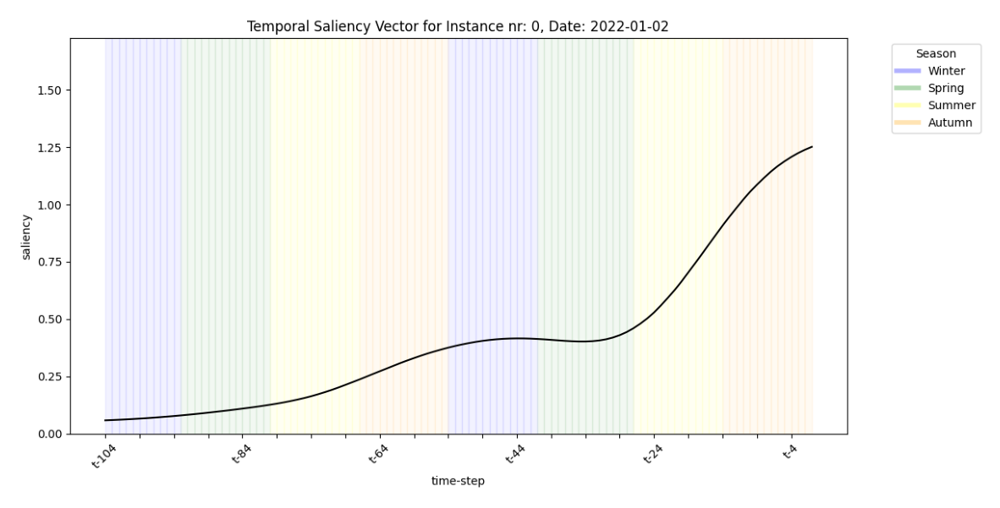

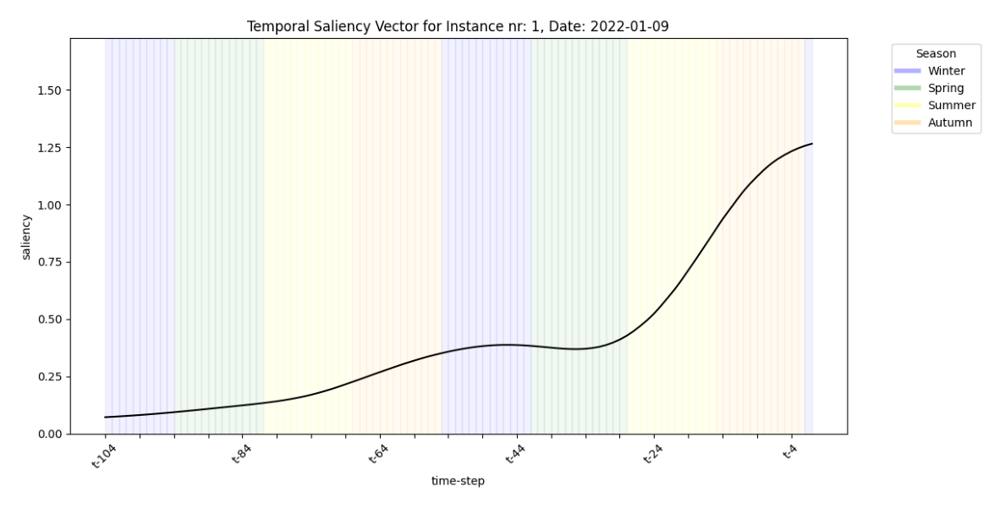

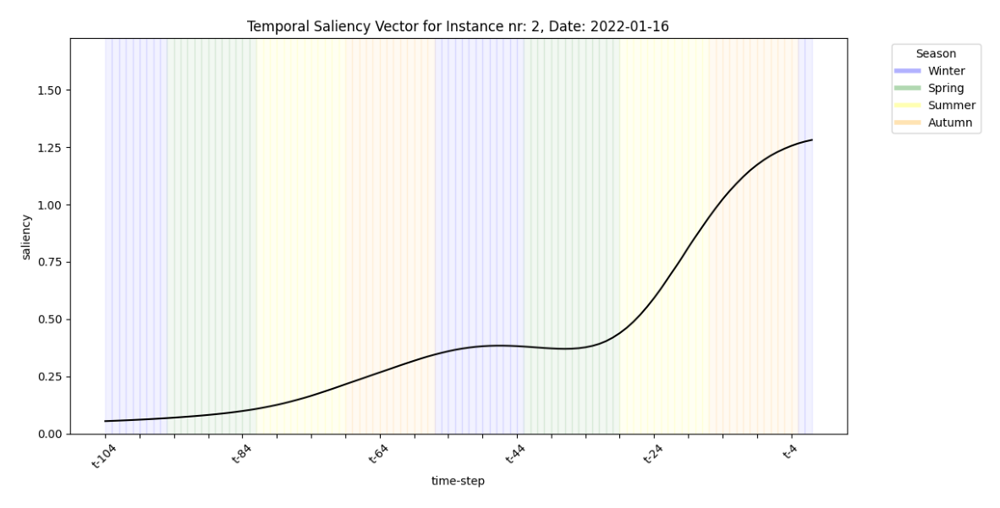

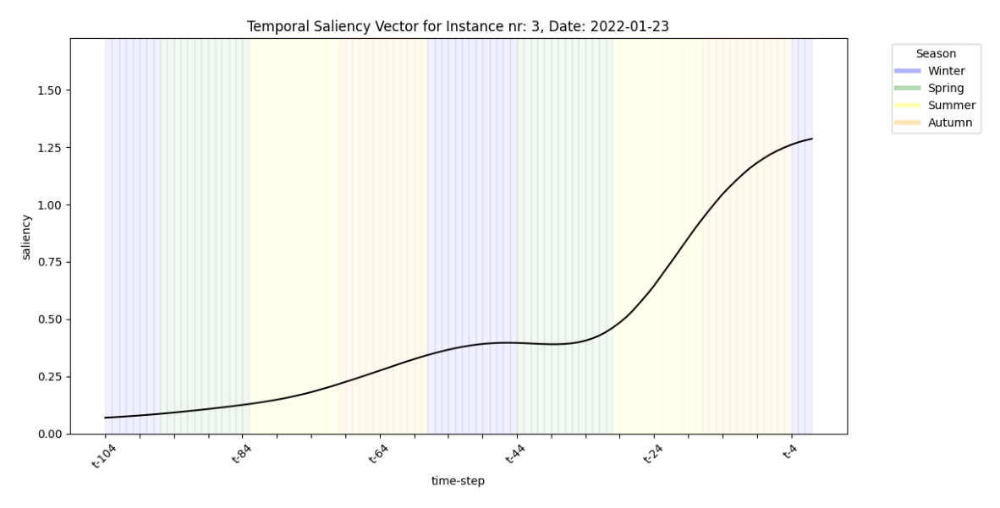

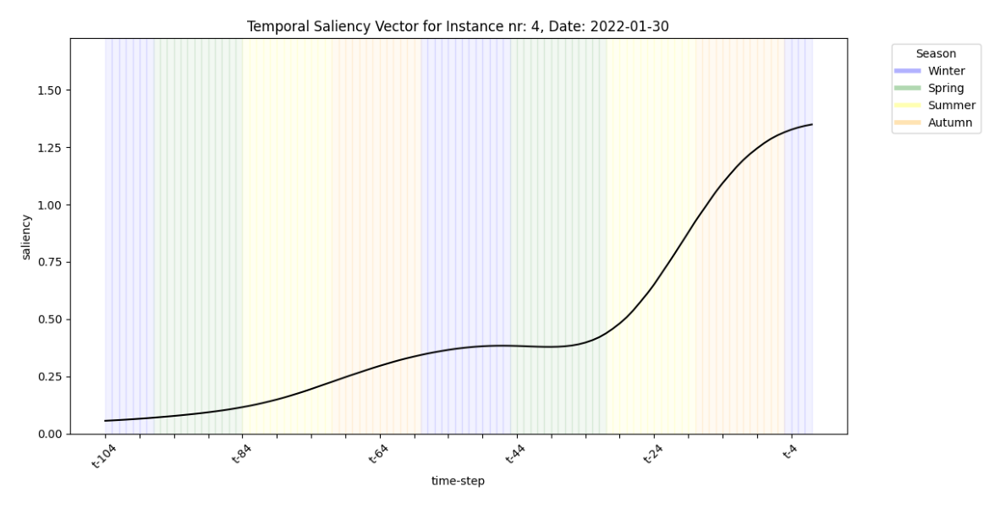

...

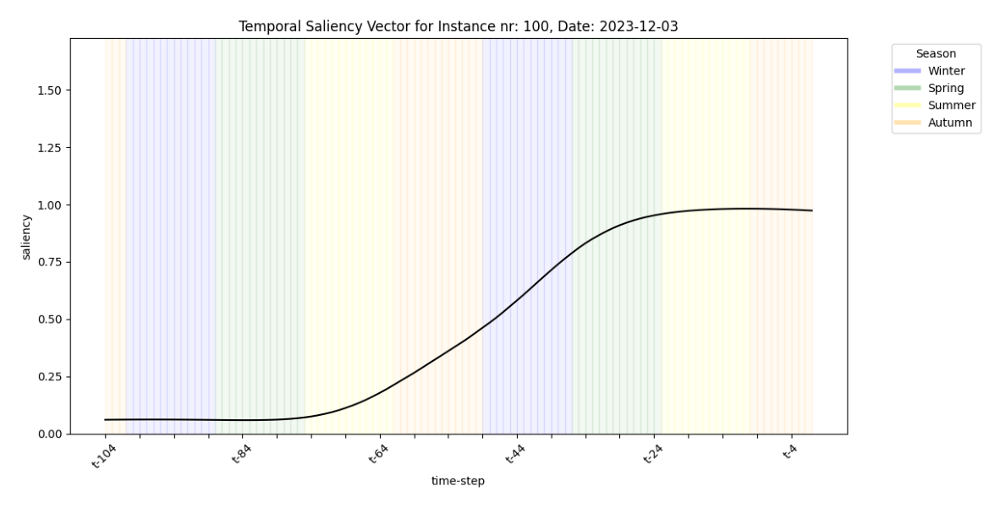

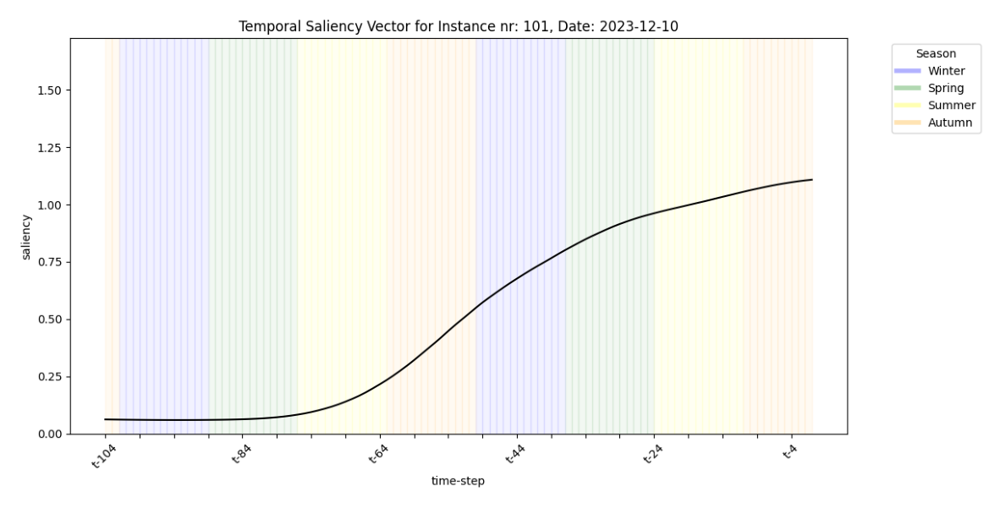

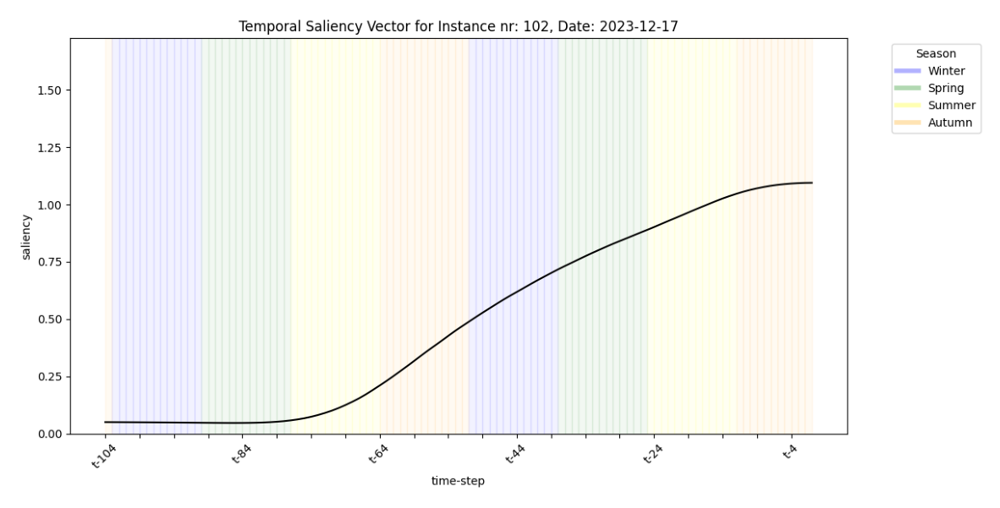

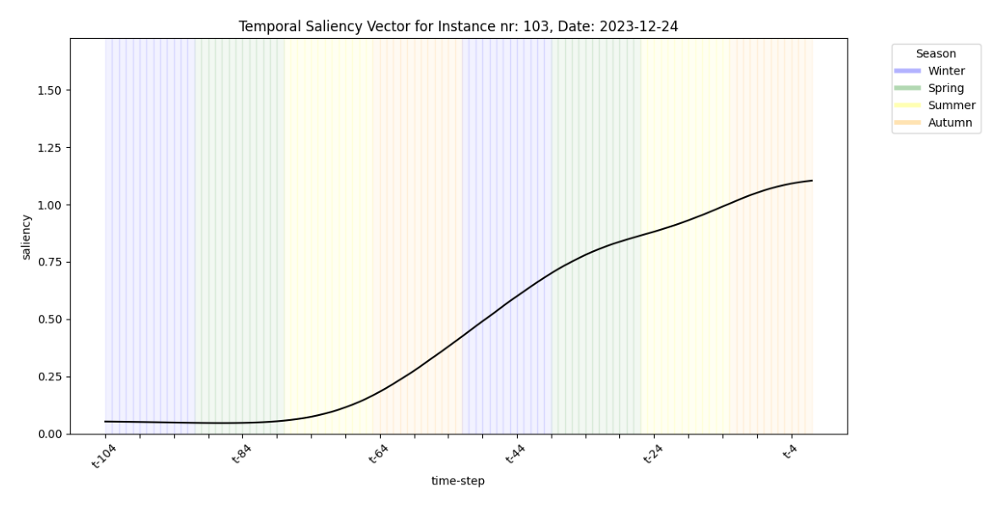

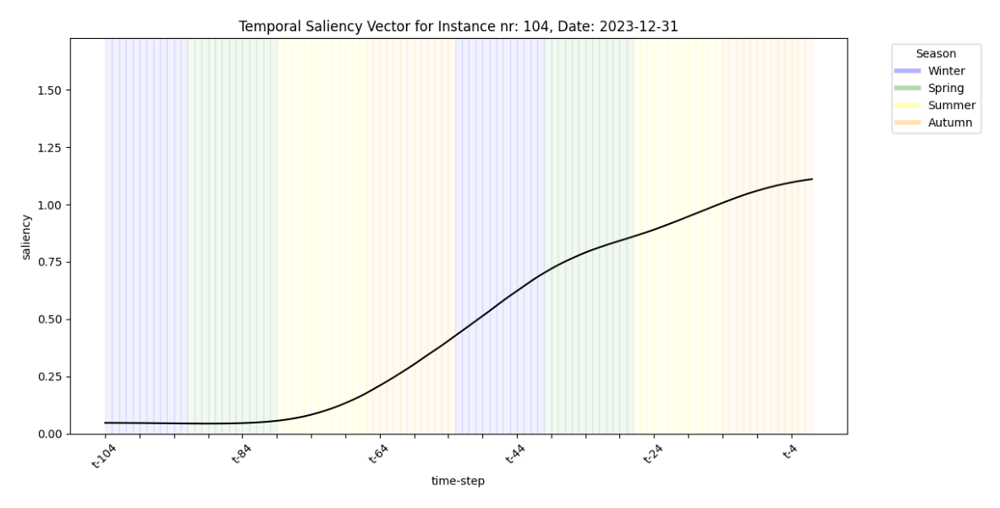

In [ ]:
# Display each saliency vector image in the image_list

for image in image_list:
    fig, ax = plt.subplots(figsize=(15, 13))  # Create a new figure with specified size
    # ax.set_title(title)  # (Optional) Uncomment to set a title for each plot
    ax.axis('off')  # Hide the axes for a cleaner look
    ax.imshow(image)  # Display the current image from the list

    plt.show()  # Render the figure with the image

#### ***Evaluation***

##### ***Insertion***

In [ ]:
# Identify the indices of the most important frames for each saliency vector

# For each saliency vector in temp_sv_vott_norm_all_instances, get the indices sorted by importance
vott_norm_all_istances_important_frames = [np.argsort(-sv)[:] for sv in temp_sv_vott_norm_all_instances]

# Print the total number of important frames identified
print("Length of important_frames: ", len(vott_norm_all_istances_important_frames))

# Print an example of the important frames for the first instance
print("Example:")
vott_norm_all_istances_important_frames[0]


Length of important_frames:  105
Example:


array([103, 102, 101, 100,  99,  98,  97,  96,  95,  94,  93,  92,  91,
        90,  89,  88,  87,  86,  85,  84,  83,  82,  81,  80,  79,  78,
        77,  76,  75,  74,  60,  61,  59,  62,  58,  63,  73,  57,  64,
        65,  56,  66,  72,  67,  55,  71,  68,  69,  70,  54,  53,  52,
        51,  50,  49,  48,  47,  46,  45,  44,  43,  42,  41,  40,  39,
        38,  37,  36,  35,  34,  33,  32,  31,  30,  29,  28,  27,  26,
        25,  24,  23,  22,  21,  20,  19,  18,  17,  16,  15,  14,  13,
        12,  11,  10,   9,   8,   7,   6,   5,   4,   3,   2,   1,   0])

Insertion all frames in order of importance for Istance nr 0 
[103 102 101 100  99  98  97  96  95  94  93  92  91  90  89  88  87  86
  85  84  83  82  81  80  79  78  77  76  75  74  60  61  59  62  58  63
  73  57  64  65  56  66  72  67  55  71  68  69  70  54  53  52  51  50
  49  48  47  46  45  44  43  42  41  40  39  38  37  36  35  34  33  32
  31  30  29  28  27  26  25  24  23  22  21  20  19  18  17  16  15  14
  13  12  11  10   9   8   7   6   5   4   3   2   1   0] 



Original prediction: [0.24464019]
Initial Prediction with ALL Blurred Frame, pred: [0.76855457], error: 0.2744863033294678
Frame 103, new prediction: [0.75602984], error: 0.2615194022655487
Frame 102, new prediction: [0.83682716], error: 0.3506854176521301
Frame 101, new prediction: [0.81747925], error: 0.3281446099281311
Frame 100, new prediction: [0.786063], error: 0.29313868284225464
Frame 99, new prediction: [0.81230193], error: 0.32223987579345703
Frame 98, new prediction: [0.4394591], error: 0.03795440495014191
Frame 97, new prediction: [0.06011214], error: 0.034050602465867996
Frame 96, new prediction: [0.08916782], error: 0.024171657860279083
Frame 95, new prediction: [0.09740031], error: 0.021679582074284554
Frame 94, new prediction: [0.02504368], error: 0.0482226237654686
Frame 93, new prediction: [0.07463172], error: 0.028902878984808922
Frame 92, new prediction: [0.07515265], error: 0.02872602455317974
Frame 91, new prediction: [0.15369666], error: 0.00827072560787201
Frame

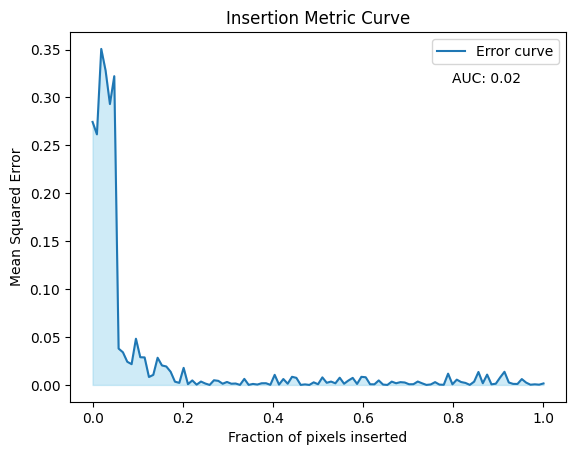

Errors: [0.2744863, 0.2615194, 0.35068542, 0.3281446, 0.29313868, 0.32223988, 0.037954405, 0.034050602, 0.024171658, 0.021679582, 0.048222624, 0.028902879, 0.028726025, 0.008270726, 0.010498231, 0.028365573, 0.02032287, 0.019269492, 0.01375101, 0.0033660105, 0.0021705101, 0.017812768, 0.0007945619, 0.0047006253, 0.00027647195, 0.0035192252, 0.0014634238, 4.1879346e-07, 0.0048776004, 0.0042429934, 0.001250209, 0.00310218, 0.001260518, 0.001474722, 2.348017e-05, 0.0062992387, 6.619966e-05, 0.0010371909, 0.00040471405, 0.0017373312, 0.001776834, 8.438752e-05, 0.010534043, 0.00033237875, 0.006164377, 0.001274897, 0.008475013, 0.0074047134, 3.6594996e-05, 0.0005508339, 4.9770284e-07, 0.0027006802, 0.00073216227, 0.007875979, 0.0022386205, 0.0035007389, 0.0016982036, 0.0075490326, 0.0012614335, 0.0045790174, 0.0073559885, 0.0010658926, 0.0084409835, 0.0080168685, 0.00070266, 0.00062524324, 0.004704811, 0.0003600163, 8.728939e-07, 0.0034531285, 0.0017599702, 0.0029025236, 0.0025407854, 0.0006

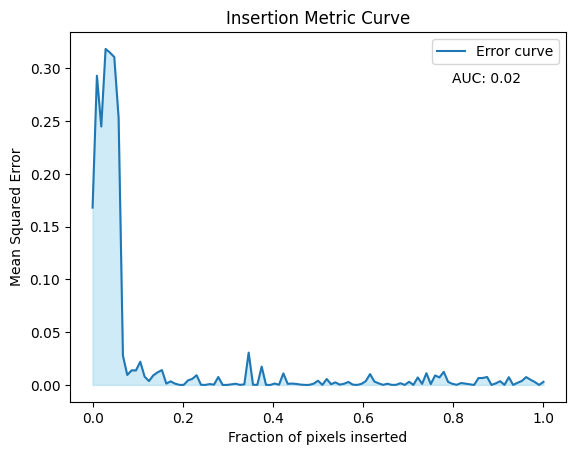

Errors: [0.16800849, 0.29299363, 0.24484347, 0.31838143, 0.31492454, 0.31074107, 0.2532755, 0.02769336, 0.009429415, 0.013820311, 0.013732736, 0.021953357, 0.007875971, 0.0036502315, 0.009036207, 0.01192436, 0.014065009, 0.0012641817, 0.003377617, 0.001243452, 7.737445e-05, 2.9668513e-06, 0.0042797104, 0.0057575875, 0.009205512, 0.000119227916, 2.7387301e-09, 0.0008038456, 0.00024970778, 0.0075226002, 5.0179005e-07, 2.618303e-06, 0.0005201838, 0.0011470707, 3.599943e-05, 0.00055933476, 0.030587861, 0.00014304658, 8.33308e-05, 0.017363517, 3.3568234e-05, 2.9779977e-07, 0.0013231721, 0.00015456152, 0.010918256, 0.0010377044, 0.0012898542, 0.00093458506, 0.00030110482, 1.4442075e-05, 5.4932687e-05, 0.0012352632, 0.0039994926, 2.8155591e-05, 0.0056289304, 0.0006923069, 0.0024170987, 0.0002909037, 0.0011242906, 0.0028436794, 0.00030259605, 9.367534e-07, 0.00094431423, 0.0035481001, 0.010279571, 0.0031737702, 0.0014734142, 3.6658665e-05, 0.001165072, 4.199669e-05, 9.85969e-05, 0.0016304519, 

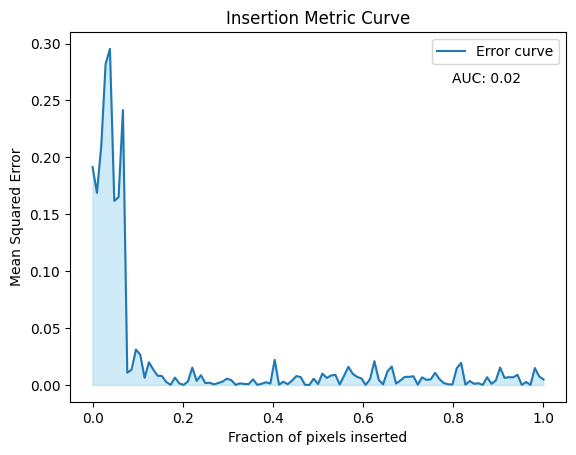

Errors: [0.19139238, 0.16880594, 0.20994596, 0.2819442, 0.29525265, 0.16174498, 0.16513273, 0.2414978, 0.01076228, 0.01342891, 0.031082762, 0.026531022, 0.006197247, 0.019937959, 0.013439853, 0.008099255, 0.007819794, 0.0025979, 0.00011546247, 0.006407996, 0.001337089, 4.993694e-05, 0.0031039447, 0.01523068, 0.003529857, 0.008513646, 0.0016365479, 0.0019145778, 0.00048454368, 0.001709658, 0.0029971737, 0.00549778, 0.0041438313, 6.256265e-05, 0.0013884428, 0.0008482312, 0.0006964691, 0.0049323123, 6.3449275e-05, 0.0010612479, 0.0023546184, 0.0012299197, 0.021983288, 0.00019213147, 0.0028127166, 0.00062128354, 0.0037714017, 0.0077985567, 0.006881127, 6.913719e-05, 9.171885e-06, 0.0054911748, 0.0007659536, 0.009988385, 0.0061619557, 0.008243696, 0.008920127, 0.00038530238, 0.008011463, 0.015884424, 0.009733541, 0.0071340036, 0.0057021375, 2.1158798e-05, 0.0051349266, 0.020899514, 0.004492935, 0.00050970423, 0.01184807, 0.016104378, 0.001253405, 0.0038675808, 0.007040786, 0.007103844, 0.00

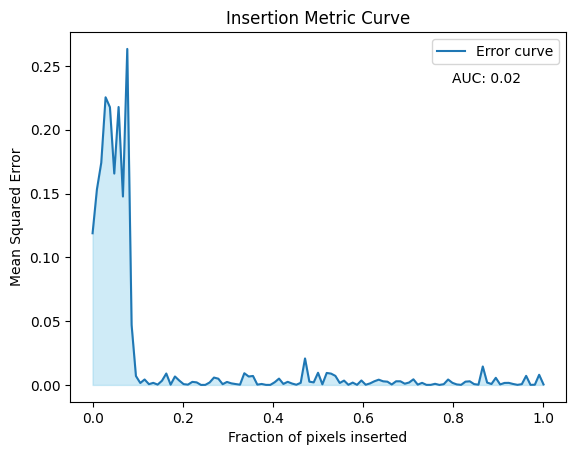

Errors: [0.11886365, 0.15322828, 0.17411341, 0.2254361, 0.21765743, 0.16566065, 0.2178261, 0.1476683, 0.26333642, 0.047013212, 0.006977636, 0.0015138073, 0.0042636604, 0.0005940763, 0.0016279076, 0.00024398326, 0.0032599128, 0.008950658, 0.00019204555, 0.006622536, 0.0034011826, 0.0006136544, 0.00022947768, 0.0023906396, 0.002005952, 6.8296737e-07, 3.433891e-05, 0.0019406684, 0.005772663, 0.0048956443, 0.00059066573, 0.0023428153, 0.0012376598, 0.00067727565, 0.0001884807, 0.009180429, 0.0066028913, 0.0070192865, 0.00023425891, 0.0007531505, 3.422793e-05, 3.529198e-05, 0.002101543, 0.004955136, 0.00078302884, 0.0024263146, 0.0010969171, 0.0001487796, 0.0016475907, 0.020770105, 0.0025480145, 0.0020049857, 0.009543922, 0.00047449366, 0.009389966, 0.008874283, 0.0070908987, 0.0015451994, 0.0034033416, 0.000103151106, 0.0018287553, 6.962225e-05, 0.0034868137, 0.000137559, 0.0012039188, 0.0028680563, 0.0041201916, 0.002849311, 0.0025508315, 0.00035779405, 0.0028502436, 0.0028547097, 0.00095

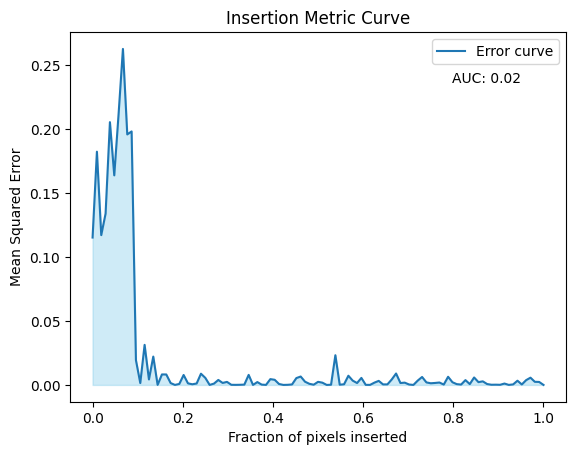

Errors: [0.11509572, 0.18213774, 0.11699275, 0.13379107, 0.2052054, 0.16366221, 0.21158117, 0.26239243, 0.19563395, 0.19796404, 0.01937245, 0.0014730768, 0.031289183, 0.004292904, 0.022145303, 2.9590323e-05, 0.008187202, 0.008161351, 0.0014605169, 2.586502e-07, 0.0007662737, 0.007761471, 0.0012316427, 0.00050211616, 0.001114521, 0.008755734, 0.005511865, 3.2138769e-06, 0.0010229534, 0.0038860368, 0.0015502644, 0.0023733191, 9.171391e-05, 4.8616886e-05, 0.00010982387, 0.00023823955, 0.007836976, 5.357223e-06, 0.002223349, 0.00024083452, 2.2036853e-05, 0.004527793, 0.004003655, 0.0007289072, 1.2041339e-05, 9.3075185e-05, 0.00036466925, 0.005348548, 0.006559605, 0.0025032328, 0.00086990936, 0.00016637296, 0.0024095147, 0.0017632613, 6.0809987e-07, 0.00013812374, 0.023181656, 0.00018031606, 0.00050290715, 0.0071762437, 0.0033497303, 0.0014780543, 0.0054691657, 6.0861123e-05, 3.0130012e-05, 0.0017890771, 0.003158108, 0.0003936375, 0.0004204115, 0.0042675105, 0.00891707, 0.0015030706, 0.0017

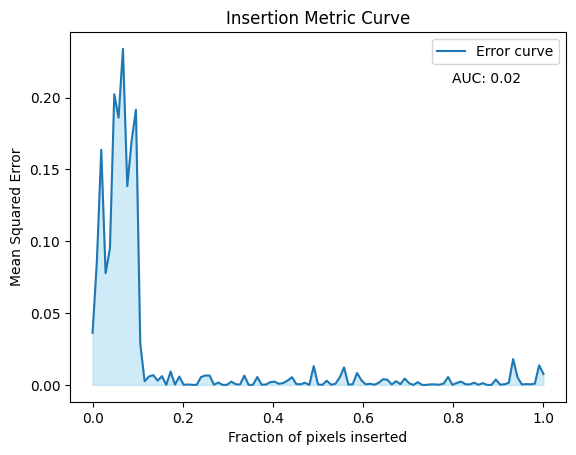

Errors: [0.036246374, 0.08677368, 0.16372468, 0.077801384, 0.095058896, 0.20236574, 0.18607886, 0.23393402, 0.13839667, 0.16976939, 0.19160531, 0.028600693, 0.0025328973, 0.005888954, 0.006816016, 0.00296271, 0.006090391, 2.0121206e-05, 0.009349002, 0.00021715311, 0.005820975, 0.00012522137, 0.00029185906, 7.557411e-05, 1.1857552e-05, 0.005484799, 0.006562598, 0.0065223803, 0.000111253925, 0.0016722146, 2.3639146e-05, 5.03878e-05, 0.0023267474, 0.0005179947, 0.00023640951, 0.0064360015, 1.2364901e-05, 0.00012425345, 0.005517739, 0.0001299542, 0.0003066814, 0.001947675, 0.0022394315, 0.00075601257, 0.0013690353, 0.0030671938, 0.0053839544, 0.00053290336, 0.00048523143, 0.0014906202, 5.3393032e-06, 0.0130829625, 0.00038127418, 4.2629053e-05, 0.0029540542, 0.00013820641, 0.000734489, 0.005212341, 0.012191785, 0.00017380872, 0.00051816297, 0.0082729785, 0.0032549188, 0.0003792657, 0.00081676245, 0.000104481114, 0.0015289818, 0.003990157, 0.003598477, 0.00028915267, 0.0026025749, 0.00054150

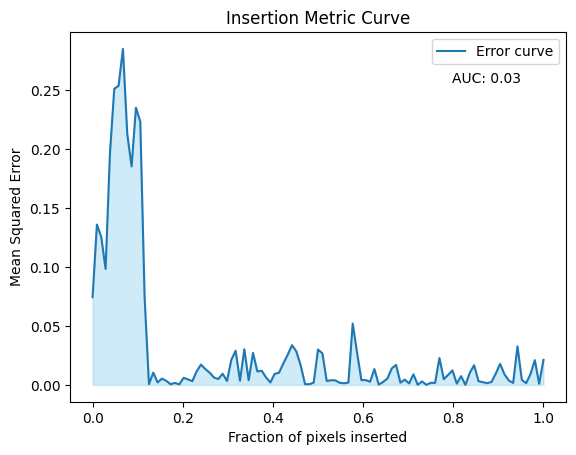

Errors: [0.07451582, 0.13607213, 0.12555732, 0.09840299, 0.1962881, 0.25125268, 0.25385183, 0.28510717, 0.21276587, 0.18539962, 0.235239, 0.22346659, 0.07417719, 0.00066678406, 0.010457314, 0.0021093376, 0.0053600096, 0.0034877993, 0.00058175874, 0.0017272579, 0.00045328712, 0.00606217, 0.0047089453, 0.0031652804, 0.0114709865, 0.017311726, 0.013443957, 0.010399356, 0.0062878355, 0.005019691, 0.009516068, 0.0033309523, 0.021328228, 0.029012974, 0.003566775, 0.030263875, 0.004021499, 0.027247887, 0.01143292, 0.012066771, 0.006406789, 0.0020836454, 0.009409949, 0.010340455, 0.018284414, 0.025591025, 0.033704128, 0.028392734, 0.016651645, 0.00065310445, 0.00059839454, 0.0019647896, 0.030004295, 0.026824504, 0.0033214027, 0.0040121, 0.0038527604, 0.0018083547, 0.0014148973, 0.0020031205, 0.052055664, 0.027302146, 0.004080597, 0.004136238, 0.0026977537, 0.013461213, 0.0002627686, 0.0025452352, 0.005410863, 0.013990608, 0.01699395, 0.0019472962, 0.0045052003, 0.0012797998, 0.008994183, 0.000

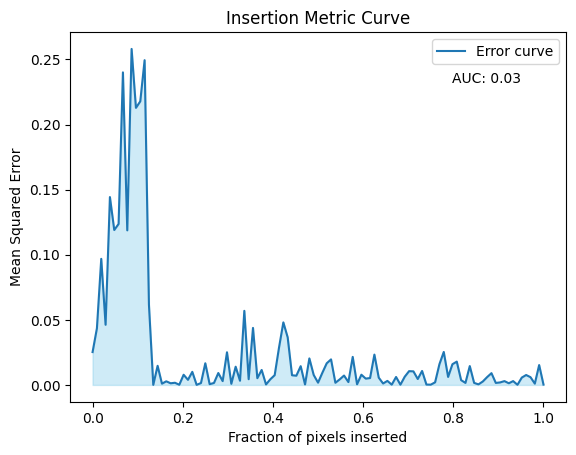

Errors: [0.02523329, 0.04349538, 0.096843004, 0.046197902, 0.14428532, 0.11899191, 0.12364167, 0.2400565, 0.118721075, 0.2580688, 0.21281107, 0.21780367, 0.24942282, 0.061635792, 5.125718e-05, 0.014684852, 0.00096166274, 0.002773539, 0.0012669404, 0.0016639328, 0.00013457009, 0.0078041004, 0.0039293286, 0.0100440895, 4.484501e-05, 0.0014561148, 0.01664254, 0.0005690767, 0.0015142874, 0.009146144, 0.0029321369, 0.025070755, 0.0008551979, 0.013995163, 0.00320733, 0.05690511, 0.004396564, 0.043789394, 0.005182133, 0.011489904, 0.00036335917, 0.004349997, 0.007488715, 0.02867392, 0.04803391, 0.03653739, 0.007424111, 0.007094734, 0.014397998, 0.00035071408, 0.020368297, 0.007649978, 0.0017314568, 0.0093626315, 0.016598279, 0.01961754, 0.0016616578, 0.004262236, 0.007203794, 0.0021871184, 0.021525007, 0.0005035463, 0.007839652, 0.0048535713, 0.0052821566, 0.023298802, 0.005595791, 0.0011050932, 0.0030856875, 0.00020944246, 0.0060961884, 0.0001869658, 0.006318282, 0.010574473, 0.010417257, 0.

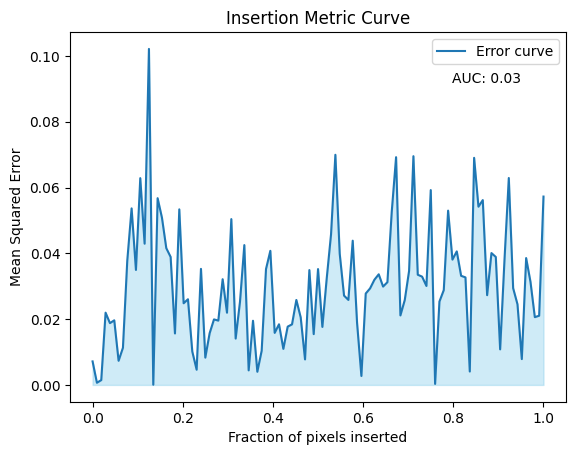

Errors: [0.0071500773, 0.00066074904, 0.0014694965, 0.021964628, 0.01878294, 0.019636495, 0.0073379898, 0.011290175, 0.0377508, 0.05365896, 0.034950648, 0.06284887, 0.04292781, 0.10212358, 6.161207e-05, 0.056756653, 0.05083229, 0.04156922, 0.03890277, 0.015644556, 0.05336395, 0.024821507, 0.026039654, 0.010128961, 0.004628024, 0.035273246, 0.0083004115, 0.015722577, 0.019915162, 0.019549377, 0.03212853, 0.021951681, 0.050401587, 0.014088791, 0.025279686, 0.04250163, 0.0044265646, 0.01950345, 0.004005277, 0.010388538, 0.035219513, 0.0407575, 0.01582125, 0.01843193, 0.010953623, 0.017717158, 0.018413547, 0.025828578, 0.020538408, 0.007757927, 0.03490952, 0.01543935, 0.035212062, 0.017631656, 0.032327667, 0.045788802, 0.069947965, 0.03988397, 0.027143871, 0.025834978, 0.04383825, 0.018894495, 0.0027198102, 0.027775519, 0.029338134, 0.03196611, 0.033624206, 0.029892582, 0.031227523, 0.052616693, 0.06922053, 0.021129718, 0.025784686, 0.034644395, 0.06952226, 0.03349475, 0.032914545, 0.03007

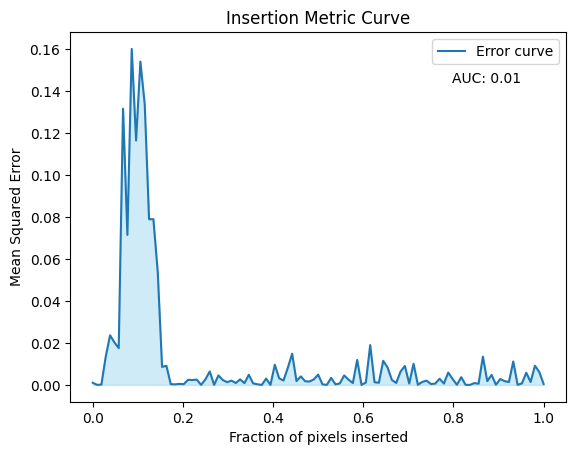

Errors: [0.0010569183, 4.1125586e-05, 0.00015742463, 0.013432114, 0.023647202, 0.020296529, 0.017544294, 0.13164154, 0.07149675, 0.16013023, 0.11648468, 0.15408525, 0.1336552, 0.078991264, 0.07897498, 0.053801183, 0.008603637, 0.009099427, 0.00036909207, 0.00027943472, 0.00048267713, 0.00036732844, 0.0024495232, 0.0023103193, 0.0025428904, 1.7936987e-05, 0.002685749, 0.006411523, 4.4541368e-05, 0.0045097703, 0.002343528, 0.0013159037, 0.00204664, 0.00092277484, 0.002655452, 0.0008510127, 0.0048402427, 0.0007503788, 0.00030983973, 4.2341557e-07, 0.0030253942, 6.9992616e-06, 0.009611546, 0.0031731657, 0.0020854634, 0.008159887, 0.014879515, 0.0018360831, 0.0040702163, 0.0017499287, 0.0016253018, 0.002652725, 0.004906226, 0.00026770373, 2.9356044e-05, 0.003351245, 0.00025618036, 0.0007300244, 0.004512861, 0.0025381555, 0.0009034814, 0.01190663, 3.8543812e-06, 0.0011669801, 0.018991265, 0.0013047317, 0.0010447418, 0.0114799, 0.008362945, 0.00239282, 0.00093563495, 0.0063690403, 0.009022322

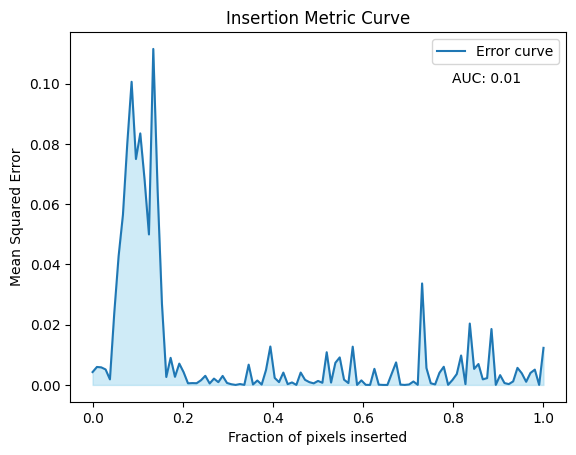

Errors: [0.004272702, 0.0059618917, 0.005832413, 0.005136144, 0.0018437174, 0.023816613, 0.0426997, 0.0564363, 0.08004946, 0.100620344, 0.07498591, 0.08348698, 0.06802802, 0.049954228, 0.11152661, 0.06465485, 0.02688827, 0.0026381202, 0.0089952005, 0.002697506, 0.0070756087, 0.004208983, 0.0005384131, 0.00060305186, 0.0005670935, 0.0015507292, 0.0030283257, 0.0004839246, 0.0020981834, 0.00092280743, 0.0029868514, 0.000656466, 0.00022877935, 9.918846e-07, 0.0002898504, 1.813443e-05, 0.006730505, 0.00014723868, 0.0014652269, 0.00011947406, 0.0049682693, 0.012748567, 0.0023358935, 0.0009247277, 0.004097886, 0.00025906382, 0.0008293033, 3.4040331e-06, 0.004106109, 0.0016892366, 0.0009201441, 0.0005261415, 0.0013325964, 0.00070773775, 0.010851879, 0.0007714732, 0.007344026, 0.009135818, 0.0017340024, 0.0006170758, 0.0126977535, 1.6346124e-06, 0.0015059166, 3.475827e-05, 1.157483e-06, 0.0053417496, 7.916733e-05, 3.5470316e-07, 1.3419778e-07, 0.003767347, 0.00747665, 0.00010068883, 2.8388214e

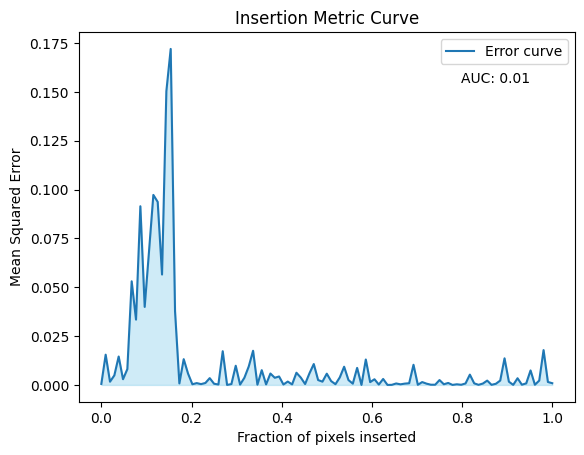

Errors: [0.00051709975, 0.015471895, 0.00165621, 0.0048840404, 0.014544601, 0.0029282395, 0.0081073465, 0.05304342, 0.033429243, 0.09145466, 0.03993322, 0.068426244, 0.097247824, 0.093676895, 0.056509927, 0.15034062, 0.17197339, 0.03770331, 0.0007735573, 0.013188192, 0.0057999482, 0.00033834996, 0.0009334775, 0.00041393246, 0.00099986, 0.003478639, 0.00060419407, 0.00021239948, 0.017255824, 7.88807e-08, 0.00043333927, 0.009820266, 0.00016468127, 0.0036931492, 0.009444209, 0.01748767, 0.00011162894, 0.0075560748, 0.00026973995, 0.0058347625, 0.003661436, 0.004320563, 0.00022209257, 0.0017170868, 0.0002599914, 0.006238617, 0.0037809613, 0.00046314968, 0.0059176357, 0.01069019, 0.0024950327, 0.00168017, 0.0057550236, 0.0019669726, 0.0003717949, 0.0038593041, 0.009317021, 0.002487363, 0.0006510649, 0.008717527, 5.3382564e-07, 0.013021335, 0.0014441984, 0.002901228, 0.00018064516, 0.0030548933, 3.4554723e-06, 3.7361395e-05, 0.00074903405, 0.00030448913, 0.00067223446, 0.0008607079, 0.010313

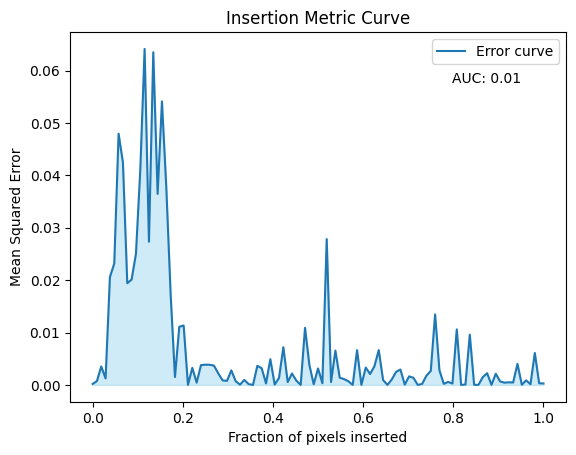

Errors: [0.00018394142, 0.0007291357, 0.0035267272, 0.0012396527, 0.020612432, 0.023170678, 0.047948383, 0.042449914, 0.019417956, 0.020113254, 0.025016915, 0.040988456, 0.064131305, 0.02733574, 0.063496865, 0.03646171, 0.054118138, 0.037738267, 0.017386012, 0.0015122377, 0.011109128, 0.011346992, 1.0309893e-05, 0.0032571433, 0.00043658126, 0.0037843487, 0.0038661205, 0.003850674, 0.0036851773, 0.0021855633, 0.00086723577, 0.0007781628, 0.0027787585, 0.0007136711, 5.3525502e-05, 0.00095654954, 0.00015156173, 1.1333701e-06, 0.0036433816, 0.0031819015, 0.00028219348, 0.0049168444, 6.4250366e-05, 0.001341742, 0.007194478, 0.0005482803, 0.0021751986, 0.0008151756, 9.193198e-06, 0.010900588, 0.003823404, 0.00012204292, 0.0031457534, 0.00033092475, 0.027840126, 0.00055431493, 0.00655114, 0.0013829424, 0.0011064846, 0.0006997874, 8.437657e-07, 0.0066316924, 9.588811e-06, 0.0033232234, 0.0020835474, 0.0035556701, 0.0066515794, 0.00094673445, 4.948157e-06, 0.0010406615, 0.0024917289, 0.00294297

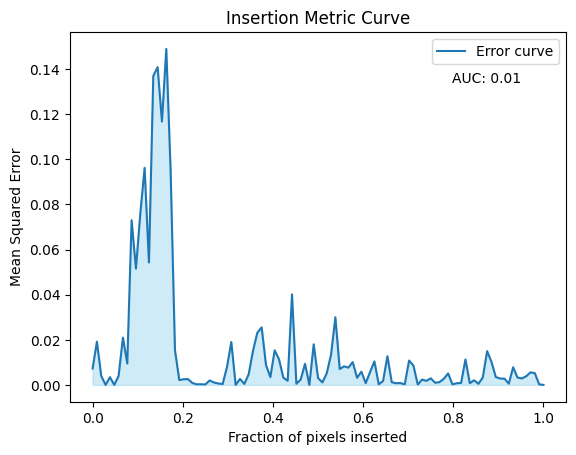

Errors: [0.0072595193, 0.019160075, 0.0039562383, 1.6202883e-05, 0.0034489476, 2.126696e-05, 0.003967486, 0.020952545, 0.009483488, 0.072990656, 0.051522017, 0.07572278, 0.09620583, 0.05426219, 0.13690035, 0.14085451, 0.116745986, 0.14891902, 0.094955795, 0.01547489, 0.002142376, 0.002517801, 0.0025880057, 0.0008663057, 0.00027900646, 0.00029116095, 0.000200402, 0.0019786847, 0.0010760211, 0.00063481217, 0.00039797288, 0.007984229, 0.01902093, 4.361281e-06, 0.0026549236, 0.00046164752, 0.0046848604, 0.015091009, 0.023152426, 0.025510555, 0.008811999, 0.003455938, 0.015330331, 0.011347399, 0.0031894103, 0.001862875, 0.04013312, 0.0005324439, 0.0023790488, 0.009367926, 3.572993e-05, 0.018003684, 0.0030583797, 0.0011210892, 0.0051236185, 0.0133850295, 0.029982679, 0.0070418264, 0.00824533, 0.007682512, 0.010114581, 0.003156802, 0.0058695716, 0.00077196996, 0.005723099, 0.010418134, 0.00027267096, 0.001776373, 0.012722939, 0.0012040428, 0.00077330536, 0.0008289291, 0.0002686466, 0.01080678

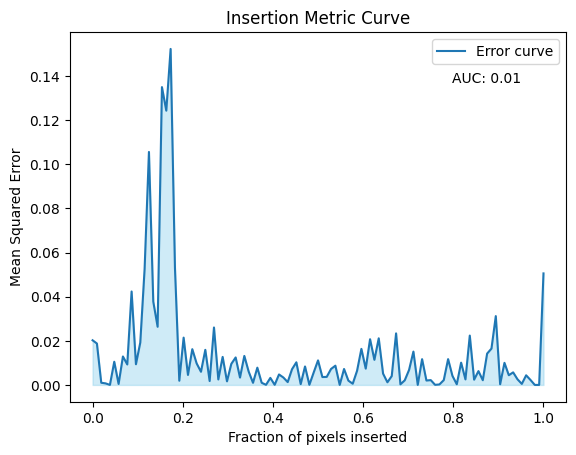

Errors: [0.020235334, 0.018768664, 0.0009816841, 0.0007028149, 4.371992e-06, 0.010511717, 0.00043771035, 0.012894619, 0.009274793, 0.042347703, 0.009378313, 0.019181566, 0.052568905, 0.1055868, 0.037752535, 0.026359187, 0.13497119, 0.12430762, 0.15227973, 0.0530488, 0.001908834, 0.021434978, 0.004529325, 0.016205736, 0.009753739, 0.0059667253, 0.015895544, 0.0017697521, 0.026031595, 0.0024855977, 0.012705372, 0.0016304675, 0.009543543, 0.012455075, 0.0033321495, 0.013143409, 0.0060516214, 0.00096310873, 0.007822794, 0.0009845957, 3.9244806e-05, 0.0031904809, 4.7185866e-05, 0.0047477917, 0.0033707826, 0.001279625, 0.007118642, 0.010255097, 0.00035758776, 0.008362291, 5.2517727e-05, 0.005660504, 0.01112074, 0.0035756442, 0.0036395187, 0.0072354977, 0.008719185, 3.852509e-08, 0.007220569, 0.0019486957, 0.00054137135, 0.006392008, 0.016342208, 0.007380532, 0.020725803, 0.011379498, 0.021117607, 0.005125692, 0.0012022111, 0.0040069823, 0.023361474, 0.00026632458, 0.0020954595, 0.0068226513,

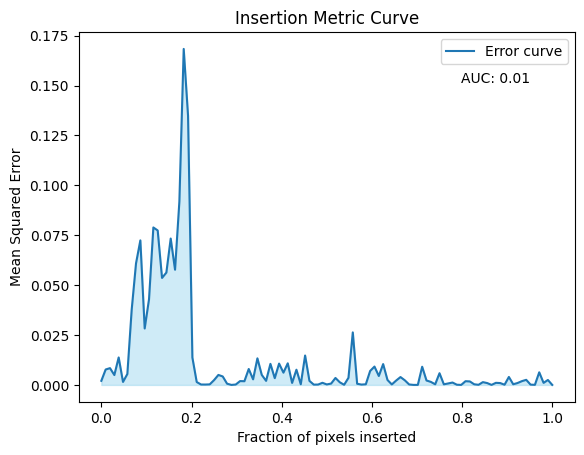

Errors: [0.002065478, 0.0077348235, 0.008410249, 0.0049519646, 0.013769858, 0.0015055233, 0.0054745534, 0.03765379, 0.06091748, 0.07243503, 0.028288798, 0.042952586, 0.07891094, 0.077416785, 0.05362381, 0.056308735, 0.07335507, 0.057740998, 0.091890454, 0.16838382, 0.13490796, 0.01373555, 0.0014506476, 0.00020475741, 0.00018967649, 0.0002749572, 0.0024175323, 0.005008388, 0.0042408914, 0.0006189784, 9.068563e-06, 0.00019331888, 0.0019295616, 0.0018597377, 0.007986051, 0.0028061736, 0.01332546, 0.0050384416, 0.0020381657, 0.010559205, 0.003397947, 0.010690634, 0.0061532375, 0.010830765, 0.0010047096, 0.0076193237, 0.00031910292, 0.014730797, 0.0020247332, 0.00015234791, 0.000186085, 0.0010688887, 0.00024183826, 0.00068020745, 0.0034888696, 0.0013215877, 7.172271e-05, 0.003562042, 0.026324825, 0.0005830936, 0.00017358405, 0.00032034775, 0.007001979, 0.009194444, 0.004480494, 0.010445735, 0.0024830606, 0.00024582737, 0.002196718, 0.0039400663, 0.0023101245, 0.00022409747, 1.32795285e-05, 

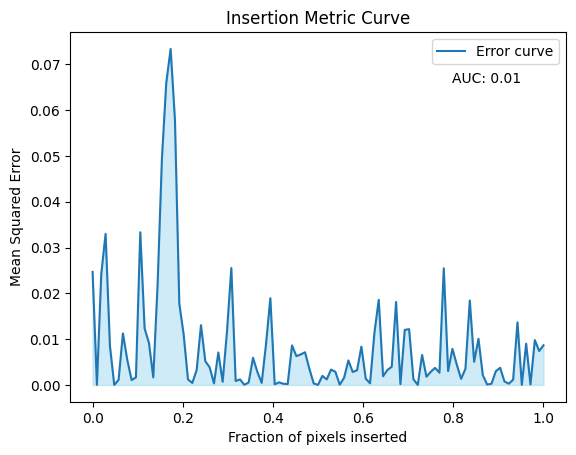

Errors: [0.024684874, 7.248704e-08, 0.02419584, 0.03299821, 0.008531078, 3.4693642e-07, 0.001120323, 0.011260769, 0.0054813297, 0.0010651816, 0.0016601761, 0.033341594, 0.012334091, 0.009175935, 0.0016475036, 0.022015044, 0.049604584, 0.06602533, 0.07338624, 0.057835534, 0.01777768, 0.011055717, 0.0011957017, 0.00043267943, 0.0032360596, 0.013053186, 0.005171326, 0.0038407606, 0.00033642963, 0.00707945, 0.0006813987, 0.011668837, 0.025533771, 0.00085948774, 0.0012122387, 4.0780007e-05, 0.00053104747, 0.0059321984, 0.0028477714, 0.0004444626, 0.008894463, 0.018942375, 0.00014801502, 0.00056508253, 0.00025106405, 0.0001981437, 0.008634271, 0.0062897075, 0.0066606924, 0.007134502, 0.0035147448, 0.00032479467, 9.929533e-07, 0.001984384, 0.0012080752, 0.0033541855, 0.0028752813, 4.803142e-05, 0.001548716, 0.005353789, 0.0028218376, 0.0032039755, 0.008359392, 0.0013800225, 0.00035434228, 0.011338956, 0.018597053, 0.0018924372, 0.0032667774, 0.0039632223, 0.018123752, 0.00017710097, 0.0120211

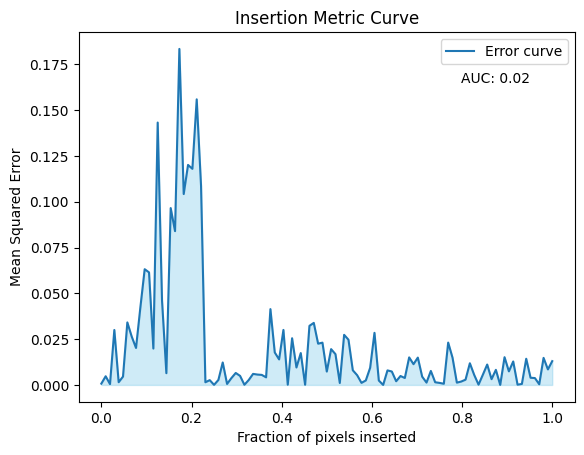

Errors: [0.00070073694, 0.0047304593, 0.00044345538, 0.029994486, 0.0014805119, 0.0045546964, 0.034134112, 0.02645147, 0.020179903, 0.042237576, 0.063168846, 0.06144883, 0.01986081, 0.14323251, 0.046064686, 0.0064082015, 0.09654686, 0.08395654, 0.1834326, 0.104211375, 0.12010379, 0.11797682, 0.15590742, 0.10859446, 0.0014624856, 0.0026125703, 3.951336e-05, 0.002717902, 0.012255878, 0.00053965027, 0.0037392075, 0.0065301904, 0.0049327896, 8.7860004e-05, 0.00269464, 0.006018421, 0.005662271, 0.0054779057, 0.004144699, 0.041390263, 0.017727379, 0.013931477, 0.030020257, 0.00010887772, 0.02548265, 0.009522627, 0.017394956, 9.549786e-05, 0.032259885, 0.033865876, 0.022517752, 0.023080688, 0.007289666, 0.019539643, 0.016803944, 0.001056682, 0.027342284, 0.024684219, 0.008002721, 0.0053230077, 0.0011234774, 0.002448597, 0.0093473885, 0.028437063, 0.0024065373, 4.481849e-06, 0.00792486, 0.0073281284, 0.0020150575, 0.004866145, 0.003784818, 0.01502999, 0.01132931, 0.014915673, 0.0045173387, 0.0

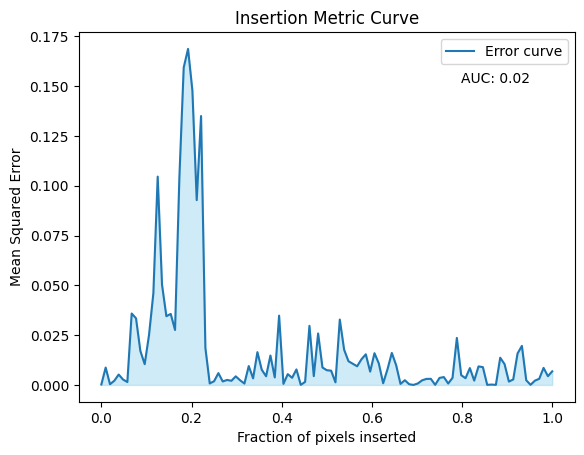

Errors: [0.0002010607, 0.008721133, 0.0003597212, 0.0021210592, 0.005221528, 0.0027206992, 0.0014483193, 0.03586819, 0.03345259, 0.017060371, 0.010426153, 0.025097812, 0.04601074, 0.1045996, 0.050259713, 0.034506653, 0.035666477, 0.027604189, 0.10410938, 0.1594005, 0.16872019, 0.14787905, 0.09280164, 0.13503133, 0.018592909, 0.00075170846, 0.0018606117, 0.005922855, 0.0017468482, 0.0024958842, 0.0020848482, 0.0043197637, 0.0023466395, 0.0006844112, 0.009468716, 0.0032997283, 0.016464625, 0.007622196, 0.0043596337, 0.0147713795, 0.0037647719, 0.034788348, 0.00054029014, 0.0054235416, 0.003573556, 0.0077783205, 4.812565e-05, 0.0015251666, 0.029669581, 0.0044227904, 0.02584107, 0.008752377, 0.007384885, 0.0071603726, 0.0012947181, 0.03283105, 0.017657975, 0.011912016, 0.010622606, 0.009372288, 0.012892372, 0.015373076, 0.006689775, 0.015931334, 0.0107858395, 0.00085176755, 0.007857362, 0.016056148, 0.009885821, 0.0005168477, 0.0023635784, 0.00035949738, 3.967063e-06, 0.00073198084, 0.0023

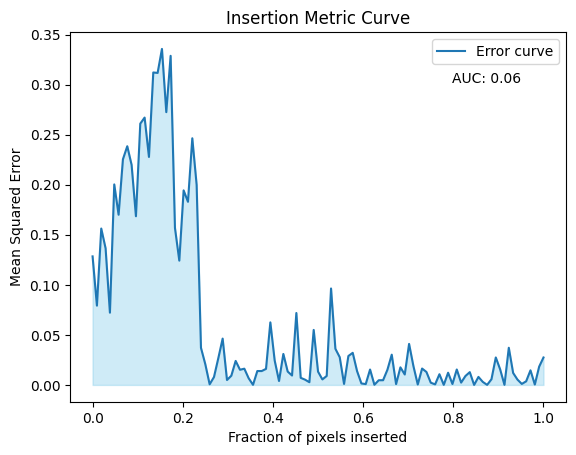

Errors: [0.12840986, 0.07921484, 0.1562195, 0.13652572, 0.07217834, 0.20029916, 0.17002615, 0.22544214, 0.23845121, 0.21983406, 0.16851452, 0.261017, 0.26707873, 0.22775193, 0.3121386, 0.31168747, 0.33566147, 0.272498, 0.32877228, 0.15687223, 0.12418163, 0.1943577, 0.18293531, 0.24639961, 0.19984731, 0.03706817, 0.020667484, 0.000626102, 0.007888814, 0.026735323, 0.046268582, 0.004924517, 0.009216867, 0.023980528, 0.015147231, 0.01622487, 0.006654744, 9.934939e-05, 0.013882492, 0.01385906, 0.016035635, 0.062481955, 0.024383664, 0.0039060973, 0.030953396, 0.01336415, 0.009410811, 0.07185738, 0.0070958035, 0.0052612065, 0.002715631, 0.054943055, 0.013275177, 0.005518394, 0.008964829, 0.096348405, 0.03611743, 0.027702723, 0.0010020682, 0.028892417, 0.032066073, 0.013820171, 0.0014833388, 0.00083839963, 0.015385798, 0.00014781857, 0.004671395, 0.0047179437, 0.015138033, 0.03023434, 0.00083459326, 0.017562354, 0.010420013, 0.040970005, 0.018804487, 0.00040873798, 0.016361346, 0.012952222, 0

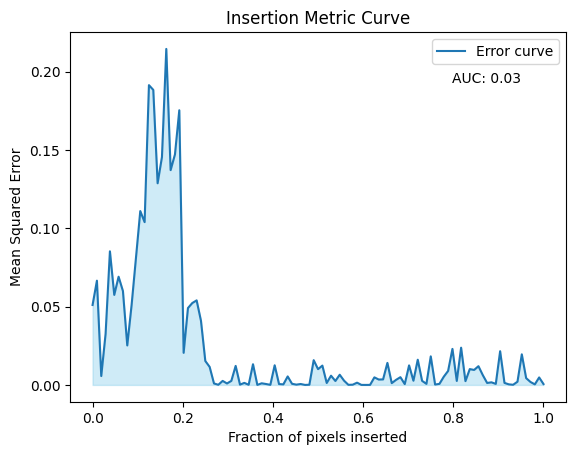

Errors: [0.05102359, 0.06652114, 0.0056767673, 0.03256004, 0.085259266, 0.057461385, 0.06905136, 0.059923436, 0.025200123, 0.05100076, 0.08090868, 0.110951215, 0.103882104, 0.19129966, 0.18828338, 0.12869035, 0.14541395, 0.21441884, 0.1370817, 0.14709075, 0.17528437, 0.020478692, 0.049068842, 0.05226642, 0.053956054, 0.040920835, 0.015271952, 0.011504283, 0.00093878806, 9.1166745e-05, 0.0025631587, 0.00093241426, 0.0025720806, 0.01214097, 0.00017263043, 0.0013109181, 8.841735e-05, 0.013209023, 5.9680337e-06, 0.0010431742, 0.00058590074, 5.4320342e-05, 0.012541113, 0.00055977603, 0.00034561372, 0.00542039, 0.0007209953, 0.00018044334, 0.00058269355, 3.5209289e-06, 0.00011863899, 0.015798263, 0.01005916, 0.012330476, 0.0012413363, 0.0058836904, 0.0025085558, 0.0064914934, 0.0027146835, 5.83979e-05, 0.00014619037, 0.0014412552, 1.5887254e-05, 5.1261446e-07, 2.1684044e-05, 0.004825392, 0.0034418663, 0.0035290213, 0.01405652, 0.001148048, 0.0032429397, 0.0049400264, 0.00053013035, 0.0124704

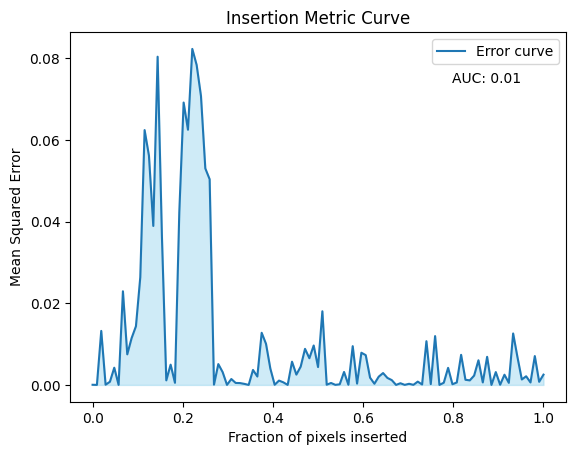

Errors: [3.4800454e-05, 5.5757264e-06, 0.013220876, 5.0775256e-05, 0.000775684, 0.0042142747, 1.4915685e-05, 0.022924803, 0.007490964, 0.011453514, 0.014364704, 0.02635224, 0.06237552, 0.05611414, 0.038912036, 0.080338165, 0.03609395, 0.0011226943, 0.00495987, 0.0005229444, 0.042269286, 0.069119856, 0.062466446, 0.08224229, 0.07832397, 0.070712455, 0.052994423, 0.05034238, 7.084707e-05, 0.0051007927, 0.0031311812, 1.1051169e-05, 0.001446537, 0.00048551508, 0.0004529674, 0.00025645137, 3.8244824e-08, 0.0036672524, 0.0020590737, 0.012763189, 0.010059412, 0.0039990405, 3.8162056e-05, 0.0010641158, 0.0006323457, 4.03526e-06, 0.0056827688, 0.0025277522, 0.0044866246, 0.008827964, 0.006534661, 0.009651417, 0.0043748696, 0.018028485, 4.9177474e-05, 0.0004754757, 1.6168353e-05, 0.0001544652, 0.0031712388, 4.2722502e-05, 0.009485055, 0.00032878568, 0.007876341, 0.007292384, 0.0017759812, 0.00029566142, 0.0020241325, 0.0029031418, 0.0017135566, 0.0011843927, 5.187791e-06, 0.0004135251, 1.180179e

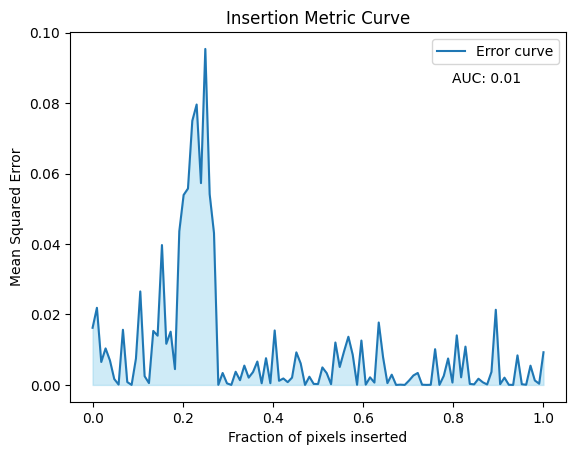

Errors: [0.016218897, 0.021894086, 0.0065129967, 0.010365878, 0.006960295, 0.0016716686, 0.000101886166, 0.015657457, 0.0008122749, 7.3624433e-06, 0.0074681276, 0.026543198, 0.0024835833, 0.00051915116, 0.01533194, 0.013983968, 0.039710674, 0.011677183, 0.015117879, 0.0044882856, 0.043625105, 0.05393396, 0.055752646, 0.07498917, 0.07960245, 0.05729063, 0.095389016, 0.054188184, 0.043122806, 1.8993667e-05, 0.0033870114, 0.00044513642, 1.8326139e-06, 0.0037401917, 0.0013416196, 0.0054872534, 0.0020732814, 0.0036506816, 0.0066400245, 0.00046472624, 0.0075948695, 0.00048724498, 0.015466305, 0.0011786314, 0.0018332135, 0.0007880572, 0.0020691147, 0.009247834, 0.006093703, 8.9072057e-07, 0.0023322247, 0.00028828977, 0.00025249028, 0.0049768686, 0.0033456506, 0.0002086169, 0.012041773, 0.00509623, 0.009538117, 0.01367745, 0.008555231, 3.6628357e-05, 0.012600913, 8.0585385e-05, 0.0021533647, 0.0006668641, 0.017722443, 0.00784512, 0.00051253673, 0.0029076654, 5.1085408e-08, 7.393329e-05, 2.8887

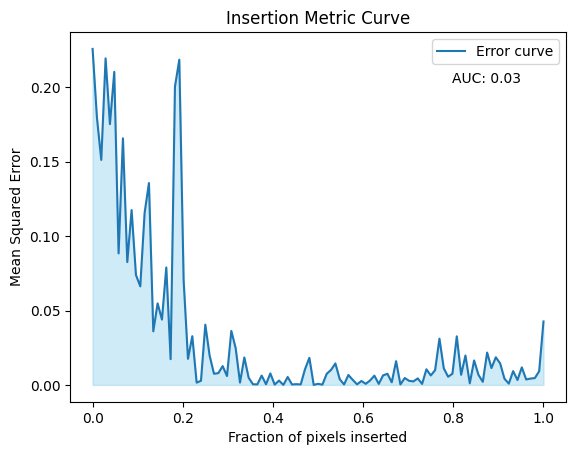

Errors: [0.22576225, 0.17977107, 0.15118493, 0.21942347, 0.17523785, 0.2103644, 0.08837941, 0.16570884, 0.08255639, 0.11749653, 0.07391817, 0.06624855, 0.11557015, 0.13565083, 0.036023643, 0.05479538, 0.04390412, 0.07893897, 0.017319538, 0.20044881, 0.21851683, 0.07030396, 0.017548146, 0.03272821, 0.0015567673, 0.00278548, 0.040509176, 0.019609276, 0.0075150025, 0.007931717, 0.012671801, 0.0059866407, 0.036325194, 0.024730427, 0.0015916537, 0.01847345, 0.004779493, 0.00042671917, 0.00037110562, 0.0062753265, 0.00044836663, 0.0077344673, 0.0002019779, 0.0029319369, 8.6699e-06, 0.0053421766, 0.00030811518, 0.00050337514, 0.00032242716, 0.010616476, 0.018198133, 5.2802443e-06, 0.00075313414, 0.0001780732, 0.007477928, 0.010115516, 0.014455186, 0.0038849853, 0.00030146382, 0.006675547, 0.003420694, 0.00037826807, 0.0026441116, 0.00073790783, 0.0030134134, 0.006227502, 0.0006926786, 0.006422495, 0.007493069, 0.0017640147, 0.015964303, 0.00032913595, 0.004651889, 0.0027516591, 0.0023734295, 

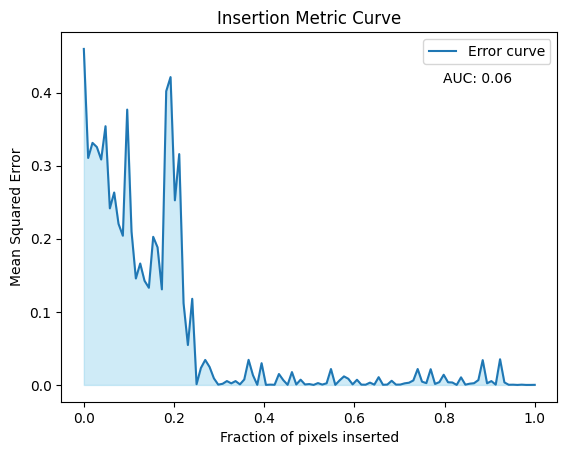

Errors: [0.45967072, 0.31052387, 0.3311499, 0.32546252, 0.30837715, 0.3539388, 0.2415909, 0.2632585, 0.22039102, 0.20409706, 0.37668276, 0.20977493, 0.14560084, 0.16613099, 0.14248398, 0.13291338, 0.20263363, 0.18828586, 0.13073985, 0.4018409, 0.42111334, 0.25255454, 0.31581196, 0.111770384, 0.05458334, 0.117842846, 0.0010052916, 0.02318037, 0.034173526, 0.024593914, 0.009008094, 0.0004044509, 0.001539703, 0.0052774963, 0.0021649308, 0.0052581327, 0.00076901173, 0.0074379635, 0.034316298, 0.013419338, 0.0001340382, 0.029753458, 5.1905292e-05, 0.00041051494, 0.00020141921, 0.014932872, 0.0065870727, 0.000118532545, 0.017559202, 0.000600163, 0.007181885, 0.00063272944, 0.0011634073, 1.02609565e-05, 0.0025064724, 0.00045625638, 0.0022711114, 0.021746732, 7.589987e-05, 0.006261924, 0.0116904685, 0.008446266, 0.0007340335, 0.007073473, 0.00039675858, 0.00029308637, 0.003161137, 0.0003845446, 0.010617655, 0.00018809874, 0.00047905924, 0.0056597684, 0.00042327368, 0.0004898588, 0.0021859591, 

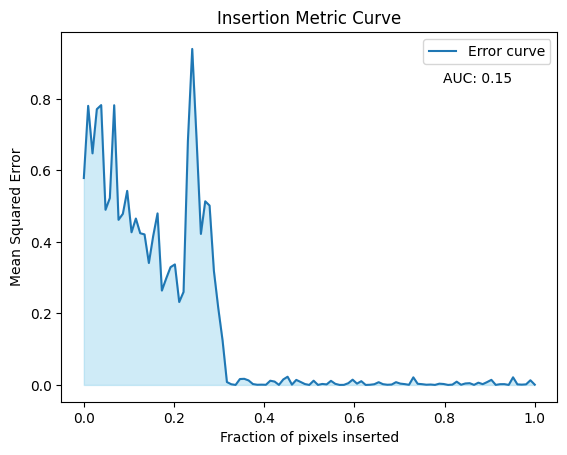

Errors: [0.5786793, 0.7806607, 0.6477197, 0.77130294, 0.7827303, 0.4898684, 0.5227579, 0.78234535, 0.46181434, 0.47856447, 0.54276234, 0.4269692, 0.4654508, 0.42434072, 0.42101154, 0.34107703, 0.41674805, 0.47981203, 0.2639351, 0.2978665, 0.32944548, 0.33705154, 0.23192391, 0.26004407, 0.6818185, 0.9398562, 0.6882219, 0.4223884, 0.51364994, 0.50176316, 0.3187438, 0.21566254, 0.12435323, 0.008076998, 0.0018819917, 1.0818102e-06, 0.016491266, 0.01709642, 0.012593741, 0.0023988534, 0.00048845616, 0.0007573078, 0.00042345517, 0.011741177, 0.0093752425, 7.5408396e-05, 0.01532707, 0.022927258, 0.0008186885, 0.014074305, 0.008306179, 0.0023931, 8.368592e-06, 0.01184796, 0.00012261383, 0.0026961132, 0.0014556827, 0.011432091, 0.003035323, 1.1876442e-05, 0.00020209991, 0.0048710275, 0.014678771, 0.0036501486, 0.010513086, 1.6902704e-05, 0.0004729006, 0.0019700455, 0.007648383, 0.0021009801, 0.0005086148, 0.0010601763, 0.0077225827, 0.0036461598, 0.0023021328, 0.00035067613, 0.021211084, 0.00318

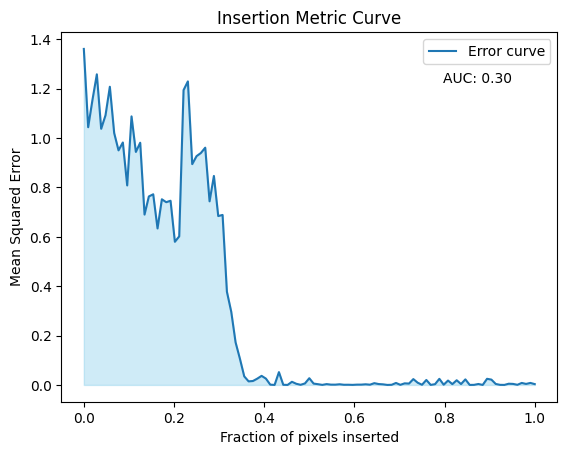

Errors: [1.3613608, 1.0441757, 1.1559014, 1.2584608, 1.0377548, 1.0925245, 1.2080772, 1.0205204, 0.95041215, 0.9822749, 0.80826837, 1.0880414, 0.94406295, 0.9812831, 0.69027054, 0.76367444, 0.77236265, 0.634014, 0.75212497, 0.7403681, 0.7461993, 0.5800074, 0.6019002, 1.1944586, 1.2298399, 0.89463925, 0.9269848, 0.9397792, 0.9612325, 0.74392426, 0.84666777, 0.6841852, 0.6887588, 0.3775804, 0.2964627, 0.17253788, 0.10611228, 0.034563497, 0.014435729, 0.015897859, 0.025431924, 0.036727726, 0.025541848, 0.0010300479, 1.054935e-05, 0.05185988, 0.00051680976, 3.698998e-05, 0.012679585, 0.004671635, 0.00046476992, 0.0060261274, 0.027192581, 0.005413775, 0.0029853792, 0.0001635466, 0.0033086913, 0.0011858783, 0.0010847236, 0.0026443815, 0.00063223776, 0.00075253885, 0.00022864413, 0.0011854431, 0.0012283963, 0.0025234388, 0.00094621, 0.0071483236, 0.0035285964, 0.0023854899, 4.6009205e-09, 0.0005154989, 0.008006144, 0.00038199144, 0.0063938475, 0.005542326, 0.023599729, 0.008988734, 0.00062092

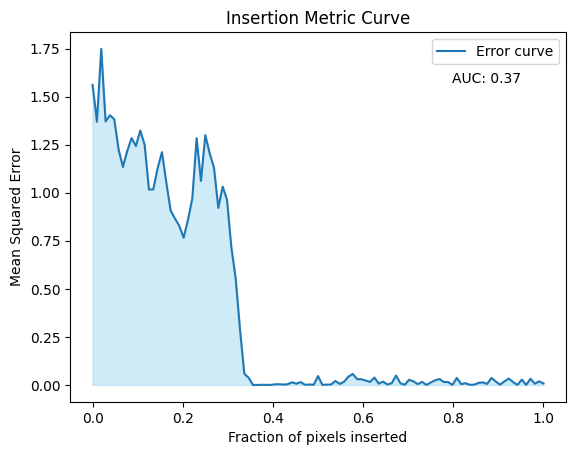

Errors: [1.5608178, 1.3693078, 1.747831, 1.3705897, 1.403034, 1.3817779, 1.225122, 1.1337036, 1.2180264, 1.2838817, 1.2428612, 1.3233227, 1.2497498, 1.0163169, 1.017456, 1.1273339, 1.2108213, 1.0538471, 0.9069363, 0.86565393, 0.82704, 0.7656553, 0.85871166, 0.969353, 1.2833122, 1.0613624, 1.2993212, 1.2056353, 1.1300915, 0.9210607, 1.031902, 0.9633552, 0.7171077, 0.55403364, 0.28947607, 0.057746813, 0.037138034, 2.0470452e-06, 2.3162249e-05, 0.0006665871, 0.0005048686, 4.1672465e-05, 0.0030050299, 0.0037006221, 0.0016388925, 0.0035842748, 0.013849778, 0.006334885, 0.014809742, 0.00066690723, 0.002065635, 0.00083218946, 0.04617956, 0.0005800435, 0.0014520828, 0.002203036, 0.020405078, 0.0054027284, 0.01647789, 0.042971883, 0.057276476, 0.030270947, 0.029324558, 0.022665197, 0.015571759, 0.038361758, 0.0071136537, 0.01694438, 0.0019743019, 0.009308876, 0.048864692, 0.00853557, 0.0008583488, 0.026992127, 0.018527703, 0.0044043455, 0.015860004, 1.3178071e-05, 0.012982378, 0.024085265, 0.03

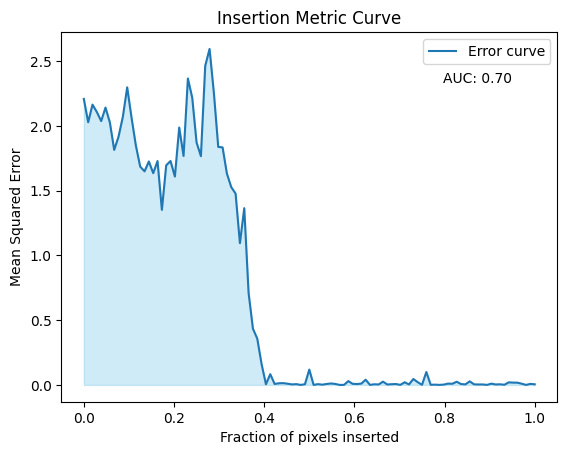

Errors: [2.208728, 2.0284634, 2.164724, 2.107616, 2.0375803, 2.1419744, 2.0279057, 1.815072, 1.9169011, 2.0707152, 2.2980595, 2.0645466, 1.8488083, 1.6859612, 1.6494769, 1.7255977, 1.6352996, 1.729017, 1.3518789, 1.6960626, 1.7291511, 1.6090423, 1.9877473, 1.768214, 2.3665907, 2.218571, 1.8728839, 1.7664748, 2.4643764, 2.5947585, 2.2533329, 1.8380312, 1.8343995, 1.6318163, 1.5276095, 1.4776347, 1.0948706, 1.3649851, 0.71084726, 0.4344058, 0.35764897, 0.16064866, 0.0050897137, 0.083007105, 0.0075840065, 0.012782401, 0.013830705, 0.0094286455, 0.0038798007, 0.0061076516, 0.00016688077, 0.0053121937, 0.11824718, 1.6057825e-06, 0.005987766, 0.0019899053, 0.007346417, 0.011261528, 0.007585626, 5.673642e-05, 0.00020764177, 0.029565362, 0.008571336, 0.006802156, 0.010303951, 0.040200733, 0.00032126374, 0.0050469744, 0.003587387, 0.025182206, 0.0033603052, 0.005573235, 0.0068059713, 0.00046136326, 0.020615548, 0.003899309, 0.045747843, 0.02144175, 0.00065900054, 0.09974196, 0.0011383423, 0.002

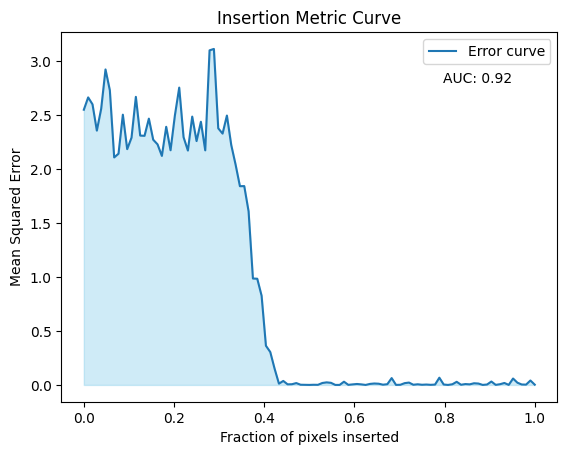

Errors: [2.5470755, 2.661313, 2.5972278, 2.3538444, 2.5557957, 2.9199774, 2.7271876, 2.1058106, 2.1402984, 2.5013514, 2.1824288, 2.288869, 2.6663616, 2.3078775, 2.3057296, 2.4647489, 2.2696774, 2.2268548, 2.119802, 2.3891246, 2.1721988, 2.4937027, 2.7519746, 2.293325, 2.1694088, 2.4834833, 2.2570143, 2.4360344, 2.171326, 3.0969071, 3.1099956, 2.375231, 2.326362, 2.4934258, 2.2206826, 2.0397444, 1.8395219, 1.8403378, 1.6067204, 0.98501164, 0.98291177, 0.8257227, 0.3625794, 0.3045006, 0.1501489, 0.011784774, 0.03684035, 0.005435936, 0.006405673, 0.017148707, 0.0017357601, 0.0009519832, 0.00017495947, 0.0014263953, 0.00091116206, 0.017815975, 0.023704045, 0.019499956, 9.262146e-05, 1.3302997e-05, 0.029780895, 0.0007841267, 0.0049370774, 0.008698237, 0.005051447, 1.7348663e-07, 0.009406017, 0.013179089, 0.011166194, 0.0021914802, 0.006679346, 0.06326923, 0.00037519998, 0.0013008291, 0.016527569, 0.021677207, 0.0015796345, 0.005887678, 0.0015274066, 0.0035441923, 0.0009570215, 0.003125514, 

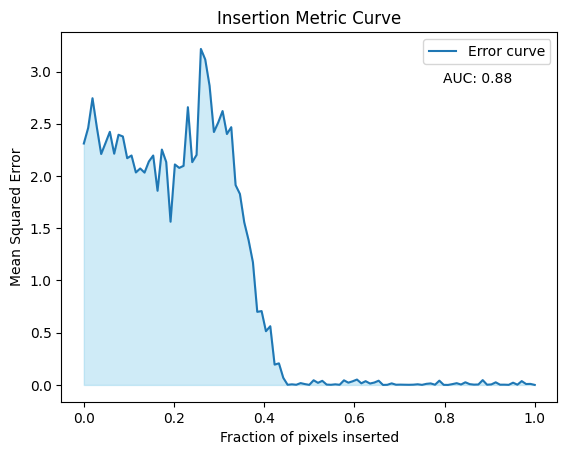

Errors: [2.3107653, 2.460143, 2.7443323, 2.4655263, 2.2104762, 2.3156824, 2.4226613, 2.213328, 2.3948069, 2.378273, 2.1704037, 2.1960516, 2.033889, 2.071956, 2.0324106, 2.1384661, 2.1960313, 1.8584793, 2.2529998, 2.1340907, 1.5622411, 2.1104283, 2.0775354, 2.0972474, 2.6585193, 2.1326895, 2.2014987, 3.2162704, 3.1153483, 2.8636935, 2.4211438, 2.512586, 2.6215909, 2.4018111, 2.4672, 1.9130102, 1.827788, 1.5561363, 1.3855752, 1.1737099, 0.69948643, 0.7069295, 0.5141805, 0.56199014, 0.19452116, 0.20649524, 0.06811897, 0.0014159332, 0.0056937016, 0.00152873, 0.017491594, 0.0079447385, 0.00070479146, 0.044728287, 0.020052556, 0.03924478, 0.0033217736, 0.0013111684, 0.005787671, 0.0013105297, 0.044099715, 0.021586457, 0.034898873, 0.05145975, 0.015508927, 0.035993826, 0.013424531, 0.022881288, 0.04043646, 1.9754461e-05, 0.0012240716, 0.0149731925, 0.001962307, 0.0028259552, 0.0019267926, 0.0013164227, 0.0023996474, 0.0062211254, 0.000559105, 0.010275703, 0.014412965, 0.0019452136, 0.04086138

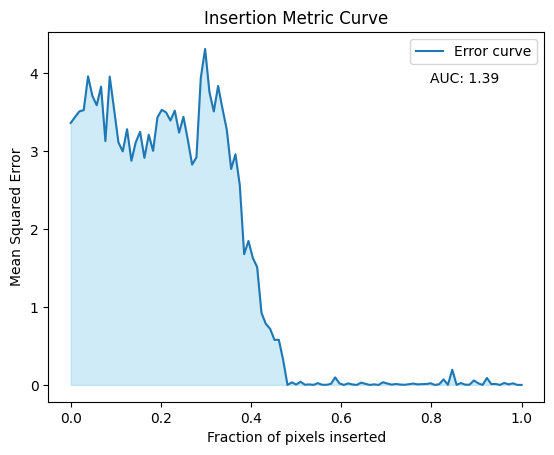

Errors: [3.3632407, 3.4397905, 3.5124402, 3.5281436, 3.9622662, 3.710843, 3.5907543, 3.8306406, 3.1299288, 3.9581625, 3.5407996, 3.1152616, 2.9979498, 3.2830071, 2.8779035, 3.1147423, 3.2491658, 2.914904, 3.212056, 3.0054448, 3.4340029, 3.5322533, 3.4984915, 3.394532, 3.5217896, 3.239372, 3.4415002, 3.1506426, 2.8289344, 2.9229958, 3.9410002, 4.3138247, 3.7590327, 3.5107608, 3.839306, 3.547922, 3.275912, 2.772755, 2.9615192, 2.5616074, 1.679481, 1.8478929, 1.6306297, 1.5128995, 0.9246834, 0.78441507, 0.7197937, 0.57821983, 0.57959634, 0.31916472, 3.0392648e-05, 0.032455754, 0.0052425675, 0.041176897, 0.0028094267, 0.0067102853, 0.0011119038, 0.022952318, 0.001919411, 0.0018522396, 0.012758746, 0.09656142, 0.018510442, 0.00028380984, 0.019487705, 0.005868923, 0.0001904045, 0.029432686, 0.013726038, 9.889396e-06, 0.0074868994, 3.246228e-06, 0.03414017, 0.01874473, 0.0034483594, 0.012188678, 0.0049246885, 0.0018873947, 0.009032572, 0.017424433, 0.00698271, 0.010284841, 0.011601625, 0.0212

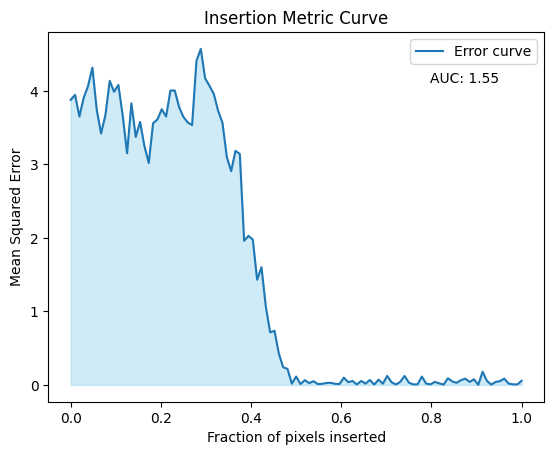

Errors: [3.8792925, 3.9474044, 3.652261, 3.9085474, 4.067854, 4.3180485, 3.745907, 3.4216812, 3.6695418, 4.1376696, 3.9897108, 4.0820885, 3.6623979, 3.1514049, 3.8321412, 3.3745348, 3.5792894, 3.2509942, 3.0208216, 3.5612934, 3.612368, 3.7523732, 3.6521502, 4.0067606, 4.0062413, 3.7820616, 3.6455762, 3.5720022, 3.536102, 4.4090524, 4.57234, 4.172455, 4.0705543, 3.9597528, 3.7301164, 3.5672936, 3.1031535, 2.908951, 3.1854036, 3.1440701, 1.9618195, 2.0280995, 1.977804, 1.4318141, 1.6022307, 1.0671619, 0.71498996, 0.73746485, 0.42719668, 0.24102709, 0.21811461, 0.017604092, 0.114083245, 0.011342739, 0.06535963, 0.024383003, 0.050606932, 0.011057272, 0.015110156, 0.02619333, 0.02850821, 0.014777669, 0.01208194, 0.09978759, 0.037178293, 0.053919453, 0.0061392933, 0.054182522, 0.018226478, 0.06736625, 0.005055006, 0.070939034, 0.017094923, 0.122345105, 0.036165282, 0.0061376123, 0.040935546, 0.122461386, 0.03133906, 0.00709372, 0.008011266, 0.11334921, 0.01721077, 0.007959238, 0.042445958, 0

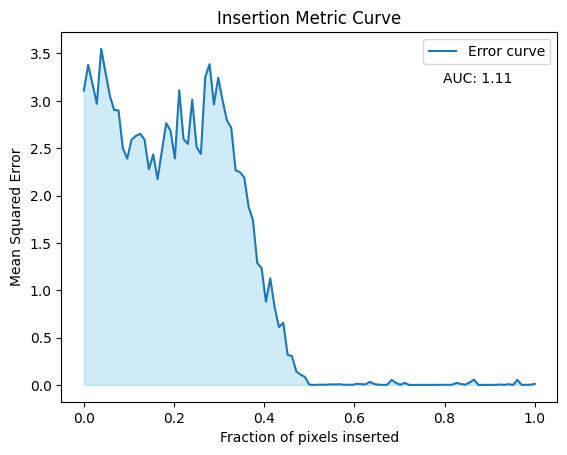

Errors: [3.1079125, 3.3790312, 3.1774526, 2.968968, 3.5476327, 3.299453, 3.0535152, 2.901514, 2.8993535, 2.4987736, 2.3892963, 2.5885556, 2.6296067, 2.6518204, 2.5899708, 2.2770045, 2.4335382, 2.1739068, 2.4699955, 2.7638402, 2.6825376, 2.3903291, 3.1111803, 2.5956457, 2.5446253, 3.010924, 2.5122955, 2.4399178, 3.2509964, 3.3863704, 2.9626205, 3.2416704, 3.0042048, 2.7937899, 2.7139885, 2.2665431, 2.2465634, 2.1912887, 1.8813583, 1.7394129, 1.2866795, 1.2331467, 0.878367, 1.1257911, 0.8228496, 0.6108885, 0.65593463, 0.3190909, 0.30416548, 0.14276598, 0.108963534, 0.084317364, 0.0034897286, 4.0918673e-07, 0.0025296945, 0.002014442, 0.0026679737, 0.0062335054, 0.0050747227, 0.0071401014, 0.00071306934, 0.0023747422, 0.0010596174, 0.012500936, 0.007245814, 0.0060411654, 0.032729246, 0.00962884, 0.0022376378, 0.00019876505, 0.002177284, 0.053805802, 0.020633077, 0.0012072797, 0.022267174, 5.4221982e-05, 2.6315329e-06, 1.0103476e-05, 0.0010176663, 0.00059229217, 0.00022107223, 0.0013451239,

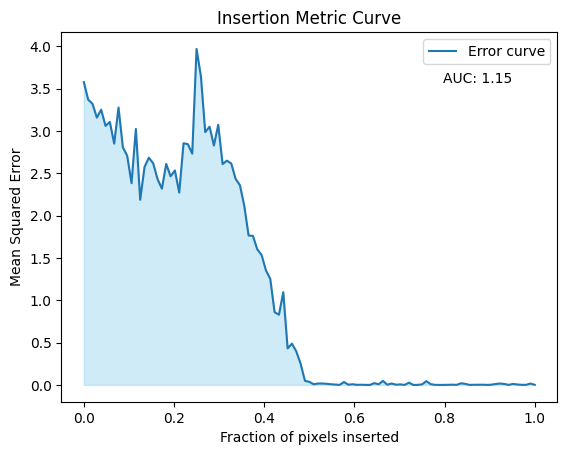

Errors: [3.5768406, 3.3701286, 3.3213086, 3.1576784, 3.251439, 3.0604868, 3.1060483, 2.8513079, 3.2773514, 2.8075645, 2.7068226, 2.3831248, 3.0238824, 2.1869712, 2.57492, 2.6842642, 2.61757, 2.43146, 2.3188188, 2.6108532, 2.4650147, 2.5341823, 2.2724903, 2.855499, 2.8442817, 2.7319822, 3.9693985, 3.646107, 2.986505, 3.0506504, 2.8283117, 3.0735638, 2.6088932, 2.649333, 2.6165857, 2.4347715, 2.359674, 2.117515, 1.7656118, 1.7605864, 1.6022469, 1.5349523, 1.3540462, 1.2524822, 0.8588016, 0.8298437, 1.0949165, 0.43198124, 0.48735273, 0.3965926, 0.25047228, 0.04803804, 0.036991242, 0.007873919, 0.016365152, 0.016781716, 0.0133548975, 0.008028902, 0.0041688783, 0.00050899124, 0.03440765, 0.0028098312, 0.008123949, 0.0010811773, 0.0020032218, 0.00039318117, 0.00012464443, 0.021049408, 0.008164787, 0.04698476, 0.0027709403, 0.016755905, 0.0031450582, 0.00613567, 0.00046274698, 0.026920415, 3.46796e-07, 0.00060822687, 0.0062749484, 0.04458862, 0.008944192, 0.0010519944, 0.00015437335, 0.000126

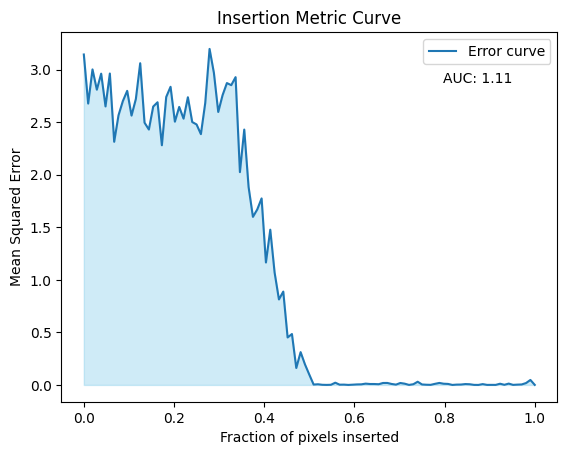

Errors: [3.1430447, 2.6764247, 3.0009737, 2.8083687, 2.960804, 2.6490264, 2.9620855, 2.3127756, 2.5650513, 2.6998286, 2.7971945, 2.5619311, 2.7198284, 3.0600083, 2.4947026, 2.4293716, 2.6476977, 2.6887047, 2.2797656, 2.738608, 2.835791, 2.5040305, 2.6443527, 2.532902, 2.736524, 2.5005713, 2.477718, 2.3855138, 2.6814353, 3.1960058, 2.967901, 2.596181, 2.7559645, 2.8713455, 2.851379, 2.927637, 2.0242498, 2.4288764, 1.8830503, 1.5986785, 1.669322, 1.7741288, 1.1646068, 1.4765481, 1.0691595, 0.8131932, 0.8878499, 0.45159864, 0.4841991, 0.16103189, 0.31196067, 0.1956726, 0.09832302, 0.0035660274, 0.0062487996, 0.0013062522, 0.00022345371, 0.0013656807, 0.021321682, 0.0022900915, 0.0028723544, 5.3689593e-05, 0.002300303, 0.0047817184, 0.005615141, 0.012310747, 0.008674017, 0.0086047435, 0.0067306515, 0.018463437, 0.01876948, 0.009015993, 0.0029385374, 0.018350288, 0.011866236, 0.00017168258, 0.006729204, 0.030309288, 0.0043208217, 0.0018371866, 0.00076723425, 0.0104685435, 0.018808829, 0.011

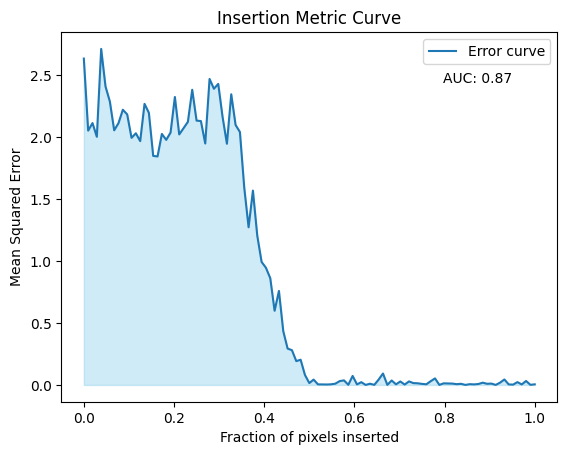

Errors: [2.6336462, 2.0521083, 2.1131, 2.0023072, 2.7113833, 2.40838, 2.287436, 2.0546918, 2.1130016, 2.2206671, 2.1829157, 1.9939505, 2.0305955, 1.967542, 2.267961, 2.1958935, 1.8479666, 1.843876, 2.0254388, 1.9776062, 2.0360625, 2.3237233, 2.0216444, 2.0717802, 2.123046, 2.3818088, 2.132824, 2.1293066, 1.9483495, 2.4691727, 2.3900452, 2.4292233, 2.1624746, 1.9462774, 2.3453634, 2.0978513, 2.0410058, 1.592057, 1.2722843, 1.5682977, 1.2045962, 0.99275976, 0.9455199, 0.8612948, 0.5983959, 0.75841415, 0.43342346, 0.29334605, 0.2804546, 0.19202718, 0.2035324, 0.080366686, 0.015090878, 0.04293749, 0.0044316025, 0.0040687183, 0.0033663614, 0.0048888484, 0.009999457, 0.03068877, 0.036843553, 0.001014763, 0.07269119, 0.004401466, 0.022188548, 6.303688e-05, 0.009707749, 0.0005808706, 0.043368775, 0.09210237, 0.00051576964, 0.035864577, 0.004778389, 0.027819622, 0.0030122749, 0.02833706, 0.014806724, 0.013241404, 0.008341919, 0.0051177153, 0.030046288, 0.052689318, 0.00033100284, 0.012792593, 0

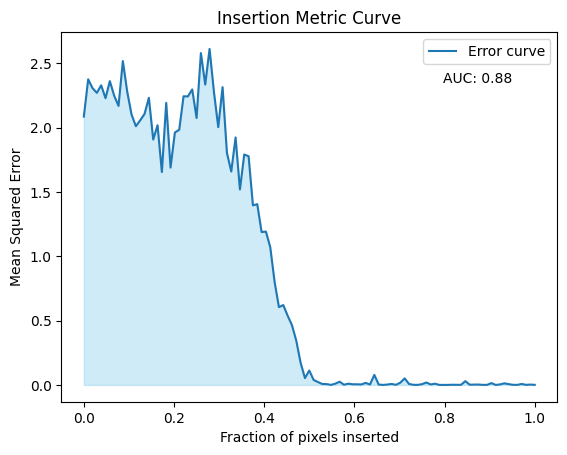

Errors: [2.084621, 2.3745716, 2.3060005, 2.2694862, 2.3280547, 2.2278707, 2.3606062, 2.2469704, 2.168064, 2.516276, 2.2790308, 2.1015334, 2.0101538, 2.0559862, 2.105564, 2.2311416, 1.9066867, 2.017814, 1.6541051, 2.1915314, 1.6888877, 1.9614435, 1.9827571, 2.2427425, 2.24164, 2.2957544, 2.0741296, 2.5782807, 2.3338401, 2.6106143, 2.2785997, 2.0030043, 2.3135865, 1.8041435, 1.6580155, 1.9228739, 1.5188378, 1.790477, 1.7768154, 1.3951246, 1.4044899, 1.187899, 1.1911829, 1.0697106, 0.799714, 0.60427797, 0.6206417, 0.5383346, 0.46461478, 0.34327108, 0.17192985, 0.053224698, 0.11198363, 0.038647793, 0.022516625, 0.0071097133, 0.0063821473, 0.000270608, 0.009709534, 0.025039319, 0.0014658703, 0.00981932, 0.0050047524, 0.0050149113, 0.0035504971, 0.015847756, 0.003292323, 0.07798863, 0.0030615185, 9.567968e-05, 0.0029821754, 0.007548792, 0.0008526167, 0.017758485, 0.050812457, 0.0074961856, 0.00095784775, 0.00030428116, 0.00579983, 0.01896814, 0.0036545577, 0.009352495, 0.00010262994, 3.16595

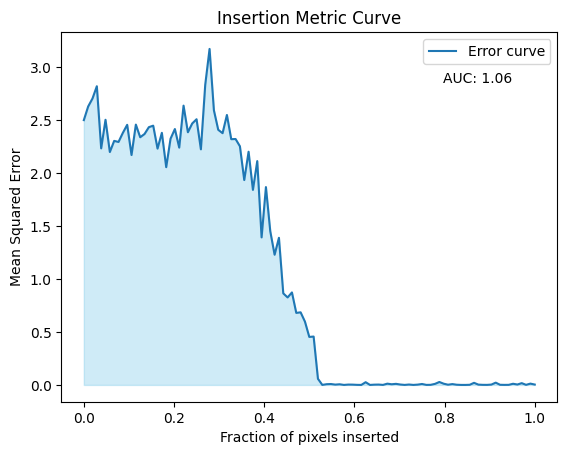

Errors: [2.4995828, 2.6283252, 2.7038674, 2.8196647, 2.232989, 2.5028117, 2.1985164, 2.3035636, 2.2935622, 2.3794322, 2.4552362, 2.1702964, 2.457397, 2.3381252, 2.3685486, 2.4331248, 2.4472659, 2.2306612, 2.3798373, 2.0555322, 2.3242333, 2.415526, 2.2402146, 2.6362898, 2.3852475, 2.4680429, 2.507993, 2.2239575, 2.83288, 3.171699, 2.5926578, 2.4082384, 2.3764303, 2.5483515, 2.3197513, 2.321301, 2.2527187, 1.9341257, 2.2012432, 1.8412367, 2.1128922, 1.392673, 1.8675494, 1.4512604, 1.2289191, 1.3885806, 0.8642776, 0.8259673, 0.87309927, 0.6798375, 0.6853583, 0.59742284, 0.45306104, 0.45661616, 0.057691135, 0.0002137254, 0.0068003475, 0.008366063, 0.0029616656, 0.0061127204, 0.00011909128, 0.003287783, 0.0027340157, 0.0006335813, 3.2834643e-05, 0.025742283, 1.5851163e-05, 0.00248728, 0.0033184492, 0.00021501, 0.011811655, 0.0062575475, 0.010084655, 0.0037551231, 0.00017595742, 0.003769923, 0.00012860421, 0.0028092247, 0.008763109, 0.0003772903, 0.00089508406, 0.009996024, 0.027718788, 0.01

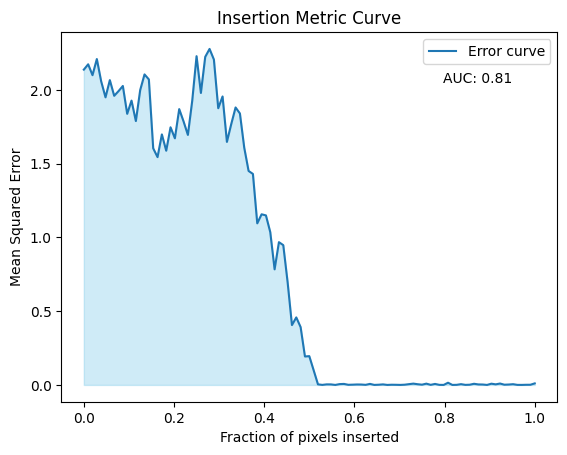

Errors: [2.1385224, 2.1747432, 2.1008966, 2.2103574, 2.059062, 1.9506963, 2.0673368, 1.9610609, 1.9926748, 2.0277462, 1.8387885, 1.9283596, 1.789618, 2.0000513, 2.1060967, 2.0721145, 1.6048908, 1.545152, 1.6991391, 1.5886143, 1.747396, 1.6727794, 1.8708384, 1.7873274, 1.6957164, 1.9271907, 2.2297177, 1.9803456, 2.225213, 2.2789645, 2.20678, 1.8767537, 1.9565765, 1.6485159, 1.7691842, 1.881931, 1.8412135, 1.6086918, 1.4513155, 1.4312005, 1.096026, 1.1573035, 1.1498402, 1.0362985, 0.78402865, 0.96823597, 0.94811267, 0.6973728, 0.40601122, 0.45789304, 0.39218864, 0.1929283, 0.19527805, 0.10011352, 0.003984, 0.00023515015, 0.003725494, 0.0034986355, 2.1970868e-07, 0.005540959, 0.0067915027, 0.00089220464, 0.0017280605, 0.0029906966, 0.0026405577, 0.0006043992, 0.0069685723, 0.000110544635, 0.0013643947, 0.0035777974, 7.811337e-07, 0.0012933759, 0.00085353584, 0.00014131385, 0.0015143153, 0.0052469186, 0.00881595, 0.00473977, 0.0017064236, 0.008671086, 0.0005501102, 0.006745643, 0.000479022

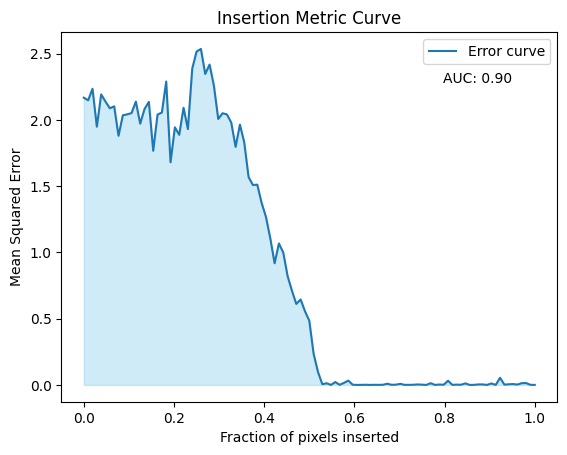

Errors: [2.1674488, 2.1476467, 2.234535, 1.948653, 2.1919713, 2.1378024, 2.087469, 2.1022675, 1.8798072, 2.0344753, 2.0418432, 2.0510345, 2.1377418, 1.9716202, 2.0822592, 2.1356454, 1.7670269, 2.0398114, 2.055463, 2.2893388, 1.6803175, 1.9440389, 1.8871216, 2.0913937, 1.9304934, 2.3859859, 2.5155513, 2.5353298, 2.346668, 2.417306, 2.2579124, 2.0066736, 2.0499618, 2.041173, 1.9799159, 1.7963283, 1.9641314, 1.8302759, 1.5685321, 1.5081533, 1.5113474, 1.3744448, 1.2682345, 1.1073834, 0.918226, 1.0674059, 0.9984573, 0.82108426, 0.71068805, 0.61116767, 0.6448258, 0.5563311, 0.48450443, 0.23435614, 0.098400936, 0.005541101, 0.012838638, 3.1397249e-06, 0.021881634, 0.0009358537, 0.015391159, 0.032701127, 0.0017811292, 4.892617e-05, 0.0004117864, 0.001121209, 9.917908e-06, 0.0008380735, 0.0005751272, 0.0010916446, 0.008934318, 0.0008218227, 0.0022662624, 0.0081429565, 0.0005692644, 0.00052065426, 0.0011205225, 0.0035275484, 0.0018518086, 7.5187025e-05, 0.013063239, 2.0391076e-07, 0.0030231455,

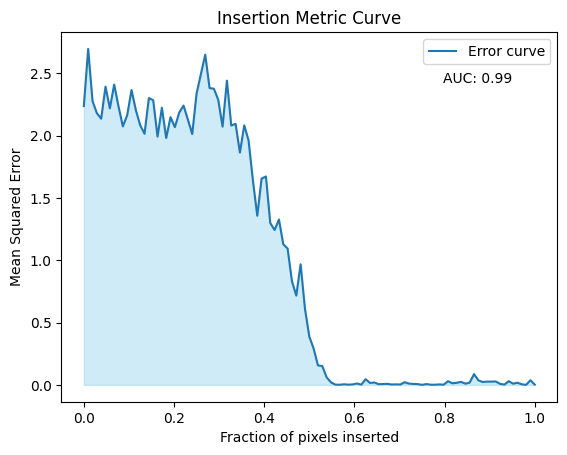

Errors: [2.237551, 2.6963701, 2.2784557, 2.1811135, 2.1367657, 2.39336, 2.219236, 2.4103787, 2.234438, 2.0745957, 2.1646602, 2.3667924, 2.2048876, 2.0835323, 2.0156224, 2.3021088, 2.2845962, 1.9930006, 2.2240074, 1.9817289, 2.1489766, 2.06855, 2.1857073, 2.2418978, 2.129338, 2.0134776, 2.3369021, 2.4945557, 2.6504455, 2.382307, 2.3769827, 2.28811, 2.072852, 2.4418128, 2.0818205, 2.0950882, 1.8646588, 2.083017, 1.9612137, 1.6393962, 1.3578497, 1.6557616, 1.6728292, 1.2989885, 1.2434696, 1.3274429, 1.1290355, 1.0945774, 0.8320596, 0.7170282, 0.967984, 0.6121891, 0.38864833, 0.29166743, 0.15667, 0.1511065, 0.061023597, 0.0206792, 0.0023918287, 0.0014847716, 0.0050775083, 0.0023041237, 0.0041406937, 0.011489929, 0.002425622, 0.045681473, 0.016027808, 0.019574469, 0.005644013, 0.007333222, 0.008645751, 0.0033296384, 0.004663458, 0.0036389793, 0.021861607, 0.010611342, 0.007836644, 0.0068088435, 0.0006329574, 0.006795826, 0.0020126875, 0.001752947, 0.0040153326, 0.0021023136, 0.029787973, 0.

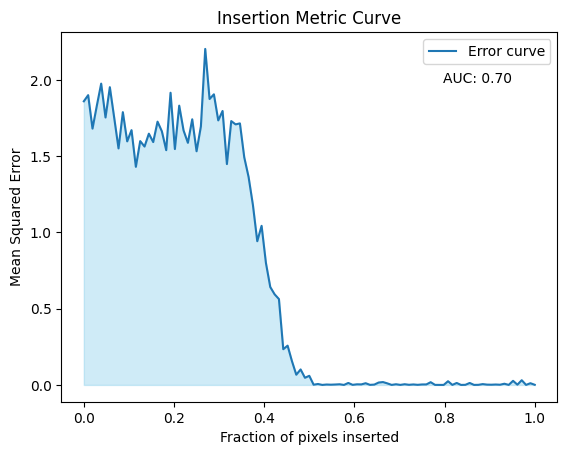

Errors: [1.8602273, 1.9004837, 1.6811323, 1.8315682, 1.9759786, 1.7540454, 1.9527425, 1.7532469, 1.5511307, 1.7888788, 1.5973984, 1.6710035, 1.4304998, 1.5991062, 1.5633707, 1.647774, 1.592764, 1.726592, 1.6633041, 1.5396808, 1.916243, 1.5469475, 1.8315486, 1.6691071, 1.5879269, 1.74206, 1.5325806, 1.6955111, 2.203651, 1.8752232, 1.9059101, 1.7349368, 1.7966917, 1.4483848, 1.7303973, 1.7087973, 1.7152988, 1.4928455, 1.3637428, 1.1799232, 0.94246775, 1.0434903, 0.79977036, 0.6420067, 0.5944201, 0.5631228, 0.23422055, 0.25750765, 0.1561302, 0.067058064, 0.10154816, 0.046897255, 0.059782136, 0.0014374381, 0.006106012, 9.458209e-05, 0.002619405, 0.0015777966, 0.0027580287, 0.004328724, 3.898035e-06, 0.012929432, 0.00051519583, 0.00409324, 0.00342513, 0.011197406, 0.00041355903, 0.0021758603, 0.015762331, 0.01874721, 0.010175529, 0.00020634517, 0.0043899585, 0.00028052583, 0.00450312, 0.0008362937, 0.0031001603, 0.0006912362, 0.0030444195, 0.0033038794, 0.01788765, 0.00032422773, 8.35573e-0

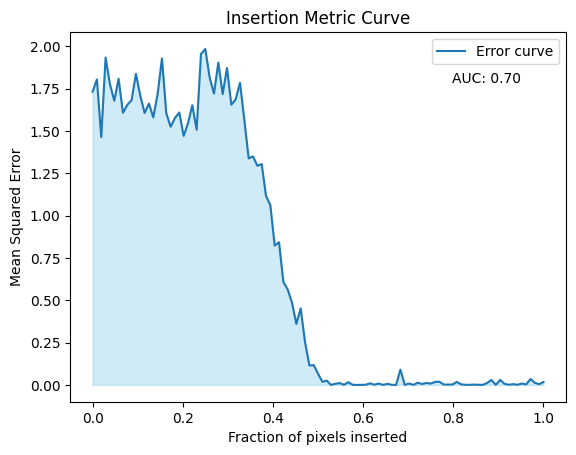

Errors: [1.7314446, 1.8039838, 1.4632624, 1.9333293, 1.7757881, 1.6782694, 1.8078337, 1.6072035, 1.6534173, 1.6820328, 1.8369349, 1.7080624, 1.6057894, 1.6615419, 1.5796621, 1.7180387, 1.9273744, 1.6040717, 1.5243833, 1.5765218, 1.6086468, 1.4708391, 1.544044, 1.651945, 1.5071828, 1.9538164, 1.9841439, 1.8145571, 1.7202401, 1.9033397, 1.7173656, 1.8718436, 1.6544029, 1.6863288, 1.7839787, 1.5639988, 1.3377073, 1.3494672, 1.2944621, 1.303905, 1.1160108, 1.0612737, 0.8228405, 0.84260446, 0.6078236, 0.5638466, 0.48500425, 0.3603835, 0.45219246, 0.2521523, 0.115056165, 0.11678371, 0.066151105, 0.018514497, 0.025290795, 0.00014691772, 0.0069514266, 0.010729014, 0.00076000026, 0.016177174, 0.0005510165, 6.3556326e-06, 0.0003947807, 0.0010543311, 0.009208165, 0.001364747, 0.008228852, 1.5780997e-05, 0.0063329684, 0.0006273554, 2.8580356e-05, 0.09027799, 0.00040013276, 0.008106702, 0.00013225825, 0.013180376, 0.0054926854, 0.011618606, 0.007975923, 0.017875247, 0.019017626, 0.0022578032, 0.002

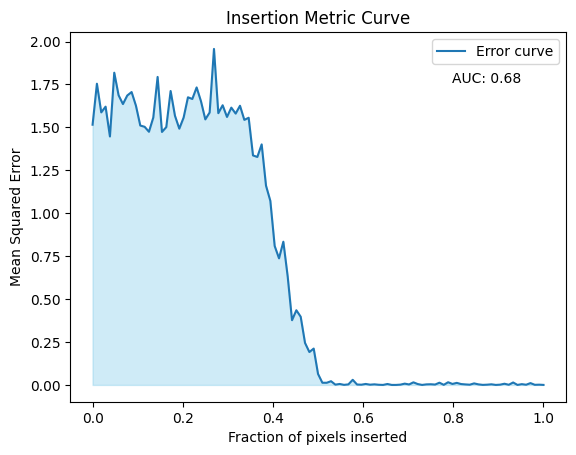

Errors: [1.5154754, 1.754147, 1.587266, 1.620624, 1.4470049, 1.8183365, 1.6869369, 1.6358097, 1.685604, 1.7057247, 1.6263236, 1.5107261, 1.503351, 1.4744201, 1.5570682, 1.7937734, 1.4733711, 1.501435, 1.7117238, 1.5676681, 1.4924686, 1.5571733, 1.6752244, 1.6653482, 1.7325984, 1.6522486, 1.5465246, 1.5866935, 1.9568512, 1.5826867, 1.6288339, 1.560732, 1.6149511, 1.580312, 1.6258508, 1.5436808, 1.5559176, 1.336586, 1.3277258, 1.4008704, 1.1604619, 1.0718042, 0.8091955, 0.73723394, 0.83408755, 0.63167506, 0.3770232, 0.43482125, 0.39718512, 0.24452993, 0.19153613, 0.21165389, 0.06393954, 0.012739255, 0.012552998, 0.021637315, 0.001665426, 0.005566634, 0.00041059224, 0.003132142, 0.029789742, 0.002325149, 0.0013256862, 0.0056226826, 0.0013947419, 0.0034036615, 0.00092894485, 4.418724e-05, 0.005376526, 8.774942e-07, 6.442439e-05, 0.0016153783, 0.007453393, 0.0027114113, 0.0151023315, 0.0050234753, 2.4725337e-05, 0.003183186, 0.0039268704, 0.0021292036, 0.013022995, 0.00048744498, 0.01566236

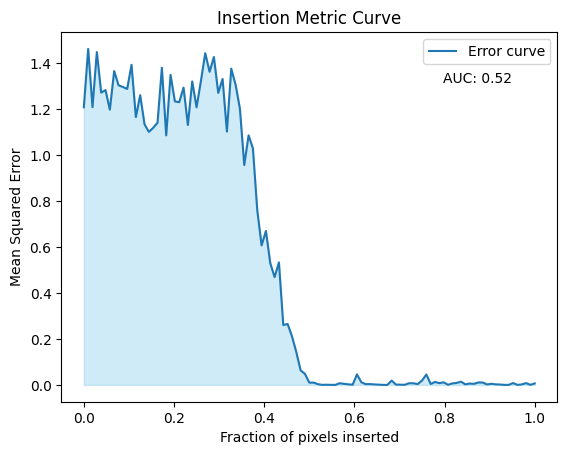

Errors: [1.209221, 1.4634494, 1.2099292, 1.4497128, 1.2731717, 1.2841434, 1.1992621, 1.3669416, 1.3052211, 1.2977103, 1.2892188, 1.3942652, 1.1668007, 1.2620372, 1.1351196, 1.1021229, 1.1199363, 1.1424342, 1.3813173, 1.0869524, 1.3505043, 1.2350894, 1.2314194, 1.2951007, 1.1319532, 1.3219012, 1.2089678, 1.323273, 1.4448594, 1.3639135, 1.4282753, 1.2720453, 1.3326209, 1.103644, 1.3774102, 1.307991, 1.2028363, 0.95776975, 1.0870422, 1.0300261, 0.7609304, 0.6076411, 0.6706177, 0.5305042, 0.46966305, 0.53387445, 0.2608605, 0.26539385, 0.21237646, 0.14347294, 0.063555606, 0.048065893, 0.010151805, 0.010134493, 0.0031510913, 0.00032992364, 0.00070445606, 0.0003614189, 5.403605e-05, 0.007554697, 0.0047400817, 0.0025284954, 0.00092284364, 0.045790076, 0.011631021, 0.0034449582, 0.003560733, 0.0021326263, 0.0012040677, 0.00016918321, 1.86688e-05, 0.018916951, 0.001350244, 0.0011582086, 0.00038790412, 0.007381771, 0.0072469506, 0.0037085018, 0.01901585, 0.04544086, 0.004065419, 0.013062095, 0.00

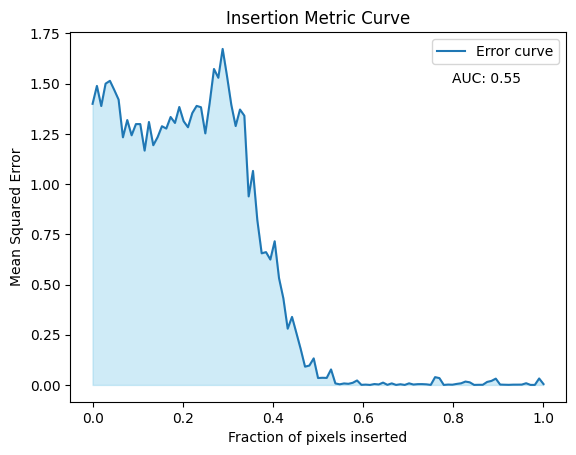

Errors: [1.3997834, 1.4890447, 1.3886733, 1.5002481, 1.5143611, 1.4688299, 1.4208223, 1.2329383, 1.3189634, 1.2430629, 1.2988787, 1.2989627, 1.1668428, 1.3093182, 1.1936327, 1.233828, 1.2882872, 1.2766476, 1.3342155, 1.3045397, 1.3840452, 1.3131567, 1.2831532, 1.3538561, 1.3894764, 1.3828512, 1.2525833, 1.4029832, 1.5733728, 1.5295231, 1.6731791, 1.5385787, 1.394561, 1.2890737, 1.3713845, 1.3407608, 0.93876195, 1.0656445, 0.82007974, 0.65539926, 0.66130686, 0.6243695, 0.71557575, 0.5318516, 0.43141088, 0.28008768, 0.3387075, 0.25914624, 0.17867492, 0.09101267, 0.096487716, 0.13222916, 0.034411453, 0.03559436, 0.034926537, 0.07713679, 0.0075138244, 0.0030399351, 0.007412365, 0.0055306526, 0.010601668, 0.022222264, 0.0004449453, 0.0015674154, 2.2619286e-05, 0.0043908907, 0.0023085205, 0.011598312, 0.0003735623, 0.0077060605, 2.6470261e-06, 0.003337209, 1.3219793e-06, 0.007940659, 0.0018993978, 0.0038456898, 0.004004281, 0.0029497924, 0.00015015174, 0.03877863, 0.033882815, 8.327948e-06, 

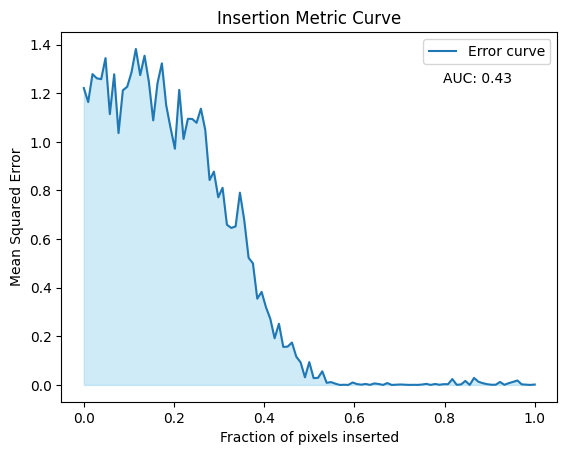

Errors: [1.2211908, 1.163575, 1.2786955, 1.261297, 1.2579238, 1.3444184, 1.1142373, 1.277934, 1.0361195, 1.2121397, 1.2265654, 1.2863834, 1.3822513, 1.2744781, 1.3544557, 1.2467916, 1.0883656, 1.2423729, 1.3229579, 1.1500049, 1.0572582, 0.9716607, 1.2137097, 1.0119517, 1.094685, 1.0942447, 1.0783814, 1.1364292, 1.0499293, 0.842916, 0.87748873, 0.77191406, 0.8110118, 0.6590564, 0.6459306, 0.65209264, 0.79090875, 0.67789495, 0.5230056, 0.50024116, 0.35492614, 0.3828098, 0.32013094, 0.27254072, 0.19201474, 0.25170293, 0.15640125, 0.15758824, 0.174413, 0.11622691, 0.09284174, 0.031202503, 0.0938558, 0.02799475, 0.029095309, 0.05599436, 0.008749924, 0.011692582, 0.005309518, 2.115837e-06, 0.0006810129, 0.0001049471, 0.010099744, 0.0035877584, 0.0011076784, 0.0039961687, 0.00026973017, 0.0061420584, 0.003961669, 4.262127e-05, 0.007619594, 8.147298e-06, 0.00086853513, 0.0018763694, 0.0009841694, 0.00014034056, 0.00043110875, 0.00015808942, 0.0016013323, 0.004329053, 6.454501e-05, 0.003935376,

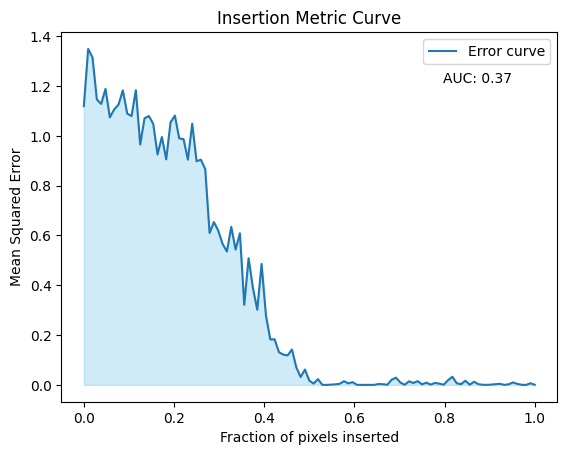

Errors: [1.1190658, 1.3488144, 1.3145412, 1.1460359, 1.1280223, 1.1881601, 1.0742571, 1.1060114, 1.1254855, 1.1823148, 1.0895162, 1.0792862, 1.1828442, 0.9651026, 1.0705689, 1.0793923, 1.0482653, 0.9252438, 0.9953165, 0.9056371, 1.0540448, 1.0811412, 0.98990864, 0.98650926, 0.90467376, 1.0487204, 0.8980038, 0.9041553, 0.86645484, 0.609854, 0.65385747, 0.6193241, 0.566066, 0.5356495, 0.6347216, 0.5434076, 0.60881364, 0.32150647, 0.5085233, 0.38977432, 0.3016609, 0.4856889, 0.27944982, 0.18259984, 0.18312877, 0.13147372, 0.1216007, 0.11845157, 0.14217483, 0.070950024, 0.0315854, 0.061722387, 0.017345686, 0.0054475614, 0.023388796, 0.00040546324, 0.0001187247, 0.0012072797, 0.0021880553, 0.0044645495, 0.014861606, 0.0064622415, 0.011017295, 0.00039082565, 0.00016292823, 9.074495e-05, 0.00020712677, 0.00023491256, 0.0038353915, 0.0026752814, 0.00068810553, 0.020936172, 0.0290369, 0.00979427, 0.0006301712, 0.014509901, 0.007861949, 0.015175934, 0.0022290973, 0.009145221, 0.0013581931, 0.008

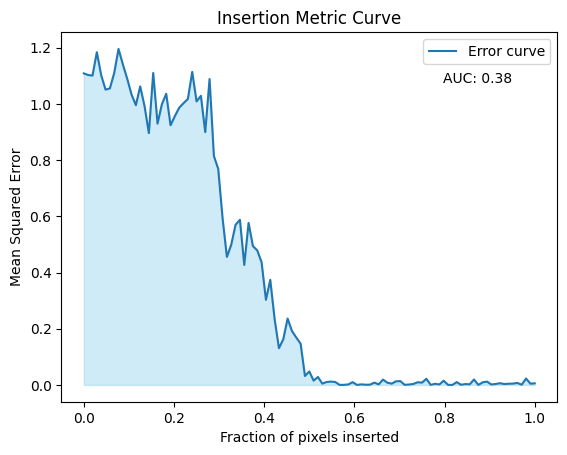

Errors: [1.1085275, 1.1027392, 1.100802, 1.1839921, 1.10217, 1.0509832, 1.0548719, 1.1094176, 1.1955397, 1.1405724, 1.0897071, 1.0335418, 0.99530214, 1.0620775, 0.9920567, 0.8961922, 1.1099269, 0.92985064, 0.99854356, 1.0360243, 0.924073, 0.9566064, 0.98646307, 1.0026585, 1.017515, 1.1136166, 1.0088165, 1.0287322, 0.89949167, 1.088315, 0.814363, 0.7683555, 0.593166, 0.45549378, 0.49915716, 0.5700117, 0.58764195, 0.42694318, 0.5764078, 0.49384612, 0.47869083, 0.43626535, 0.30308902, 0.37387353, 0.23490563, 0.13077632, 0.16239804, 0.23614287, 0.19193567, 0.16858234, 0.14677294, 0.031922817, 0.047934942, 0.015236882, 0.028299628, 0.0046956534, 0.010443117, 0.011905694, 0.010325381, 4.6201854e-05, 0.00033025717, 0.0016731409, 0.009884208, 6.0492684e-06, 0.0019845061, 0.00061207253, 0.00088088197, 0.008269129, 0.0019716332, 0.018995209, 0.00806329, 0.0045770174, 0.012750102, 0.013712214, 0.00033508844, 0.0014829531, 0.0033853534, 0.009549856, 0.008240168, 0.02183863, 0.0003131408, 0.0040273

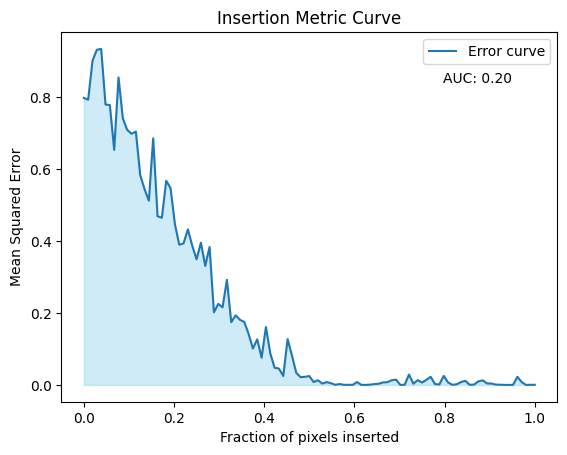

Errors: [0.798453, 0.7933985, 0.9017974, 0.9322524, 0.9346735, 0.7800282, 0.77838284, 0.653921, 0.85514575, 0.7410787, 0.7096132, 0.69874585, 0.70472044, 0.5836386, 0.5446908, 0.51253885, 0.68613774, 0.46930838, 0.46504918, 0.5680655, 0.5472548, 0.44781786, 0.3900749, 0.39379776, 0.43275788, 0.38747427, 0.3494533, 0.39566252, 0.33115116, 0.38368252, 0.20198281, 0.22545235, 0.21589223, 0.2923251, 0.17446318, 0.1935968, 0.18125212, 0.17525557, 0.14180163, 0.10116318, 0.12671278, 0.075720936, 0.16103907, 0.08782304, 0.0479494, 0.045457635, 0.024886383, 0.12760472, 0.08179267, 0.03338292, 0.021553962, 0.02257111, 0.024688264, 0.008149455, 0.012907374, 0.0038450246, 0.007790258, 0.004872492, 0.00028783252, 0.0024954434, 0.0001894943, 0.00031595695, 5.2906333e-05, 0.0080065075, 0.00017842335, 2.6551784e-06, 0.0007135724, 0.0023688206, 0.003266028, 0.0069023743, 0.0076751583, 0.01294234, 0.014796281, 0.0001040113, 0.00050591916, 0.02892508, 0.0035085143, 0.013292592, 0.0067181196, 0.014027872

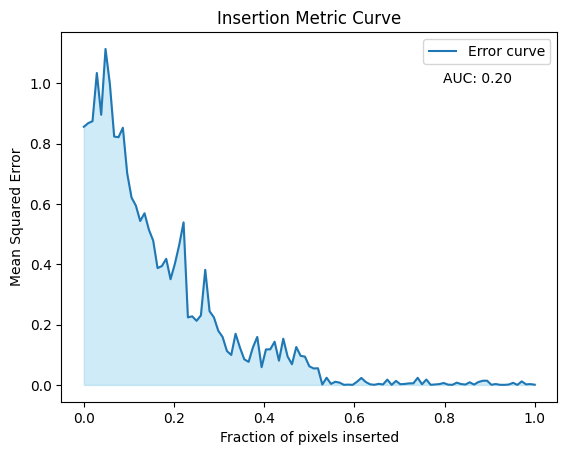

Errors: [0.85606426, 0.86807466, 0.87462485, 1.0343606, 0.89588755, 1.1142364, 0.9984733, 0.82357806, 0.8215087, 0.8528167, 0.70152545, 0.62134385, 0.5947159, 0.5436989, 0.5692604, 0.5149171, 0.4784624, 0.3874397, 0.39421082, 0.4182106, 0.3506704, 0.40187883, 0.46433845, 0.5390791, 0.2239692, 0.22745223, 0.21267585, 0.23048334, 0.38163602, 0.244285, 0.22425318, 0.17982385, 0.15913275, 0.1124096, 0.09946265, 0.16971537, 0.1240777, 0.085090004, 0.076481186, 0.124508224, 0.15913512, 0.058888122, 0.11776707, 0.11813923, 0.14337416, 0.08045741, 0.1533205, 0.09432875, 0.0686731, 0.12582923, 0.096494675, 0.09392783, 0.061893392, 0.054601833, 0.055243216, 0.0012799747, 0.023799066, 0.003450684, 0.010516484, 0.007538562, 0.00027741975, 0.0010789285, 0.00024348541, 0.010506658, 0.02314782, 0.009982965, 0.0021295776, 0.00043503335, 0.0035518042, 0.0015304364, 0.017636532, 0.00023554883, 0.013303892, 0.0023100788, 0.0031954926, 0.0051672976, 0.0052917954, 0.023554115, 0.002238371, 0.01786677, 0.00

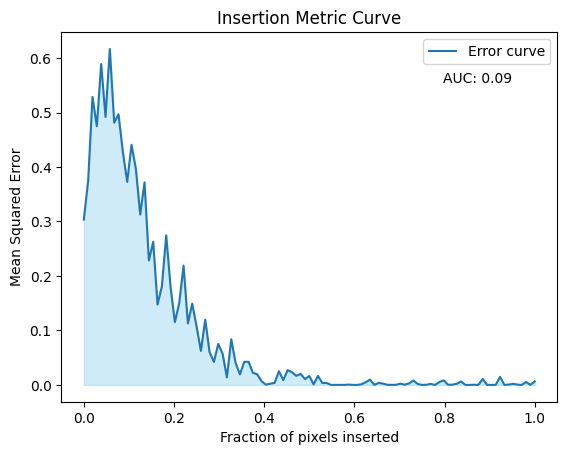

Errors: [0.30345455, 0.37539476, 0.5286576, 0.47487956, 0.58889, 0.49193978, 0.6166993, 0.48148984, 0.49672246, 0.42760035, 0.3726168, 0.4406935, 0.3965904, 0.31279197, 0.37177882, 0.22850832, 0.26253736, 0.14750403, 0.18091482, 0.27459067, 0.18023688, 0.115313075, 0.15002766, 0.21907264, 0.11290984, 0.14927013, 0.10745709, 0.06246311, 0.119668126, 0.060120896, 0.04211622, 0.075206734, 0.057553265, 0.013879283, 0.08381177, 0.040562794, 0.019325823, 0.042257007, 0.042510133, 0.022141835, 0.019494696, 0.006670172, 0.00054399844, 0.0022489866, 0.0037628703, 0.025138374, 0.008786492, 0.02725824, 0.023272116, 0.016667724, 0.020332431, 0.010802188, 0.016369086, 0.00093095156, 0.016705329, 0.003550767, 0.0036330994, 2.5809877e-05, 0.00010473228, 1.3047705e-05, 3.521943e-05, 0.0006122259, 8.929046e-05, 1.86585e-05, 0.0010622811, 0.004967647, 0.009646886, 3.0985673e-05, 0.0037508144, 0.002417714, 0.00022630322, 0.0001327138, 0.00015658814, 0.0023657465, 0.0004758293, 0.0027280725, 0.008186711, 

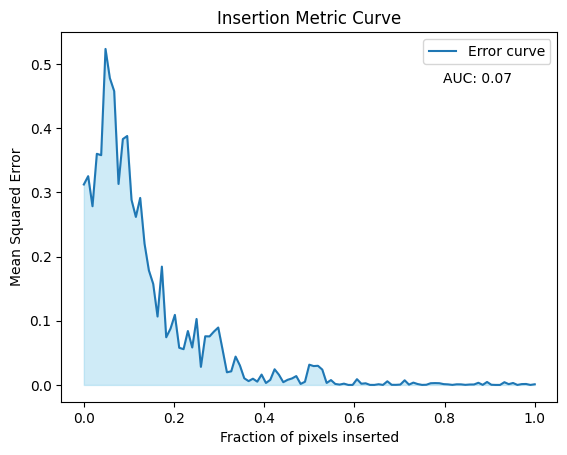

Errors: [0.31214786, 0.3251191, 0.27830645, 0.3599626, 0.35780817, 0.52330196, 0.47786492, 0.4576059, 0.31298715, 0.3829053, 0.38768488, 0.28827152, 0.26164818, 0.291237, 0.21999738, 0.17840911, 0.15738127, 0.10652337, 0.18426764, 0.07423847, 0.08780121, 0.10910863, 0.05786891, 0.055693723, 0.08395388, 0.058296584, 0.10271468, 0.028145703, 0.07575381, 0.075587295, 0.083042346, 0.08939282, 0.054969423, 0.019690221, 0.02122126, 0.044112585, 0.030248884, 0.01037457, 0.0059562046, 0.009693026, 0.0051192506, 0.016111074, 0.0030189392, 0.00788685, 0.024378275, 0.01585448, 0.0042762407, 0.007972367, 0.010074362, 0.013772333, 0.0015674909, 0.004917062, 0.03153563, 0.029370384, 0.02979114, 0.023876773, 0.0030647516, 0.0075573907, 0.0014969507, 0.0005201213, 0.0019895756, 1.5656224e-05, 3.6781066e-06, 0.008949807, 0.0018812575, 0.0025353937, 5.3666885e-05, 1.3147796e-05, 0.0010787875, 2.0463272e-05, 0.0056624953, 0.0001816158, 0.00013721458, 0.00053934846, 0.0072173686, 0.00046350123, 0.00361232

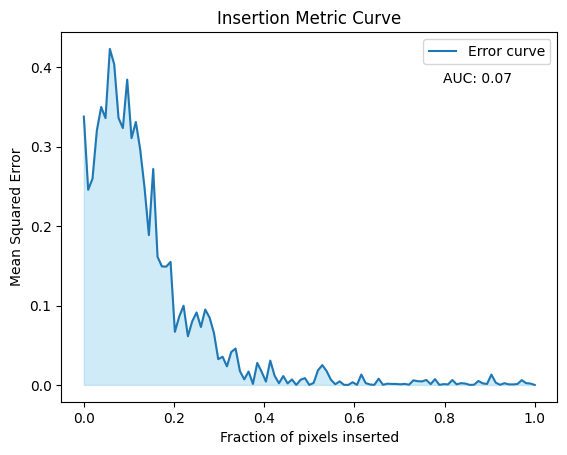

Errors: [0.33787853, 0.24569799, 0.25976244, 0.3203323, 0.34995818, 0.335974, 0.42307806, 0.4038217, 0.33616072, 0.3234099, 0.3844199, 0.31079164, 0.33112413, 0.29636925, 0.2483344, 0.1886909, 0.27190375, 0.16134174, 0.14924628, 0.14895922, 0.15489374, 0.06688025, 0.08603736, 0.09974, 0.06125976, 0.08014494, 0.091221385, 0.07292883, 0.09497519, 0.08478129, 0.0656171, 0.032452572, 0.03552382, 0.023380335, 0.041445553, 0.045839783, 0.017351087, 0.007033086, 0.01686744, 0.0012864484, 0.027738042, 0.016665293, 0.004164477, 0.03059958, 0.0116039105, 0.0020895647, 0.011176475, 0.0019222845, 0.006871825, 1.9512541e-05, 0.006509553, 0.008602355, 1.7953651e-05, 0.0025606789, 0.018364599, 0.024979934, 0.017393447, 0.0064600375, 0.00089452777, 0.0044609816, 0.00015445039, 4.8453694e-05, 0.0033378429, 8.722536e-05, 0.013062176, 0.002351967, 0.0005664975, 9.398481e-05, 0.007825546, 0.00014025302, 0.0015478904, 0.0012592719, 0.0012349228, 0.00079690997, 0.0012551127, 0.00031055568, 0.0057695475, 0.0

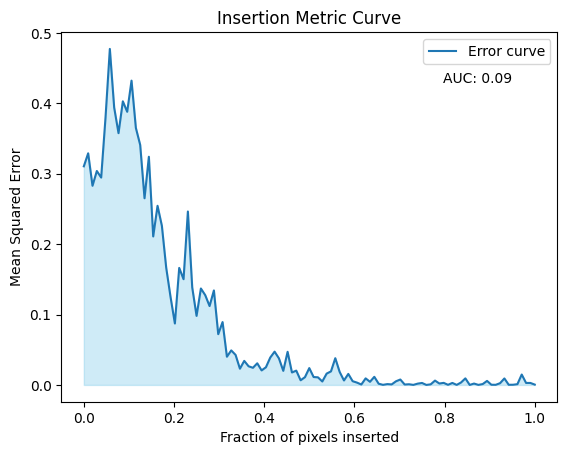

Errors: [0.31045997, 0.3289444, 0.28281432, 0.30380005, 0.29449093, 0.37947914, 0.47717255, 0.3938932, 0.35755432, 0.40277752, 0.3879024, 0.4321349, 0.3650429, 0.34081027, 0.26508564, 0.32403278, 0.21087441, 0.2544029, 0.2260354, 0.16642086, 0.12486164, 0.087264694, 0.16618697, 0.15014169, 0.24628308, 0.13846621, 0.098060265, 0.13695073, 0.1274965, 0.11199176, 0.13421288, 0.072087176, 0.08926797, 0.040064227, 0.049041938, 0.04261766, 0.02305726, 0.034129992, 0.026476972, 0.024339354, 0.030733017, 0.020606682, 0.02508937, 0.038899478, 0.04724403, 0.037704118, 0.019991897, 0.047036298, 0.017692652, 0.020297702, 0.0066105076, 0.011020223, 0.023909794, 0.011208509, 0.010785542, 0.00486321, 0.016058823, 0.019245895, 0.037939943, 0.018523192, 0.006338472, 0.015626818, 0.0052863336, 0.0032965653, 0.00058037654, 0.009296642, 0.004442084, 0.011519414, 0.0017153483, 0.00012173363, 0.0011553137, 0.00072505017, 0.005184141, 0.007678981, 0.00057723897, 0.00094722235, 5.4318585e-05, 0.0018266046, 0.

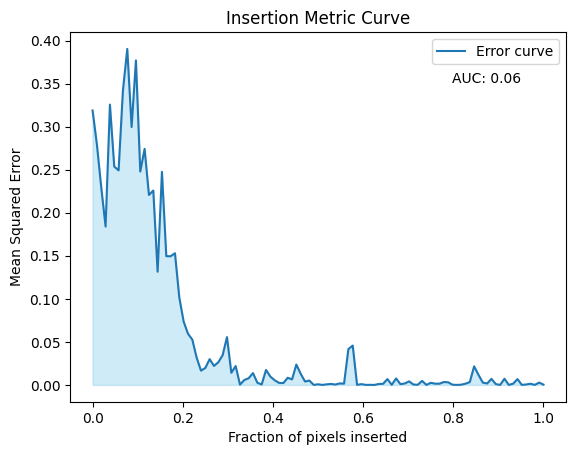

Errors: [0.31881523, 0.27905458, 0.2293357, 0.1839409, 0.32562065, 0.25363812, 0.24922657, 0.34203455, 0.39029047, 0.2995918, 0.37693954, 0.24787539, 0.27421555, 0.2206455, 0.22581555, 0.1314834, 0.24748851, 0.14953816, 0.14949432, 0.15296036, 0.10160386, 0.073662736, 0.059492763, 0.052661795, 0.03173137, 0.016594024, 0.019732365, 0.02996493, 0.022073807, 0.026361296, 0.0345807, 0.055554606, 0.014087121, 0.021915505, 0.00035744125, 0.0057466435, 0.007799878, 0.013760417, 0.0025634666, 0.000481175, 0.017408542, 0.009719733, 0.005427045, 0.0023856994, 0.0021685709, 0.008329359, 0.006432339, 0.02364172, 0.012872916, 0.0039819987, 0.0050603813, 3.0070169e-05, 0.0007404618, 9.698388e-06, 0.00068445795, 0.0011324857, 0.00044713565, 0.0017551437, 0.0015185768, 0.041625436, 0.045716487, 8.163753e-05, 0.00090009125, 7.623882e-05, 7.267383e-05, 3.9065126e-06, 0.0010783882, 0.0012888868, 0.0067803077, 0.00014053269, 0.007500459, 0.0008926961, 0.001700313, 0.004116305, 0.00048068352, 0.00017196385

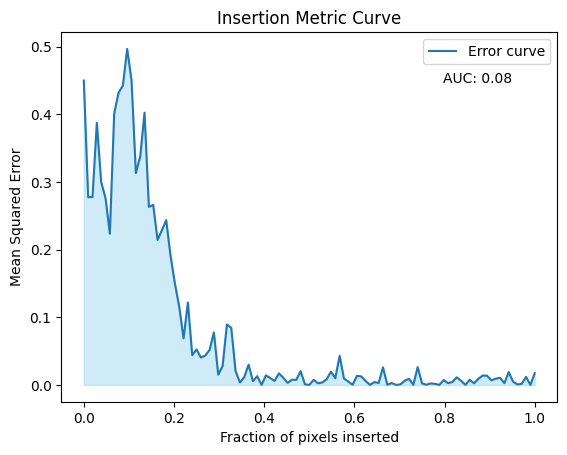

Errors: [0.44992, 0.27737656, 0.27774948, 0.3875173, 0.29994452, 0.27619317, 0.22356921, 0.4008038, 0.4319177, 0.4423591, 0.49660233, 0.45031044, 0.3132719, 0.33737883, 0.40233043, 0.26324087, 0.2661254, 0.21432644, 0.22855966, 0.24356972, 0.19072364, 0.15007795, 0.11567583, 0.0688845, 0.12171039, 0.043994587, 0.052424774, 0.040500347, 0.043380048, 0.05164857, 0.07766903, 0.015233467, 0.027822804, 0.089213274, 0.08444819, 0.020328794, 0.003664524, 0.01154389, 0.029871687, 0.005712643, 0.012979906, 5.1603416e-05, 0.014231667, 0.010042655, 0.0059036594, 0.017157108, 0.010662709, 0.0030802665, 0.007640399, 0.0075039286, 0.020361202, 0.0009603065, 3.938084e-05, 0.007561827, 0.0024791653, 0.003662619, 0.0082503, 0.019693868, 0.009901353, 0.042988542, 0.009286255, 0.005025334, 0.00021990748, 0.013385333, 0.012596309, 0.005798886, 9.804854e-06, 0.0041491357, 0.0029167102, 0.025947383, 0.00018608013, 0.0028365608, 8.397408e-05, 0.000782732, 0.0061050616, 0.009058604, 0.000106004896, 0.02635382

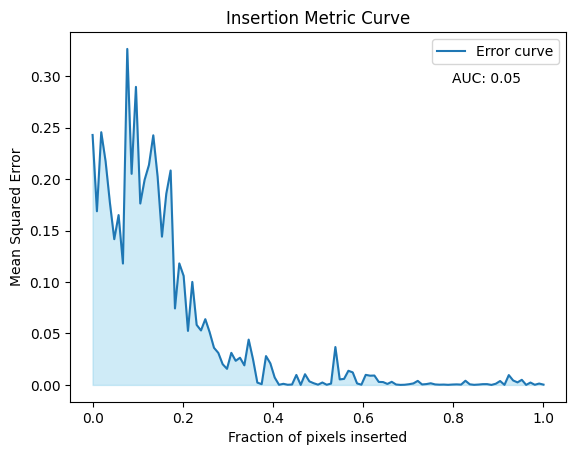

Errors: [0.24295835, 0.16881256, 0.24564393, 0.2173631, 0.17691539, 0.14167, 0.16509345, 0.11799419, 0.32659766, 0.20518546, 0.28971547, 0.17634134, 0.19939207, 0.21378005, 0.24263893, 0.20240645, 0.14413674, 0.18580076, 0.20843567, 0.0743444, 0.11812223, 0.10598969, 0.052507073, 0.10013513, 0.05838757, 0.052954804, 0.06390699, 0.051201873, 0.036122948, 0.031132925, 0.020171573, 0.015641455, 0.031192396, 0.023461703, 0.026436059, 0.019033937, 0.044067428, 0.024957895, 0.0022564665, 0.00073292933, 0.028035255, 0.020975415, 0.007215485, 0.00012981292, 0.0010800173, 0.00016847381, 0.0003866889, 0.009699318, 9.1892225e-06, 0.010395927, 0.0034655596, 0.0016482972, 0.0002496814, 0.002354708, 0.00016253894, 0.0013020677, 0.036835726, 0.0053928667, 0.0058653434, 0.013756837, 0.012200394, 0.0014690487, 0.00020632462, 0.009797668, 0.008985457, 0.009133186, 0.0029335509, 0.0027861218, 0.0009663004, 0.0030279586, 0.00039796098, 4.022618e-05, 0.00017373172, 0.0007032289, 0.0014823565, 0.003932206, 

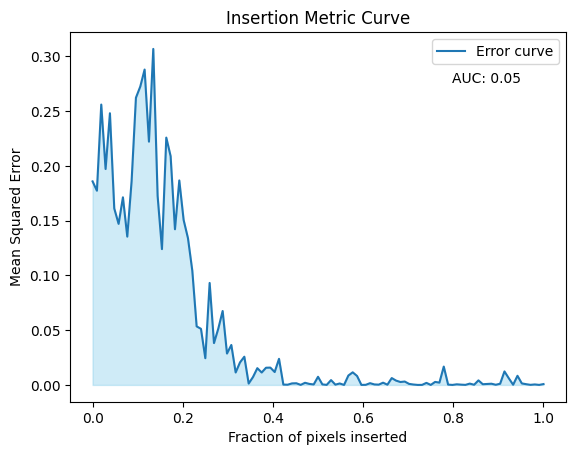

Errors: [0.18577877, 0.17727865, 0.2558989, 0.19708239, 0.24797732, 0.1610814, 0.14701167, 0.17123449, 0.1353685, 0.18599644, 0.2621649, 0.27233177, 0.2878434, 0.2220578, 0.30668566, 0.17249598, 0.12396086, 0.22573008, 0.20880325, 0.14209555, 0.18664618, 0.15055701, 0.13392232, 0.10426741, 0.05344935, 0.051192645, 0.024394732, 0.093080096, 0.038183488, 0.05146267, 0.067488216, 0.02865614, 0.03645568, 0.011369136, 0.020564333, 0.02575621, 0.0012613795, 0.007225979, 0.015291464, 0.01133926, 0.015688574, 0.015807742, 0.011772923, 0.023818048, 0.00029415265, 0.00020103704, 0.0013932287, 0.0015274439, 2.9904359e-05, 0.0019574305, 0.0009132215, 0.00043194083, 0.007437532, 0.00048498987, 4.1267136e-05, 0.0044029057, 0.00024409965, 0.001329978, 1.2803705e-06, 0.008590749, 0.011503299, 0.008165907, 2.6557713e-05, 8.1689235e-05, 0.0016017141, 0.00043783756, 0.00026016057, 0.0020518098, 0.00020427835, 0.0062596225, 0.0039357054, 0.0026674687, 0.003091975, 0.0009331934, 0.00036882187, 5.2532414e-0

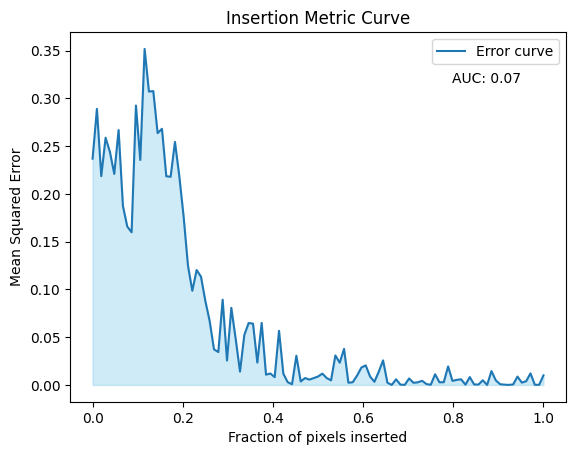

Errors: [0.23680611, 0.28900254, 0.21857852, 0.25875714, 0.24395211, 0.2208891, 0.266827, 0.18735841, 0.16584493, 0.15977032, 0.29249525, 0.23548132, 0.35176042, 0.30711424, 0.30763894, 0.26358452, 0.26815045, 0.21845424, 0.21793494, 0.25441498, 0.21865416, 0.17615251, 0.12486535, 0.0985505, 0.120274104, 0.11337995, 0.088055156, 0.066968635, 0.03726518, 0.034427244, 0.08921548, 0.025561972, 0.08071765, 0.048262842, 0.013957675, 0.05236605, 0.064804554, 0.0641698, 0.023395943, 0.06494112, 0.010739462, 0.011967716, 0.008159295, 0.0566901, 0.011731853, 0.002891579, 0.00072060805, 0.030562306, 0.0036315187, 0.0071972087, 0.005604605, 0.0071262075, 0.008827415, 0.011844223, 0.0072093094, 0.004777268, 0.030870095, 0.023264915, 0.037732687, 0.0023205872, 0.0028062938, 0.009755305, 0.01821737, 0.020459026, 0.008826832, 0.003289574, 0.013752167, 0.025703395, 0.0023197718, 7.1317118e-06, 0.0058922158, 0.00032139625, 5.7886144e-05, 0.006751499, 0.0022680673, 0.0027211655, 0.00432681, 0.0009221195

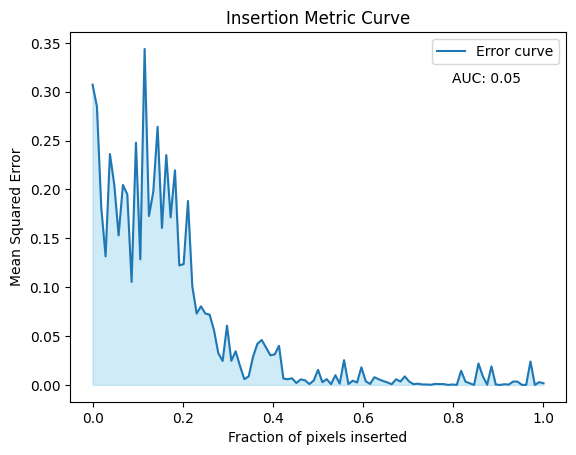

Errors: [0.30730012, 0.28482914, 0.18152262, 0.13152136, 0.23628245, 0.20505767, 0.15303455, 0.20467371, 0.19517386, 0.10539138, 0.24790175, 0.1285281, 0.34385327, 0.17284392, 0.19788343, 0.26418278, 0.16063476, 0.23522161, 0.17149939, 0.21965834, 0.12225281, 0.12369319, 0.18821672, 0.100989066, 0.07302583, 0.08046952, 0.07305186, 0.07189974, 0.056059767, 0.032475084, 0.024556613, 0.060630977, 0.024701977, 0.034455918, 0.019440439, 0.0058766515, 0.008665581, 0.028688153, 0.042015877, 0.046018668, 0.038333558, 0.030338392, 0.031244546, 0.039997064, 0.006525432, 0.005808912, 0.006803513, 0.0019288757, 0.005693, 0.004731419, 0.0008815048, 0.004511588, 0.015440801, 0.002768042, 0.005920103, 0.00078516186, 0.009900594, 0.0013939318, 0.025368277, 0.00092536584, 0.004305805, 0.0024857225, 0.01803415, 0.0037710941, 0.0010435978, 0.007891086, 0.005808258, 0.004032589, 0.0025556986, 0.0007231768, 0.0058354, 0.003410202, 0.008744572, 0.003511763, 0.000812207, 0.0012598557, 0.0005035249, 0.0004507

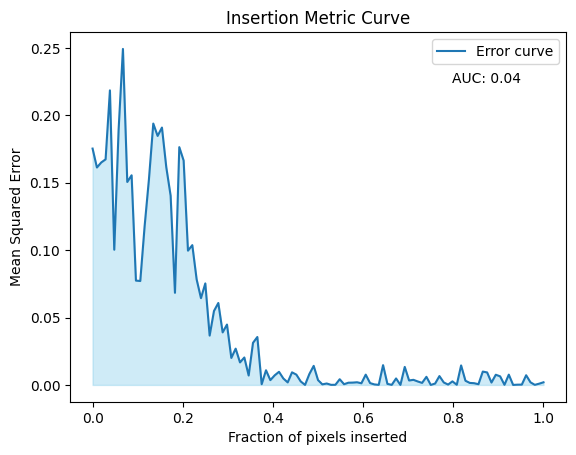

Errors: [0.17530733, 0.16128716, 0.16502193, 0.16730444, 0.21849036, 0.10028642, 0.18910564, 0.24922568, 0.15054365, 0.15549926, 0.07737881, 0.077089354, 0.11761943, 0.15260139, 0.19386712, 0.1846984, 0.19090079, 0.16144633, 0.14037454, 0.06833301, 0.1763871, 0.16643257, 0.099598795, 0.103685975, 0.078275464, 0.064370476, 0.07530658, 0.036608793, 0.05484283, 0.060778126, 0.038973104, 0.044775747, 0.020015402, 0.026908603, 0.016714236, 0.02035069, 0.0069796825, 0.031216906, 0.035546113, 0.00052917557, 0.010871483, 0.0035648316, 0.007108386, 0.009728455, 0.0047691474, 0.0018735923, 0.0093437815, 0.0076424624, 0.0026121377, 6.717678e-06, 0.008090374, 0.014134277, 0.0035645184, 0.00040984858, 0.0010573835, 6.127568e-05, 8.8826964e-05, 0.0042267432, 0.0005261579, 0.0016454334, 0.0017210903, 0.0019712732, 0.0012263082, 0.007620302, 0.0013664474, 0.00036488555, 5.5751218e-05, 0.014672937, 0.00078175176, 3.9656617e-05, 0.004794075, 9.288504e-06, 0.013358507, 0.0033066345, 0.0037768064, 0.00257

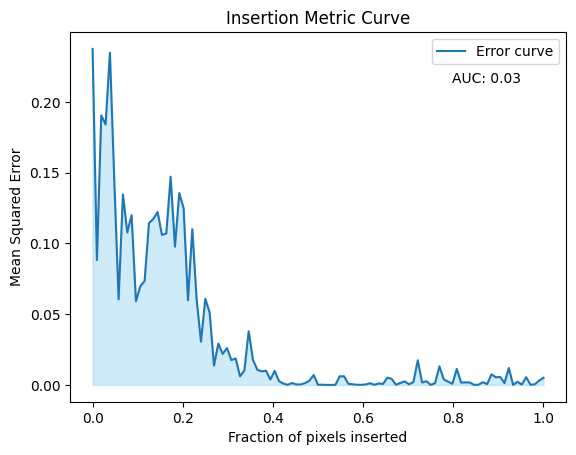

Errors: [0.2375573, 0.08826318, 0.19057295, 0.18414259, 0.23495208, 0.14498577, 0.06050764, 0.13470237, 0.10780398, 0.1200242, 0.0591929, 0.069744445, 0.07352465, 0.11437245, 0.117359236, 0.12225343, 0.10606188, 0.10711215, 0.14721769, 0.09773416, 0.13566853, 0.12490343, 0.05984884, 0.11008111, 0.060340405, 0.030576644, 0.06091377, 0.051163115, 0.013732379, 0.029224899, 0.021899378, 0.026106853, 0.017557243, 0.018702645, 0.006112105, 0.010145488, 0.03790368, 0.017666498, 0.010671919, 0.009587358, 0.009998074, 0.0038487806, 0.00994056, 0.0026615246, 0.00095344766, 8.4591324e-05, 0.0013504806, 0.000363666, 0.00034790015, 0.0013109354, 0.0029083083, 0.006976595, 9.096539e-05, 0.00017318534, 4.3749837e-06, 4.248251e-08, 5.6168563e-05, 0.0060959742, 0.0061112107, 0.00074839796, 0.0004548519, 0.00012526807, 6.341414e-05, 0.0003591155, 0.0011878003, 8.846555e-05, 0.0010128273, 0.000735326, 0.005201511, 0.0042172936, 7.075779e-05, 0.0014611457, 0.0024664558, 0.00043360237, 0.0020674884, 0.0174

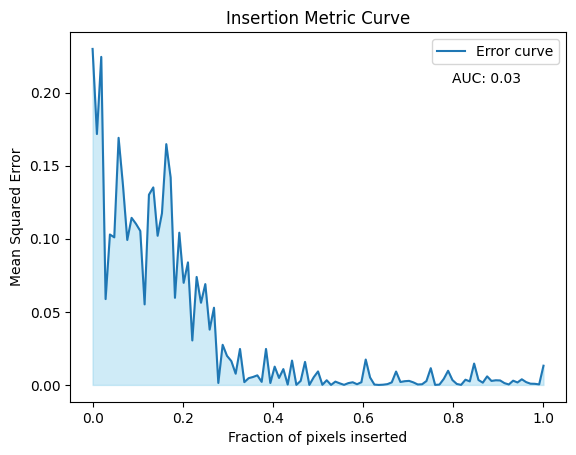

Errors: [0.22989807, 0.17166762, 0.22445962, 0.05873178, 0.10293073, 0.10097815, 0.16907866, 0.13686115, 0.09918306, 0.1143196, 0.110267274, 0.10535853, 0.055112056, 0.1301598, 0.13514507, 0.10205205, 0.11743684, 0.16475356, 0.14194603, 0.05960802, 0.10416523, 0.06987024, 0.083848804, 0.030434022, 0.07388492, 0.05621839, 0.06898124, 0.03784596, 0.05282047, 0.0013406068, 0.027459875, 0.019897956, 0.016316205, 0.007678918, 0.024601879, 0.001898816, 0.0046240594, 0.0054346705, 0.0065603578, 0.002094068, 0.024622377, 0.0012976322, 0.012509814, 0.0047766916, 0.010832613, 0.00025081667, 0.01666917, 3.687696e-05, 0.0027765909, 0.01576284, 4.025209e-06, 0.0052475748, 0.009235044, 8.260329e-05, 0.0031933903, 1.6361138e-05, 0.0022598428, 0.001093883, 5.1307547e-05, 0.0012501258, 0.0018243737, 0.00048455418, 0.0018615271, 0.017377572, 0.0051178862, 0.00023526716, 1.7008063e-06, 0.00015456893, 0.00053927646, 0.0017434469, 0.0091566695, 0.0020105275, 0.002556253, 0.0027667, 0.0017333075, 0.00030932

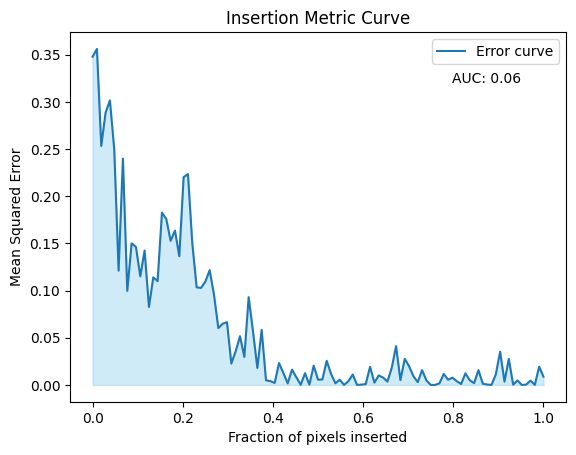

Errors: [0.34777552, 0.3560359, 0.25318396, 0.28857106, 0.30147237, 0.24955918, 0.12109715, 0.23983045, 0.09963905, 0.1499898, 0.14628732, 0.11512597, 0.1423781, 0.082595065, 0.11400736, 0.11001166, 0.18256062, 0.17579252, 0.1527169, 0.16355231, 0.13637708, 0.22018093, 0.22339785, 0.14992453, 0.10341764, 0.10277467, 0.10925161, 0.12160731, 0.095736675, 0.060229562, 0.06482944, 0.06650098, 0.022684118, 0.03553366, 0.051606204, 0.029708197, 0.09296964, 0.05665491, 0.018003108, 0.058308616, 0.004899657, 0.0040754126, 0.0021319548, 0.023189627, 0.012773292, 0.0016501272, 0.016157227, 0.008114411, 0.00014206307, 0.012450179, 0.00029183057, 0.020362461, 0.0055877683, 0.0057916986, 0.025509927, 0.011762578, 0.0017661783, 0.0055315215, 5.074648e-06, 0.0038927314, 0.011007237, 1.0082267e-05, 0.00034271218, 0.0008639249, 0.019202655, 0.002434566, 0.010061587, 0.007792173, 0.00353347, 0.018060222, 0.041115575, 0.005100742, 0.027685374, 0.019791488, 0.009192706, 0.0029429852, 0.015656846, 0.004700

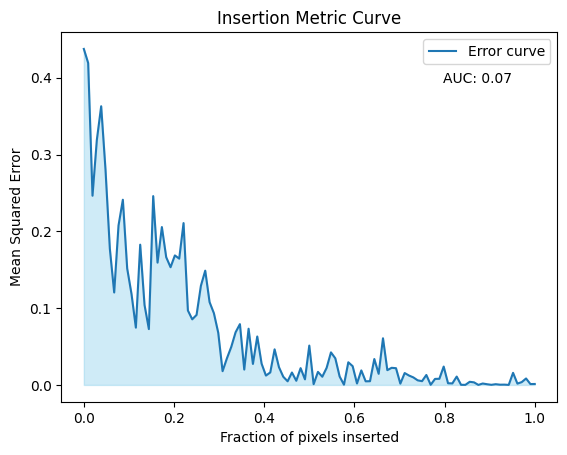

Errors: [0.43758443, 0.419241, 0.24640805, 0.31904364, 0.36293224, 0.2802317, 0.1773171, 0.12039163, 0.2076057, 0.24116933, 0.15164953, 0.118268006, 0.074610576, 0.18265435, 0.104077145, 0.07272532, 0.24590212, 0.15927963, 0.20558487, 0.1663117, 0.15329483, 0.16867407, 0.16447128, 0.2107714, 0.096964724, 0.08545461, 0.09116349, 0.12914139, 0.14882016, 0.107875, 0.09336968, 0.067993455, 0.017901363, 0.034605842, 0.049452037, 0.06854881, 0.07917675, 0.020018032, 0.073190406, 0.027361114, 0.06305543, 0.027682995, 0.012182493, 0.01626724, 0.046352588, 0.023197614, 0.010648977, 0.004750922, 0.016171413, 0.005431999, 0.021855263, 0.00729499, 0.05123635, 0.0009888422, 0.016985403, 0.010688871, 0.02224306, 0.042401273, 0.034681637, 0.010938631, 0.00031514378, 0.029491166, 0.024442757, 0.0019004579, 0.018905673, 0.0047184066, 0.0048593534, 0.033736788, 0.01447675, 0.06074398, 0.019254329, 0.022297319, 0.021790491, 0.0017016601, 0.015462199, 0.012234152, 0.009805197, 0.0059876, 0.0049168444, 0.0

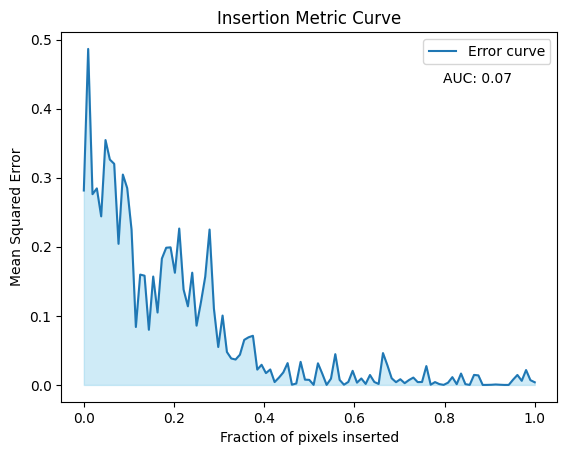

Errors: [0.28143176, 0.48638842, 0.2760918, 0.28449526, 0.24401352, 0.3544458, 0.32624957, 0.32008135, 0.20423591, 0.3045279, 0.28498864, 0.22494411, 0.083867066, 0.15970448, 0.15815748, 0.07982951, 0.1569131, 0.10480273, 0.18291631, 0.1986021, 0.1991635, 0.16240597, 0.22638635, 0.13818592, 0.11379457, 0.1624839, 0.08581525, 0.11940608, 0.15668048, 0.22493948, 0.11062292, 0.054890856, 0.100419804, 0.047708873, 0.0383014, 0.03679529, 0.043751482, 0.06526512, 0.068983905, 0.07115542, 0.022186488, 0.029151866, 0.017102126, 0.022357669, 0.0041364757, 0.010569485, 0.018053943, 0.031583194, 0.00030014475, 0.0020658192, 0.033422355, 0.0076416703, 0.0073328335, 6.555261e-05, 0.03131412, 0.016190428, 4.0152117e-05, 0.00909613, 0.044570953, 0.007288475, 0.00032007686, 0.0043394757, 0.02042085, 0.0032996186, 0.009360728, 0.001474619, 0.014366889, 0.0042604147, 0.0014265754, 0.046103198, 0.028671922, 0.009648197, 0.003986363, 0.008232378, 0.0025324533, 0.0070986403, 0.010642482, 0.004087918, 0.004

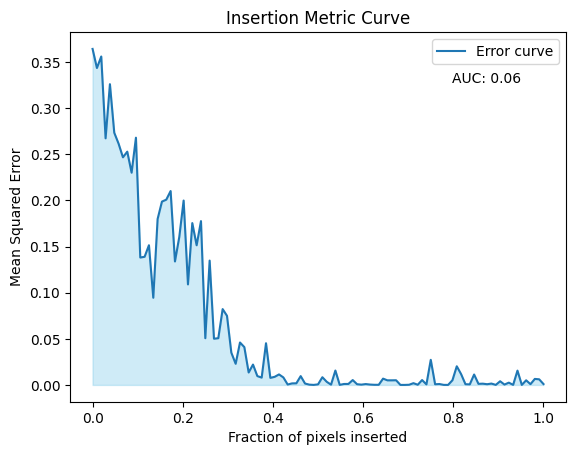

Errors: [0.36432147, 0.3436275, 0.35611585, 0.2673893, 0.32609352, 0.27344796, 0.26156664, 0.24681143, 0.25292885, 0.23013945, 0.26807293, 0.13812593, 0.1389665, 0.15146632, 0.0945273, 0.17993325, 0.19878244, 0.20088632, 0.21023293, 0.13388467, 0.16045994, 0.19992898, 0.10900053, 0.17546524, 0.15140583, 0.17761981, 0.050656237, 0.13481799, 0.050108347, 0.05066799, 0.08221686, 0.074955024, 0.03500661, 0.022918811, 0.046001125, 0.041011315, 0.013493763, 0.022068175, 0.009590766, 0.007933055, 0.045201596, 0.0076453807, 0.008785352, 0.011389458, 0.008146658, 0.00042903214, 0.0016537514, 0.0017716833, 0.009549437, 0.0014997841, 0.00030047528, 2.5309657e-05, 0.0005990771, 0.008363447, 0.003410592, 0.00027104744, 0.015603967, 6.184622e-05, 0.001024607, 0.00105857, 0.005276267, 0.0007649246, 0.0003171829, 0.00092818204, 0.00039060417, 0.00013763661, 0.00013401889, 0.006822484, 0.0049718157, 0.0049852063, 0.0050688647, 1.4633885e-05, 1.2055408e-05, 0.00017475769, 0.0019020276, 0.00018874019, 0.

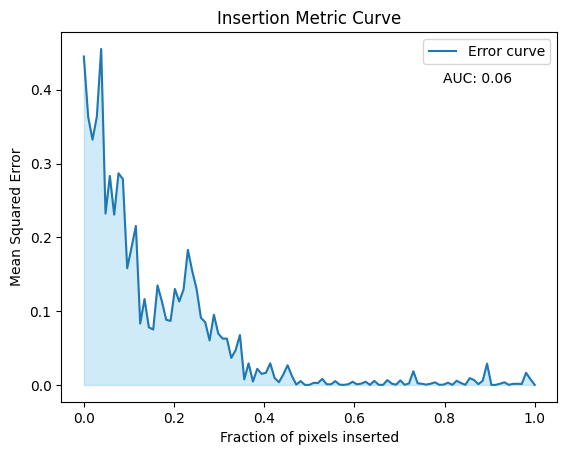

Errors: [0.44505966, 0.36338237, 0.33239788, 0.3635422, 0.45531398, 0.23222506, 0.28325006, 0.2308012, 0.28682116, 0.2789468, 0.15814023, 0.18627457, 0.21540365, 0.083231054, 0.116352364, 0.07808434, 0.07511941, 0.13482736, 0.11325218, 0.088304505, 0.086771816, 0.13004276, 0.11311662, 0.12939426, 0.18307899, 0.15433191, 0.1301309, 0.09115608, 0.084891215, 0.060351387, 0.095126025, 0.06970711, 0.0627887, 0.06277454, 0.03664735, 0.046960007, 0.06758574, 0.0075286496, 0.029223269, 0.0046567363, 0.021825314, 0.014970421, 0.016447451, 0.02929533, 0.009456029, 0.0036794047, 0.014129487, 0.02667068, 0.011991906, 0.00046433313, 0.005198382, 4.7714693e-05, 4.8969538e-05, 0.0028283258, 0.0026117233, 0.008201948, 0.00091845973, 0.0008312612, 0.005203815, 0.00033521937, 8.072457e-05, 0.0009389269, 0.004256774, 0.00075783936, 0.0018740154, 0.00434914, 5.1194893e-05, 0.0055465684, 0.00023684227, 5.562223e-06, 0.0065864343, 0.0018414914, 0.00029463944, 0.006120123, 0.00019309187, 0.0020445911, 0.0184

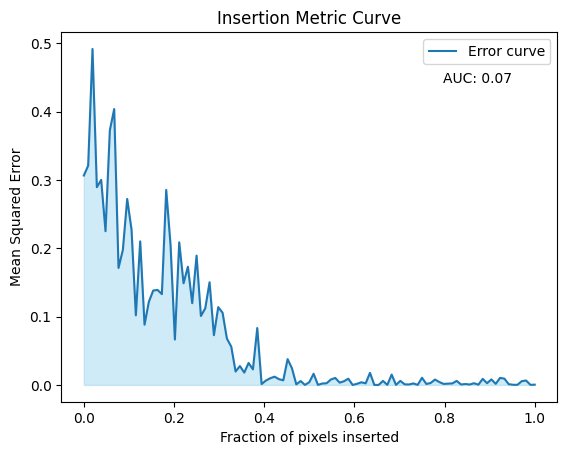

Errors: [0.3065007, 0.32095772, 0.49178946, 0.28941962, 0.30010614, 0.22495316, 0.37260717, 0.4037884, 0.17125076, 0.19763725, 0.2722173, 0.2273107, 0.10185785, 0.21010931, 0.088175185, 0.12179325, 0.13812132, 0.13908802, 0.13290982, 0.28543022, 0.20475353, 0.06644485, 0.20870587, 0.14875951, 0.17304152, 0.119695924, 0.1892097, 0.1009146, 0.11207077, 0.1502571, 0.072845735, 0.11387011, 0.10560496, 0.06773166, 0.056102168, 0.019632153, 0.02763351, 0.018036231, 0.03216211, 0.022732046, 0.08326194, 0.0012719692, 0.0064624716, 0.009813415, 0.012084011, 0.008420343, 0.0067830957, 0.037754364, 0.024428817, 0.00083554233, 0.0056655635, 9.6783515e-06, 0.0040259603, 0.016340638, 5.321025e-05, 0.0020348572, 0.0025046584, 0.008008812, 0.010175048, 0.003395043, 0.005391764, 0.009133254, 2.6836142e-06, 0.0016128495, 0.0038573642, 0.002340303, 0.017675625, 1.9175939e-05, 2.7448474e-05, 0.0058717728, 7.606821e-05, 0.015129915, 4.947134e-05, 0.0059181955, 0.0008865094, 0.0006672459, 0.0021737588, 0.00

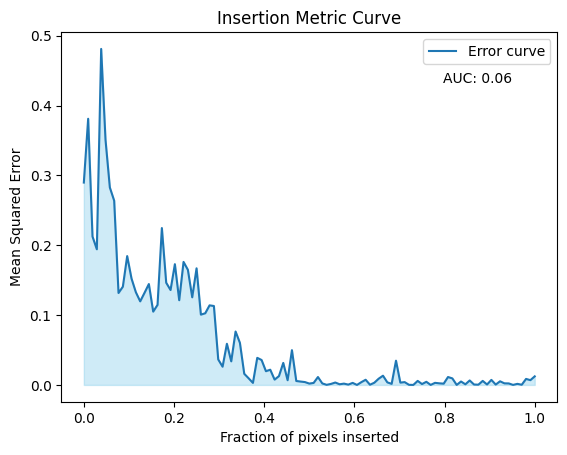

Errors: [0.28973496, 0.38109788, 0.21251503, 0.19421312, 0.48109916, 0.35107931, 0.28272742, 0.2638024, 0.13164252, 0.14063756, 0.18444924, 0.15230052, 0.13273244, 0.11965547, 0.13191897, 0.14445958, 0.104959086, 0.11462331, 0.22461608, 0.14631692, 0.13589501, 0.17286241, 0.1212868, 0.17611374, 0.16481936, 0.12547217, 0.1669549, 0.10065097, 0.10258628, 0.1139449, 0.11300627, 0.03646064, 0.026106892, 0.05891057, 0.033751197, 0.07646734, 0.060221255, 0.015942622, 0.009567642, 0.0028993278, 0.038787268, 0.035677444, 0.019654876, 0.021780498, 0.0076206555, 0.012607363, 0.031512856, 0.006729302, 0.049759332, 0.0056314105, 0.004827197, 0.0040788683, 0.0019310857, 0.0028587366, 0.01128545, 0.0021795765, 0.00012554841, 0.0014226969, 0.0034396567, 0.0009384155, 0.0018570551, 0.00045677598, 0.0029263624, 1.0817418e-07, 0.0039398647, 0.007393103, 0.00028936352, 0.00316944, 0.008891147, 0.013202365, 0.0036689274, 0.001533656, 0.034712948, 0.0033143437, 0.0040180977, 0.00014077869, 1.6678983e-05, 0

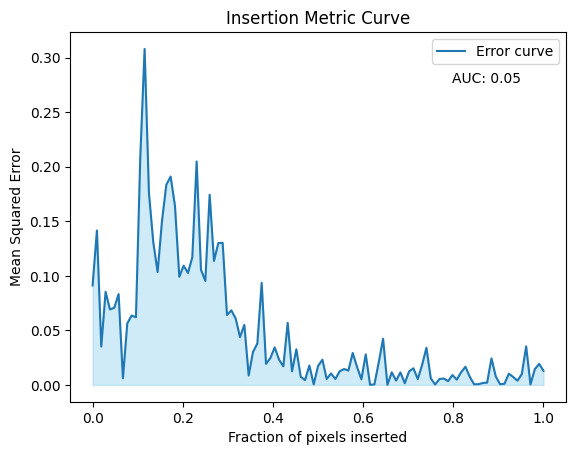

Errors: [0.091177896, 0.1415806, 0.03519909, 0.085336104, 0.0691933, 0.07076972, 0.08326679, 0.006067508, 0.056387145, 0.06361473, 0.062094573, 0.2087271, 0.3080673, 0.1758203, 0.13077661, 0.103530996, 0.150008, 0.18342376, 0.19102614, 0.16426496, 0.09918092, 0.10932274, 0.10273035, 0.11699801, 0.20487654, 0.10559691, 0.095369026, 0.17443813, 0.11371617, 0.13007943, 0.13027643, 0.06415087, 0.06837751, 0.060946878, 0.043833084, 0.05509655, 0.008671863, 0.030224714, 0.037945747, 0.09358691, 0.019305708, 0.024659522, 0.034422953, 0.023251316, 0.01705749, 0.056947947, 0.012477782, 0.03269285, 0.0075563546, 0.004476521, 0.017822467, 0.00052310526, 0.017298099, 0.023134273, 0.0054622297, 0.010541462, 0.005467623, 0.012565155, 0.01457321, 0.013209105, 0.029302495, 0.016454684, 0.005141622, 0.027969185, 7.46958e-05, 0.00050034135, 0.020682527, 0.042355847, 3.517417e-05, 0.011597208, 0.0040067863, 0.011468752, 0.0015647546, 0.012364824, 0.015257548, 0.005387073, 0.018316425, 0.034081735, 0.0061

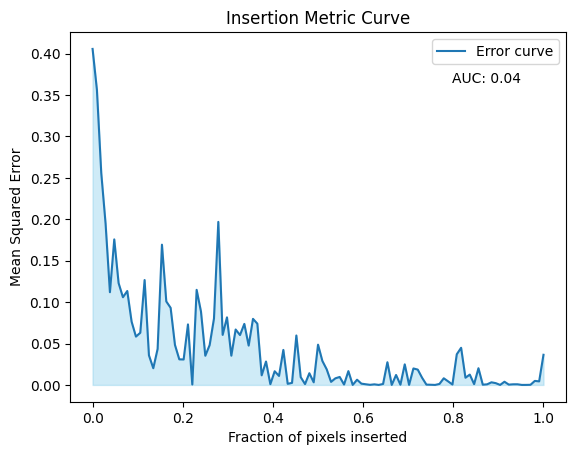

Errors: [0.4057322, 0.35634765, 0.2559386, 0.19465011, 0.11195634, 0.17572607, 0.12297922, 0.10590884, 0.113418266, 0.076410666, 0.058375288, 0.06296443, 0.12666383, 0.035732325, 0.020167822, 0.043464832, 0.16935593, 0.10082638, 0.09310077, 0.048284862, 0.030900536, 0.030747892, 0.07308557, 0.00050894957, 0.11481554, 0.08863535, 0.035242323, 0.0481192, 0.08018316, 0.19688155, 0.060439333, 0.081625454, 0.035332646, 0.0669211, 0.06020866, 0.07368229, 0.04748609, 0.079771265, 0.07398691, 0.011602387, 0.02826974, 0.00090373267, 0.016517676, 0.010854615, 0.042260464, 0.0013370176, 0.002477147, 0.05968564, 0.009423149, 0.0010315707, 0.014139615, 0.0031458922, 0.048615687, 0.028948998, 0.018803613, 0.0037040834, 0.007975503, 0.009619295, 0.00047166258, 0.016664896, 1.3278334e-05, 0.0062869294, 0.0015453277, 0.00079268427, 0.000120568635, 0.0006985805, 6.1920086e-06, 0.0011507088, 0.027414763, 7.881166e-06, 0.012001859, 0.00024569724, 0.024844276, 4.711987e-05, 0.01988907, 0.018504879, 0.00864

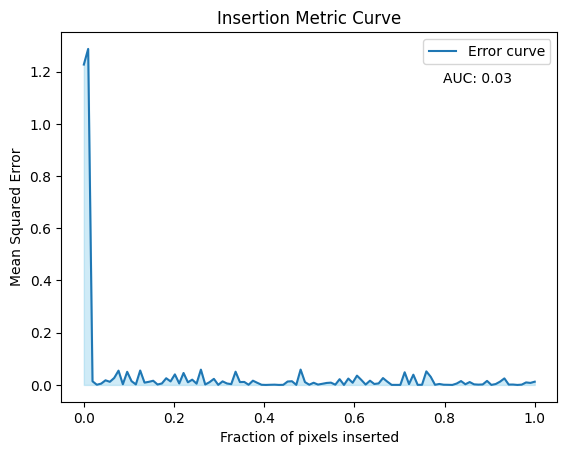

Errors: [1.2270291, 1.2869837, 0.0138439145, 0.0007039973, 0.004998151, 0.017699422, 0.011974863, 0.026648821, 0.054725584, 0.0026030492, 0.050213568, 0.01444446, 0.0019563811, 0.055215035, 0.008834708, 0.011888329, 0.01601671, 0.0015924742, 0.0056057745, 0.025600027, 0.01346158, 0.040354997, 0.0056174546, 0.045773342, 0.010104693, 0.020211626, 0.0048421877, 0.05858159, 0.0015844732, 0.010669161, 0.023240156, 0.00025125107, 0.013659458, 0.005645043, 0.00297563, 0.050624017, 0.010893681, 0.0114915585, 0.0006472319, 0.016282326, 0.008121962, 0.0005607679, 1.1656855e-05, 0.0005728224, 0.0009793025, 1.5402082e-05, 0.00038529304, 0.013095386, 0.0141854575, 0.00023548113, 0.05874314, 0.010853114, 0.0007797665, 0.00838865, 0.0013325703, 0.0043173, 0.0075570336, 0.008754346, 0.00096826535, 0.02206192, 1.0786508e-06, 0.02444017, 0.008250592, 0.035649043, 0.019216547, 0.0014223258, 0.016236337, 0.003568288, 0.0059041083, 0.026256835, 0.012456858, 0.0001884365, 0.00015696802, 0.00010668348, 0.048

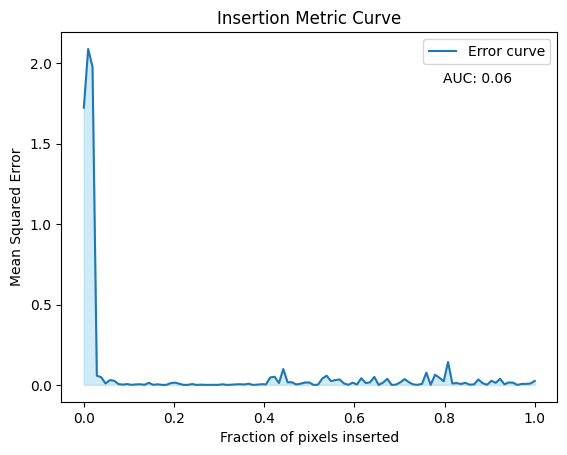

Errors: [1.7243356, 2.089875, 1.9787104, 0.057318825, 0.048175648, 0.009021801, 0.029971533, 0.026009327, 0.0053076595, 0.0018241141, 0.0053743934, 0.000524595, 0.0030731782, 0.004082699, 0.00084764283, 0.013132546, 0.0006278512, 0.003925765, 0.00035790566, 0.00018909246, 0.010828582, 0.014434862, 0.0074356864, 0.00016304848, 0.000540778, 0.0052294084, 2.4802457e-05, 0.0016096818, 0.00046621796, 0.00028475252, 0.000605355, 0.00041285387, 0.0039803814, 1.2857217e-05, 0.0013507392, 0.003436686, 0.0044348645, 0.0026291395, 0.007655933, 2.629176e-05, 0.0017530194, 0.004479453, 0.0033188784, 0.046680205, 0.050937068, 0.0119036, 0.09880473, 0.016344067, 0.016589418, 0.0027764528, 0.007685276, 0.01495982, 0.01535053, 7.8117584e-05, 0.0015577599, 0.03969838, 0.057474475, 0.023887623, 0.030296754, 0.033697058, 0.009309134, 0.000826453, 0.014236844, 0.0028569459, 0.04184352, 0.011617976, 0.016014425, 0.049682938, 8.9522655e-07, 0.014638748, 0.03743621, 0.000119990604, 0.0021210976, 0.016577713, 

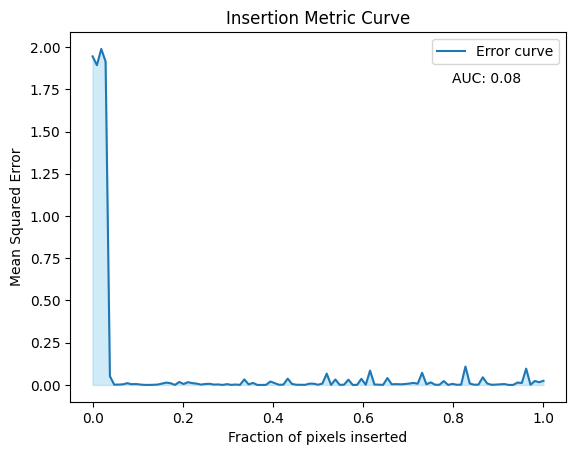

Errors: [1.9446609, 1.8926889, 1.988813, 1.9141992, 0.051242705, 0.0012509478, 0.0021905932, 0.003452575, 0.010429464, 0.0041040047, 0.005441369, 0.0022947432, 0.00012567133, 6.5872955e-05, 0.00082528306, 0.0020264448, 0.007854277, 0.013819113, 0.010110145, 5.402466e-05, 0.017589686, 0.005371187, 0.0164558, 0.010621157, 0.0077618756, 0.0019449245, 0.0055446113, 0.0066016032, 0.0019451769, 0.0030612482, 7.0517126e-06, 0.004542034, 0.00041771005, 0.0022659728, 0.0004011146, 0.03271664, 0.0032005182, 0.011879914, 1.5697324e-06, 1.27607955e-05, 0.00032057398, 0.020144586, 0.010739734, 0.0008786491, 0.0017512505, 0.036951933, 0.0058517116, 0.0010618519, 0.000790735, 0.00040237023, 0.007518041, 0.0072759576, 0.001169119, 0.007897716, 0.06698677, 5.062671e-05, 0.03211987, 0.00046302655, 0.00128457, 0.03125033, 7.020485e-05, 0.0003343818, 0.03603825, 0.0011012387, 0.08461181, 0.002507732, 0.0015378582, 0.00036627363, 0.040629014, 0.0035312097, 0.004799359, 0.003462234, 0.0051768483, 0.00803314

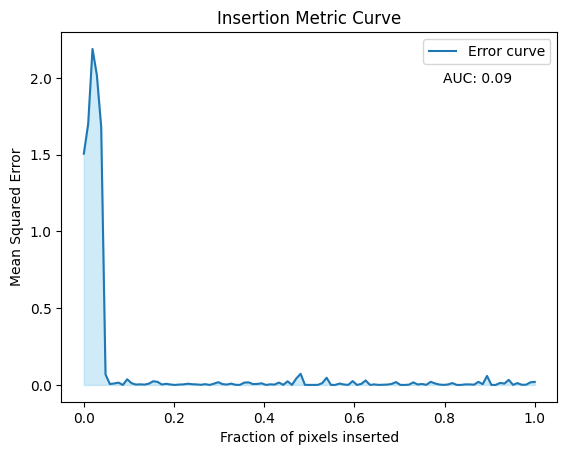

Errors: [1.5068489, 1.700126, 2.1895268, 2.0195034, 1.6837888, 0.06880422, 0.005788896, 0.009514218, 0.015081946, 1.9681693e-06, 0.03688283, 0.011305475, 0.0025518793, 0.0037838793, 0.0020325617, 0.008276795, 0.023980279, 0.019906314, 0.0026387998, 0.0073361467, 0.0027659289, 2.5865626e-05, 0.002411458, 0.0035607617, 0.007772807, 0.0045183767, 0.0033090787, 0.0009768419, 0.0048928712, 4.3366177e-05, 0.008194188, 0.017960569, 0.005100661, 0.0024574355, 0.008581139, 0.00075296895, 0.00032413544, 0.015135862, 0.016748391, 0.0055215517, 0.006381495, 0.010781735, 0.00011604925, 0.0038524384, 0.0023262787, 0.015420196, 0.0006753876, 0.023600264, 6.569795e-05, 0.04210303, 0.07247392, 0.0004133203, 7.0488306e-05, 0.00013576477, 0.0004118517, 0.012130721, 0.04675748, 1.3666766e-05, 0.0004109196, 0.0089848805, 0.0028481437, 0.00029287618, 0.025032228, 4.888532e-05, 0.0067706523, 0.02911578, 0.00024760523, 0.0032226262, 0.0001972796, 0.0013574112, 0.002193378, 0.0064632767, 0.018560154, 0.0003097

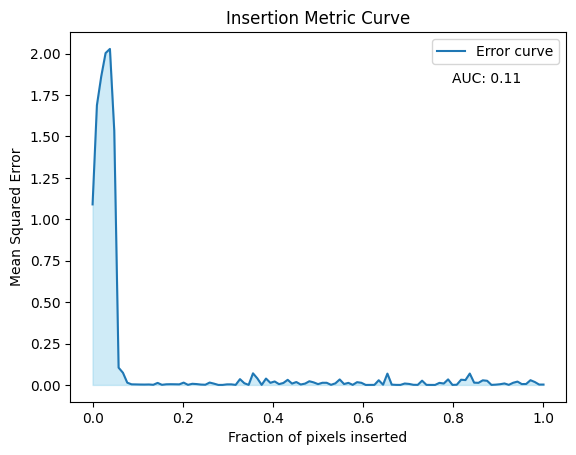

Errors: [1.0898902, 1.6887938, 1.8631209, 2.003556, 2.0285618, 1.5343671, 0.10425059, 0.07363304, 0.013558943, 0.0035545258, 0.003130821, 0.0024539162, 0.0021798422, 0.0027736386, 0.000841746, 0.012207247, 0.0006469188, 0.0038152963, 0.0042977147, 0.003942246, 0.0034107259, 0.014005636, 0.0004589582, 0.0068533467, 0.0051453877, 0.0021786743, 0.0011116097, 0.014340195, 0.0077583166, 1.7762488e-08, 0.00011163555, 0.0033491766, 0.003403545, 0.00022398951, 0.034929678, 0.010255579, 0.00026608436, 0.07004304, 0.03956218, 0.00018602728, 0.03842447, 0.0127262175, 0.020954128, 0.0048434683, 0.01177754, 0.030807717, 0.008155198, 0.017509352, 0.0025132135, 0.0079054935, 0.022244029, 0.0152973775, 0.0048420946, 0.012946331, 0.01288063, 0.00058290653, 0.009572175, 0.03302699, 0.0053667002, 0.012469491, 0.00041817978, 0.016633019, 0.01283055, 1.1233915e-05, 0.00013221301, 0.00029426767, 0.028336138, 0.0012823984, 0.068282224, 0.0017903441, 0.0003064466, 5.875898e-05, 0.008508213, 0.0060306, 0.00079

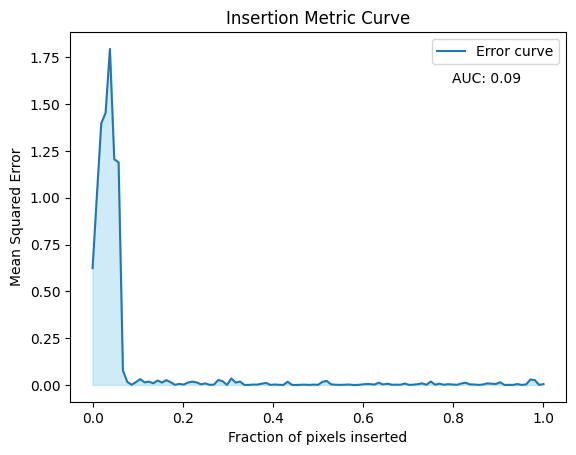

Errors: [0.6240347, 1.0143865, 1.3977867, 1.4536957, 1.7954713, 1.2056209, 1.1894014, 0.07674773, 0.016339034, 0.0006616403, 0.014922278, 0.031046363, 0.0136950305, 0.017502878, 0.008864315, 0.023566218, 0.012611136, 0.025641043, 0.014511688, 0.0005530681, 0.005503971, 0.0017837828, 0.012853764, 0.017839078, 0.013342071, 0.0033077295, 0.008226897, 0.00050838565, 0.0017114723, 0.02657536, 0.019571247, 0.0001369595, 0.034827746, 0.012574865, 0.01823426, 0.00013407099, 6.0951832e-05, 0.0019702995, 0.0017297657, 0.0065099895, 0.01057371, 4.5240938e-08, 0.0022642098, 0.0005108608, 8.5556436e-05, 0.017034879, 7.542211e-05, 1.3797413e-05, 0.0007909915, 0.001417727, 2.2056163e-07, 0.0018380886, 0.0002514434, 0.016275091, 0.02133019, 0.0033987896, 0.0009843807, 0.00026832725, 0.00084368046, 0.0020769264, 9.854656e-06, 8.6988933e-07, 0.001939995, 0.0044921315, 0.0044742823, 0.0016747138, 0.012118608, 0.002280704, 0.006765338, 0.0010262455, 0.0014515853, 0.0009907783, 0.00753374, 0.00025235675, 0

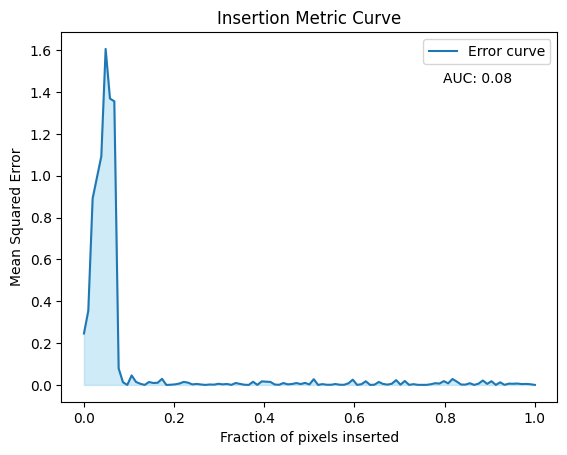

Errors: [0.24592474, 0.35445258, 0.8913316, 0.99209374, 1.0926185, 1.6062484, 1.3689747, 1.3559101, 0.07879891, 0.012755292, 9.927039e-05, 0.045456734, 0.014359546, 0.0055084582, 2.572788e-05, 0.01394223, 0.009311998, 0.01024157, 0.029170869, 1.2647349e-05, 0.0009784745, 0.0026388885, 0.0066277175, 0.014383705, 0.010998515, 0.0024602343, 0.004657546, 0.0021064915, 0.00010542637, 0.0020591628, 0.0013827718, 0.0054861805, 0.0027720795, 0.0045189215, 0.00028340833, 0.009171853, 0.0049241823, 0.0009683581, 1.4366292e-05, 0.015049068, 0.00024736708, 0.017064333, 0.015612165, 0.014361868, 0.00204859, 0.0006188361, 0.00908794, 0.0026963453, 0.004451166, 0.0090194745, 0.0041254614, 0.009752427, 0.0023095114, 0.027482329, 0.000126683, 0.0038874636, 0.00090236554, 0.0007587109, 0.0043265633, 0.0009261656, 0.00060992, 0.00769367, 0.025137892, 0.00023595426, 0.0035256972, 0.017457297, 4.7641435e-05, 0.0010792007, 0.014206961, 0.004646561, 0.0014914166, 0.005694309, 0.02289477, 0.0012159771, 0.0188

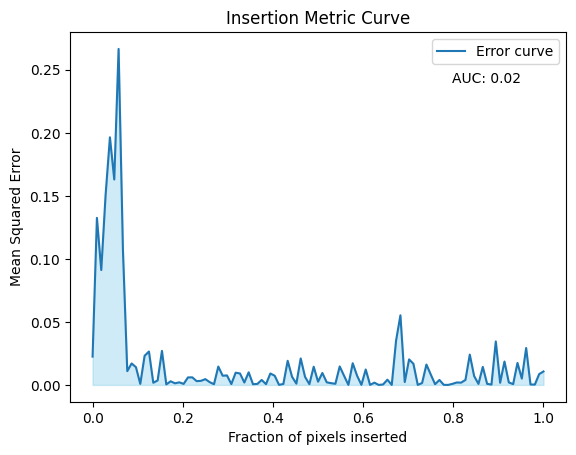

Errors: [0.022449488, 0.1325158, 0.09113294, 0.15060058, 0.19643115, 0.1629619, 0.2665353, 0.107112855, 0.010945864, 0.017020315, 0.014113918, 0.0008376594, 0.02312267, 0.02649556, 0.0017293047, 0.0035472233, 0.027009817, 0.0004070202, 0.002877877, 0.0012897, 0.0020595388, 0.000819265, 0.0059498767, 0.0060119587, 0.0029994582, 0.003253253, 0.0046045035, 0.002237948, 0.0005618934, 0.014575815, 0.0073069995, 0.0075394833, 0.00067585864, 0.0097100865, 0.009092696, 0.0019005307, 0.00999482, 0.0005576458, 0.00079553423, 0.003934307, 0.00063600217, 0.009074336, 0.007310913, 6.9262634e-05, 0.0007475894, 0.019140016, 0.006526203, 0.0010306449, 0.021013673, 0.0064036124, 0.0005990421, 0.014427409, 0.002566896, 0.009472706, 0.0020873637, 0.001391863, 0.0009199669, 0.014667464, 0.0072803763, 4.051931e-05, 0.017195415, 0.007346979, 6.704642e-05, 0.01223522, 2.467557e-05, 0.0017956935, 6.362547e-06, 0.00035502252, 0.0041642, 6.297763e-06, 0.03519428, 0.05521383, 0.0023003886, 0.020253075, 0.0167584

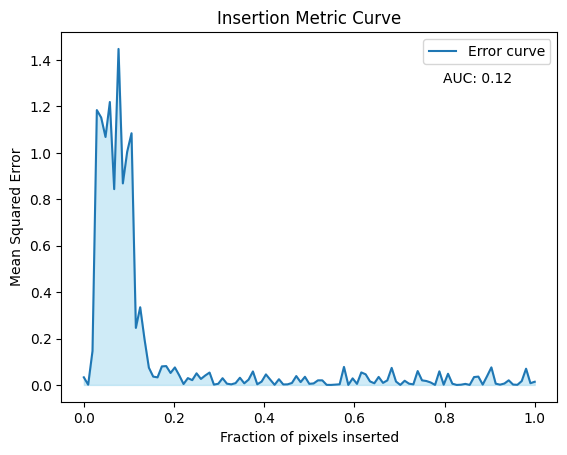

Errors: [0.03283669, 0.0008995477, 0.14607069, 1.1843203, 1.1522726, 1.0683563, 1.219165, 0.8437072, 1.4478561, 0.8683821, 1.0048795, 1.08448, 0.24572913, 0.33485547, 0.19660068, 0.0744181, 0.035842728, 0.0326091, 0.07990524, 0.08120229, 0.051562127, 0.07539297, 0.041461136, 0.003934733, 0.029386485, 0.02063212, 0.049971174, 0.025827084, 0.040585604, 0.053379703, 0.0013182398, 0.0049081217, 0.029045716, 0.0053907484, 0.0024340719, 0.0077814013, 0.030955736, 0.0069696866, 0.022850428, 0.058084417, 0.0026950734, 0.014238665, 0.045332875, 0.02257573, 0.00044216853, 0.024548618, 0.0019966753, 0.0024930858, 0.008468981, 0.03818731, 0.012078481, 0.03503753, 0.004674862, 0.0064526624, 0.019735279, 0.019786054, 0.00031536815, 2.0732705e-05, 0.0012949712, 0.0026587455, 0.077629305, 1.0181684e-05, 0.028232126, 0.0045763236, 0.053888347, 0.045746006, 0.01517382, 0.0071504605, 0.03445711, 0.008863584, 0.019563697, 0.073423214, 0.014571483, 5.7370322e-05, 0.018054552, 0.005409583, 0.0024239547, 0.0

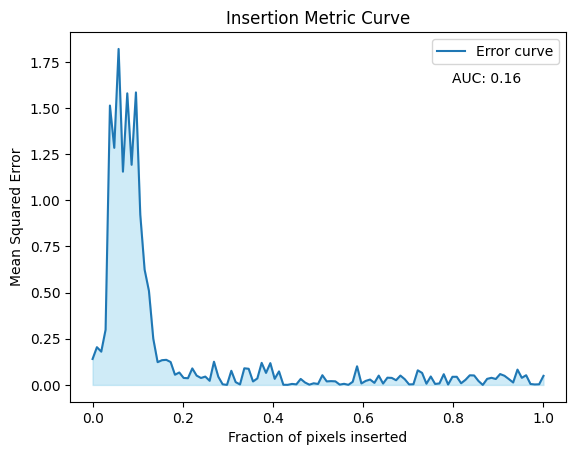

Errors: [0.14054553, 0.20443465, 0.18022585, 0.29890546, 1.5136611, 1.2845144, 1.8204217, 1.1554316, 1.5798116, 1.1926515, 1.584856, 0.9228236, 0.62464833, 0.5093016, 0.25026768, 0.12327362, 0.1339672, 0.13595113, 0.12414145, 0.05528486, 0.06737095, 0.03782277, 0.036398206, 0.089512184, 0.050493453, 0.03760095, 0.045200277, 0.022326166, 0.12568593, 0.044365425, 0.003293965, 0.00025263615, 0.07662453, 0.015140768, 0.002618612, 0.090095915, 0.08749967, 0.018739767, 0.03522602, 0.11955516, 0.065154985, 0.11813472, 0.033045303, 0.073304296, 0.00083351054, 0.0005073305, 0.0054364107, 0.0030895362, 0.032521762, 0.013085894, 0.0013684487, 0.008865897, 0.005176282, 0.052628808, 0.019171745, 0.020571684, 0.019420598, 0.001696314, 0.0059891497, 0.00052804087, 0.016941153, 0.101013385, 0.008039287, 0.021788064, 0.029133836, 0.01117141, 0.05050942, 0.007503412, 0.039228912, 0.03807883, 0.025525924, 0.05065908, 0.03108818, 0.0028376274, 0.0036506385, 0.07919574, 0.065052055, 0.0066107013, 0.0457800

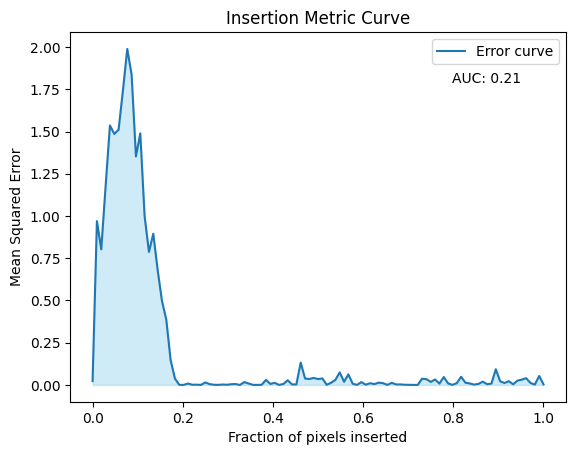

Errors: [0.022806335, 0.9697479, 0.80240434, 1.1749508, 1.5361937, 1.48612, 1.5111132, 1.7437251, 1.9891856, 1.8367821, 1.3527905, 1.4895629, 0.99966073, 0.7874399, 0.8949518, 0.68195087, 0.49725696, 0.38654134, 0.14644581, 0.03743092, 0.0004444626, 0.00019507146, 0.0082354285, 0.00096739014, 0.0016271959, 1.5128682e-05, 0.014767121, 0.004826336, 0.0010635325, 0.0003440022, 0.0025487489, 0.0009296644, 0.0043388004, 0.0050862106, 1.1627975e-05, 0.017027937, 0.008249953, 0.00054681586, 5.61239e-05, 0.00092259014, 0.029904291, 0.005866092, 0.012360955, 0.00025199613, 0.0054178806, 0.027666297, 0.0030319218, 0.0025748867, 0.13238925, 0.038160942, 0.035024676, 0.04155493, 0.034611918, 0.038467646, 0.0006772912, 0.012807401, 0.029795462, 0.07437963, 0.018580899, 0.0624307, 0.0067942142, 0.00035156964, 0.016556086, 0.0011971614, 0.0103024505, 0.0051011844, 0.013569533, 0.010307605, 0.00010363718, 0.012530009, 0.0029888323, 0.0028987885, 0.0009971892, 0.0006536255, 6.769318e-05, 0.00027605932,

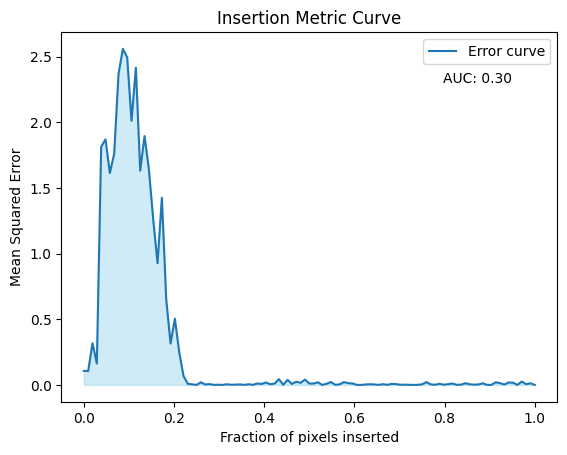

Errors: [0.1068983, 0.10598945, 0.31720445, 0.16267535, 1.8146386, 1.870028, 1.6136873, 1.7614955, 2.3684907, 2.5593748, 2.4952784, 2.012156, 2.4163816, 1.6321142, 1.895824, 1.6434839, 1.2611529, 0.9270547, 1.4254624, 0.6539246, 0.3153336, 0.5046852, 0.25006902, 0.06631285, 0.008292105, 0.004354818, 0.00035129255, 0.019715322, 0.0034394888, 0.0063230493, 4.0764782e-05, 0.0017207738, 5.6463778e-05, 0.005117664, 0.0009928272, 0.0026152702, 0.0036178823, 0.0006422707, 0.005105698, 0.00069252803, 0.0107902475, 0.0078053116, 0.018908197, 0.0053544515, 0.0102370465, 0.043866158, 0.0009420197, 0.0387232, 0.007630649, 0.024427364, 0.015922338, 0.04060929, 0.010744849, 0.010824426, 0.019796954, 9.0415924e-05, 0.008978046, 0.021993011, 0.00057930296, 0.004518108, 0.021403225, 0.013647632, 0.010636826, 0.00017125487, 3.8390688e-05, 0.003618198, 0.0050425376, 0.003612994, 0.00018072368, 0.005877803, 0.00046473395, 0.0077839885, 0.0060857777, 0.0013806116, 0.0018575483, 0.0009674643, 2.2803353e-05,

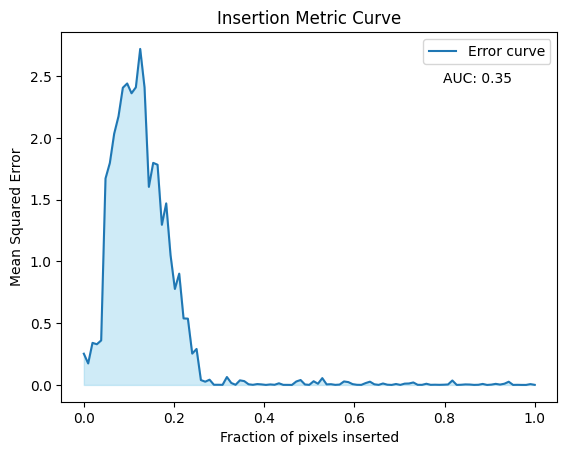

Errors: [0.25294355, 0.17397645, 0.3406821, 0.32963738, 0.36045063, 1.6725124, 1.7978266, 2.0352035, 2.1765082, 2.4077532, 2.4419057, 2.362721, 2.4109423, 2.7219145, 2.4103234, 1.604545, 1.7990243, 1.7837678, 1.2973474, 1.4706511, 1.0509412, 0.7773708, 0.9016285, 0.5389304, 0.53692114, 0.25377953, 0.2914769, 0.0394363, 0.026228456, 0.04229814, 0.0012724369, 0.0012358613, 0.0007446588, 0.06392302, 0.016002102, 0.0008923328, 0.03712774, 0.03084191, 0.005148668, 0.0009220037, 0.006920828, 0.0042514093, 0.00017056291, 0.004031211, 0.0012233376, 0.013181553, 0.0006216476, 0.00045840803, 1.532405e-05, 0.027851205, 0.039793767, 0.0036104722, 0.0005050401, 0.029868886, 0.0096149715, 0.05503557, 0.004348118, 0.0058865254, 0.0005740242, 0.0028618607, 0.028167306, 0.022978151, 0.0063247364, 0.0010458557, 0.00042141177, 0.015062335, 0.026293287, 0.005074332, 0.00048219014, 0.011689824, 0.0018507623, 5.871809e-05, 0.0074656866, 0.00028291086, 0.010408207, 0.011704599, 0.019960795, 0.0009467161, 0.0

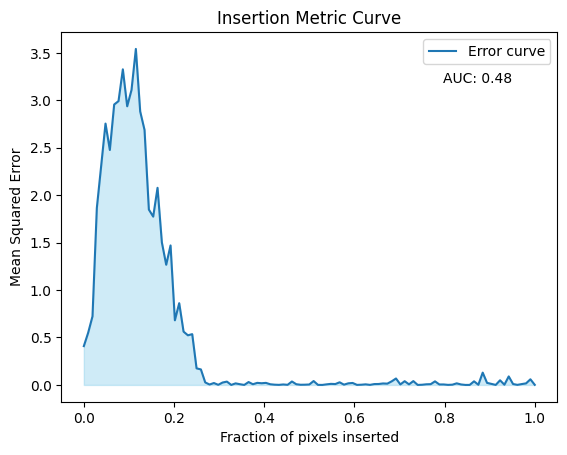

Errors: [0.40897828, 0.55000263, 0.7229789, 1.8650799, 2.3089364, 2.7546284, 2.4766583, 2.9557798, 2.9916852, 3.3265376, 2.936951, 3.1096556, 3.5417187, 2.8823905, 2.6878724, 1.8483198, 1.7740685, 2.0776565, 1.5018184, 1.266699, 1.4702652, 0.68143964, 0.86181355, 0.5619126, 0.523167, 0.53513104, 0.1748091, 0.1633909, 0.026368884, 0.004255701, 0.020068698, 0.0011170934, 0.025218766, 0.034977753, 2.6447247e-05, 0.016337438, 0.0075268294, 1.361192e-06, 0.030303435, 0.0072682775, 0.021723323, 0.017748319, 0.0215117, 0.0070363455, 0.002582999, 0.00067634217, 0.0047875894, 0.0011256201, 0.036190815, 0.007252188, 0.0017124268, 0.002497159, 0.004489771, 0.04088906, 0.0005607185, 2.6044177e-07, 0.0060699596, 0.011199626, 0.009182537, 0.027683947, 0.002813194, 0.01683086, 0.020638421, 0.0005120619, 0.0021799994, 0.006050138, 0.00056419027, 0.008959892, 0.009831893, 0.01541856, 0.013610974, 0.037628047, 0.06785376, 0.0053360444, 0.0392701, 0.006134101, 0.040302858, 0.00017112384, 0.0017714225, 0.

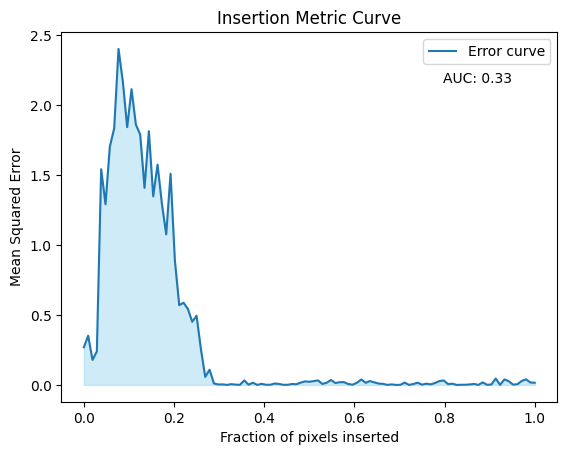

Errors: [0.26978114, 0.3519811, 0.17914174, 0.23919342, 1.5429364, 1.2931043, 1.7054504, 1.8358096, 2.403898, 2.167974, 1.8443843, 2.1159225, 1.8628358, 1.7914968, 1.4097129, 1.8152843, 1.3495438, 1.576168, 1.297291, 1.0773913, 1.5110312, 0.89007646, 0.5706967, 0.58818775, 0.5433987, 0.4519185, 0.49459073, 0.25707605, 0.057330642, 0.10886927, 0.010771458, 0.0030283653, 0.0036531454, 0.00043668092, 0.005336898, 0.0022029355, 0.00073599204, 0.032317378, 0.0016247155, 0.015832813, 4.2107622e-05, 0.007674302, 0.0014883198, 0.0010731879, 0.0100006005, 0.007249447, 0.00084890315, 0.00085148227, 0.006735934, 0.005048702, 0.016075928, 0.0251614, 0.022758832, 0.026926478, 0.032539908, 0.007297943, 0.015471776, 0.03559589, 0.013651782, 0.019623134, 0.019817322, 0.0061942255, 0.0017123084, 0.016004123, 0.038746193, 0.015354798, 0.027853513, 0.017837176, 0.009705587, 0.007678396, 0.0002800987, 0.0036737523, 0.00019766406, 0.0005852113, 0.016799541, 0.00017730093, 0.0067989123, 0.015830113, 0.00183

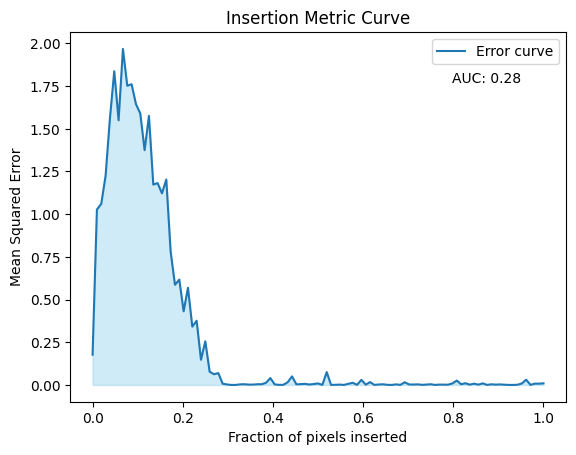

Errors: [0.17677242, 1.0270914, 1.0606834, 1.2246412, 1.5609345, 1.8370005, 1.5500568, 1.9677287, 1.7519095, 1.7610515, 1.6447996, 1.5897543, 1.3746743, 1.5756596, 1.1733016, 1.1819742, 1.1220623, 1.2029272, 0.78173584, 0.5864013, 0.61691314, 0.4312837, 0.5689114, 0.34128493, 0.37602463, 0.14739563, 0.25532067, 0.077218994, 0.0626636, 0.06919384, 0.007366457, 0.002604077, 8.7080684e-07, 9.365686e-06, 0.00322704, 0.0040398594, 0.0019006553, 0.0019215215, 0.004006922, 0.0040454078, 0.012475678, 0.040281273, 0.0030553744, 0.00039884137, 0.0007023693, 0.01578368, 0.050174333, 0.0036498173, 0.00447558, 0.0062655467, 0.0024673438, 0.005291691, 0.008772597, 8.0658174e-05, 0.075250484, 0.00033492697, 0.0006489526, 0.001950854, 7.823985e-09, 0.006679911, 0.012444966, 0.0006352267, 0.029553475, 0.0017054881, 0.016602041, 4.0998017e-05, 0.0026042718, 0.0037626363, 0.0005310694, 5.5243247e-05, 0.003101594, 0.00046828715, 0.015685737, 0.0028431423, 0.002164853, 0.003230752, 0.0005448106, 0.00199209

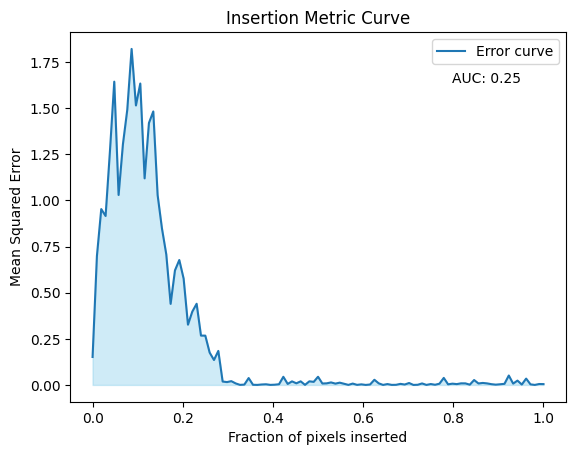

Errors: [0.1514242, 0.6987038, 0.9530116, 0.9155794, 1.2653313, 1.643575, 1.0294812, 1.3048251, 1.491257, 1.8210105, 1.5147352, 1.6334796, 1.1195077, 1.4196764, 1.4821582, 1.0290921, 0.8482568, 0.7071408, 0.43930227, 0.6206257, 0.67700744, 0.57620054, 0.32651532, 0.39733338, 0.43990558, 0.26734394, 0.2671381, 0.17522638, 0.13512842, 0.18431851, 0.018330721, 0.015399441, 0.020451115, 0.00824861, 0.00031642753, 0.0017100992, 0.03722451, 0.0007706192, 0.00014901452, 0.002326943, 0.0034740423, 0.0002174958, 0.0011824324, 0.0036895208, 0.04403045, 0.0053978055, 0.01922331, 0.008789308, 0.019409535, 0.0003189262, 0.019515805, 0.01658902, 0.044268757, 0.007722457, 0.008657593, 0.01359518, 0.0070984196, 0.012265791, 0.006325343, 0.00018272923, 0.007318121, 0.00034795352, 0.0030785732, 1.1016718e-05, 0.0022199438, 0.027886072, 0.008535175, 3.4711902e-05, 0.0046328017, 0.00023893465, 0.000613997, 0.005678474, 0.0021781297, 0.010373065, 1.5151875e-05, 0.00087076396, 0.008062691, 7.4122014e-05, 0.

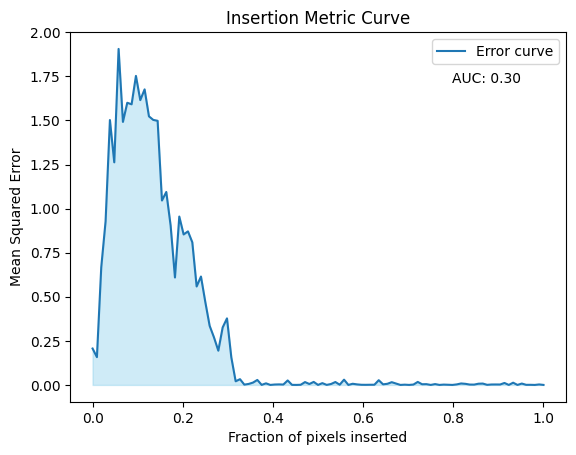

Errors: [0.20647107, 0.15766585, 0.667488, 0.92822343, 1.5025302, 1.2626736, 1.9058713, 1.4920894, 1.6003695, 1.5917715, 1.7527393, 1.6156301, 1.676434, 1.5234683, 1.5031636, 1.4982157, 1.0461658, 1.0944487, 0.90410715, 0.6094518, 0.95493764, 0.8535801, 0.8709706, 0.80916405, 0.5585229, 0.61485046, 0.4702261, 0.33533314, 0.26976156, 0.19426394, 0.32588592, 0.377471, 0.1560897, 0.020631092, 0.03258719, 0.0017010405, 0.005572861, 0.013290063, 0.028251197, 0.00020720912, 0.009006216, 3.7034943e-07, 0.002267511, 0.0029960969, 0.0022260027, 0.025425233, 0.0003995702, 7.3929186e-05, 0.0008298252, 0.016146803, 0.0052403407, 0.017094238, 9.2720154e-05, 0.010173485, 0.00018459356, 0.005278432, 0.016475564, 0.0012221704, 0.029866455, 1.2375382e-07, 0.006562212, 0.0030179173, 0.00081815646, 0.00057454413, 0.00094402576, 0.0010440291, 0.026822709, 0.0032735397, 0.006419801, 0.015582947, 0.007753056, 3.3901964e-05, 0.0014337254, 7.319508e-05, 0.0020752358, 0.017009368, 0.003813982, 0.0043402137, 5.

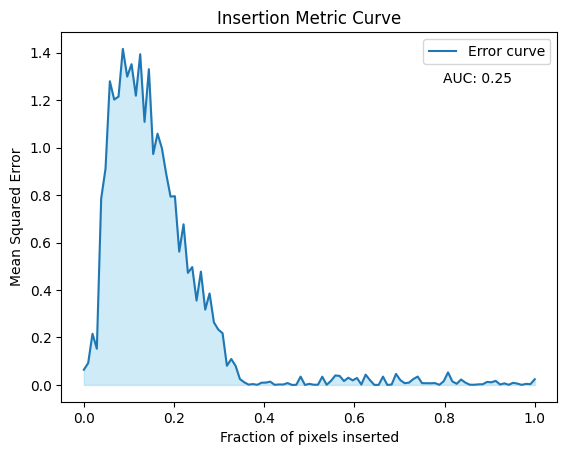

Errors: [0.064075015, 0.092064895, 0.21575627, 0.15255897, 0.7851726, 0.9109819, 1.2797422, 1.2026279, 1.2149903, 1.4159753, 1.2991983, 1.3516061, 1.2189684, 1.3935958, 1.1085612, 1.3306795, 0.97304285, 1.0588279, 0.99789613, 0.8891754, 0.79367214, 0.7953486, 0.5617753, 0.6769559, 0.47226164, 0.49665374, 0.35557276, 0.47746795, 0.31746754, 0.38559088, 0.26383144, 0.23353024, 0.21776962, 0.08079983, 0.109242864, 0.08040356, 0.024722047, 0.011128813, 0.0012783887, 0.0035600788, 0.00050005346, 0.009464354, 0.009889921, 0.013796574, 0.00053405704, 0.0019815653, 0.0017914376, 0.007912894, 9.250218e-07, 0.00044104122, 0.035044402, 1.9489835e-06, 0.004571825, 0.0008967611, 0.0008412169, 0.034668762, 0.00056049833, 0.016931627, 0.03990695, 0.037968695, 0.016354142, 0.030397931, 0.01917498, 0.029208435, 0.0015879557, 0.043336708, 0.020135323, 0.0001720045, 0.00015333535, 0.034999605, 1.564062e-06, 0.0018034864, 0.046413638, 0.020204432, 0.007379559, 0.009692556, 0.024798336, 0.035205845, 0.0074

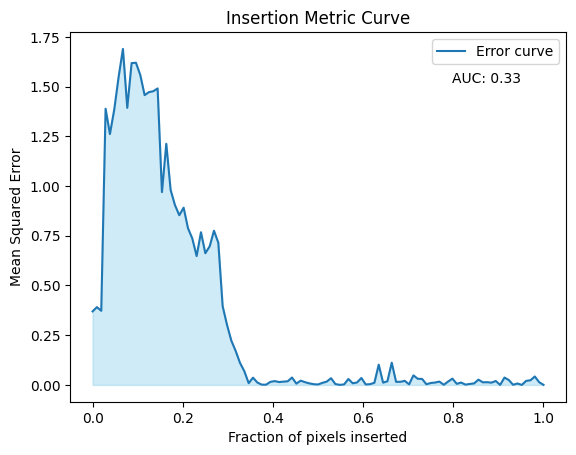

Errors: [0.36983418, 0.3911558, 0.37278855, 1.3890765, 1.2615862, 1.3854529, 1.5481517, 1.6897296, 1.3934039, 1.618453, 1.6202859, 1.558701, 1.4575248, 1.4725181, 1.4770494, 1.491068, 0.96962273, 1.2127771, 0.9804854, 0.90424144, 0.8534544, 0.8915441, 0.7883272, 0.7364642, 0.6479736, 0.76797104, 0.6623651, 0.6965769, 0.7755632, 0.71512645, 0.3959518, 0.30248907, 0.22283718, 0.1709, 0.110834666, 0.06898277, 0.008840502, 0.03656757, 0.012121492, 0.0015277235, 0.0011082578, 0.0152080245, 0.019335436, 0.014417802, 0.016482664, 0.018255748, 0.037203856, 0.0065597207, 0.021455089, 0.013801532, 0.0077809175, 0.0036699094, 0.0022340303, 0.010370928, 0.01673147, 0.033766266, 0.0044225603, 0.00039418877, 0.0024539323, 0.029885905, 0.00824991, 0.012509761, 0.03489825, 0.002455787, 0.0037011588, 0.011012641, 0.10184826, 0.011481011, 0.018227702, 0.11171189, 0.01565935, 0.015537979, 0.020635784, 0.0027729364, 0.048151813, 0.030802941, 0.030096274, 0.0033908072, 0.0097303605, 0.012047241, 0.01675312

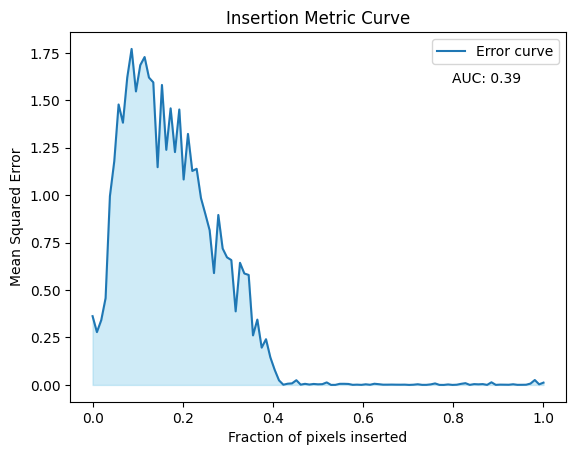

Errors: [0.36237085, 0.27837068, 0.34151548, 0.45720568, 0.9953164, 1.1785293, 1.4780242, 1.3821614, 1.6207511, 1.7708435, 1.546919, 1.6854458, 1.7280998, 1.6201108, 1.5947914, 1.1475152, 1.5809706, 1.2389843, 1.4577736, 1.2271377, 1.4517192, 1.082746, 1.3229628, 1.1276382, 1.1389676, 0.98467153, 0.90140736, 0.8151498, 0.5893702, 0.89581496, 0.7189476, 0.67241806, 0.65802056, 0.38768816, 0.64365286, 0.5873425, 0.5796309, 0.26098004, 0.34434542, 0.19658291, 0.24092579, 0.14538567, 0.07957501, 0.02396136, 0.001047653, 0.006384262, 0.008196206, 0.024843412, 0.0014610272, 0.005768588, 0.0020445697, 0.0050884723, 0.0032328258, 0.0040083104, 0.01326498, 0.00012094051, 0.00029008996, 0.0057533146, 0.0058730883, 0.0051195407, 0.00054670434, 0.0014667924, 0.00040221005, 0.003278862, 0.0008512666, 0.006214339, 0.0039370814, 0.0013748063, 0.0014036066, 0.0017462055, 0.0013261636, 0.0012079094, 0.0014785036, 0.00011722791, 0.0011344362, 0.0035098558, 0.00039611297, 0.00042071217, 0.0028817155, 0.0

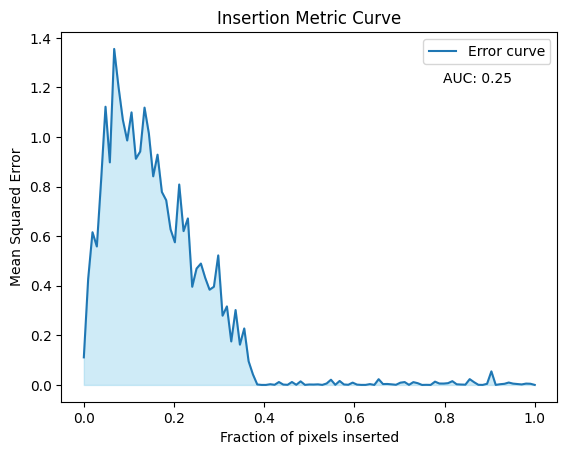

Errors: [0.111190066, 0.42768222, 0.61611104, 0.55852485, 0.82883626, 1.122376, 0.8979006, 1.3556013, 1.2022289, 1.0694791, 0.9861401, 1.0996203, 0.9123944, 0.9415773, 1.1187874, 1.0143299, 0.84165305, 0.9289608, 0.77852106, 0.74500036, 0.6277357, 0.5754175, 0.8086294, 0.62048566, 0.671759, 0.39609852, 0.46939918, 0.48967534, 0.4317795, 0.38411582, 0.39611092, 0.5225859, 0.2793725, 0.31679964, 0.17543332, 0.30211508, 0.16239564, 0.22786751, 0.0956815, 0.042549912, 0.0018001164, 6.176188e-05, 2.1795764e-05, 0.002863621, 0.0005109403, 0.011649607, 0.0014197667, 0.00047801613, 0.011829645, 0.00050264254, 0.014422784, 0.00022623508, 0.0018084815, 0.0014950327, 0.0022850854, 0.00015911329, 0.0057928963, 0.021010166, 0.00035851033, 0.016027447, 0.0018049143, 0.0006597964, 0.00935374, 0.0012811777, 0.0001185585, 0.00017239558, 0.0033334089, 2.8810244e-05, 0.023200084, 0.0034938706, 0.0038562093, 0.0023375703, 0.0005809568, 0.009033705, 0.01152182, 0.00030706148, 0.01127636, 0.007056019, 1.760

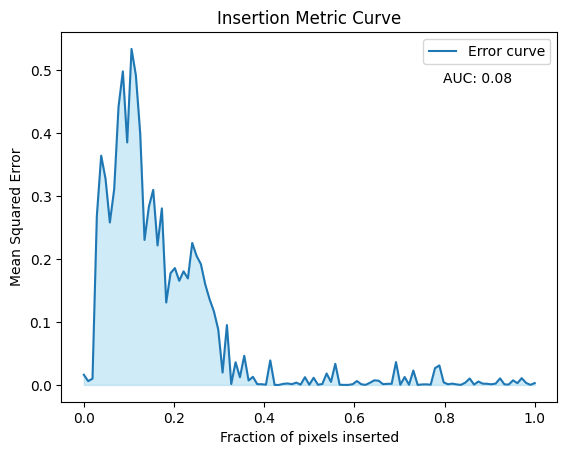

Errors: [0.016153408, 0.0060469112, 0.010013886, 0.26838273, 0.36410046, 0.32757828, 0.25801334, 0.3108474, 0.44167584, 0.49804124, 0.38512585, 0.5336679, 0.49187842, 0.39947888, 0.23030013, 0.28290674, 0.3096991, 0.22157103, 0.2804585, 0.13091184, 0.1774737, 0.18555559, 0.16538928, 0.18038934, 0.16914046, 0.2255472, 0.20499231, 0.19182274, 0.15976237, 0.13613887, 0.116819076, 0.08804483, 0.019632237, 0.09511018, 0.0014584175, 0.036020294, 0.012177126, 0.04624711, 0.007042857, 0.012861178, 0.0012276192, 0.0011044117, 0.00039064893, 0.03897673, 2.984181e-07, 2.9551427e-05, 0.0016808443, 0.0023505448, 0.0011929785, 0.003700557, 0.00041238897, 0.012307494, 0.0002933885, 0.011399205, 0.0003056593, 0.0014381794, 0.018111011, 0.0048019444, 0.033564642, 0.00025880293, 5.0531755e-05, 4.0744995e-05, 0.0011060048, 0.0061802543, 0.0010100331, 0.000117036965, 0.0034918063, 0.0073219254, 0.006683419, 0.0012385785, 0.0017147065, 0.0018431032, 0.036301613, 0.00025001116, 0.01255233, 0.0002781012, 0.0

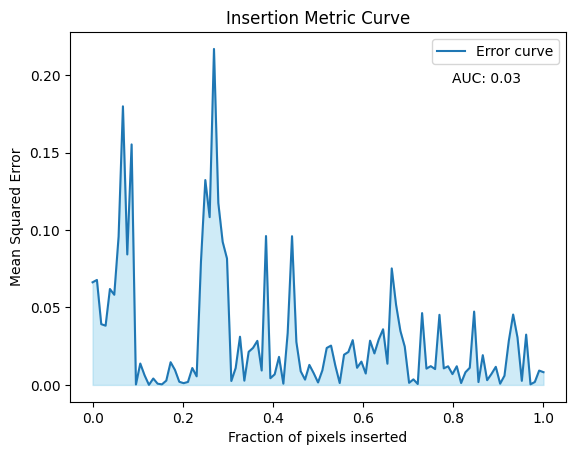

Errors: [0.06625567, 0.06777827, 0.039242443, 0.038249325, 0.06194115, 0.05821852, 0.095779575, 0.17988208, 0.08425022, 0.15528503, 0.0002885064, 0.013817348, 0.006167731, 4.1570565e-05, 0.004149205, 0.00079932134, 0.0003655143, 0.002794207, 0.014665537, 0.009675652, 0.0020137492, 0.001145765, 0.0019317537, 0.010919215, 0.005549534, 0.07967737, 0.13227937, 0.10831118, 0.21693526, 0.117464416, 0.09242105, 0.08160822, 0.0025326032, 0.010898994, 0.031122787, 0.0027555688, 0.02137383, 0.023892673, 0.028453449, 0.009311176, 0.0961309, 0.0043294844, 0.006836917, 0.018123623, 0.00081369915, 0.033594023, 0.09602747, 0.02777854, 0.008834932, 0.003430455, 0.012936807, 0.00757781, 0.0015882265, 0.009438985, 0.02385495, 0.025396138, 0.012319757, 0.0012060499, 0.01950763, 0.02129217, 0.028925445, 0.011065007, 0.015051145, 0.007362457, 0.028584586, 0.02034105, 0.029362049, 0.035933353, 0.013682344, 0.075234, 0.051706724, 0.03480974, 0.02472814, 0.0013538515, 0.0035871728, 0.00059719954, 0.046377458,

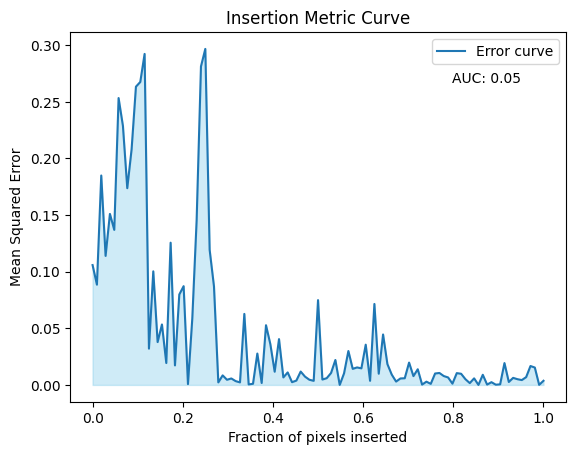

Errors: [0.10586196, 0.08856092, 0.18495588, 0.11394611, 0.15104456, 0.13695554, 0.25336742, 0.22878182, 0.17375739, 0.20814233, 0.26341423, 0.26756623, 0.29234335, 0.03205042, 0.100330025, 0.037852615, 0.05340978, 0.01934379, 0.12562013, 0.01724953, 0.07986174, 0.08722723, 0.0007313972, 0.058786772, 0.14549337, 0.28129095, 0.29675332, 0.119354226, 0.08701172, 0.0022276791, 0.008442141, 0.004561292, 0.005706932, 0.003362389, 0.002239107, 0.06271906, 0.000430985, 0.0010091184, 0.027695075, 0.00171764, 0.05272197, 0.036023032, 0.011678909, 0.04045806, 0.006633484, 0.011031726, 0.0024297363, 0.003833044, 0.011790689, 0.0073176622, 0.0045836773, 0.0036122021, 0.07490148, 0.004762177, 0.005956462, 0.010532652, 0.0220229, 7.4107174e-06, 0.010214034, 0.029956738, 0.014198153, 0.0154482685, 0.014646884, 0.0355362, 0.003637304, 0.0715088, 0.009912945, 0.044549186, 0.018388242, 0.009127468, 0.0029686503, 0.005707747, 0.005896806, 0.019720627, 0.007787628, 0.013832612, 0.00029820242, 0.0028743674

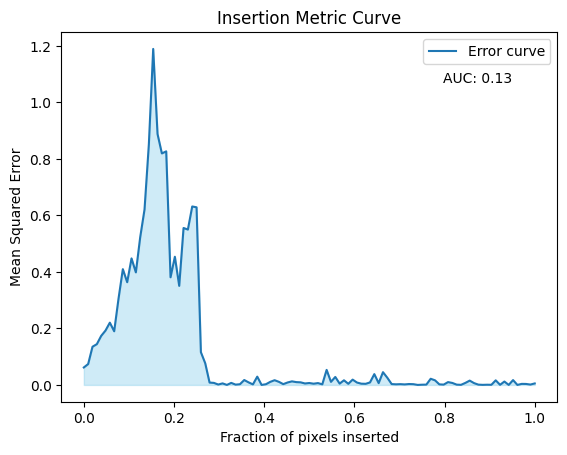

Errors: [0.061791383, 0.07396634, 0.13515419, 0.14426313, 0.17347044, 0.19244814, 0.22034222, 0.18984057, 0.30503738, 0.40967843, 0.36349306, 0.44776252, 0.3982718, 0.52244294, 0.62091017, 0.8518742, 1.1890589, 0.8879438, 0.8192494, 0.82655007, 0.38093308, 0.45363462, 0.35059133, 0.5553886, 0.5497855, 0.6315061, 0.62858224, 0.1158065, 0.07665998, 0.008324703, 0.007217257, 0.0013497163, 0.0054624146, 1.3127488e-05, 0.007209815, 0.0010688633, 0.0024118503, 0.017344179, 0.00901167, 0.0018670165, 0.029284192, 1.0619159e-05, 0.0024691059, 0.010842194, 0.016699998, 0.010873099, 0.0027813576, 0.008671319, 0.012625841, 0.009944911, 0.0091625, 0.005158124, 0.0067232405, 0.0043452964, 0.006507591, 0.002039689, 0.053200003, 0.010883456, 0.028235892, 0.00462179, 0.016408337, 0.0039835633, 0.018770508, 0.008432424, 0.004413036, 0.0039189635, 0.008799862, 0.038264178, 0.0063066985, 0.04510397, 0.025383089, 0.0029835298, 0.0021365809, 0.0027231404, 0.0017891628, 0.0031646567, 0.0026527804, 3.4830347e

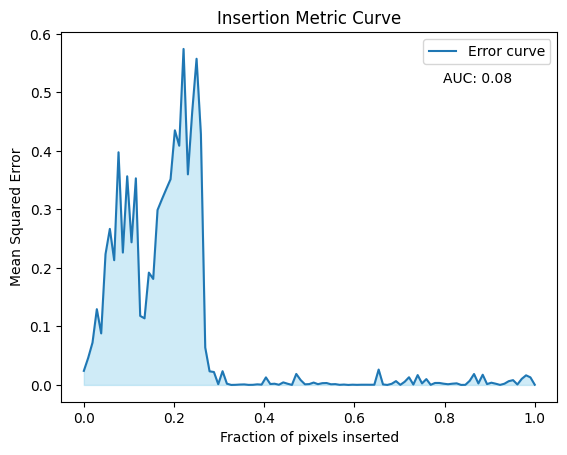

Errors: [0.024034657, 0.046143495, 0.07228896, 0.12947975, 0.08809485, 0.22356696, 0.26674497, 0.21322107, 0.3977445, 0.22630316, 0.3566938, 0.24381158, 0.35318708, 0.11799869, 0.1138364, 0.19202514, 0.18121268, 0.29903138, 0.31718343, 0.33462334, 0.35166046, 0.43532595, 0.40898016, 0.57441866, 0.3599905, 0.467189, 0.5576232, 0.42868748, 0.06391461, 0.023248607, 0.022099478, 0.0012698019, 0.023476861, 0.0021002917, 3.6416177e-06, 0.00019304715, 0.0006390542, 0.00086566375, 8.305463e-05, 0.0001905756, 0.0009869463, 0.0005053134, 0.012877921, 0.0015579764, 0.0020460037, 0.00029239492, 0.0043533314, 0.0020333142, 1.0527292e-05, 0.018763209, 0.0083882995, 0.0010628056, 0.0014255085, 0.004056842, 0.001303466, 0.0029875943, 0.0032302372, 0.0010937253, 0.0013815596, 0.00018395435, 0.00061936403, 2.897652e-06, 0.00040114447, 0.00014103341, 0.00032697464, 0.00034533453, 0.00029377453, 0.0003450134, 0.026262669, 0.0008373317, 8.332421e-06, 0.0019050391, 0.0065243538, 0.0001409499, 0.0054143798, 

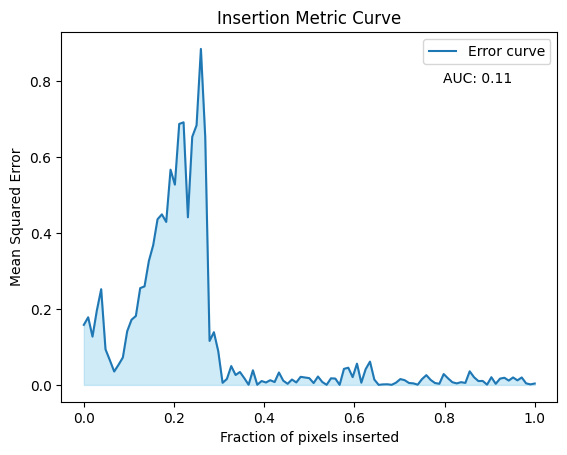

Errors: [0.15828441, 0.17828809, 0.12733364, 0.19619156, 0.2522983, 0.093798175, 0.06518898, 0.035407595, 0.05307107, 0.072386265, 0.1414656, 0.1718662, 0.18173859, 0.25519183, 0.2598042, 0.32672167, 0.36846092, 0.43666723, 0.44955713, 0.42961758, 0.567393, 0.5279299, 0.6879396, 0.6921295, 0.44186598, 0.6538168, 0.6844117, 0.8856139, 0.6539986, 0.11592702, 0.1390029, 0.088921756, 0.0055346163, 0.015837103, 0.049708474, 0.026137063, 0.034060877, 0.018042766, 0.0005353692, 0.038584005, 0.00047004814, 0.010251573, 0.006397051, 0.012471537, 0.007554852, 0.03280749, 0.011135026, 0.0029900675, 0.014221373, 0.0065611643, 0.021331701, 0.019613225, 0.0178741, 0.0049008126, 0.022164794, 0.0077024247, 0.00026399613, 0.017421411, 0.016811626, 0.00028415135, 0.042344343, 0.045385964, 0.020551547, 0.056058157, 0.0058283447, 0.041558262, 0.061416563, 0.014156656, 0.0001924439, 0.0014249661, 0.001718517, 0.0002800179, 0.0059382366, 0.015439365, 0.012506901, 0.0051044887, 0.004145685, 0.0006422375, 0.0

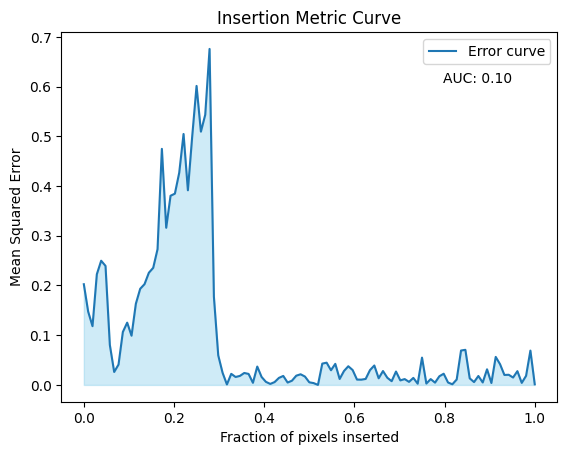

Errors: [0.20256089, 0.14745028, 0.11816689, 0.22265145, 0.24981931, 0.23941626, 0.08040721, 0.02607999, 0.040911477, 0.10652477, 0.12526256, 0.099012874, 0.16334778, 0.19337189, 0.20273224, 0.22566256, 0.23554254, 0.2729756, 0.47484043, 0.31611973, 0.38051072, 0.38472632, 0.426774, 0.5047755, 0.39153466, 0.50034994, 0.60144436, 0.5094447, 0.54338866, 0.67586005, 0.17733878, 0.05948794, 0.024460977, 0.00094549876, 0.022320287, 0.015974894, 0.018144893, 0.024043897, 0.022147272, 0.0042572487, 0.03693152, 0.015992958, 0.0061703525, 0.0020269225, 0.0057419855, 0.01415511, 0.018079307, 0.004807026, 0.008501858, 0.018594144, 0.021419674, 0.01684472, 0.0052684504, 0.003700158, 5.264779e-06, 0.042867195, 0.04475252, 0.029555954, 0.04237864, 0.011985889, 0.027976822, 0.037577886, 0.029932281, 0.010788396, 0.010613387, 0.012055643, 0.02982194, 0.039077334, 0.013359768, 0.027921628, 0.014388316, 0.0075208633, 0.026938707, 0.009118274, 0.011788172, 0.0061498666, 0.014122076, 0.0025094305, 0.05489

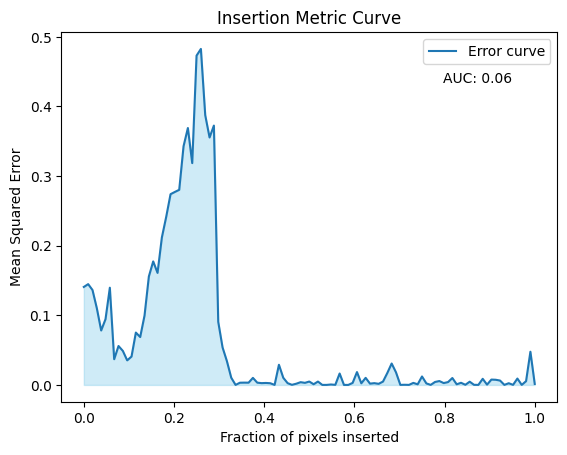

Errors: [0.14075461, 0.14479204, 0.13631839, 0.11013318, 0.078211926, 0.09440879, 0.13965476, 0.036937255, 0.055910457, 0.048861783, 0.03527317, 0.040758234, 0.075206265, 0.068802096, 0.09962771, 0.15581799, 0.1774342, 0.16094846, 0.21186352, 0.24149267, 0.2740219, 0.27723715, 0.28027734, 0.34292975, 0.36910024, 0.31865254, 0.47307497, 0.48269555, 0.38754788, 0.35549325, 0.37258577, 0.09064713, 0.05380161, 0.034139697, 0.010354988, 1.04481505e-05, 0.0031700272, 0.0033006049, 0.0032321208, 0.010118556, 0.003260784, 0.0025773009, 0.002828443, 0.002437399, 2.3603803e-05, 0.02895476, 0.010258979, 0.0025513824, 0.00014308651, 0.0017440219, 0.00394132, 0.0029903413, 0.0048595485, 0.0009894702, 0.004830838, 2.7829516e-05, 3.8586302e-05, 0.00061984325, 0.0001267172, 0.016393749, 1.3513832e-07, 1.0517238e-05, 0.00291681, 0.018453194, 0.0023386886, 0.010171441, 0.0018449896, 0.002550404, 0.0015807102, 0.0048175203, 0.017181529, 0.03075857, 0.018044215, 8.4514046e-05, 0.00021276275, 6.313962e-05,

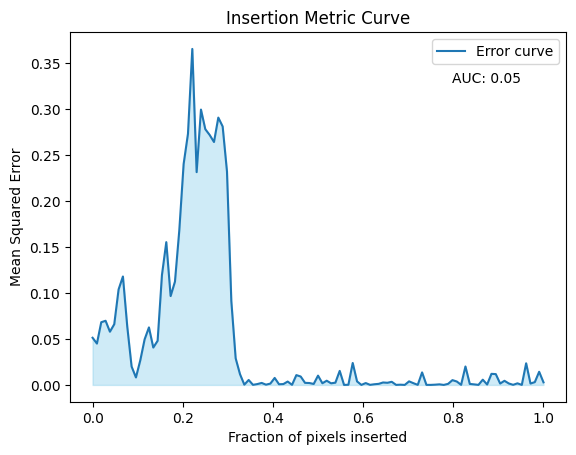

Errors: [0.051270112, 0.044946685, 0.06815534, 0.069724955, 0.057850704, 0.06599082, 0.1037954, 0.11787047, 0.06334157, 0.019977793, 0.008148304, 0.026651116, 0.049491305, 0.06251785, 0.040626034, 0.04796543, 0.11948053, 0.15520565, 0.096578754, 0.1122577, 0.16799036, 0.24010135, 0.27290782, 0.36521217, 0.23128234, 0.29927316, 0.27795434, 0.2717194, 0.26404393, 0.2905657, 0.2809344, 0.23194888, 0.09114496, 0.028963776, 0.011695095, 0.00029706102, 0.005367754, 0.00010146065, 0.0009223874, 0.0021621417, 0.0002734116, 0.0014423507, 0.0075886995, 0.0007325679, 0.0009334265, 0.003668317, 9.234288e-05, 0.010670405, 0.009125555, 0.002243255, 0.0020738405, 0.0010705614, 0.010103525, 0.001821498, 0.0045736586, 0.0017675211, 0.0024379727, 0.015246123, 1.5842146e-05, 0.00017760899, 0.023856882, 0.0037984713, 2.7821969e-05, 0.0020292685, 9.102338e-05, 0.00073213724, 0.0011746527, 0.0026575963, 0.002334102, 0.0033946298, 5.8990623e-05, 0.00025230658, 8.771992e-06, 0.0038790137, 0.0018868096, 6.5767

In [ ]:
# INSERTION: Inserting all pixels in order of importance

# Statistics for insertion with elements of the type: [errors, auc]
temporal_insertion_stats_vott_norm_all_lstm = []

# Load the models for processing
models = vott_lstm_models_loaded

# Iterate through each instance and its corresponding important frames
for i, top_frames_i in enumerate(vott_norm_all_istances_important_frames):
    # Initialize an array to hold blurred images
    initial_blurred_images = np.zeros((104, 5, 8, 3))

    print(f"Insertion all frames in order of importance for Instance nr {i} ")

    # Assign the current instance number
    nr_instance = i

    # Get the errors and AUC from the insertion process
    errors, auc = get_errors_from_insertion(vottignasco_test_image, vottingasco_test_OHE, nr_instance, top_frames_i, initial_blurred_images, models)

    # Store the errors and AUC in the statistics list
    temporal_insertion_stats_vott_norm_all_lstm.append(np.array([errors, auc], dtype=object))

    # Print the results for the current instance
    print(f"Errors: {errors}")
    print(f"AUC: {auc}")
    print("#############################################################", "\n")


Mean Errors for Nr of Pixel Inserted, Vottignasco: 
 [0.7112243  0.7591642  0.7664512  0.78736407 0.8613561  0.8521137
 0.82889926 0.80059874 0.7987193  0.8217658  0.792383   0.7733867
 0.7502533  0.71798617 0.7002706  0.6785689  0.6600286  0.6315601
 0.6203964  0.6058954  0.60246944 0.57771456 0.5882784  0.590655
 0.5839257  0.5844555  0.5780848  0.56638277 0.5681871  0.5828754
 0.548852   0.5112538  0.4833774  0.44931713 0.4465232  0.42456707
 0.38502327 0.35854387 0.33199382 0.2977826  0.25165996 0.23677558
 0.20802678 0.18854885 0.14890338 0.13901776 0.11766396 0.09490991
 0.08355689 0.05946974 0.05478518 0.03765529 0.03134006 0.02059517
 0.01409241 0.01165791 0.0114965  0.00894353 0.00854253 0.00926873
 0.01095147 0.00908943 0.00863609 0.00821336 0.00809977 0.00933716
 0.00882426 0.00892182 0.00804562 0.01129988 0.00807847 0.00942849
 0.00847997 0.00697994 0.00841824 0.00615298 0.00994316 0.00740668
 0.00605205 0.00892768 0.00693943 0.00904892 0.00819519 0.00626293
 0.00980657 0.0

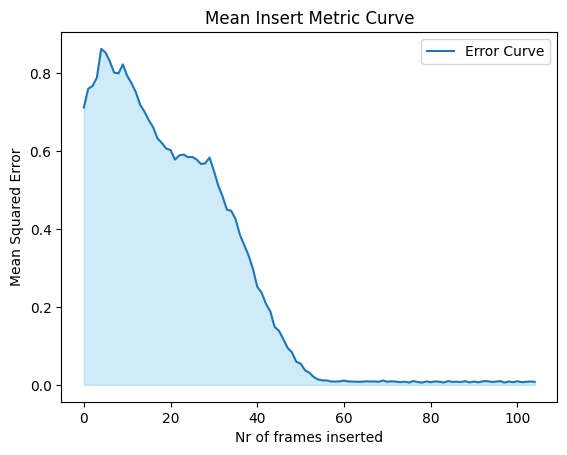

In [ ]:
# Mean errors for Insertion

# Extract only the errors from the insertion statistics
only_errors_inseertion_vott = [errors for errors, _ in temporal_insertion_stats_vott_norm_all_lstm]

# Calculate the mean errors across all instances for each number of pixels inserted
temporal_mean_errors_for_insertion_vott_norm = np.mean(only_errors_inseertion_vott, axis=0)
print("Mean Errors for Number of Pixels Inserted, Vottignasco: \n", temporal_mean_errors_for_insertion_vott_norm)

# Plotting the error curve and the area under the curve (AUC)
x = np.arange(0, 105)  # Create an array from 0 to 104 (representing number of frames inserted)
plt.plot(x, temporal_mean_errors_for_insertion_vott_norm, label='Error Curve')  # Plot the mean error curve
plt.fill_between(x, temporal_mean_errors_for_insertion_vott_norm, color='skyblue', alpha=0.4)  # Fill the area under the curve
plt.xlabel('Number of Frames Inserted')  # Label for the x-axis
plt.ylabel('Mean Squared Error')  # Label for the y-axis
plt.title('Mean Insert Metric Curve')  # Title of the plot
plt.legend()  # Show the legend
plt.show()  # Display the plot


##### ***Deletion***

In [ ]:
vott_norm_all_istances_important_frames = [np.argsort(-sv)[:] for sv in temp_sv_vott_norm_all_instances]

print("Length of important_frames: ", len(vott_norm_all_istances_important_frames))
print("Example:")
vott_norm_all_istances_important_frames[0]

Length of important_frames:  105
Example:


array([103, 102, 101, 100,  99,  98,  97,  96,  95,  94,  93,  92,  91,
        90,  89,  88,  87,  86,  85,  84,  83,  82,  81,  80,  79,  78,
        77,  76,  75,  74,  60,  61,  59,  62,  58,  63,  73,  57,  64,
        65,  56,  66,  72,  67,  55,  71,  68,  69,  70,  54,  53,  52,
        51,  50,  49,  48,  47,  46,  45,  44,  43,  42,  41,  40,  39,
        38,  37,  36,  35,  34,  33,  32,  31,  30,  29,  28,  27,  26,
        25,  24,  23,  22,  21,  20,  19,  18,  17,  16,  15,  14,  13,
        12,  11,  10,   9,   8,   7,   6,   5,   4,   3,   2,   1,   0])

Deletion 21 top frames for Istance nr 0 
Importants indices ->  [103 102 101 100  99  98  97  96  95  94  93  92  91  90  89  88  87  86
  85  84  83  82  81  80  79  78  77  76  75  74  60  61  59  62  58  63
  73  57  64  65  56  66  72  67  55  71  68  69  70  54  53  52  51  50
  49  48  47  46  45  44  43  42  41  40  39  38  37  36  35  34  33  32
  31  30  29  28  27  26  25  24  23  22  21  20  19  18  17  16  15  14
  13  12  11  10   9   8   7   6   5   4   3   2   1   0] 

Original prediction: [0.17540492]
Initial Prediction with Original Images, prediction: [0.17540492], error: 0.0
Removed frame 103, new prediction: [0.20734987], error: 0.001020479598082602
Removed frame 102, new prediction: [0.18765154], error: 0.0001499797945143655
Removed frame 101, new prediction: [0.09385369], error: 0.006650603376328945
Removed frame 100, new prediction: [0.12350331], error: 0.002693776972591877
Removed frame 99, new prediction: [0.15757844], error: 0.00031778347329236567
Removed fram

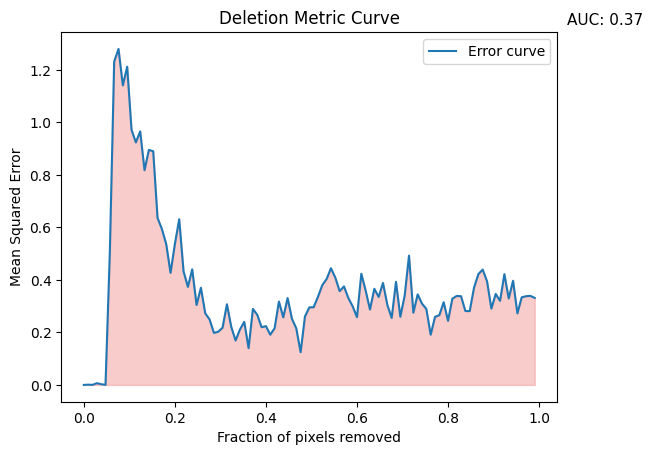

Errors: [0.0, 0.0010204796, 0.0001499798, 0.0066506034, 0.002693777, 0.00031778347, 0.5063781, 1.2318177, 1.2798588, 1.1409429, 1.212172, 0.97174084, 0.92381126, 0.96578926, 0.81789774, 0.89521754, 0.8903217, 0.6360891, 0.5941592, 0.5364611, 0.4269815, 0.53684396, 0.63116235, 0.43261266, 0.37354413, 0.440382, 0.30438992, 0.3702206, 0.2727899, 0.24956287, 0.19835663, 0.20266905, 0.21802087, 0.30731103, 0.22138399, 0.16931589, 0.21090434, 0.24040806, 0.14010423, 0.28964952, 0.26699585, 0.21984963, 0.22402337, 0.19134498, 0.21587396, 0.31755346, 0.25751027, 0.33096457, 0.25208667, 0.2154552, 0.12469001, 0.26072997, 0.29525647, 0.29603505, 0.33572632, 0.38021258, 0.40351132, 0.44450775, 0.40891957, 0.35722435, 0.37531012, 0.3314411, 0.29942578, 0.25814444, 0.4235608, 0.35951838, 0.28710416, 0.36624756, 0.33531052, 0.38838768, 0.30518574, 0.25513446, 0.39275968, 0.2598337, 0.34007883, 0.49249485, 0.27522445, 0.34486228, 0.3095954, 0.28940332, 0.19138706, 0.25925875, 0.26584026, 0.3151031, 0

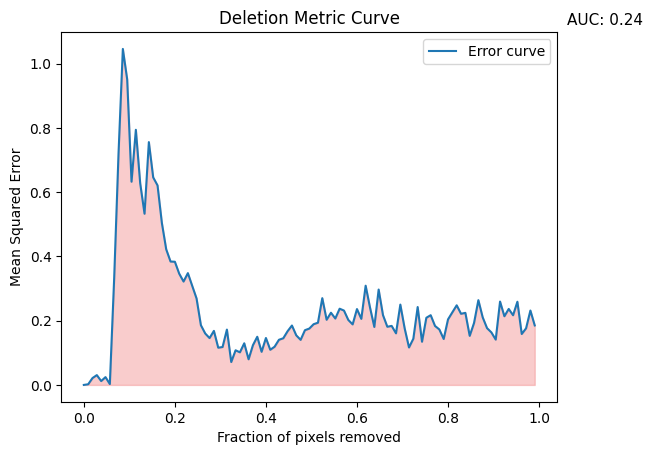

Errors: [0.0, 0.0020048867, 0.021366075, 0.030545041, 0.0120324185, 0.024323864, 0.0026579972, 0.33239686, 0.7198839, 1.0461476, 0.951336, 0.6327022, 0.7943565, 0.6278129, 0.5330055, 0.75601727, 0.6460923, 0.621229, 0.5043139, 0.4222262, 0.38421008, 0.3835151, 0.34634814, 0.32187524, 0.34810638, 0.30847025, 0.2691401, 0.18598355, 0.16012004, 0.14583175, 0.168258, 0.115925856, 0.11802177, 0.17231895, 0.071296155, 0.10783563, 0.10153777, 0.12964123, 0.0798208, 0.12361579, 0.14992373, 0.10311047, 0.14610311, 0.10944301, 0.11898449, 0.14054058, 0.14525086, 0.16730407, 0.18496022, 0.15431127, 0.14033978, 0.17039901, 0.17544055, 0.18904488, 0.19372813, 0.2701827, 0.20290336, 0.22478044, 0.20677775, 0.2372899, 0.23154852, 0.20228909, 0.18846652, 0.23618826, 0.20574898, 0.308901, 0.24142636, 0.18054222, 0.29693854, 0.21729857, 0.18111767, 0.1837615, 0.16066025, 0.25005352, 0.17599078, 0.116654545, 0.14389953, 0.24247874, 0.13447979, 0.20909165, 0.21713883, 0.18362117, 0.17269649, 0.14306033, 0

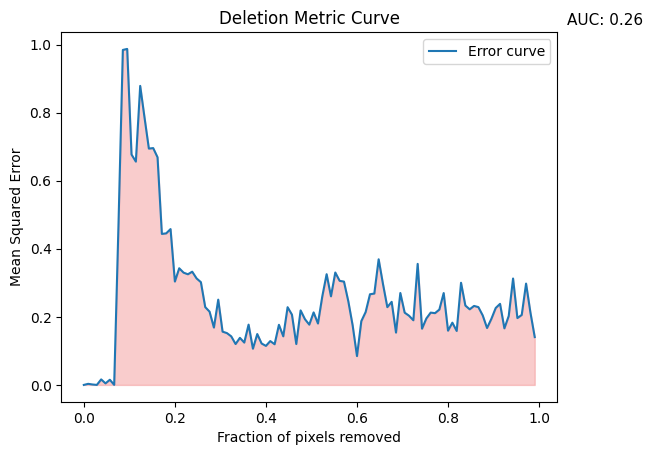

Errors: [0.0, 0.0031883735, 0.0012659307, 2.1947964e-05, 0.016215932, 0.0045648813, 0.015190124, 0.00019928976, 0.47360742, 0.9841164, 0.9870971, 0.6768807, 0.65607566, 0.8784949, 0.7853796, 0.6943401, 0.69575834, 0.6687619, 0.4436011, 0.44529697, 0.45784578, 0.30373272, 0.3427087, 0.3298799, 0.325068, 0.33264947, 0.31295672, 0.3018522, 0.22855984, 0.21527159, 0.16851984, 0.25047138, 0.1565022, 0.15229857, 0.14267014, 0.12014383, 0.1383055, 0.124436475, 0.17713502, 0.10641792, 0.14946432, 0.12170981, 0.11466872, 0.12884074, 0.119527794, 0.17663671, 0.14277166, 0.2283292, 0.20647308, 0.12017916, 0.2188967, 0.19304691, 0.17711787, 0.21301052, 0.18046536, 0.26005226, 0.3253363, 0.26028362, 0.3302437, 0.3057613, 0.30355942, 0.2457601, 0.17505935, 0.08473235, 0.18733111, 0.21417564, 0.26634604, 0.26844314, 0.3690378, 0.2962707, 0.22853766, 0.24409597, 0.15377992, 0.2699974, 0.21230489, 0.20334786, 0.18996254, 0.3556056, 0.16523129, 0.19517654, 0.21243514, 0.21089494, 0.22134596, 0.2699373, 

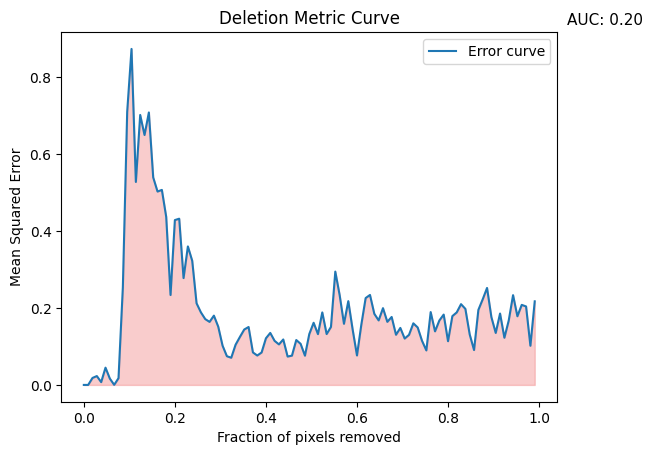

Errors: [0.0, 1.1960178e-06, 0.018116787, 0.023033425, 0.007220706, 0.04481109, 0.016451418, 0.0002450915, 0.017523102, 0.25345895, 0.7092413, 0.872595, 0.52712905, 0.70109516, 0.6490308, 0.70759034, 0.5389117, 0.5021813, 0.50650376, 0.43639907, 0.23351736, 0.42808023, 0.4317011, 0.27746403, 0.3597004, 0.32237944, 0.21201472, 0.18849058, 0.17097947, 0.16371337, 0.17994095, 0.15128894, 0.10186505, 0.074496545, 0.07061509, 0.10436742, 0.12466528, 0.14392851, 0.15041159, 0.08441717, 0.076374196, 0.08420464, 0.12110144, 0.13504177, 0.11440101, 0.10523635, 0.11805294, 0.07371886, 0.07602061, 0.11658469, 0.10674165, 0.075943, 0.13204879, 0.16142711, 0.13192064, 0.18830627, 0.13213868, 0.15054555, 0.29429683, 0.23352583, 0.15877807, 0.21767204, 0.14396122, 0.076542795, 0.15625474, 0.22560139, 0.23367177, 0.1846199, 0.1675421, 0.19937602, 0.1638387, 0.17649944, 0.13028724, 0.14802791, 0.12046015, 0.13000311, 0.15998627, 0.1492701, 0.11467713, 0.08961331, 0.18914244, 0.13914193, 0.16734357, 0.1

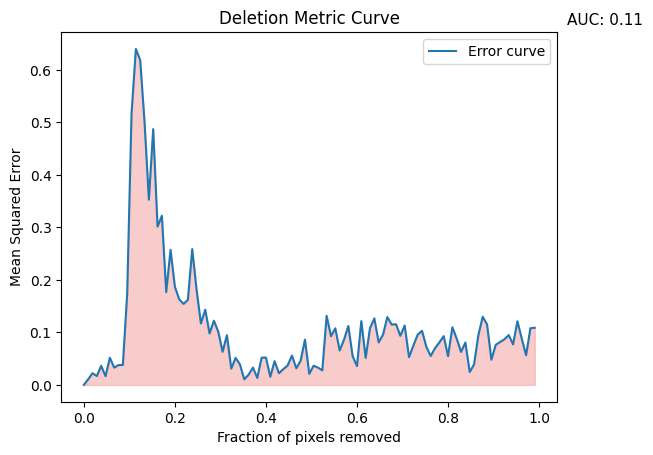

Errors: [0.0, 0.010785381, 0.022326022, 0.017026281, 0.036362965, 0.016624674, 0.051681884, 0.03305303, 0.03778534, 0.038070712, 0.17404503, 0.5163248, 0.63987136, 0.6186859, 0.5007568, 0.35283583, 0.4871823, 0.30151647, 0.3221936, 0.17679557, 0.25732926, 0.18697186, 0.16298383, 0.154337, 0.16207288, 0.25873363, 0.18137723, 0.11709728, 0.14324357, 0.098047495, 0.1222759, 0.10163563, 0.06315533, 0.09479581, 0.031134186, 0.05155636, 0.039136104, 0.010666144, 0.019496625, 0.03307552, 0.013332025, 0.051897436, 0.052197684, 0.015768843, 0.04519328, 0.022291213, 0.030116586, 0.036988605, 0.055877637, 0.03176087, 0.045995016, 0.086167656, 0.02119869, 0.036631722, 0.032934293, 0.027836883, 0.13153948, 0.09272891, 0.107807815, 0.065719865, 0.085998654, 0.11226249, 0.054806516, 0.035843585, 0.121475235, 0.051507328, 0.10799923, 0.12677985, 0.08103633, 0.09560998, 0.12916684, 0.11488677, 0.115682155, 0.093590006, 0.11305261, 0.0529553, 0.07474528, 0.095852375, 0.10298861, 0.07240801, 0.055109482,

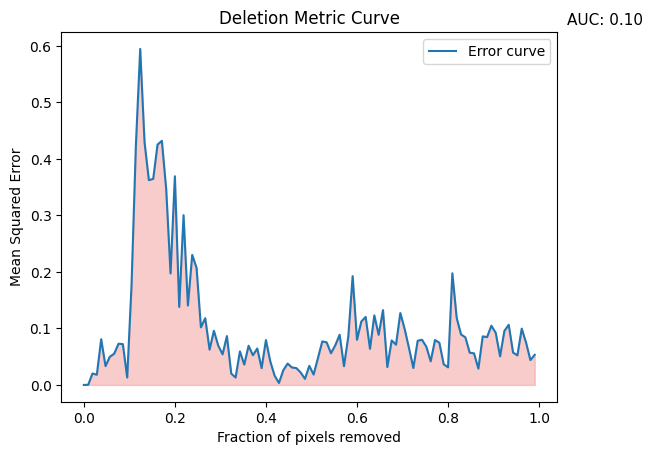

Errors: [0.0, 0.00019178215, 0.020266565, 0.018094538, 0.08084371, 0.03328648, 0.049955748, 0.055181872, 0.072892666, 0.07225838, 0.013106425, 0.17586684, 0.4227668, 0.5945959, 0.42975777, 0.36240694, 0.36462584, 0.42531264, 0.43195075, 0.34610972, 0.19733587, 0.36924314, 0.13803312, 0.3003678, 0.14054254, 0.23009177, 0.20709892, 0.101905026, 0.11812915, 0.062427007, 0.09575567, 0.069625996, 0.054194845, 0.086488, 0.020063005, 0.01307695, 0.05934587, 0.036051046, 0.06932959, 0.052511714, 0.06452409, 0.029634377, 0.07938563, 0.041694902, 0.016437287, 0.0034364134, 0.025864512, 0.037840605, 0.030891232, 0.02986732, 0.022161476, 0.010760722, 0.033749774, 0.01831978, 0.047699083, 0.07696667, 0.07533426, 0.056072384, 0.0702697, 0.088859305, 0.03316141, 0.08566198, 0.1925007, 0.079879194, 0.112211846, 0.12031574, 0.06396058, 0.123100944, 0.08865517, 0.13237771, 0.031630687, 0.0787813, 0.07125712, 0.12723736, 0.098817654, 0.06508958, 0.029960059, 0.078164876, 0.07988991, 0.067567825, 0.041775

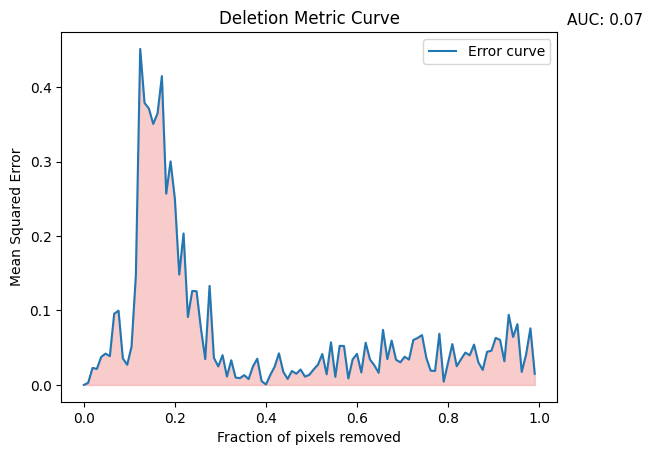

Errors: [0.0, 0.0028426782, 0.022866089, 0.021509312, 0.03759968, 0.0420681, 0.03871459, 0.095651746, 0.099732, 0.0356252, 0.027089534, 0.05139722, 0.14731948, 0.4514338, 0.37891608, 0.37139672, 0.35069764, 0.36480185, 0.41492233, 0.25701052, 0.30033207, 0.24987687, 0.14826433, 0.20353164, 0.09124511, 0.12624805, 0.12593065, 0.07615239, 0.034715258, 0.13304989, 0.036368445, 0.02486258, 0.03994263, 0.011247529, 0.033142697, 0.009871697, 0.009113442, 0.013151528, 0.007845849, 0.02475983, 0.035252452, 0.0051389807, 0.00062452507, 0.013333773, 0.024419166, 0.042412292, 0.01766352, 0.008084929, 0.01870584, 0.015034652, 0.020764109, 0.011184039, 0.013600406, 0.020842753, 0.027243795, 0.041586336, 0.014285488, 0.05725129, 0.010846589, 0.052483857, 0.05234715, 0.008691156, 0.03431716, 0.04173593, 0.016732333, 0.056756936, 0.03421748, 0.026392156, 0.016262436, 0.073921666, 0.03459819, 0.05963282, 0.033902347, 0.030381639, 0.0378625, 0.03410399, 0.06042553, 0.06309418, 0.06696404, 0.036193807, 0

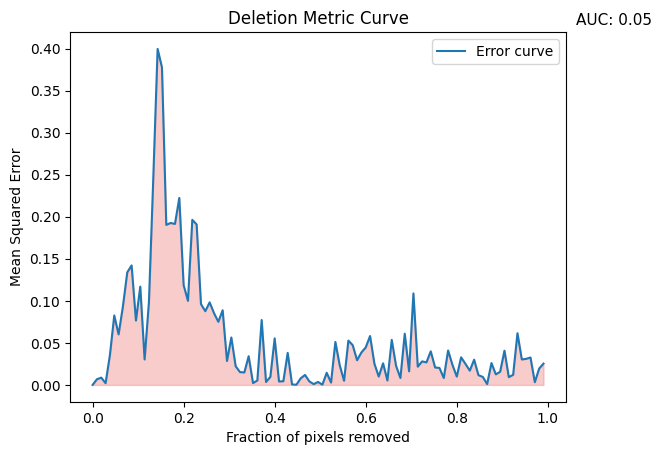

Errors: [0.0, 0.006745937, 0.008675216, 0.0020181676, 0.035616066, 0.0826124, 0.06007598, 0.093460076, 0.13390046, 0.14210619, 0.07660643, 0.11692316, 0.030306341, 0.09885648, 0.24569722, 0.3995516, 0.377633, 0.19032964, 0.1925812, 0.19143671, 0.22232938, 0.11862609, 0.10001114, 0.19630252, 0.19083673, 0.09610229, 0.08769322, 0.09816683, 0.08542221, 0.075074494, 0.08877934, 0.028474808, 0.0563925, 0.022230474, 0.015247581, 0.014851334, 0.034131624, 0.0022314335, 0.0052576317, 0.07716994, 0.0034720541, 0.009571735, 0.055367973, 0.0040637013, 0.0044224015, 0.03809139, 0.00064467476, 0.00021054632, 0.007857055, 0.011875393, 0.0041844794, 0.0009520899, 0.0035591684, 0.00029490347, 0.014417974, 0.0028024681, 0.051087618, 0.02334242, 0.004968454, 0.05272547, 0.047259785, 0.029355044, 0.038585693, 0.04461896, 0.05816282, 0.025264828, 0.009965202, 0.025715113, 0.005247929, 0.05357193, 0.022632618, 0.008278411, 0.0609221, 0.01618697, 0.10884504, 0.021731265, 0.02797734, 0.026818687, 0.03992986,

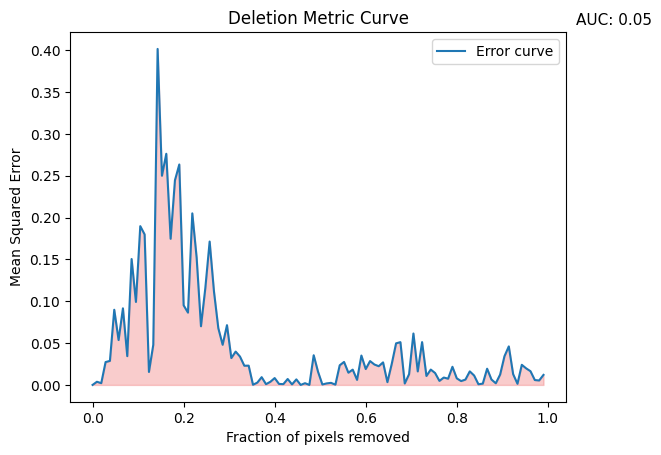

Errors: [0.0, 0.003774565, 0.002093141, 0.027323246, 0.028721055, 0.08984077, 0.053658668, 0.09156099, 0.034395956, 0.15050294, 0.09918862, 0.18980047, 0.1799111, 0.015509892, 0.047926094, 0.4016344, 0.2500518, 0.27629697, 0.17468378, 0.24467067, 0.26348853, 0.09514775, 0.08643559, 0.20507413, 0.15227917, 0.07013976, 0.115558885, 0.17139281, 0.111627236, 0.06783852, 0.04798123, 0.071461625, 0.03211657, 0.039843723, 0.033875596, 0.022940706, 0.023044663, 0.00017318691, 0.0027798645, 0.009270971, 0.0008987685, 0.003736132, 0.008205911, 0.001167811, 0.0009348147, 0.007093961, 0.00060768897, 0.006623453, 2.0981872e-06, 0.002063896, 8.885842e-07, 0.035488125, 0.015707064, 0.00050942705, 0.0018336525, 0.0024612132, 0.00030714294, 0.02346541, 0.027486391, 0.014623261, 0.018283673, 0.0060303668, 0.03512311, 0.018989097, 0.02851298, 0.024409834, 0.022388052, 0.026941583, 0.0032980782, 0.025105573, 0.04969471, 0.05112974, 0.0017157532, 0.012824702, 0.061461713, 0.016169427, 0.051161148, 0.010695

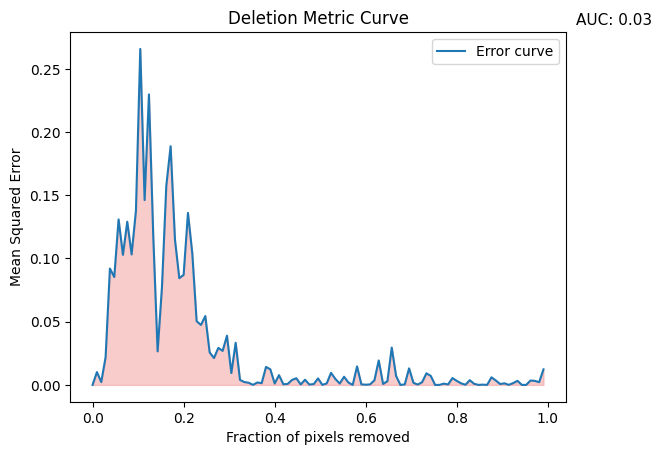

Errors: [0.0, 0.010140951, 0.0022389293, 0.021866014, 0.09205979, 0.08534341, 0.13090885, 0.10288492, 0.12908669, 0.10321105, 0.13771254, 0.26575065, 0.14621451, 0.2297502, 0.11717808, 0.026546966, 0.07725722, 0.15741499, 0.18878287, 0.114973776, 0.08440475, 0.08705311, 0.13604029, 0.103978105, 0.050382134, 0.047467023, 0.054472994, 0.025762504, 0.021262957, 0.029277032, 0.026946494, 0.038935035, 0.009410307, 0.033335716, 0.0039772987, 0.0022600978, 0.0017372703, 4.4985616e-05, 0.0019222794, 0.0014016912, 0.014232862, 0.012366402, 0.0011379562, 0.0077339113, 0.0004898852, 0.0007769462, 0.003947066, 0.005284288, 0.00035122328, 0.004103291, 0.00030043809, 0.0006594321, 0.0051413397, 4.2259373e-05, 0.0011986343, 0.009555495, 0.004717571, 0.0010901052, 0.006468213, 0.0019183562, 4.6324974e-08, 0.014635791, 0.00044267, 0.00017951097, 0.00041215416, 0.003651265, 0.019371456, 0.00077712897, 0.0029490932, 0.029539581, 0.0070883594, 1.932708e-06, 0.0004089007, 0.013113482, 0.0016588649, 0.00028

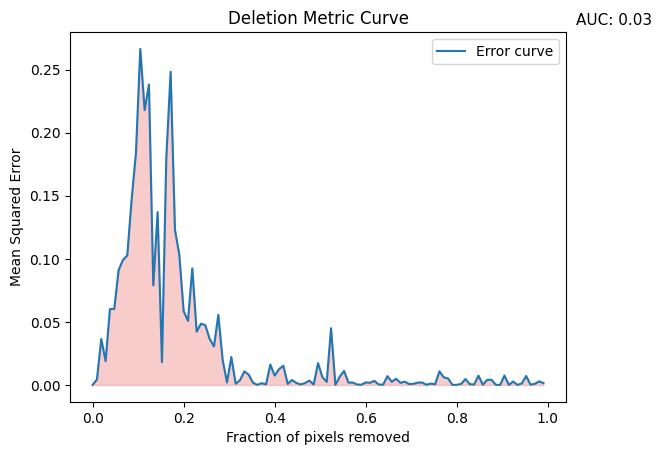

Errors: [0.0, 0.0043088095, 0.036466856, 0.018907346, 0.06007294, 0.06027802, 0.09101023, 0.09911495, 0.102682136, 0.14688742, 0.18395178, 0.26646522, 0.21794957, 0.23825961, 0.07903016, 0.13709927, 0.018006355, 0.17985493, 0.2483376, 0.12306924, 0.1033483, 0.058544002, 0.050773527, 0.09237611, 0.042246446, 0.048555423, 0.04739114, 0.036488805, 0.030545177, 0.055514634, 0.019722369, 0.0019675754, 0.0221338, 0.00094428216, 0.003738085, 0.010736485, 0.008165013, 0.0017125994, 5.886708e-05, 0.0013780392, 0.00045224206, 0.016145198, 0.0074202395, 0.012449156, 0.015264926, 0.00080798956, 0.0038742411, 0.0015917678, 0.00039523322, 0.0014918263, 0.0034070006, 0.00032001073, 0.017342672, 0.0062157484, 0.002427877, 0.044973757, 3.8759428e-08, 0.006478447, 0.011130171, 0.0019196669, 0.00185047, 0.00033865482, 0.00018480579, 0.0019574412, 0.0017331636, 0.0032175526, 0.00032914674, 0.00016052237, 0.006922236, 0.0025272907, 0.004853605, 0.0016881196, 0.0026132038, 0.00069143047, 0.00087236875, 0.00

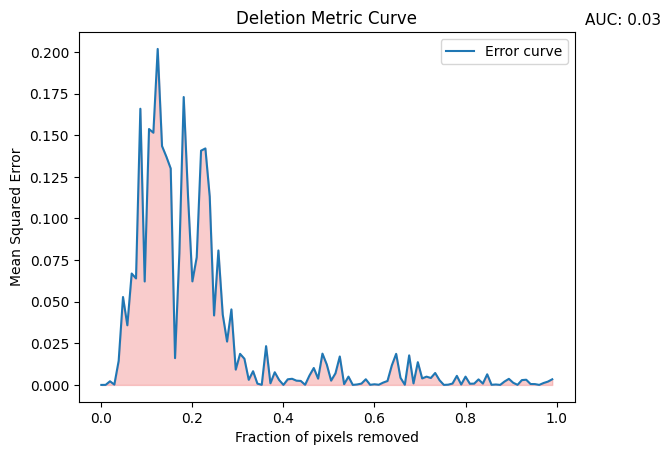

Errors: [0.0, 3.383051e-05, 0.0021981765, 0.00017828801, 0.014469464, 0.052831624, 0.035833746, 0.06694683, 0.06398929, 0.16595617, 0.062162735, 0.15377054, 0.15153608, 0.20189276, 0.1435166, 0.13714583, 0.13006, 0.016097473, 0.07907058, 0.1729968, 0.11311927, 0.06222392, 0.07670381, 0.14075842, 0.14209582, 0.11311414, 0.0417398, 0.08080228, 0.042294633, 0.026061896, 0.045384463, 0.009186387, 0.01867587, 0.015728077, 0.003078216, 0.00823585, 0.0007822351, 5.4368677e-05, 0.023305079, 0.0009790413, 0.007616161, 0.0029888453, 1.6638527e-06, 0.003379578, 0.0036909329, 0.0025604677, 0.00239604, 7.667348e-05, 0.005623666, 0.010176588, 0.0037798546, 0.018801816, 0.012248172, 0.002581327, 0.0069722747, 0.01710225, 0.00046553867, 0.0049931384, 1.3246534e-05, 0.00027691564, 0.0007962371, 0.0034052613, 6.687669e-05, 0.0003877257, 0.00011032916, 0.0013936559, 0.0023679503, 0.01172048, 0.018674532, 0.004284274, 0.00010029208, 0.017759152, 0.0009082856, 0.0136716785, 0.003910975, 0.0049756663, 0.004

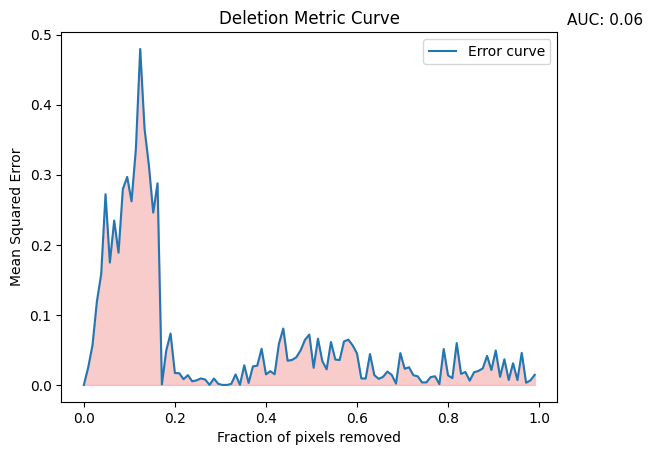

Errors: [0.0, 0.024683077, 0.0568179, 0.11857929, 0.1580651, 0.27221334, 0.17469199, 0.2345278, 0.18875892, 0.27971873, 0.29692984, 0.26203167, 0.3365949, 0.47960496, 0.36581308, 0.31350422, 0.24601585, 0.28781343, 0.00059491774, 0.04900979, 0.07341924, 0.01695332, 0.016760288, 0.0082082115, 0.01396221, 0.0051558213, 0.006565631, 0.009301953, 0.0076733204, 2.4035498e-05, 0.009197119, 0.0015445809, 1.0530774e-05, 1.7762488e-06, 0.0014192906, 0.015011493, 0.000129258, 0.02809215, 0.0028380784, 0.026470805, 0.027576152, 0.051658537, 0.015065978, 0.019650096, 0.015233556, 0.058844622, 0.08056427, 0.034531105, 0.03568404, 0.039482027, 0.0493874, 0.06429591, 0.07188146, 0.024456214, 0.0660235, 0.03405157, 0.022248466, 0.061268378, 0.036266077, 0.035577405, 0.06207384, 0.064621724, 0.05652486, 0.044992212, 0.009285462, 0.009131512, 0.04413302, 0.014005657, 0.008723638, 0.011489482, 0.019049793, 0.01448695, 0.0019199176, 0.04546058, 0.023118863, 0.025250884, 0.013866899, 0.012320511, 0.0035558

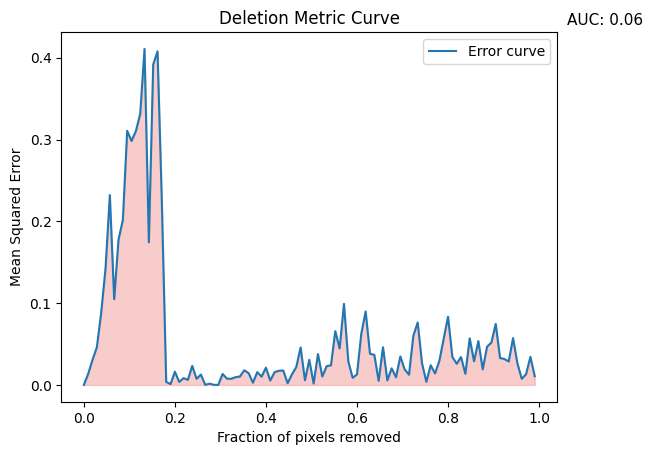

Errors: [0.0, 0.013472529, 0.030670937, 0.046003275, 0.08801434, 0.14204225, 0.23215033, 0.10482268, 0.17767248, 0.20162295, 0.31069428, 0.29823136, 0.31027767, 0.3312024, 0.41078416, 0.17435175, 0.39183757, 0.40785715, 0.22261788, 0.0036649136, 0.0010614343, 0.016119638, 0.0036751253, 0.008333341, 0.006200795, 0.0232982, 0.007454937, 0.012698976, 8.6811684e-05, 0.0015389079, 0.00011887803, 4.2395874e-07, 0.013430222, 0.0076635806, 0.0075552356, 0.009481213, 0.010287574, 0.01791754, 0.014433165, 0.002744254, 0.015570763, 0.010139078, 0.021109518, 0.005356563, 0.015651356, 0.017308809, 0.017629568, 0.0020838142, 0.012906603, 0.021899203, 0.04584861, 0.0056169275, 0.030721106, 0.0017453588, 0.037670955, 0.01026907, 0.022909265, 0.023987312, 0.06574743, 0.044567406, 0.09917465, 0.028739685, 0.008653867, 0.012920935, 0.06266677, 0.089834325, 0.0380886, 0.036725715, 0.004997199, 0.046081983, 0.0054919785, 0.020258268, 0.009344646, 0.03484322, 0.018903378, 0.012484174, 0.060209174, 0.0763171

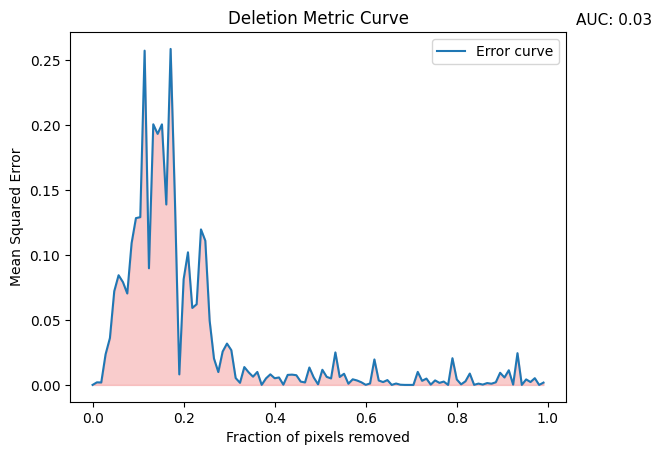

Errors: [0.0, 0.0019875662, 0.0018785285, 0.023604782, 0.036129247, 0.07224823, 0.084525496, 0.079235226, 0.07045282, 0.10926134, 0.12853135, 0.12930149, 0.25758064, 0.089890145, 0.20084278, 0.1934445, 0.20077878, 0.13903227, 0.2589152, 0.14136954, 0.0081138415, 0.081422694, 0.1021946, 0.05932273, 0.06218093, 0.11984742, 0.111128785, 0.049459085, 0.020327503, 0.00992312, 0.025718037, 0.03186061, 0.026782934, 0.0053246953, 0.00161742, 0.013766066, 0.009691429, 0.006370011, 0.010007373, 3.754743e-05, 0.0050540143, 0.008159101, 0.0051465635, 0.0057541556, 0.00018188902, 0.007730253, 0.007938354, 0.0074800313, 0.0025587247, 0.0019265413, 0.013422804, 0.0057914173, 0.00046172948, 0.01167708, 0.0062113884, 0.005012042, 0.025064055, 0.0061261957, 0.008617265, 0.00092291244, 0.0043352125, 0.0034278373, 0.0020245884, 5.882502e-05, 0.0011282774, 0.019643495, 0.0034118383, 0.0021996244, 0.0037379686, 5.4492193e-06, 0.0010809421, 0.00015794556, 1.2241967e-05, 4.9354367e-06, 1.8998692e-06, 0.010038

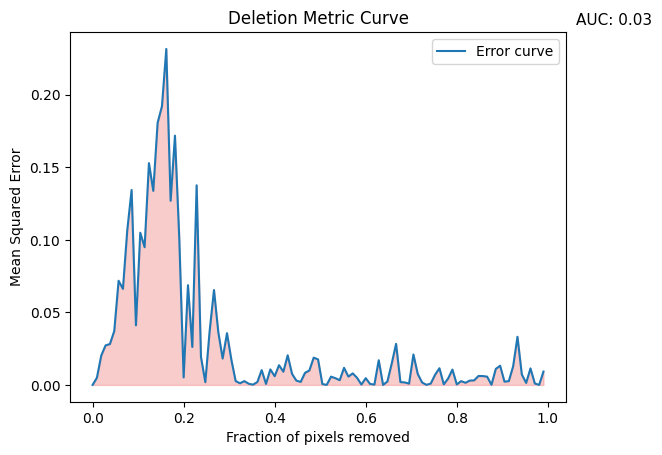

Errors: [0.0, 0.004976995, 0.020240642, 0.02724718, 0.028170647, 0.037162114, 0.071799435, 0.06621087, 0.106623776, 0.1343459, 0.041075677, 0.10487332, 0.09490393, 0.15286532, 0.13374068, 0.18064179, 0.19204287, 0.23157464, 0.1269063, 0.17180039, 0.10066527, 0.0051912335, 0.06876994, 0.026146064, 0.13758749, 0.019233493, 0.0018958251, 0.037124686, 0.06540202, 0.036322806, 0.018200722, 0.0356672, 0.017520128, 0.002630784, 0.0011443511, 0.0026256808, 0.0008302201, 0.00017365316, 0.001984883, 0.010202784, 0.00070821354, 0.010692532, 0.0060127904, 0.013596027, 0.009123562, 0.020430187, 0.0076611596, 0.0029655334, 0.0020818936, 0.008331698, 0.009951985, 0.018811902, 0.017582778, 0.0005986716, 7.3281963e-06, 0.0057169143, 0.0046420484, 0.0032682763, 0.011798613, 0.0057367343, 0.007952954, 0.0049112206, 0.0002389715, 0.004637225, 0.00067976915, 0.00020703413, 0.017039264, 5.533583e-06, 0.0023600445, 0.0147656435, 0.02830779, 0.0019630832, 0.0017108239, 0.0009030514, 0.02097842, 0.007531412, 0

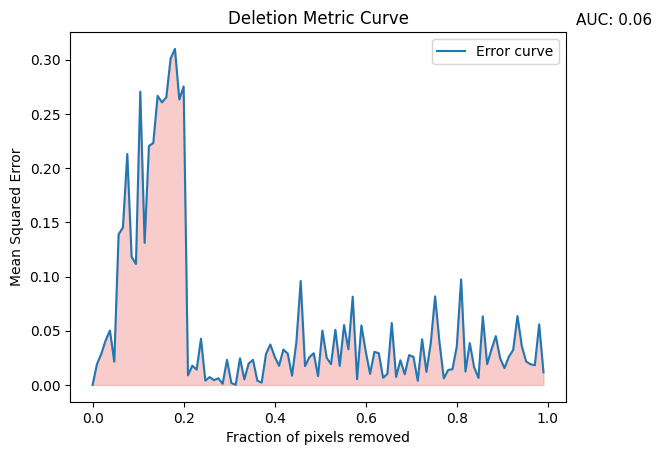

Errors: [0.0, 0.019081185, 0.028574793, 0.040955566, 0.05019858, 0.021507487, 0.1388282, 0.14536248, 0.21300337, 0.11807286, 0.11162146, 0.27055213, 0.13103247, 0.22050509, 0.22320801, 0.26674128, 0.26068282, 0.26540086, 0.30115408, 0.3100015, 0.26337415, 0.27535048, 0.008828144, 0.017771514, 0.014142101, 0.04266049, 0.0039524455, 0.0072373534, 0.0044136858, 0.006169369, 0.0010501085, 0.023188392, 0.0018438761, 6.180742e-06, 0.024607321, 0.0051570707, 0.019749733, 0.023128163, 0.0039070845, 0.002150655, 0.028660903, 0.037275586, 0.026114963, 0.017622033, 0.03261939, 0.029019412, 0.0085972035, 0.039504744, 0.09588405, 0.017339453, 0.025606627, 0.029253988, 0.008177751, 0.05011566, 0.024933476, 0.019223096, 0.05081455, 0.017633935, 0.055272587, 0.03291405, 0.08144576, 0.0053105606, 0.05486254, 0.030959658, 0.010188665, 0.03053224, 0.02930378, 0.006643609, 0.0102975145, 0.0571103, 0.007371768, 0.0227693, 0.009783277, 0.027500741, 0.025873007, 0.0037828821, 0.04212554, 0.012087994, 0.03876

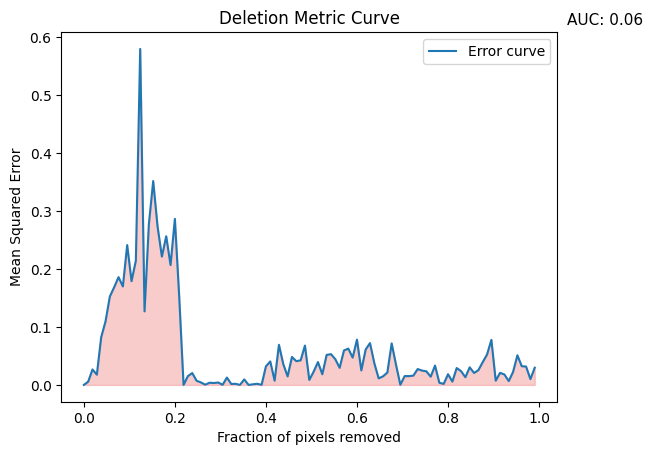

Errors: [0.0, 0.0056031593, 0.026695156, 0.017755847, 0.08229054, 0.10966991, 0.15276182, 0.1687579, 0.18614191, 0.1700659, 0.24143998, 0.17919613, 0.21463893, 0.580161, 0.12698223, 0.277712, 0.3520408, 0.27374437, 0.22153747, 0.25674015, 0.20703042, 0.28675097, 0.15201436, 3.4231766e-07, 0.0151430275, 0.02056194, 0.007247925, 0.0043087625, 0.0003681125, 0.003806094, 0.0033062573, 0.0041820505, 0.00016996404, 0.012735515, 0.0016583746, 0.001913055, 5.1328043e-05, 0.009520568, 1.9034858e-06, 0.0010629185, 0.0019660369, 0.00017826892, 0.032133598, 0.04055482, 0.0073291897, 0.0693057, 0.036003802, 0.014708307, 0.048274316, 0.041056324, 0.04240407, 0.067965135, 0.008636244, 0.022856195, 0.039465256, 0.0184174, 0.05180088, 0.0531536, 0.04445013, 0.029524831, 0.05951975, 0.06270446, 0.047157113, 0.07820107, 0.025027983, 0.06119472, 0.072199754, 0.03752307, 0.011337166, 0.014814645, 0.021342576, 0.071755745, 0.034953788, 0.00028568262, 0.015283416, 0.015187699, 0.016065637, 0.027420083, 0.024

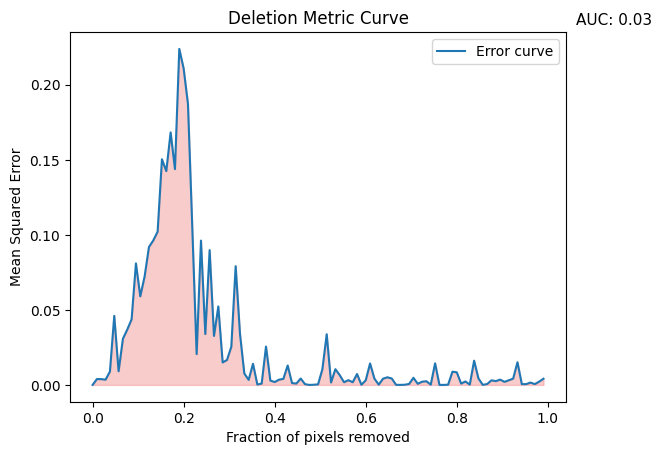

Errors: [0.0, 0.003922248, 0.0038609558, 0.0035257926, 0.008877405, 0.046009563, 0.009098756, 0.030804656, 0.03688157, 0.04371187, 0.08096949, 0.059013855, 0.07226653, 0.09186505, 0.09629219, 0.1021047, 0.15037222, 0.14245589, 0.16826016, 0.14377697, 0.22387387, 0.21086986, 0.1872405, 0.104666546, 0.020524692, 0.096161686, 0.03389868, 0.08980853, 0.032661863, 0.05228877, 0.014999359, 0.016623354, 0.025457138, 0.07911169, 0.033964865, 0.00758519, 0.0033749226, 0.014098089, 0.00026935438, 0.0009132143, 0.025549889, 0.0029066498, 0.0019266774, 0.0034917148, 0.004029592, 0.012949854, 0.001214668, 0.00093915337, 0.0042664628, 0.0004980934, 2.456629e-06, 0.00013232132, 0.00033968667, 0.010411917, 0.0337832, 0.0016240381, 0.010478877, 0.006524508, 0.0017908624, 0.0031705003, 0.0017883762, 0.0072636334, 0.00010901708, 0.003079089, 0.014305001, 0.004237616, 0.00018534421, 0.0041736593, 0.005087171, 0.0042884415, 6.7578476e-05, 1.9622224e-05, 0.00012569672, 0.00063423865, 0.004742364, 0.00076574

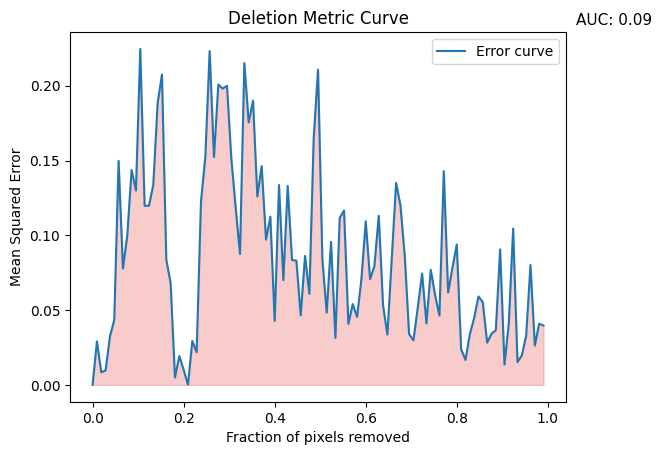

Errors: [0.0, 0.029090825, 0.008451126, 0.009710115, 0.032398403, 0.043502044, 0.14981845, 0.07782162, 0.09995831, 0.14366496, 0.12999745, 0.22460803, 0.11968652, 0.119856246, 0.13380037, 0.18826805, 0.20752315, 0.08382913, 0.06804419, 0.0049891253, 0.019296095, 0.010116943, 0.00017180287, 0.029373867, 0.02188144, 0.122506276, 0.15234002, 0.2231945, 0.15238939, 0.20083274, 0.19809943, 0.1999816, 0.1513036, 0.118612625, 0.08755825, 0.215171, 0.17557606, 0.18999527, 0.12600207, 0.14626005, 0.09715818, 0.11251858, 0.04278221, 0.13365822, 0.06998051, 0.13306329, 0.083540656, 0.08312186, 0.046537947, 0.086234964, 0.060894504, 0.16515866, 0.21077813, 0.08381322, 0.048362203, 0.09565407, 0.03141472, 0.11178502, 0.11660119, 0.040841173, 0.054058723, 0.04547853, 0.07063234, 0.1093825, 0.070712455, 0.07939339, 0.11304495, 0.05299039, 0.03367415, 0.08439388, 0.13502152, 0.12022177, 0.08637329, 0.034023087, 0.02978219, 0.051663768, 0.07443846, 0.041172616, 0.07692776, 0.059987158, 0.046407707, 0.1

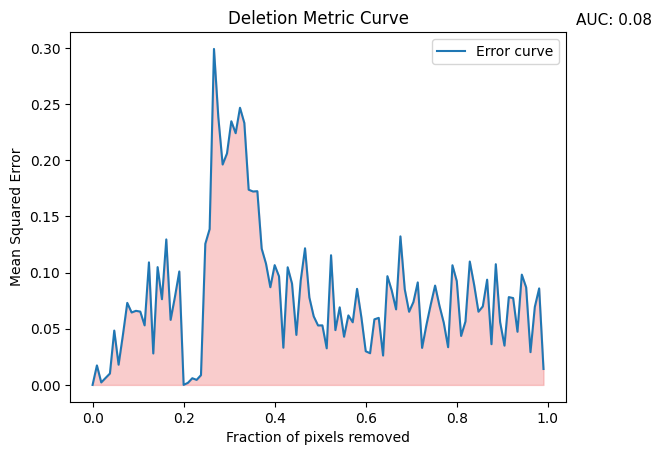

Errors: [0.0, 0.017363966, 0.0022164825, 0.0062139626, 0.010153895, 0.048364405, 0.01800653, 0.044599924, 0.07302372, 0.06447813, 0.06594416, 0.065258786, 0.05300338, 0.10908721, 0.027995797, 0.10485389, 0.076292664, 0.12950654, 0.057900604, 0.07849805, 0.10098543, 2.9665267e-05, 0.0018849433, 0.005958376, 0.004489691, 0.008712736, 0.1255988, 0.13869084, 0.2990516, 0.23825848, 0.19617604, 0.2060403, 0.2346751, 0.22404565, 0.2466856, 0.23314345, 0.17375371, 0.17215537, 0.172439, 0.121319436, 0.10788005, 0.086946115, 0.10661498, 0.09665427, 0.033120412, 0.10470511, 0.09016366, 0.044513617, 0.092782356, 0.12161537, 0.077805504, 0.061046362, 0.052945644, 0.053012237, 0.032586027, 0.11543536, 0.048791543, 0.06905246, 0.042877663, 0.06186854, 0.055752225, 0.085520945, 0.06007075, 0.029972378, 0.028211059, 0.058373746, 0.05968622, 0.026150921, 0.0968071, 0.084037796, 0.06725145, 0.13222599, 0.08514298, 0.065111265, 0.07377712, 0.09123834, 0.03296182, 0.053383917, 0.07161272, 0.08842893, 0.070

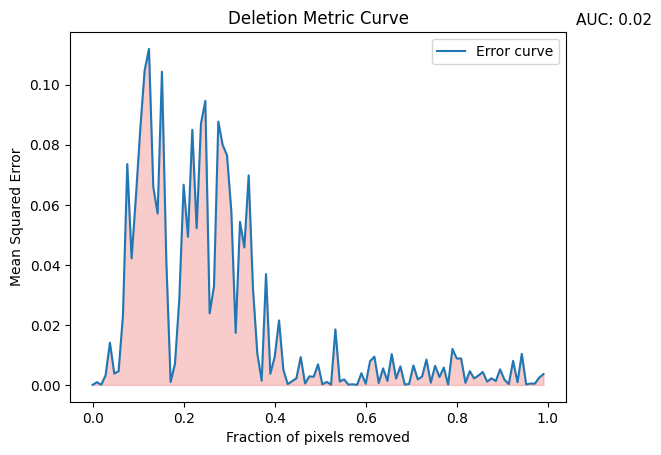

Errors: [0.0, 0.0009037465, 5.4646793e-05, 0.0032540758, 0.014061, 0.0037996983, 0.004562721, 0.02307091, 0.073570006, 0.042140443, 0.06284975, 0.085250266, 0.10469343, 0.11192643, 0.06591965, 0.057091925, 0.1043198, 0.04157435, 0.0009938943, 0.0070440276, 0.028604481, 0.066694275, 0.049331833, 0.08498591, 0.05219914, 0.087059386, 0.09462162, 0.023867896, 0.03284985, 0.08772291, 0.07994312, 0.07650684, 0.05786811, 0.017331291, 0.054307465, 0.045795996, 0.06980559, 0.03196479, 0.010359593, 0.0013974189, 0.036928356, 0.003737626, 0.009347931, 0.021496946, 0.005093346, 0.0002791857, 0.0012173243, 0.0021926078, 0.009280351, 0.00046410196, 0.0028612483, 0.0027242696, 0.0068594287, 0.00018682239, 0.0010280479, 9.4924406e-05, 0.018497875, 0.0011302122, 0.0018548365, 0.00011564572, 0.00022098185, 2.303849e-05, 0.0039009545, 0.00039432134, 0.007932332, 0.009403902, 0.0006639766, 0.005511529, 0.0013026614, 0.010280416, 0.0021249757, 0.0061859065, 0.00012418568, 0.00030984601, 0.0064876806, 0.001

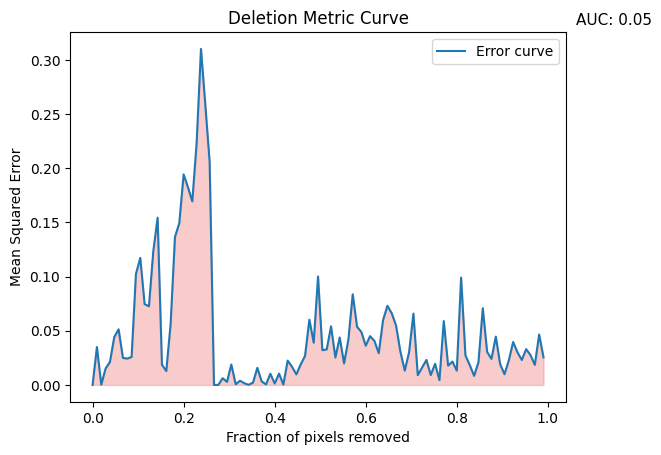

Errors: [0.0, 0.034963954, 0.0002256151, 0.015117542, 0.021191556, 0.044199757, 0.051348098, 0.024944525, 0.02430825, 0.025825934, 0.10241747, 0.11726953, 0.07459843, 0.07259158, 0.12331706, 0.15439527, 0.018630264, 0.012817319, 0.056243945, 0.13653377, 0.14938216, 0.19433384, 0.18243034, 0.1694271, 0.22345814, 0.3101444, 0.2586834, 0.20575182, 1.8685801e-05, 2.0099287e-05, 0.0062262695, 0.0028079674, 0.018823888, 0.00062280433, 0.0038898536, 0.0015154659, 0.000117649055, 0.0021095455, 0.01578127, 0.0032089166, 0.00047898878, 0.010295833, 0.001326485, 0.010441119, 0.00036861814, 0.02245122, 0.016715977, 0.009754764, 0.018938765, 0.02678309, 0.060186155, 0.039037023, 0.10004609, 0.032043204, 0.032786746, 0.054065738, 0.025300445, 0.043793708, 0.01984131, 0.04177522, 0.08365647, 0.053668983, 0.048784014, 0.036205124, 0.045019325, 0.040655088, 0.029308677, 0.05987559, 0.07302741, 0.06614028, 0.054758552, 0.030541532, 0.013198023, 0.03022575, 0.065829255, 0.009001273, 0.01611298, 0.0230325

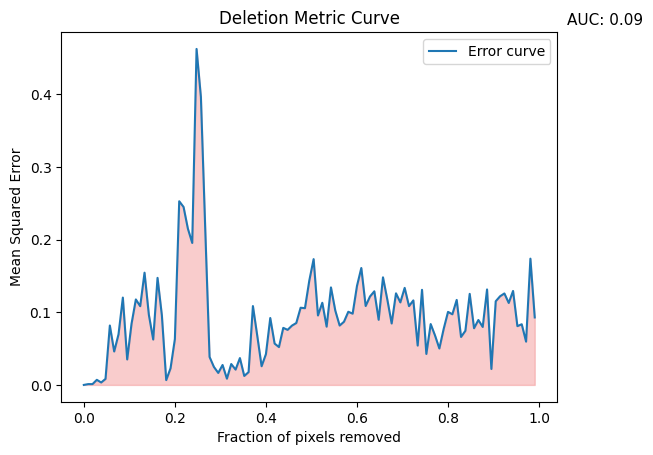

Errors: [0.0, 0.0011142504, 0.0011142822, 0.007019317, 0.00336101, 0.008270886, 0.081804596, 0.04603611, 0.06966337, 0.120272495, 0.035096396, 0.08411547, 0.11770056, 0.10842937, 0.15454455, 0.096501715, 0.062520295, 0.14742163, 0.09576906, 0.0066563343, 0.02293188, 0.0631497, 0.2529033, 0.24505988, 0.21515971, 0.19551465, 0.46264687, 0.39659625, 0.21508436, 0.03852317, 0.024819722, 0.016532963, 0.02746013, 0.008623442, 0.028768046, 0.021106955, 0.036980055, 0.012382195, 0.01763335, 0.10857455, 0.06773914, 0.02575139, 0.042457577, 0.09212364, 0.05696217, 0.052123003, 0.07856924, 0.075826734, 0.08165458, 0.08525342, 0.106275946, 0.105677925, 0.1435751, 0.1732005, 0.095635705, 0.11310852, 0.080250844, 0.13424774, 0.10231899, 0.08179165, 0.086977154, 0.10074267, 0.09811388, 0.1363134, 0.16101548, 0.10867068, 0.12173576, 0.12891145, 0.089717664, 0.14812735, 0.117504254, 0.08463591, 0.12611149, 0.11364391, 0.13362883, 0.108516105, 0.11638628, 0.054196842, 0.13095175, 0.042662557, 0.08380542

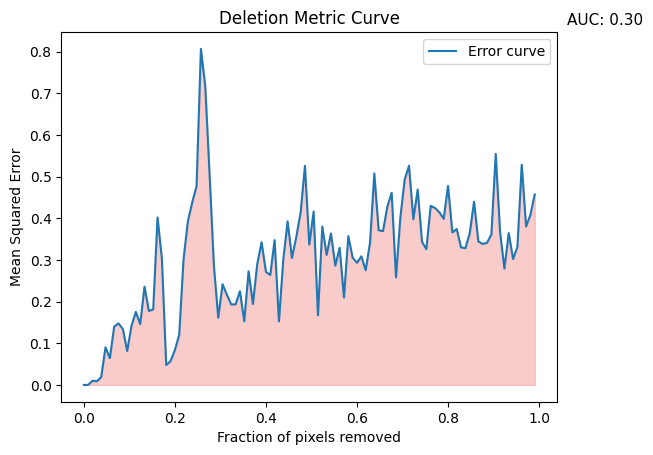

Errors: [0.0, 3.4234556e-05, 0.010179161, 0.008770542, 0.018778758, 0.09022126, 0.064328134, 0.13992617, 0.1476884, 0.13425595, 0.081487544, 0.14236511, 0.17538536, 0.14593099, 0.2359184, 0.17746863, 0.18116991, 0.40190938, 0.30353084, 0.04767638, 0.057142295, 0.08360076, 0.120435394, 0.3020121, 0.39247566, 0.43819642, 0.477141, 0.8063269, 0.7175522, 0.50643224, 0.2858676, 0.16139403, 0.24162383, 0.21646279, 0.193043, 0.19346412, 0.22481342, 0.15271607, 0.27277252, 0.19414552, 0.29050267, 0.3423893, 0.27138686, 0.26396334, 0.34736755, 0.15246172, 0.30055875, 0.39247352, 0.30475, 0.35515884, 0.41368774, 0.52578807, 0.3366712, 0.41606495, 0.16690221, 0.3801507, 0.31187764, 0.36346337, 0.28615832, 0.32909182, 0.20970324, 0.35700244, 0.30544603, 0.29299426, 0.30863783, 0.27529714, 0.34037533, 0.50749665, 0.3713164, 0.36905056, 0.42744696, 0.46105212, 0.2580989, 0.4014621, 0.4930166, 0.5260182, 0.3975816, 0.46880054, 0.34359983, 0.32565024, 0.42966306, 0.42456788, 0.4142293, 0.39860564, 0.4

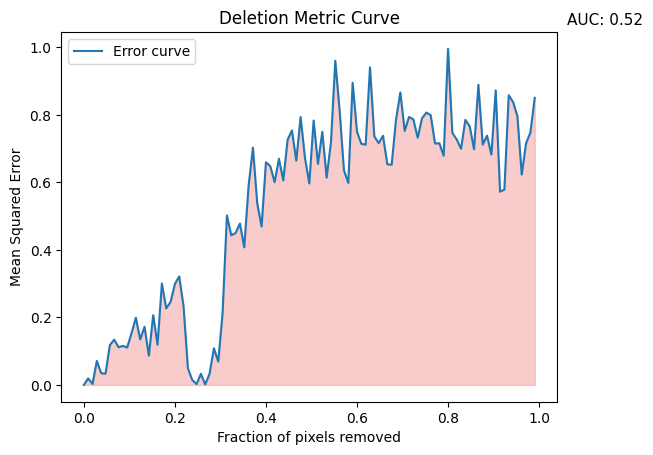

Errors: [0.0, 0.019249203, 0.002970833, 0.07111593, 0.03472694, 0.033246927, 0.11786274, 0.13408294, 0.11171252, 0.11549564, 0.11088213, 0.15338606, 0.19896862, 0.13484365, 0.17239608, 0.08686694, 0.20651191, 0.11913592, 0.30042157, 0.22669445, 0.24559619, 0.29897174, 0.32134995, 0.2327043, 0.049618706, 0.014628985, 0.002638659, 0.03282092, 0.001380213, 0.033327095, 0.10845524, 0.06903902, 0.21217346, 0.50201, 0.44305518, 0.44988993, 0.47795704, 0.4075542, 0.5893227, 0.70278007, 0.53703064, 0.46911648, 0.65947825, 0.64805776, 0.6003779, 0.66981304, 0.60575336, 0.7261737, 0.7534336, 0.6642987, 0.7934848, 0.6724215, 0.59680504, 0.7831431, 0.6548234, 0.7496329, 0.6139227, 0.7189567, 0.96012354, 0.81207496, 0.6350131, 0.5983659, 0.8948986, 0.7501309, 0.71416193, 0.71182674, 0.9405924, 0.7358187, 0.71620816, 0.7378517, 0.6534138, 0.65231824, 0.78546137, 0.86604595, 0.75233537, 0.79355806, 0.7865764, 0.732243, 0.78977257, 0.80663526, 0.7990611, 0.71507466, 0.71565914, 0.6787325, 0.9951124, 0

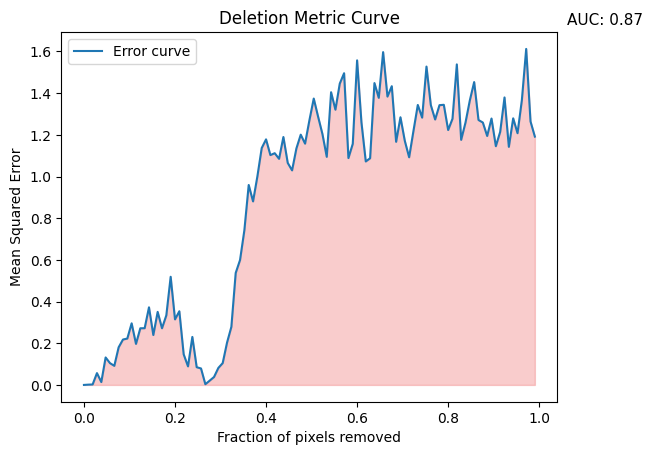

Errors: [0.0, 0.0013173916, 0.0021738813, 0.056640837, 0.013681716, 0.13181101, 0.10453839, 0.09162334, 0.18044779, 0.21780784, 0.22249568, 0.29557997, 0.19686933, 0.27180248, 0.27218372, 0.3724628, 0.23935057, 0.35048166, 0.2718752, 0.33398858, 0.51888216, 0.31450823, 0.3535168, 0.14684209, 0.088998765, 0.2302801, 0.085045986, 0.07894647, 0.0034023263, 0.020572506, 0.03803539, 0.08158095, 0.10472872, 0.20289613, 0.27862403, 0.53733695, 0.5992748, 0.7423647, 0.9594456, 0.88053066, 1.0005563, 1.1366035, 1.1782811, 1.1027647, 1.1118917, 1.0848652, 1.1896191, 1.0653654, 1.0294887, 1.1347404, 1.2007552, 1.1576912, 1.269824, 1.374076, 1.2874358, 1.204306, 1.0944829, 1.4043701, 1.3205923, 1.4456596, 1.4956653, 1.0884235, 1.1568595, 1.557371, 1.2600781, 1.0722648, 1.0876503, 1.448433, 1.377449, 1.5968374, 1.3835354, 1.4333707, 1.1665816, 1.2843093, 1.1713547, 1.0922706, 1.2189928, 1.3433034, 1.2824664, 1.5274905, 1.3429006, 1.2736086, 1.3423321, 1.3440679, 1.2230948, 1.2769393, 1.5379592, 1.1

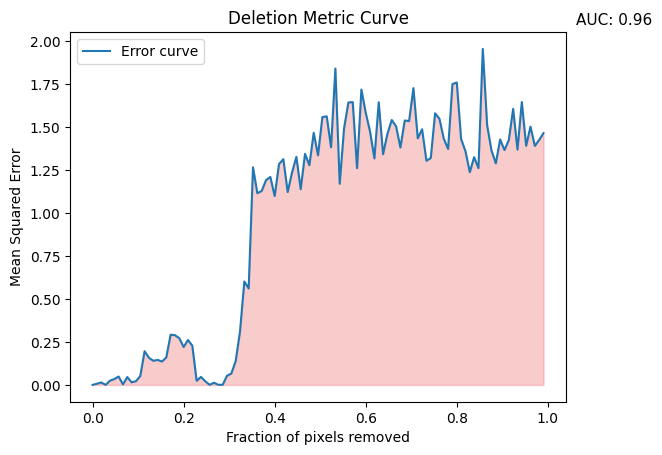

Errors: [0.0, 0.006910617, 0.014534065, 8.905856e-05, 0.024623498, 0.03408068, 0.048938613, 0.0033713984, 0.045809515, 0.015109922, 0.021860056, 0.051879432, 0.1962383, 0.15786302, 0.14049307, 0.14552934, 0.13634208, 0.16001372, 0.29226673, 0.28963438, 0.2717975, 0.22084154, 0.261356, 0.22898245, 0.024138058, 0.046493288, 0.021216882, 0.0004449, 0.012854852, 0.00083135057, 0.0005363074, 0.052975163, 0.066169195, 0.13819948, 0.3100828, 0.6019903, 0.5613726, 1.266948, 1.1159587, 1.1289848, 1.1920967, 1.2104465, 1.0991164, 1.2854563, 1.3140268, 1.122573, 1.2357339, 1.3275973, 1.1393368, 1.3451008, 1.2789559, 1.4672396, 1.3365105, 1.5588603, 1.5634881, 1.3831271, 1.8414571, 1.1708915, 1.4936374, 1.6439754, 1.6462395, 1.2615802, 1.7194269, 1.5839407, 1.4738431, 1.3182881, 1.6451555, 1.3430967, 1.4610775, 1.5421281, 1.5048597, 1.3815327, 1.5391377, 1.5351679, 1.7276441, 1.4353379, 1.4879097, 1.3047581, 1.3206931, 1.5810027, 1.5489551, 1.4329946, 1.373201, 1.7511818, 1.7602286, 1.4313608, 1.3

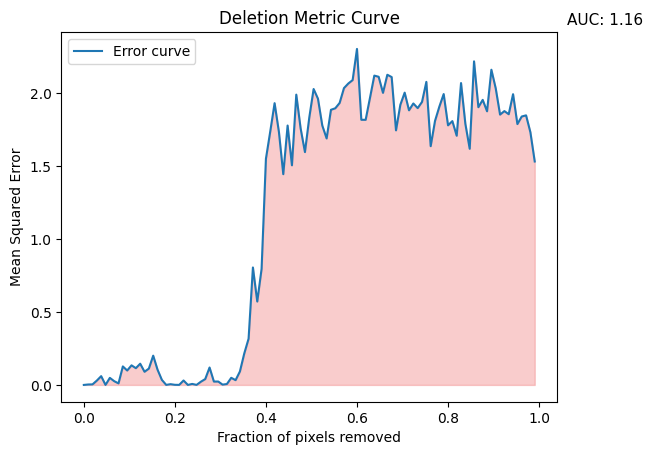

Errors: [0.0, 0.0029080382, 0.0036817046, 0.02975317, 0.060057543, 0.00011041432, 0.048309524, 0.025746569, 0.010485139, 0.12677552, 0.098747365, 0.13415167, 0.11480156, 0.14531876, 0.09010357, 0.111969106, 0.20041364, 0.10450339, 0.034512278, 0.00024698756, 0.0050891694, 0.0007674588, 0.00032503533, 0.030373078, 2.6812713e-06, 0.0067889094, 0.00020091535, 0.02200652, 0.040136606, 0.11928278, 0.023088332, 0.023202226, 0.0019948431, 0.0061982796, 0.04879283, 0.032723293, 0.09211033, 0.21504495, 0.31652227, 0.80443615, 0.57126737, 0.79497564, 1.5489162, 1.7362878, 1.929746, 1.7318645, 1.4433775, 1.7766143, 1.5042409, 1.9882472, 1.7572569, 1.5947556, 1.8313502, 2.026741, 1.9605705, 1.7766193, 1.6881398, 1.8844227, 1.8948632, 1.9313345, 2.0330055, 2.0644097, 2.0879126, 2.301319, 1.8159717, 1.8157542, 1.9662193, 2.1185172, 2.1105266, 2.0004804, 2.1244278, 2.1085627, 1.7436234, 1.9184542, 2.0018756, 1.8809553, 1.9277753, 1.8959188, 1.9381903, 2.0756404, 1.6353377, 1.8083338, 1.9061215, 1.992

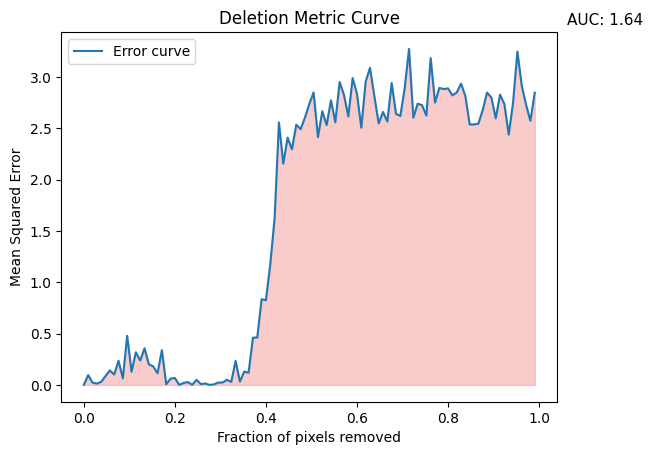

Errors: [0.0, 0.09576353, 0.022591818, 0.013133202, 0.03022666, 0.08668061, 0.14139925, 0.10160393, 0.23576799, 0.06459097, 0.4786026, 0.1285178, 0.31842408, 0.23872718, 0.35681862, 0.20008023, 0.18152161, 0.113400586, 0.33913043, 0.006920729, 0.061540026, 0.067087576, 0.0003026033, 0.01928938, 0.028090531, 0.0012039684, 0.049713712, 0.0078669805, 0.014262458, 0.00030858826, 0.0048345216, 0.023148945, 0.023645937, 0.050417244, 0.029301535, 0.23419274, 0.03324697, 0.12991443, 0.11923717, 0.46015805, 0.46253142, 0.8357755, 0.8257092, 1.1765751, 1.6244262, 2.5581515, 2.1575017, 2.4102492, 2.2961302, 2.537125, 2.4929376, 2.605273, 2.7385988, 2.8504694, 2.4147756, 2.667166, 2.5326684, 2.7740045, 2.5596902, 2.9526064, 2.8266723, 2.6171515, 2.9903045, 2.8375869, 2.507168, 2.9558058, 3.090152, 2.8161664, 2.5491219, 2.660576, 2.567148, 2.9421623, 2.6425958, 2.6206138, 2.8912969, 3.2746768, 2.604687, 2.7408419, 2.7268121, 2.624906, 3.185353, 2.7517073, 2.894804, 2.883576, 2.890059, 2.8223994, 2.

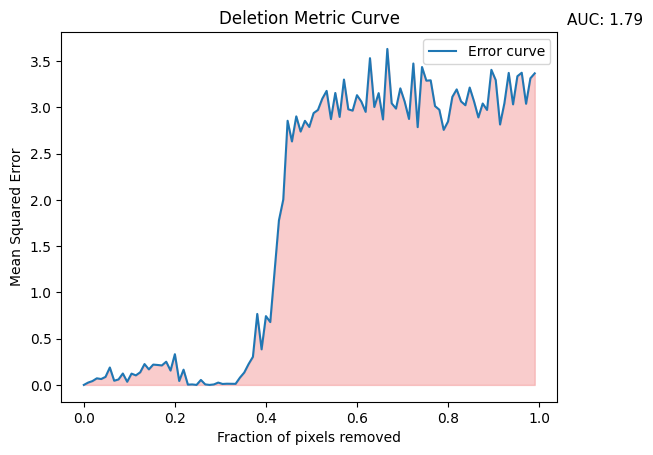

Errors: [0.0, 0.025450328, 0.04199223, 0.071373545, 0.06384962, 0.08700015, 0.18856923, 0.045453973, 0.05929248, 0.123464294, 0.03428243, 0.12226356, 0.103411965, 0.13640758, 0.22556444, 0.16786554, 0.21987545, 0.21582311, 0.21062945, 0.2510628, 0.15523566, 0.33236152, 0.042463347, 0.16483805, 0.0031421974, 0.005335992, 3.869264e-05, 0.05400386, 0.005702772, 8.444009e-05, 0.0053606466, 0.025385635, 0.010382124, 0.012976185, 0.012208217, 0.01168771, 0.07872088, 0.13405108, 0.22530702, 0.30382028, 0.7675879, 0.3846435, 0.74399626, 0.679515, 1.2301649, 1.7791152, 2.0045683, 2.8564935, 2.6327803, 2.9041605, 2.7398891, 2.8558605, 2.7895868, 2.9395478, 2.9735408, 3.0952702, 3.1795201, 2.8745255, 3.157349, 2.898268, 3.3020627, 2.9804401, 2.9661303, 3.1331396, 3.0642605, 2.9527707, 3.5333445, 3.0051897, 3.1553771, 2.8707776, 3.6333618, 3.0455081, 2.9881537, 3.2070653, 3.0632904, 2.8761597, 3.475736, 2.7874858, 3.4378808, 3.2901125, 3.2938998, 3.0152493, 2.9755454, 2.7582357, 2.848507, 3.115024

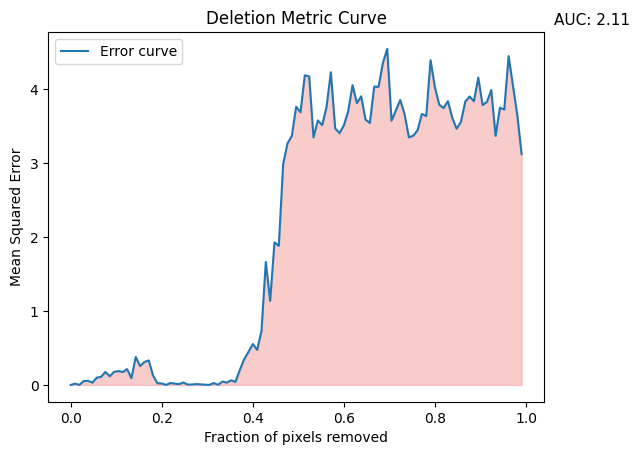

Errors: [0.0, 0.017413545, 0.00063201, 0.05204356, 0.05591907, 0.030764163, 0.097733155, 0.10977724, 0.17564166, 0.117197976, 0.17636663, 0.18774022, 0.17475906, 0.2143898, 0.09107634, 0.3791003, 0.2553915, 0.31127763, 0.33173394, 0.12645535, 0.023172094, 0.020116078, 9.08185e-06, 0.026312854, 0.017344398, 0.010755652, 0.033025198, 0.0047488348, 0.0056780605, 0.011324463, 0.0077506416, 0.0029865257, 0.0001625359, 0.025086274, 0.0019769724, 0.045468006, 0.03216322, 0.06203286, 0.041191317, 0.20180713, 0.34641984, 0.4473462, 0.5540022, 0.47524568, 0.729025, 1.6641799, 1.138053, 1.9294218, 1.8835244, 2.9885695, 3.269182, 3.370558, 3.7656043, 3.6913993, 4.1923594, 4.1768355, 3.3510134, 3.5805373, 3.5173757, 3.7595034, 4.2331176, 3.472518, 3.4090562, 3.5134747, 3.7033167, 4.058088, 3.8152523, 3.906978, 3.5912833, 3.5463562, 4.0382676, 4.0350113, 4.35742, 4.548356, 3.5766687, 3.7156847, 3.8573942, 3.6672373, 3.3513017, 3.3733616, 3.4480102, 3.6677208, 3.6404166, 4.3958416, 4.02789, 3.7945542

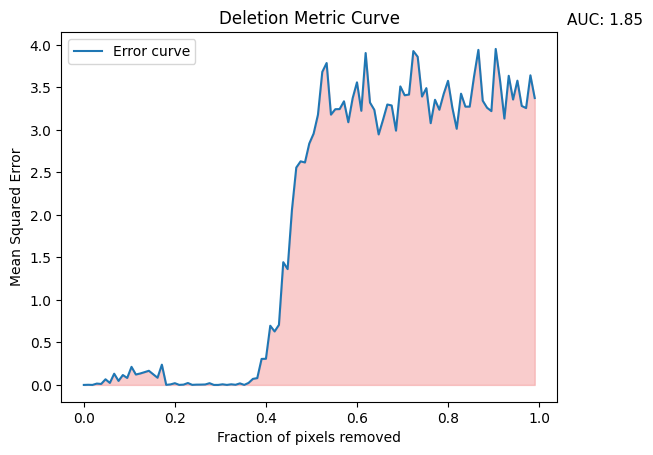

Errors: [0.0, 0.0016666716, 0.00012395863, 0.015806483, 0.011315332, 0.06634441, 0.023533005, 0.13194348, 0.047070794, 0.116434604, 0.081669636, 0.21265905, 0.1224966, 0.13451396, 0.15007795, 0.16646789, 0.12538089, 0.08454029, 0.23829426, 0.00086642854, 0.006115629, 0.020353684, 0.00047673986, 0.0034554754, 0.022338387, 0.00081932306, 0.0033245776, 0.0036826306, 0.005291674, 0.02042504, 8.0239035e-05, 9.228218e-05, 0.007212609, 0.00024630607, 0.007195732, 0.0016570301, 0.018192247, 4.1891304e-05, 0.02380988, 0.07115142, 0.0801199, 0.30591446, 0.30784857, 0.6964839, 0.629257, 0.7065539, 1.4440092, 1.3626499, 2.0596194, 2.5571754, 2.6304355, 2.6172278, 2.8400054, 2.956856, 3.1788926, 3.6830492, 3.7871275, 3.1798835, 3.2436934, 3.2453969, 3.3367944, 3.0904396, 3.3724399, 3.560076, 3.225151, 3.9048774, 3.3221424, 3.2363398, 2.9470568, 3.1180723, 3.2992165, 3.2879856, 2.991566, 3.5122454, 3.4078698, 3.4163618, 3.9278278, 3.8608537, 3.3927634, 3.4917924, 3.0794985, 3.3546805, 3.2374854, 3.4

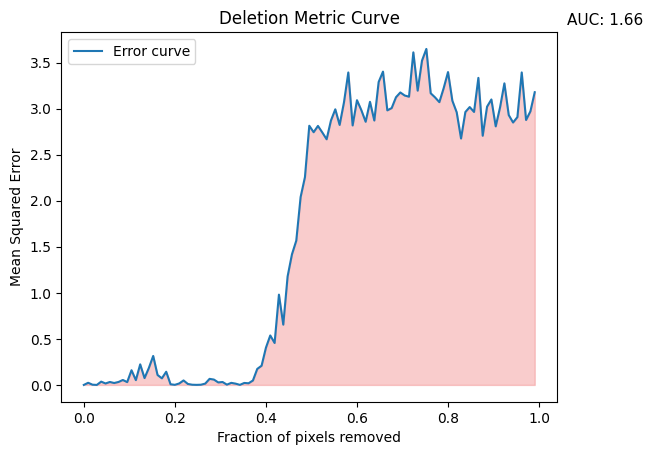

Errors: [0.0, 0.023302278, 0.0025213074, 4.018515e-06, 0.035756655, 0.015804805, 0.03194382, 0.020804806, 0.03205838, 0.053775165, 0.030542593, 0.15954055, 0.05223138, 0.22342828, 0.0744288, 0.18451273, 0.3144855, 0.10813027, 0.07171727, 0.14302157, 0.007049491, 0.0010158721, 0.015873339, 0.048656844, 0.010340382, 0.002139447, 0.00064035674, 0.0020894557, 0.014321174, 0.06581378, 0.0581481, 0.027192503, 0.031634185, 0.0030482356, 0.022470927, 0.014006842, 0.0006125032, 0.021335958, 0.017965922, 0.048052985, 0.17386499, 0.20869672, 0.40409538, 0.53703743, 0.45540804, 0.98027706, 0.6546565, 1.1783353, 1.4175279, 1.5668138, 2.0398564, 2.256582, 2.8142447, 2.7440965, 2.8124576, 2.7416763, 2.6674156, 2.8716166, 2.992669, 2.823026, 3.068142, 3.392756, 2.8175826, 3.0915968, 2.984581, 2.8575203, 3.0740585, 2.8708825, 3.2892995, 3.4019861, 2.9815178, 3.0060487, 3.124002, 3.175654, 3.1426828, 3.1297188, 3.6110604, 3.1953635, 3.521735, 3.6484077, 3.1671574, 3.122455, 3.0704765, 3.2231197, 3.39720

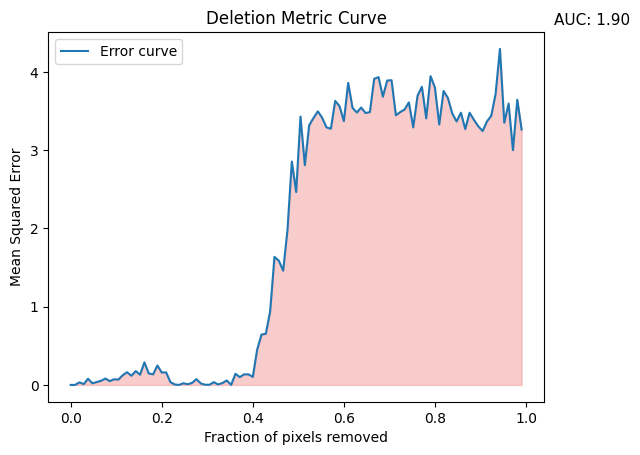

Errors: [0.0, 0.00010177189, 0.03293436, 0.010531086, 0.078955986, 0.020945419, 0.036815826, 0.05282228, 0.081789054, 0.04911504, 0.072189376, 0.06856973, 0.12458521, 0.16284445, 0.117464535, 0.17672466, 0.1307114, 0.28886667, 0.1460568, 0.13552862, 0.2483657, 0.15800628, 0.16090219, 0.036050573, 0.0053119506, 0.00029387465, 0.02126998, 0.008708425, 0.026327088, 0.07404501, 0.019381013, 0.0024860196, 0.0017241974, 0.035530515, 0.0058164014, 0.024386503, 0.057051085, 0.0009066481, 0.14276274, 0.099938124, 0.13537665, 0.13487446, 0.10283988, 0.44963074, 0.6429437, 0.6543321, 0.93961513, 1.6361034, 1.5876231, 1.4602637, 1.9812114, 2.8542733, 2.464936, 3.428898, 2.8080742, 3.3168867, 3.4118621, 3.495629, 3.413001, 3.2910535, 3.2732906, 3.628984, 3.5620553, 3.370345, 3.85957, 3.5404608, 3.4806035, 3.5447934, 3.4743834, 3.4864542, 3.9120286, 3.9325786, 3.6831212, 3.8899853, 3.8933637, 3.4460058, 3.4861662, 3.5192323, 3.6097126, 3.2911267, 3.695883, 3.8092923, 3.406873, 3.9454768, 3.7999566, 

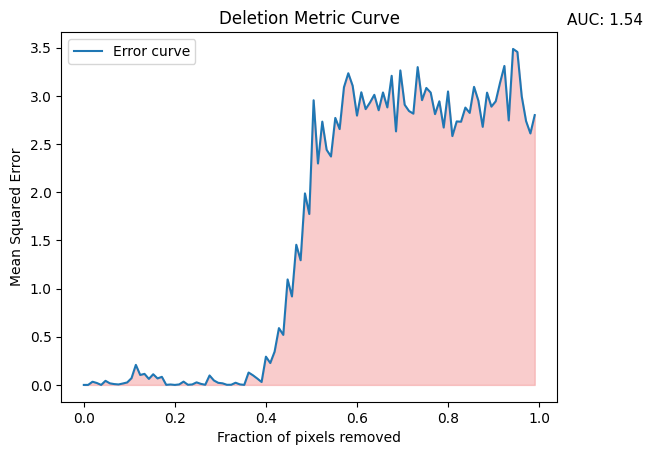

Errors: [0.0, 0.0002907197, 0.03319144, 0.019938873, 5.9271126e-05, 0.04253904, 0.016592735, 0.008711762, 0.0048168004, 0.014782075, 0.025744962, 0.070203826, 0.20803568, 0.10331094, 0.114591464, 0.06251073, 0.11075499, 0.067421585, 0.08398234, 0.00084777817, 0.0045054248, 7.1262075e-05, 0.0051322235, 0.034219068, 0.0016246771, 0.0047077183, 0.026544634, 0.010983687, 0.0014751226, 0.098073035, 0.046366036, 0.02169968, 0.016548233, 0.0012803586, 0.0016824184, 0.022759913, 0.005440859, 0.00048497936, 0.12852927, 0.10027109, 0.06640854, 0.030297667, 0.29324147, 0.22712773, 0.34500483, 0.58951074, 0.519113, 1.0945014, 0.9182802, 1.4545225, 1.2939448, 1.9872397, 1.773507, 2.95369, 2.2978358, 2.7318761, 2.4396932, 2.370294, 2.770473, 2.654568, 3.0890858, 3.233916, 3.1043305, 2.7949007, 3.0365694, 2.8617673, 2.9300482, 3.010175, 2.8501852, 3.0346353, 2.8796036, 3.2075064, 2.630777, 3.2631707, 2.9067795, 2.8419943, 2.8147497, 3.2976239, 2.9549477, 3.081372, 3.0334647, 2.809844, 2.9429824, 2.67

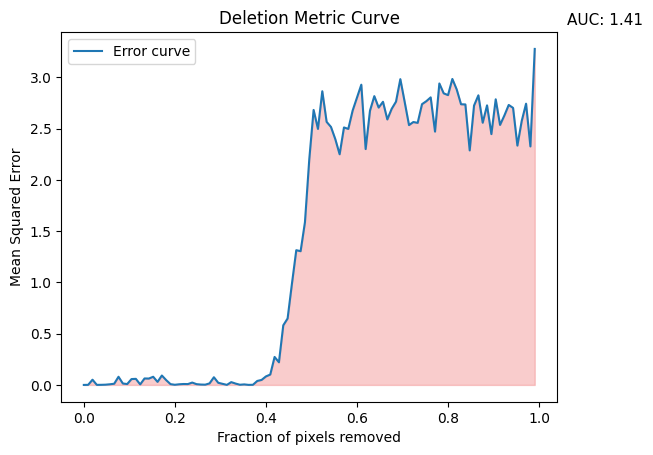

Errors: [0.0, 0.0008435627, 0.05092129, 0.00045297245, 0.00095528166, 0.002348534, 0.006162218, 0.011512173, 0.079586715, 0.013851349, 0.008498781, 0.057194684, 0.059249528, 0.0051241647, 0.062977746, 0.062215056, 0.07965345, 0.02960596, 0.09190263, 0.04664584, 0.0075134938, 0.0014897366, 0.0062690196, 0.00888346, 0.008240579, 0.02295817, 0.007409697, 0.0036271666, 0.002416917, 0.0151304435, 0.0751068, 0.020828472, 0.010608985, 0.00042189157, 0.027387463, 0.013144789, 0.001680033, 0.0050657587, 0.0003988747, 0.0013073898, 0.038756613, 0.04871755, 0.082861274, 0.10120337, 0.27298412, 0.2207927, 0.5815158, 0.6483134, 0.9881075, 1.3145585, 1.3047924, 1.587532, 2.202389, 2.6829338, 2.4974995, 2.8653755, 2.5667374, 2.517318, 2.3980982, 2.2504003, 2.5121484, 2.498028, 2.6770403, 2.8033166, 2.929421, 2.3013196, 2.6755877, 2.8176575, 2.7061427, 2.7626219, 2.5903027, 2.6933975, 2.7638643, 2.9836755, 2.7612128, 2.5351613, 2.5651128, 2.5569558, 2.739361, 2.7684922, 2.8057127, 2.471698, 2.9414046,

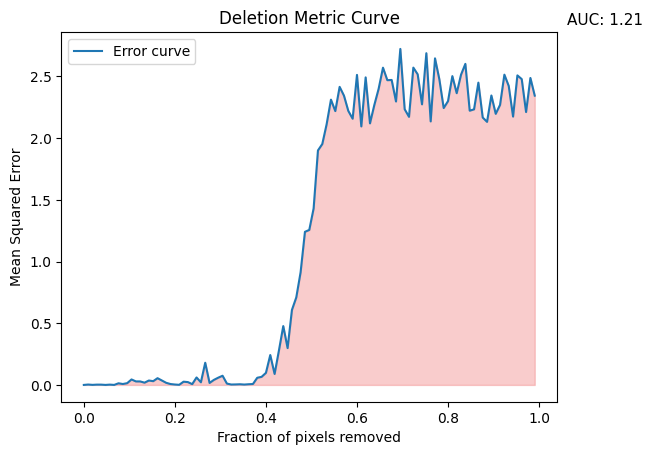

Errors: [0.0, 0.0030774488, 0.00048442298, 0.0023676138, 0.0023342057, 7.657852e-05, 0.0023924585, 8.3487575e-05, 0.013209488, 0.007411955, 0.01423838, 0.04436417, 0.028529147, 0.028268391, 0.018296264, 0.035628915, 0.030385628, 0.054643683, 0.035910737, 0.017023675, 0.0070703253, 0.0032281778, 0.0009481912, 0.026192097, 0.022922926, 0.006369811, 0.060599104, 0.021296415, 0.1797467, 0.015998542, 0.0408425, 0.058720052, 0.074354276, 0.010857617, 0.0031816124, 0.0039647007, 0.0053470046, 0.0029507508, 0.005511219, 0.007296314, 0.057992056, 0.06544926, 0.097630024, 0.24227388, 0.08880591, 0.2791886, 0.47700036, 0.29857597, 0.60799444, 0.70918286, 0.91358954, 1.2408137, 1.2562066, 1.4301157, 1.900471, 1.952482, 2.1125064, 2.3120298, 2.219358, 2.415717, 2.3444068, 2.2209523, 2.1575835, 2.5127277, 2.095145, 2.4925356, 2.1200578, 2.2685208, 2.4005744, 2.5711915, 2.4698842, 2.4716473, 2.297239, 2.7232187, 2.2345395, 2.1727417, 2.5717096, 2.5172963, 2.2741985, 2.6884384, 2.1357887, 2.6467276, 2

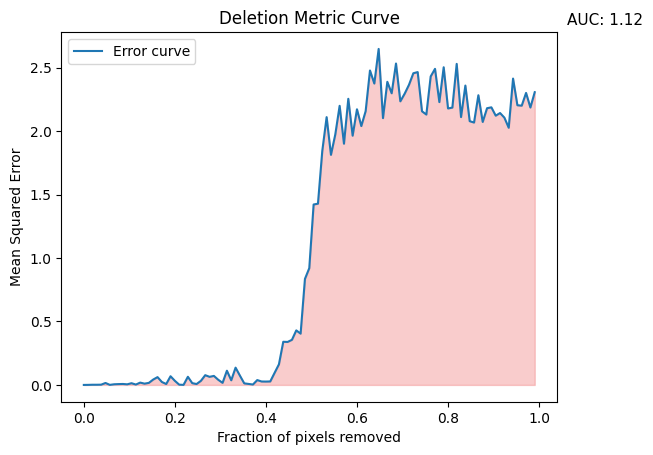

Errors: [0.0, 0.0004128999, 0.001389929, 0.0013756021, 0.0019726073, 0.015378856, 0.00044208832, 0.0051161125, 0.0065147094, 0.007509568, 0.004664533, 0.013559675, 0.002843193, 0.018269764, 0.010099984, 0.016120728, 0.042307258, 0.061451696, 0.02315141, 0.007191081, 0.06830241, 0.03224032, 0.0019457184, 0.0003916698, 0.06417415, 0.014092923, 0.0069403388, 0.031971183, 0.07685437, 0.06381914, 0.07103673, 0.040618945, 0.016261008, 0.111962564, 0.036627866, 0.1361571, 0.07321447, 0.012244386, 0.007809314, 0.0031134228, 0.038177527, 0.02701203, 0.026460176, 0.027451657, 0.095289856, 0.16233252, 0.34014878, 0.33875844, 0.355426, 0.42987913, 0.40419042, 0.8356155, 0.9204638, 1.4221174, 1.4285018, 1.8448803, 2.1106038, 1.8135433, 1.9744644, 2.1998181, 1.9011889, 2.2551792, 1.9644725, 2.1725965, 2.0402122, 2.157838, 2.4784253, 2.3754482, 2.6482842, 2.1027656, 2.3890023, 2.2987053, 2.5331643, 2.2352877, 2.2955396, 2.3657753, 2.4564512, 2.4658506, 2.1564906, 2.131055, 2.4312208, 2.491315, 2.2292

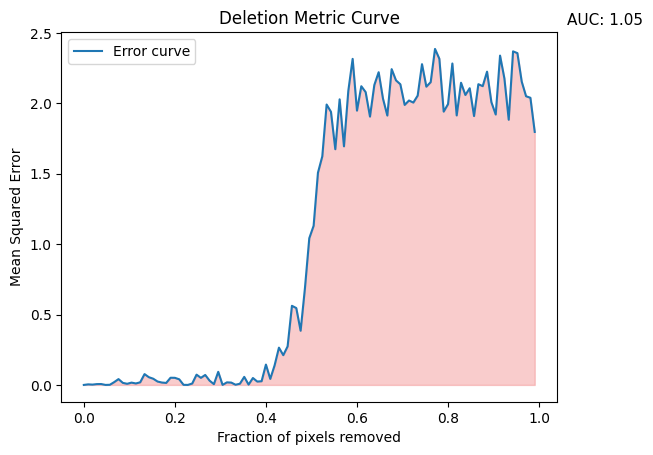

Errors: [0.0, 0.0039687552, 0.0022444325, 0.005807568, 0.0062771398, 4.523302e-05, 0.0008997122, 0.019874353, 0.041350666, 0.014546427, 0.008016175, 0.016376987, 0.010459862, 0.018396502, 0.07683197, 0.054795492, 0.044170942, 0.02416303, 0.016959405, 0.01421762, 0.050992977, 0.05044498, 0.039994106, 0.0005527976, 4.5993034e-05, 0.009934238, 0.0729193, 0.05020088, 0.07076604, 0.030472383, 0.005462441, 0.09292297, 0.00018949757, 0.018183887, 0.016601397, 0.0012987833, 0.0084369555, 0.057132322, 0.0022879243, 0.049096122, 0.023869736, 0.026250934, 0.14440136, 0.042790987, 0.13880515, 0.26464918, 0.211282, 0.2735617, 0.5617008, 0.54594725, 0.38481992, 0.6876743, 1.0418204, 1.1299497, 1.5068536, 1.6228963, 1.991036, 1.9392227, 1.6737031, 2.0280025, 1.6942506, 2.0876713, 2.3153508, 1.9478188, 2.1210425, 2.0791457, 1.9054589, 2.1295176, 2.2205317, 2.0326293, 1.912718, 2.2423732, 2.1626143, 2.1350095, 1.988308, 2.019695, 2.0050185, 2.0544288, 2.2775536, 2.11792, 2.149866, 2.385915, 2.3159313, 

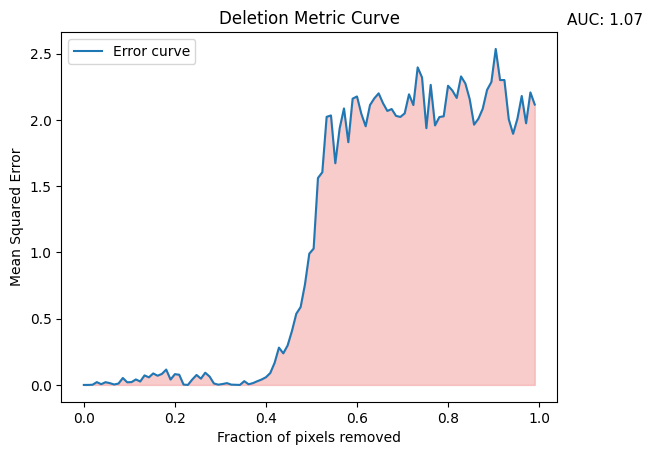

Errors: [0.0, 3.4228975e-05, 0.0013797967, 0.021189665, 0.005572096, 0.020710137, 0.013589509, 0.0031707822, 0.010721113, 0.052441698, 0.019822424, 0.021424366, 0.041452058, 0.025829498, 0.072055236, 0.057245556, 0.086893715, 0.069612466, 0.08292909, 0.11583482, 0.040484034, 0.081352234, 0.07695612, 0.0025629476, 6.0644627e-05, 0.04064538, 0.075319305, 0.047365062, 0.09205448, 0.06347977, 0.011121444, 0.0019811513, 0.0068852315, 0.013674913, 0.0022674429, 0.0010501238, 2.105446e-06, 0.028391348, 0.0049508573, 0.013672014, 0.027993275, 0.040902846, 0.05808752, 0.089962, 0.16674066, 0.2814675, 0.23824853, 0.29784596, 0.40700325, 0.53697157, 0.58764654, 0.7585603, 0.99028975, 1.0284541, 1.5612471, 1.6044477, 2.0224428, 2.0332496, 1.6724434, 1.9351664, 2.086339, 1.831234, 2.1597395, 2.1765993, 2.0458775, 1.9514843, 2.1114805, 2.1623158, 2.1997855, 2.1257708, 2.067232, 2.0816247, 2.0298383, 2.0219326, 2.0487716, 2.192702, 2.1113818, 2.3957584, 2.3200748, 1.9370788, 2.2640753, 1.95787, 2.021

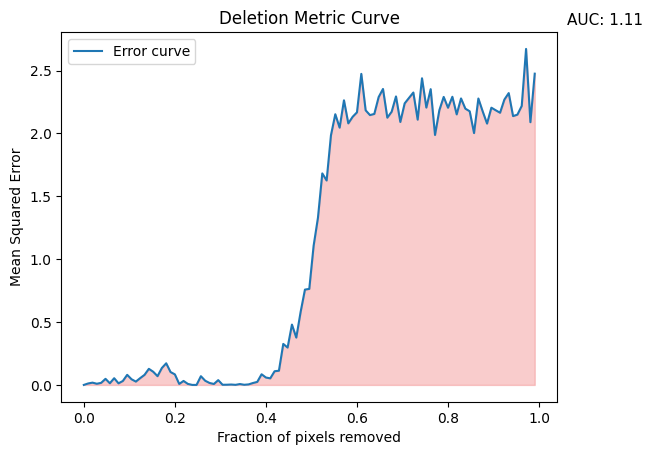

Errors: [0.0, 0.011645991, 0.018130492, 0.009301241, 0.016498769, 0.048413545, 0.01315135, 0.05340262, 0.012647121, 0.03134193, 0.08021995, 0.045041457, 0.026484538, 0.054165766, 0.080105595, 0.12797734, 0.10484727, 0.06966481, 0.13471594, 0.17201458, 0.1024095, 0.083891645, 0.007863513, 0.03163105, 0.007982738, 0.00012273529, 6.8176596e-05, 0.069312796, 0.03307114, 0.015444268, 0.007535126, 0.038138498, 0.001213534, 0.0016463329, 0.0031380826, 0.00069245277, 0.0069604544, 0.0011855252, 0.004127663, 0.015164952, 0.024018709, 0.084766224, 0.058825247, 0.05229515, 0.10889129, 0.112956464, 0.3261364, 0.29712996, 0.47986487, 0.3764652, 0.5800822, 0.7581654, 0.7638597, 1.1066862, 1.3296872, 1.6823764, 1.6260478, 1.9857988, 2.1530647, 2.0462818, 2.263958, 2.0803506, 2.1324892, 2.1681876, 2.4740205, 2.1841507, 2.1460962, 2.1555958, 2.2896326, 2.3539662, 2.1256442, 2.1729846, 2.2946138, 2.0913608, 2.239279, 2.2829263, 2.325704, 2.109975, 2.438986, 2.205786, 2.3523366, 1.9881463, 2.1849372, 2.2

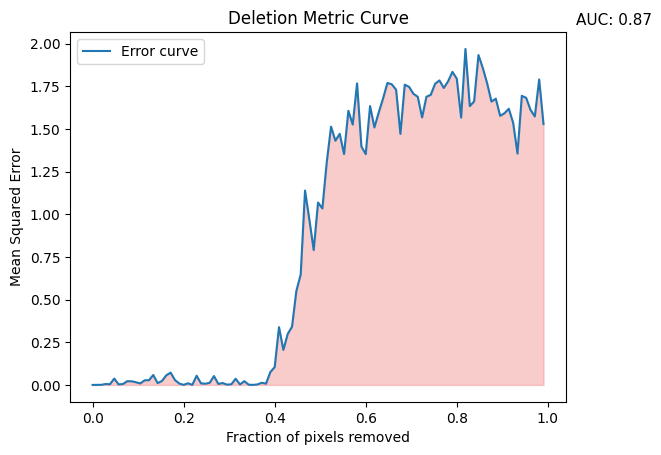

Errors: [0.0, 0.00033521064, 0.00044210837, 0.0052997936, 0.0038171043, 0.03739209, 0.0027463464, 0.005409004, 0.02187169, 0.021423565, 0.015786886, 0.008650651, 0.02697701, 0.02765115, 0.058241565, 0.010735337, 0.022995792, 0.056551505, 0.072114065, 0.028478188, 0.008185741, 0.00024933871, 0.009719639, 0.00029521677, 0.054055177, 0.008968244, 0.0070626694, 0.012277914, 0.051901698, 0.0059226165, 0.010997633, 0.0017553435, 0.0035560257, 0.036360417, 0.0024967538, 0.022165185, 0.0013836784, 0.00021923977, 0.0027349633, 0.012596256, 0.007566036, 0.075436346, 0.10438766, 0.33861247, 0.20524341, 0.29812017, 0.34137994, 0.55063456, 0.64727354, 1.1388063, 0.968606, 0.7903857, 1.0687311, 1.0339359, 1.3029597, 1.5133253, 1.4307618, 1.4714614, 1.3528157, 1.6061457, 1.5255033, 1.7668142, 1.3969057, 1.3522208, 1.6340864, 1.5088518, 1.5963165, 1.678513, 1.7692289, 1.7614809, 1.7298614, 1.4708579, 1.759184, 1.7463838, 1.7058172, 1.6882349, 1.5672636, 1.6884353, 1.6998674, 1.7645624, 1.7841504, 1.73

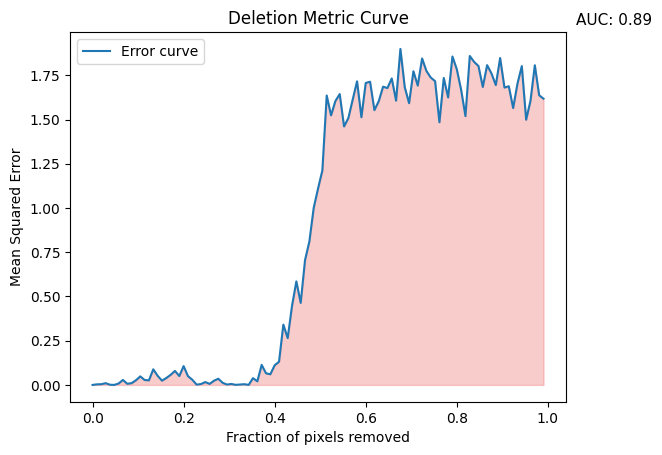

Errors: [0.0, 0.0032794764, 0.00390774, 0.009880487, 0.0012115083, 1.39843905e-08, 0.007919958, 0.028137702, 0.006457202, 0.009926921, 0.026351774, 0.048355594, 0.027743919, 0.025873736, 0.088293456, 0.051704284, 0.024197659, 0.03912429, 0.05694419, 0.07909767, 0.050219364, 0.10653987, 0.049504165, 0.029357024, 0.0017104442, 0.004859453, 0.016226184, 0.005857276, 0.023758404, 0.034971245, 0.011848634, 0.002138102, 0.0054080226, 0.0005087331, 0.0022265539, 0.0040331646, 0.00018730827, 0.038214102, 0.020304734, 0.11315199, 0.06578626, 0.06012879, 0.11133719, 0.1305793, 0.34084857, 0.2644276, 0.44692263, 0.5851947, 0.46374103, 0.7053972, 0.81038046, 1.0005091, 1.1097298, 1.2123297, 1.6356579, 1.5235616, 1.6040328, 1.6438292, 1.4607786, 1.5084254, 1.6132585, 1.7159493, 1.5129663, 1.7064254, 1.7136896, 1.553028, 1.6033885, 1.6855752, 1.6777512, 1.7318943, 1.6065065, 1.8989396, 1.6825616, 1.5923235, 1.7727039, 1.6916659, 1.8450193, 1.774246, 1.7371761, 1.7166668, 1.4843727, 1.7345471, 1.6248

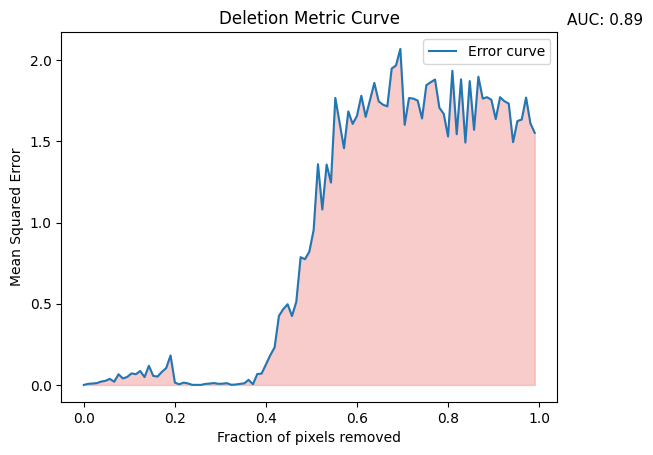

Errors: [0.0, 0.006703315, 0.008514966, 0.011321166, 0.020732308, 0.025501018, 0.037402555, 0.019657517, 0.06573747, 0.040210053, 0.049229395, 0.071289554, 0.06585636, 0.08591893, 0.04830009, 0.1180333, 0.055798594, 0.051732697, 0.08047967, 0.104271606, 0.1816986, 0.014091763, 0.00425581, 0.014241595, 0.009589716, 0.00048351035, 0.00033534598, 0.0001720514, 0.0062142448, 0.008280407, 0.011608251, 0.0068804645, 0.007826854, 0.01086855, 0.0008547762, 0.0025016167, 0.0065377643, 0.009898009, 0.031301383, 0.004312269, 0.066644676, 0.0702315, 0.1261991, 0.1829421, 0.23147793, 0.42561847, 0.46723995, 0.49724746, 0.42436042, 0.51171917, 0.7870809, 0.7744403, 0.8208952, 0.95338446, 1.3599886, 1.0809695, 1.3576449, 1.2470454, 1.7682098, 1.6140696, 1.4582031, 1.6853564, 1.6082457, 1.6579046, 1.7821089, 1.6516933, 1.7550291, 1.8608208, 1.7475523, 1.7265798, 1.7163628, 1.9491773, 1.9687097, 2.0702112, 1.6025068, 1.7675993, 1.7641611, 1.751753, 1.6416432, 1.8470199, 1.8649828, 1.8814796, 1.7077658,

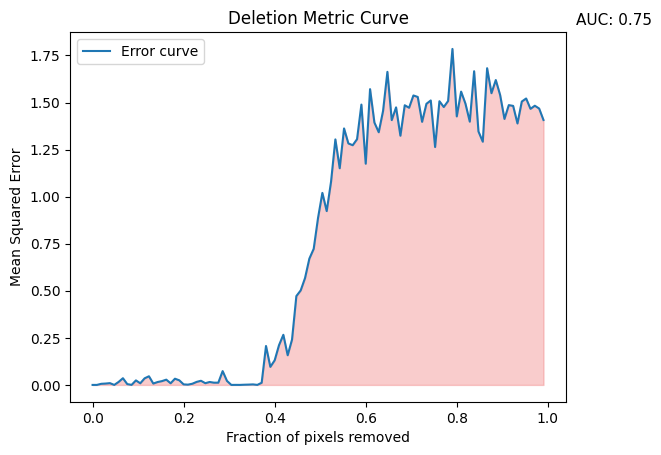

Errors: [0.0, 5.1341707e-05, 0.0058853915, 0.0072720787, 0.009444626, 7.671946e-06, 0.015826693, 0.035602905, 0.004330136, 0.00028076945, 0.02405083, 0.008692457, 0.03500915, 0.04596723, 0.0073554316, 0.015369603, 0.020230027, 0.02795583, 0.008807893, 0.03301792, 0.024486424, 0.0028550536, 0.0014568836, 0.0062153535, 0.016093465, 0.022027852, 0.009191975, 0.01558018, 0.01196349, 0.011918939, 0.07337887, 0.021251103, 4.526349e-05, 0.00024394323, 0.00011040681, 0.0010759233, 0.0017136504, 0.0027721329, 0.00010220529, 0.011536027, 0.20667957, 0.09594563, 0.13073175, 0.21106288, 0.26618886, 0.15762089, 0.24056531, 0.47181675, 0.5019351, 0.56747323, 0.67073095, 0.72274953, 0.8869557, 1.0199617, 0.92324346, 1.0790755, 1.3039869, 1.1508296, 1.3623683, 1.2825204, 1.2731948, 1.305208, 1.4889362, 1.1749632, 1.5709795, 1.3936833, 1.3420426, 1.4554772, 1.6628324, 1.4064877, 1.4741884, 1.3236948, 1.4853661, 1.4721069, 1.5374091, 1.5294977, 1.3973042, 1.4931014, 1.5108538, 1.2635643, 1.5068471, 1.47

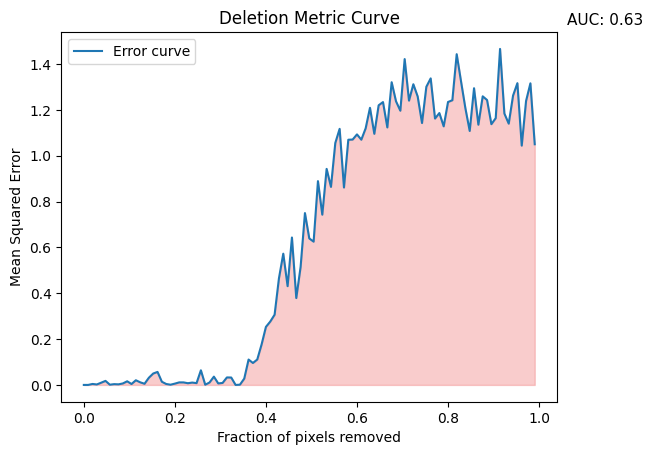

Errors: [0.0, 3.0939242e-07, 0.004185844, 0.0020137571, 0.00971656, 0.017617982, 0.0010008666, 0.0034076965, 0.0025232472, 0.0064512836, 0.015829602, 0.003953045, 0.020357188, 0.011438771, 0.0050606015, 0.031322856, 0.049707863, 0.0567098, 0.0138265, 0.004065556, 0.00092974433, 0.005689906, 0.011049751, 0.011004261, 0.007470343, 0.010238156, 0.007869836, 0.06377133, 0.0007814118, 0.010737214, 0.03610197, 0.006544822, 0.008595413, 0.032698672, 0.032228205, 2.6842294e-05, 0.000866618, 0.027591594, 0.11068026, 0.09568858, 0.11080347, 0.17656112, 0.25318727, 0.2764403, 0.30631006, 0.46469536, 0.57248056, 0.43081412, 0.6430989, 0.37896144, 0.51495504, 0.74961007, 0.63904756, 0.62500584, 0.889029, 0.742743, 0.9423652, 0.8639777, 1.0555018, 1.1171082, 0.86119324, 1.0695969, 1.0703789, 1.0929041, 1.0698013, 1.1192908, 1.2088962, 1.0954618, 1.2198182, 1.2338645, 1.1233307, 1.3204321, 1.2374374, 1.1962179, 1.4214573, 1.2401109, 1.3116584, 1.2583476, 1.142498, 1.3005822, 1.3372306, 1.1620314, 1.1

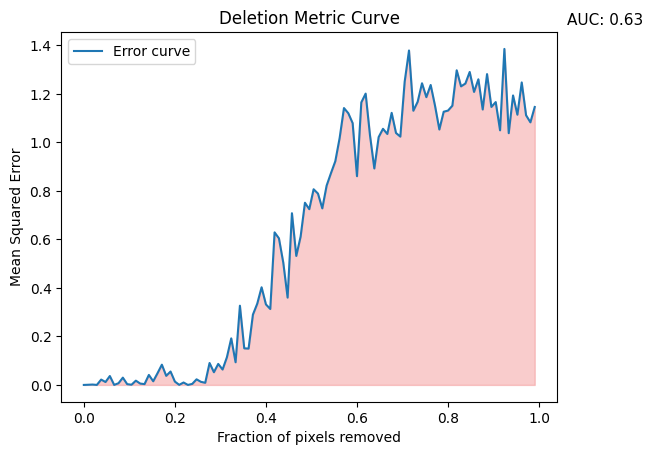

Errors: [0.0, 0.0007104296, 0.0015459025, 1.5664717e-05, 0.022031816, 0.011997285, 0.03669721, 7.718896e-07, 0.0070840647, 0.03003914, 0.0031817872, 0.0008243946, 0.017558128, 0.0055845254, 0.0033673437, 0.041198622, 0.015093572, 0.04841958, 0.08343898, 0.03752152, 0.055247363, 0.013775775, 0.00030558428, 0.009997788, 3.1553755e-06, 0.0041659386, 0.023103187, 0.012806808, 0.0088397395, 0.090397164, 0.052369434, 0.08659745, 0.06352922, 0.1142193, 0.19204578, 0.09350516, 0.32667023, 0.1508585, 0.14987363, 0.28999066, 0.33505288, 0.40263492, 0.33205768, 0.31308866, 0.6290677, 0.60444605, 0.5045213, 0.360072, 0.70803297, 0.53194076, 0.61152613, 0.7512571, 0.72468543, 0.8068331, 0.7890879, 0.72800344, 0.82191753, 0.87333745, 0.9223421, 1.0179406, 1.1416646, 1.1203552, 1.079584, 0.860693, 1.1649187, 1.201243, 1.0296266, 0.8926284, 1.0219946, 1.056113, 1.0347763, 1.1219736, 1.0389379, 1.0239352, 1.2502952, 1.3791041, 1.1306701, 1.1677464, 1.2438961, 1.1866792, 1.2368102, 1.1513144, 1.0531981,

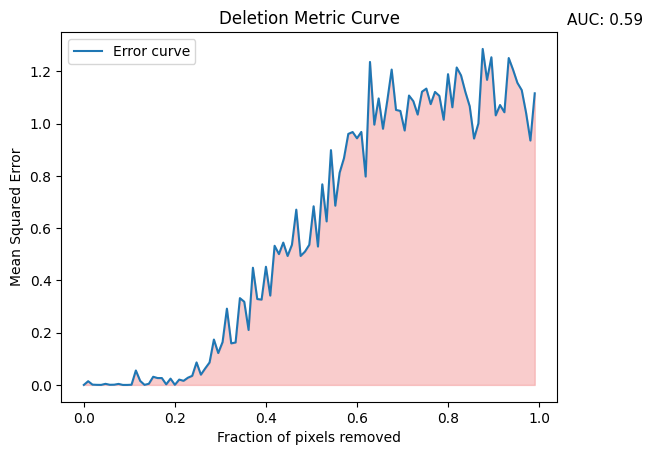

Errors: [0.0, 0.014205114, 0.0010513449, 0.000300248, 9.171505e-05, 0.004186245, 0.0005204802, 0.0008485559, 0.0039017363, 1.9211247e-06, 1.693352e-06, 0.00064968166, 0.055284243, 0.015385243, 0.00023704045, 0.0044177733, 0.031245263, 0.026281653, 0.026249891, 0.0022699297, 0.024037372, 0.0003452725, 0.020410664, 0.015667347, 0.027540965, 0.034798153, 0.08613718, 0.039219372, 0.063359514, 0.08597946, 0.17373915, 0.1220968, 0.16395256, 0.2919675, 0.15906636, 0.16245195, 0.33224759, 0.31843778, 0.21037917, 0.4486369, 0.32876176, 0.32662582, 0.45236066, 0.3420135, 0.5326931, 0.50082785, 0.54488176, 0.49364424, 0.5365071, 0.67097443, 0.49365178, 0.5103121, 0.53649175, 0.68390614, 0.5297293, 0.7679702, 0.6259779, 0.89886224, 0.68614006, 0.81239843, 0.86791646, 0.96091646, 0.96818066, 0.9441936, 0.96855026, 0.7976915, 1.2364938, 0.996415, 1.0967561, 0.98063284, 1.0893342, 1.2072874, 1.0527426, 1.0489836, 0.97389203, 1.1078923, 1.0861952, 1.0349929, 1.1224892, 1.1344283, 1.0749649, 1.1216593,

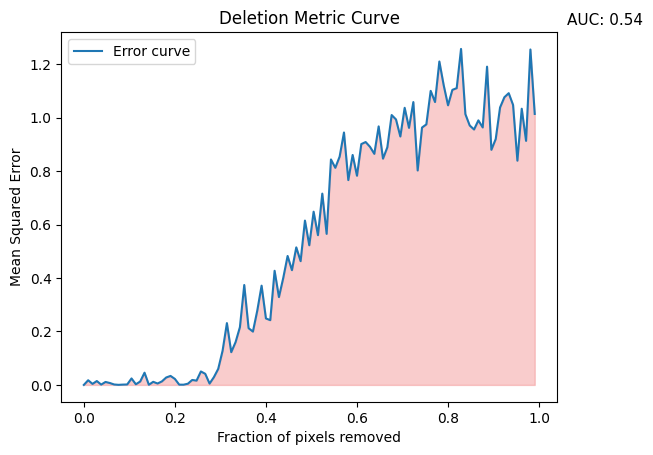

Errors: [0.0, 0.017497018, 0.0038493427, 0.014508925, 0.0012354925, 0.011118478, 0.007150924, 0.0016007886, 0.00031972292, 0.0011717986, 0.0016711813, 0.024212718, 0.002414421, 0.012782105, 0.045780893, 0.0005522708, 0.011630611, 0.005330699, 0.013080004, 0.027831435, 0.033680364, 0.022501495, 0.0010240347, 0.0008551456, 0.0045301514, 0.01858818, 0.016106836, 0.05037566, 0.041619305, 0.005057854, 0.029126674, 0.060154982, 0.12762797, 0.23126142, 0.12257129, 0.1601923, 0.21609645, 0.37387353, 0.21227463, 0.19955748, 0.27771187, 0.37135592, 0.24871027, 0.2422395, 0.42705783, 0.32861617, 0.40060633, 0.4824544, 0.42939562, 0.51462966, 0.46299917, 0.61479586, 0.5225252, 0.64807355, 0.56032073, 0.71571714, 0.56518596, 0.8435972, 0.81234986, 0.85419655, 0.9444201, 0.76636994, 0.8604519, 0.78253424, 0.9011242, 0.90874726, 0.89090747, 0.8645771, 0.96723944, 0.84657604, 0.88893574, 1.0097382, 0.9932608, 0.929491, 1.0368539, 0.96166486, 1.0582583, 0.80236685, 0.9629876, 0.97477114, 1.1002334, 1.0

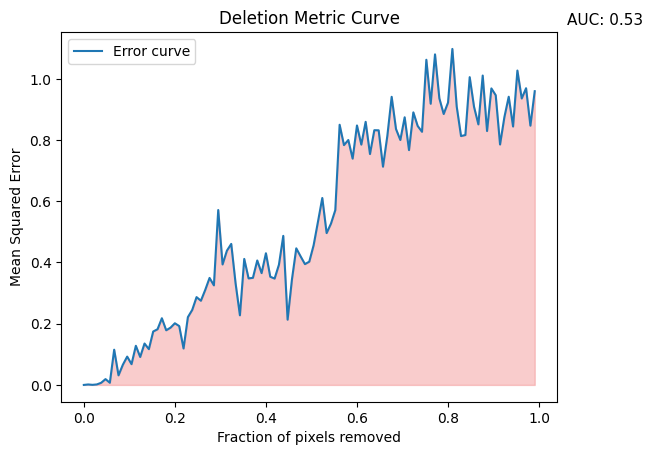

Errors: [0.0, 0.0014939543, 0.00026666513, 0.0015924338, 0.0069662835, 0.018970374, 0.007057741, 0.11500991, 0.031304754, 0.065904945, 0.09251613, 0.067814395, 0.12781082, 0.09129679, 0.13525808, 0.11682095, 0.17453967, 0.18185413, 0.21784012, 0.17850164, 0.18712339, 0.20142345, 0.19228742, 0.11904073, 0.22142993, 0.2450485, 0.2868175, 0.27500322, 0.3103606, 0.3495466, 0.3252225, 0.5714018, 0.39354885, 0.43854845, 0.4606759, 0.33193997, 0.22744803, 0.4115822, 0.3479916, 0.34989318, 0.40655056, 0.36524624, 0.43017855, 0.353433, 0.34741125, 0.3926691, 0.4869332, 0.21311194, 0.3445399, 0.44621697, 0.4199284, 0.3946762, 0.40263522, 0.4563248, 0.5329239, 0.61061025, 0.4960215, 0.5268291, 0.5710349, 0.8498876, 0.78341323, 0.80006236, 0.7391978, 0.84766513, 0.7850302, 0.85944366, 0.7542555, 0.8320952, 0.83178186, 0.7129438, 0.813229, 0.941205, 0.8359535, 0.8001593, 0.87425745, 0.7670933, 0.8904193, 0.84593093, 0.8269058, 1.0622289, 0.9185256, 1.0798271, 0.9360832, 0.88503325, 0.9223307, 1.097

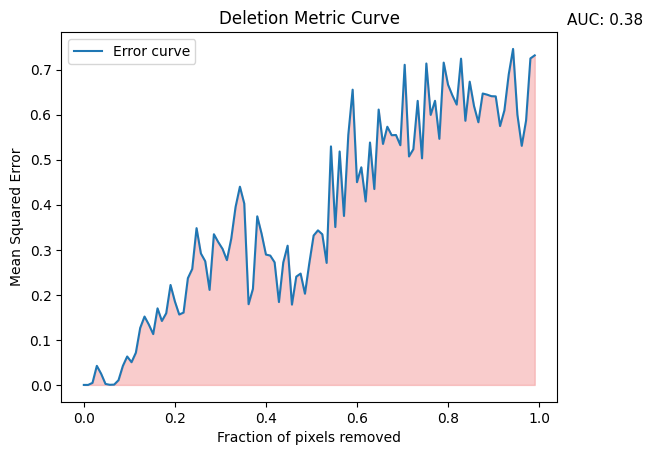

Errors: [0.0, 1.675697e-05, 0.004568279, 0.04235381, 0.024608947, 0.002168382, 0.00027386515, 0.00069741165, 0.01052091, 0.042081684, 0.06313951, 0.050415535, 0.071537845, 0.1265303, 0.15182582, 0.13384908, 0.11287387, 0.17002137, 0.14197783, 0.15912932, 0.2219435, 0.18540613, 0.15631744, 0.16063002, 0.2370198, 0.25740606, 0.34806952, 0.2919138, 0.27461717, 0.2110022, 0.33457568, 0.31716737, 0.3019505, 0.2770736, 0.3246127, 0.3951591, 0.44011584, 0.40274808, 0.17924559, 0.21326165, 0.3743061, 0.33566618, 0.2894336, 0.28720388, 0.27219304, 0.18401903, 0.27186576, 0.30909458, 0.17835006, 0.24043916, 0.24720608, 0.20247322, 0.26986676, 0.3316756, 0.3431694, 0.33447805, 0.27093172, 0.5296191, 0.3505, 0.51833594, 0.37514174, 0.5551989, 0.6555497, 0.4501638, 0.4832051, 0.40738183, 0.5382279, 0.43496707, 0.61139816, 0.5350267, 0.5732556, 0.5544332, 0.5548674, 0.5321801, 0.7108141, 0.5072604, 0.52330667, 0.63070965, 0.5030532, 0.7136678, 0.59954065, 0.63084745, 0.5464155, 0.71562314, 0.6666511

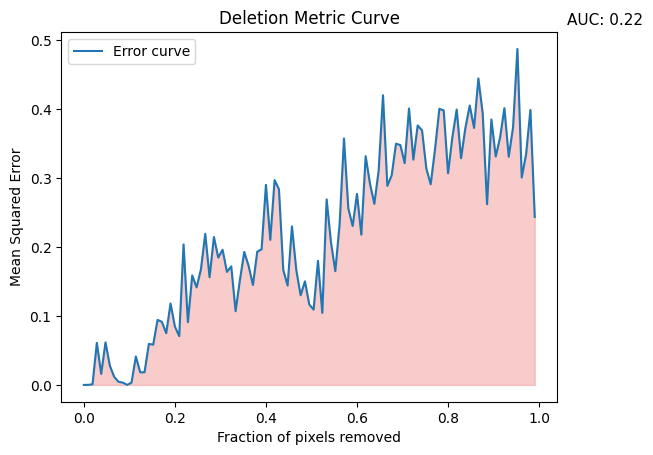

Errors: [0.0, 8.707846e-05, 0.00090892526, 0.06098626, 0.01597072, 0.061709713, 0.027849814, 0.0116401, 0.0045037125, 0.0033598077, 5.8104026e-05, 0.0033901408, 0.041287858, 0.018195912, 0.018436007, 0.05949631, 0.05841615, 0.094257295, 0.09144576, 0.07497102, 0.11805296, 0.08469405, 0.07076084, 0.2036658, 0.09093091, 0.15870176, 0.14138764, 0.16728376, 0.21896486, 0.156189, 0.21435322, 0.18456917, 0.19591603, 0.16384678, 0.1718435, 0.106887154, 0.15208906, 0.19274917, 0.17262122, 0.14484854, 0.19316415, 0.19655909, 0.28996095, 0.21025972, 0.2969318, 0.28367722, 0.16644643, 0.14397712, 0.22980486, 0.16651808, 0.12999806, 0.15017615, 0.11652435, 0.10919346, 0.17989129, 0.10437272, 0.26899356, 0.20659325, 0.16490074, 0.23353738, 0.35726604, 0.2561152, 0.23028238, 0.27693105, 0.2178666, 0.33152723, 0.29157847, 0.2624145, 0.31077582, 0.41994524, 0.2885288, 0.30389842, 0.34966516, 0.3476734, 0.32145336, 0.4006795, 0.32658568, 0.3761649, 0.3691197, 0.31360507, 0.29088438, 0.34172192, 0.40030

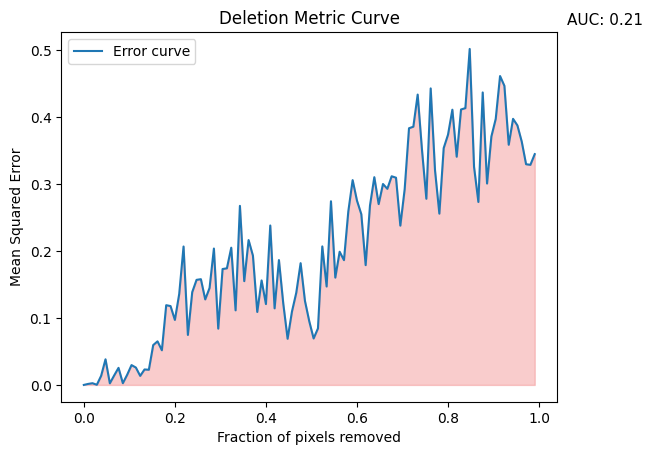

Errors: [0.0, 0.0015061339, 0.002560534, 0.0001963222, 0.013722574, 0.038289506, 0.0024094563, 0.014204176, 0.025503226, 0.0025767502, 0.015236822, 0.029627051, 0.025987454, 0.013518922, 0.023095904, 0.0226783, 0.059519283, 0.06511975, 0.051781785, 0.11912613, 0.11779547, 0.09711965, 0.13591474, 0.20681508, 0.07468849, 0.13859493, 0.15697874, 0.15797898, 0.12777178, 0.14489445, 0.2037704, 0.08410972, 0.17317098, 0.17423844, 0.20502377, 0.11144485, 0.26754034, 0.15505254, 0.21645935, 0.1931946, 0.10902138, 0.15610608, 0.12080337, 0.23820332, 0.11441438, 0.18654525, 0.1215032, 0.06896625, 0.10946299, 0.13781862, 0.1819075, 0.1255378, 0.09493581, 0.06940655, 0.084449574, 0.20696136, 0.14703731, 0.2744111, 0.16034268, 0.19898713, 0.18642068, 0.25915733, 0.30602536, 0.27536026, 0.25508702, 0.17896503, 0.2680204, 0.3103586, 0.2701563, 0.30019182, 0.29299995, 0.31174764, 0.3096224, 0.23799205, 0.29239926, 0.38347343, 0.38582274, 0.43379366, 0.35073668, 0.27813178, 0.44302994, 0.32053986, 0.25

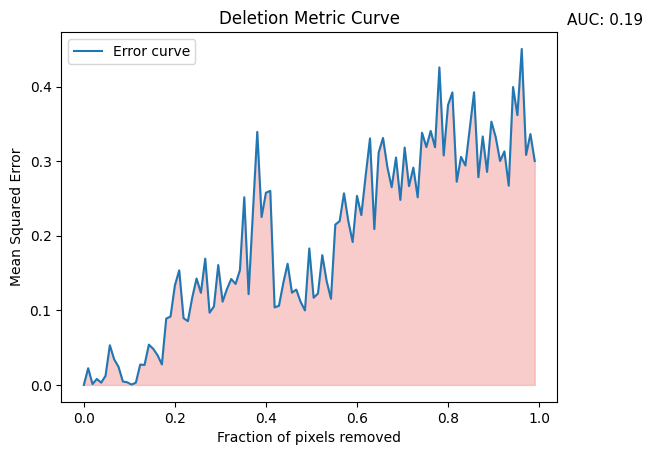

Errors: [0.0, 0.022355458, 0.00112883, 0.008000919, 0.0030695577, 0.012176573, 0.053186256, 0.034228377, 0.024244523, 0.0046116975, 0.0035458105, 0.00047020323, 0.0030410527, 0.02728777, 0.026803305, 0.053999647, 0.048434217, 0.03978768, 0.02748382, 0.08888571, 0.09177258, 0.13329881, 0.15360977, 0.08949442, 0.08547699, 0.11707052, 0.14269014, 0.1234741, 0.16930172, 0.09686801, 0.105128236, 0.1606803, 0.111644246, 0.12845731, 0.14195421, 0.1353281, 0.15386254, 0.2515626, 0.121689096, 0.23207986, 0.33919784, 0.22508882, 0.25761062, 0.2601735, 0.10397864, 0.10606297, 0.13656032, 0.1624704, 0.123669624, 0.12780741, 0.111387156, 0.09992253, 0.18297301, 0.11688476, 0.122579135, 0.17393135, 0.13929065, 0.11545594, 0.21494125, 0.21956275, 0.25685892, 0.21959007, 0.19157344, 0.2533949, 0.22770098, 0.28036243, 0.33045083, 0.208898, 0.31148005, 0.33103976, 0.29220963, 0.2649909, 0.30485916, 0.24802622, 0.31820482, 0.26649335, 0.2913513, 0.25151798, 0.33812144, 0.31885546, 0.34044683, 0.3186368, 

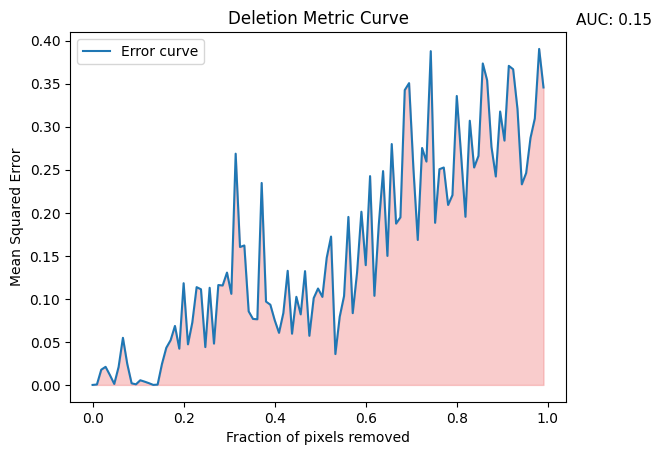

Errors: [0.0, 0.0004771616, 0.01770023, 0.021027863, 0.011415069, 0.0011308094, 0.020843718, 0.0547306, 0.024360597, 0.0018974448, 0.0006853814, 0.005422848, 0.003816132, 0.002021007, 1.8712091e-05, 0.00035026105, 0.024274155, 0.043129344, 0.05197815, 0.06854526, 0.042126104, 0.118191354, 0.047182124, 0.072512016, 0.11361047, 0.1111229, 0.04395649, 0.11287571, 0.048017293, 0.11605173, 0.11554353, 0.1305248, 0.10584684, 0.26868778, 0.1602425, 0.16204803, 0.08548089, 0.07667272, 0.07628673, 0.23467146, 0.09681578, 0.09320539, 0.07530962, 0.060525175, 0.08353542, 0.13260847, 0.059508875, 0.102397665, 0.081965744, 0.13222022, 0.05708691, 0.10089688, 0.11203206, 0.10230255, 0.14771667, 0.17237574, 0.035853695, 0.07921862, 0.10329906, 0.19522674, 0.083377145, 0.1305413, 0.2012604, 0.13915117, 0.24262466, 0.10352562, 0.1855861, 0.24846219, 0.1498937, 0.2798847, 0.18742064, 0.19468008, 0.342578, 0.35065797, 0.2512767, 0.16843641, 0.27533227, 0.25950518, 0.38782102, 0.18836175, 0.25066814, 0.25

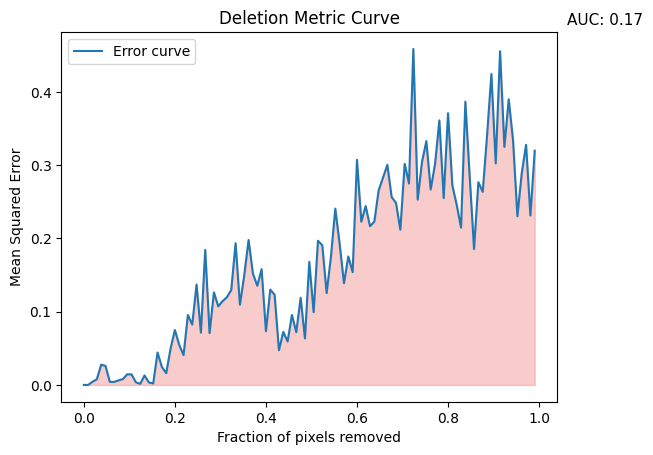

Errors: [0.0, 2.2067083e-05, 0.0043570837, 0.0076870895, 0.027694182, 0.02596724, 0.0041371197, 0.004129517, 0.0061862534, 0.007997081, 0.014525587, 0.014440971, 0.0036612917, 0.0014881083, 0.013002081, 0.0033925707, 0.0019966005, 0.04427603, 0.024652913, 0.016054774, 0.049517747, 0.0750192, 0.054681197, 0.04072439, 0.09552109, 0.08243782, 0.13710032, 0.07147422, 0.1844047, 0.07081501, 0.12640923, 0.10737832, 0.11440881, 0.11982018, 0.12966421, 0.1935411, 0.109590575, 0.14979185, 0.1979754, 0.15202557, 0.13539743, 0.15810315, 0.073497884, 0.1302232, 0.12316322, 0.047441315, 0.072406314, 0.059357867, 0.09558403, 0.07204289, 0.11906771, 0.06351522, 0.16805081, 0.09939566, 0.19690625, 0.19070682, 0.12550773, 0.17555867, 0.24082428, 0.19252235, 0.13893184, 0.17543732, 0.15409447, 0.30749992, 0.22290151, 0.24429414, 0.216821, 0.2230215, 0.26566812, 0.28313747, 0.3006279, 0.25650668, 0.24860744, 0.21201117, 0.30190733, 0.2750837, 0.4589037, 0.2530816, 0.30475834, 0.33296767, 0.26697183, 0.30

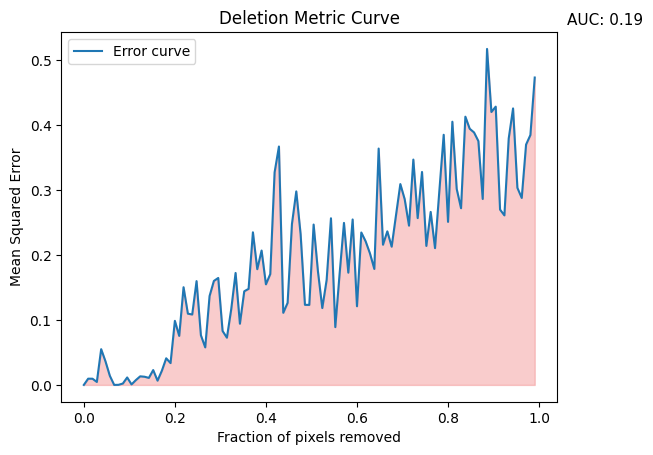

Errors: [0.0, 0.009609758, 0.009557943, 0.004568601, 0.055096105, 0.036168683, 0.014014547, 1.7090444e-05, 0.00014366461, 0.0021316246, 0.01149522, 0.0007528397, 0.0074262684, 0.013238825, 0.012623296, 0.010847334, 0.022896979, 0.006567872, 0.021919388, 0.041030485, 0.03362464, 0.098751485, 0.07552399, 0.15054734, 0.1097992, 0.10850196, 0.15995306, 0.076549314, 0.057837486, 0.13693017, 0.16026059, 0.16480412, 0.08316008, 0.07279105, 0.1168608, 0.17251667, 0.094327286, 0.14430451, 0.14800075, 0.23515771, 0.17830455, 0.20709246, 0.15501377, 0.17077091, 0.32754505, 0.3673704, 0.111114554, 0.12646408, 0.2479918, 0.29820538, 0.23233709, 0.12340784, 0.12329781, 0.24711397, 0.17476271, 0.11845355, 0.16167964, 0.2567865, 0.0890724, 0.17173114, 0.24965775, 0.17297746, 0.2549426, 0.12120578, 0.23486137, 0.22120813, 0.20253642, 0.17872053, 0.36421615, 0.2160089, 0.23664446, 0.21300265, 0.26147458, 0.30949342, 0.28628212, 0.24542253, 0.3472272, 0.2570607, 0.32814407, 0.21416621, 0.26659927, 0.2107

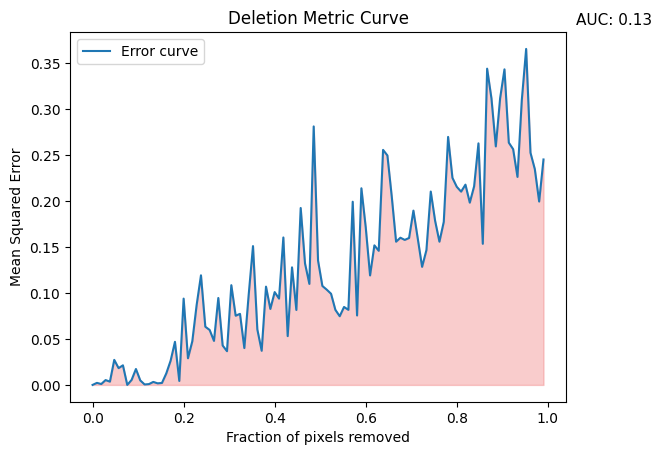

Errors: [0.0, 0.0022244619, 0.0009820538, 0.0052709687, 0.0035600646, 0.027215507, 0.018256973, 0.021300104, 8.771285e-06, 0.005439909, 0.017292565, 0.004906552, 0.00050706207, 0.0008861971, 0.0032725441, 0.001730936, 0.002132109, 0.012514135, 0.026332851, 0.046826545, 0.004318408, 0.093788244, 0.02899105, 0.047421895, 0.08682794, 0.11910506, 0.06325159, 0.059727177, 0.047840193, 0.09446734, 0.042852312, 0.036661, 0.10838561, 0.07521367, 0.077242516, 0.04006666, 0.097700216, 0.15085953, 0.060320407, 0.037127376, 0.10679559, 0.08256649, 0.10087272, 0.09380496, 0.16024183, 0.05304894, 0.12776548, 0.08146685, 0.1922733, 0.13191499, 0.10978269, 0.2809102, 0.13518591, 0.107535645, 0.103553474, 0.09908435, 0.08158619, 0.07464998, 0.084713966, 0.08159498, 0.19907233, 0.0754759, 0.21369092, 0.17130844, 0.11900108, 0.15166588, 0.14575604, 0.2554131, 0.24936008, 0.20477954, 0.15565373, 0.15996565, 0.15757613, 0.15969495, 0.1894001, 0.1590678, 0.12830499, 0.1465236, 0.21012795, 0.17838924, 0.1556

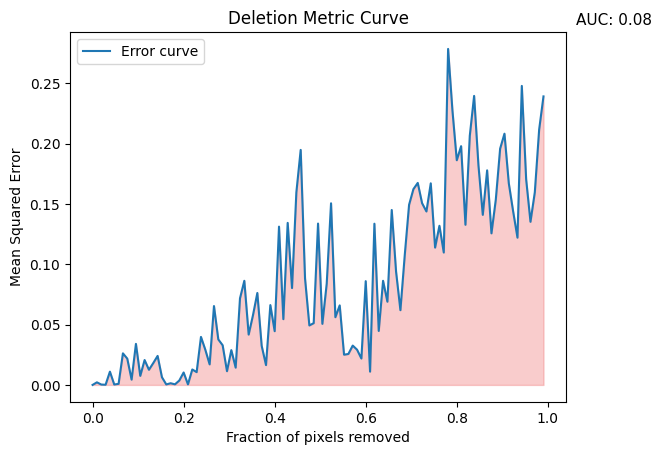

Errors: [0.0, 0.002145848, 0.00031091712, 0.00014025866, 0.010992334, 0.00032038405, 0.00089949055, 0.026184032, 0.021806333, 0.004393055, 0.034027882, 0.00750081, 0.02063431, 0.01256259, 0.018141665, 0.024052419, 0.006374626, 0.00038655294, 0.0013964609, 0.0004858566, 0.003643022, 0.010314893, 0.00044994816, 0.012825161, 0.01060049, 0.039810512, 0.029198779, 0.01701873, 0.06539163, 0.037712913, 0.03288687, 0.011375595, 0.028852705, 0.014349149, 0.07177794, 0.086317666, 0.041750688, 0.0578922, 0.07623021, 0.03244334, 0.016446168, 0.0661857, 0.04455399, 0.13124555, 0.054516573, 0.13436115, 0.080310896, 0.15963508, 0.19487157, 0.08835542, 0.049322225, 0.05121876, 0.13379408, 0.05063542, 0.083863266, 0.15059915, 0.05614182, 0.06596249, 0.02506751, 0.025670724, 0.03263248, 0.029215934, 0.021897826, 0.08603883, 0.011010564, 0.13366972, 0.044758294, 0.08632677, 0.06900081, 0.14504914, 0.0938524, 0.061968684, 0.107553355, 0.14937465, 0.16235068, 0.16750148, 0.15067132, 0.14382418, 0.1671504, 

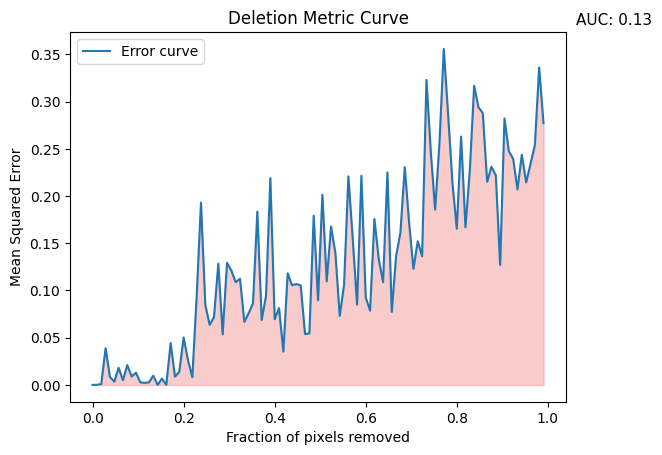

Errors: [0.0, 0.0001290155, 0.0009181274, 0.038829915, 0.008595501, 0.0033915292, 0.01812327, 0.0050236103, 0.021039931, 0.00894816, 0.012890451, 0.0028146484, 0.0021722475, 0.0027762142, 0.009738405, 1.03290404e-07, 0.006792249, 6.5691665e-07, 0.04439345, 0.008845143, 0.014013559, 0.050245333, 0.026213476, 0.008147712, 0.093371354, 0.19310093, 0.084734924, 0.06361909, 0.07188542, 0.12841313, 0.053543594, 0.12933111, 0.12122317, 0.108776696, 0.11243558, 0.0667613, 0.07598668, 0.08638535, 0.1835054, 0.068809055, 0.094388, 0.2189971, 0.06956272, 0.08144637, 0.035238598, 0.118180946, 0.10557103, 0.10679449, 0.10549946, 0.05385525, 0.054628525, 0.17913356, 0.08957347, 0.20136839, 0.10962937, 0.16775055, 0.13957278, 0.07311006, 0.1059449, 0.22079739, 0.15479054, 0.08504606, 0.22150701, 0.0925339, 0.078700215, 0.17568251, 0.13322975, 0.10885322, 0.22507769, 0.077302754, 0.13617544, 0.16144648, 0.2306913, 0.17190662, 0.12297207, 0.15210873, 0.13631065, 0.32300988, 0.24736352, 0.18563308, 0.25

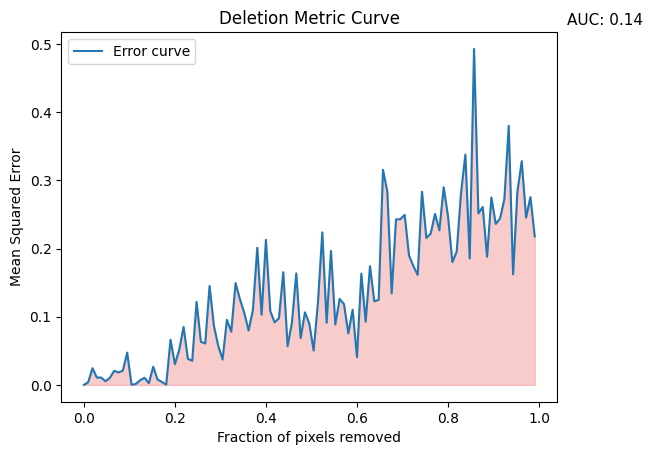

Errors: [0.0, 0.0038805283, 0.02451781, 0.010771606, 0.010825121, 0.0053928318, 0.010454059, 0.020703001, 0.018309424, 0.021000803, 0.047422674, 0.00027996305, 0.0014250269, 0.0069383727, 0.01047679, 0.0025607755, 0.026691904, 0.007942996, 0.004441035, 0.0003651133, 0.06626423, 0.030376403, 0.051506434, 0.08505357, 0.038242634, 0.035391785, 0.12176579, 0.06318865, 0.060837153, 0.14515717, 0.08661352, 0.05741533, 0.037280556, 0.095556095, 0.078130715, 0.14925599, 0.12553315, 0.1057509, 0.079848506, 0.11009542, 0.20113255, 0.10291804, 0.21284653, 0.10837297, 0.09176564, 0.09783351, 0.16522858, 0.05672127, 0.09161952, 0.1636188, 0.068688214, 0.10646416, 0.09001821, 0.050392836, 0.12101121, 0.22370379, 0.09111174, 0.19638123, 0.08871385, 0.12615065, 0.11859079, 0.0756419, 0.110252194, 0.040697258, 0.16325486, 0.09279067, 0.17406239, 0.12256528, 0.124894336, 0.31539607, 0.28332686, 0.13429797, 0.24264832, 0.2430602, 0.24929745, 0.18987766, 0.17430815, 0.16134538, 0.2833316, 0.21549554, 0.22

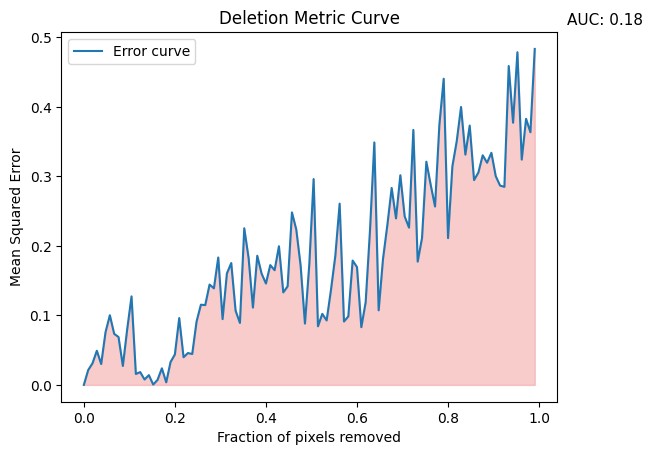

Errors: [0.0, 0.021323388, 0.031182753, 0.049161125, 0.030052777, 0.07574561, 0.10025033, 0.07345025, 0.068952784, 0.027307346, 0.080062345, 0.12737912, 0.01577281, 0.018481812, 0.007808956, 0.014088197, 0.0005214706, 0.007286786, 0.023910346, 0.0037489748, 0.032943964, 0.043870755, 0.096141875, 0.039821357, 0.04585382, 0.044517715, 0.0911928, 0.115364656, 0.11480568, 0.14436756, 0.13893619, 0.18329221, 0.094667286, 0.16038024, 0.17528771, 0.10682566, 0.0891571, 0.22531919, 0.18268411, 0.11126775, 0.18577194, 0.16009279, 0.14586724, 0.17234416, 0.16499965, 0.19945233, 0.13309677, 0.14179966, 0.24809083, 0.22346084, 0.17158446, 0.08825528, 0.17313957, 0.29609966, 0.08435371, 0.10221678, 0.09275161, 0.1366844, 0.18542656, 0.26073036, 0.09122909, 0.098577216, 0.17890593, 0.16955295, 0.08305513, 0.118859336, 0.2222417, 0.34878746, 0.1073277, 0.18116874, 0.22973149, 0.28326434, 0.23951548, 0.30158725, 0.24236642, 0.22625841, 0.3667634, 0.17737523, 0.21128523, 0.32105714, 0.28782716, 0.25663

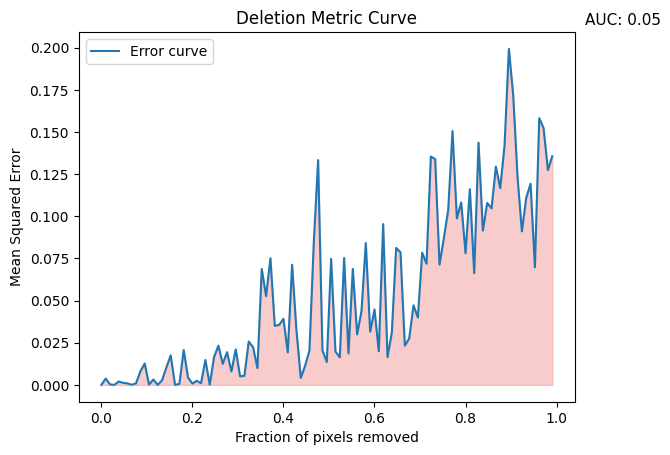

Errors: [0.0, 0.003784972, 0.00031593154, 2.345577e-05, 0.0020183604, 0.0012382261, 0.00094618066, 0.00010550962, 0.000905012, 0.008012994, 0.0127093755, 0.00021564325, 0.0032032602, 2.1133033e-05, 0.0027562636, 0.010316346, 0.017560244, 6.8699273e-06, 0.0006351306, 0.020710995, 0.004355353, 0.00078430696, 0.0024271135, 0.0010264546, 0.014804142, 0.00016192855, 0.016569218, 0.023249608, 0.012506802, 0.019395819, 0.00798685, 0.021080378, 0.0050773555, 0.0054725073, 0.025760228, 0.02236109, 0.009979345, 0.06871365, 0.0526162, 0.07514326, 0.035063416, 0.035570838, 0.03921961, 0.019293817, 0.07126781, 0.032374624, 0.0041388986, 0.011367306, 0.020442694, 0.08449669, 0.13333307, 0.020400174, 0.013618708, 0.07475799, 0.019750822, 0.01638077, 0.07526664, 0.018658165, 0.06877528, 0.029936602, 0.043762106, 0.084140226, 0.031588744, 0.04474019, 0.019961873, 0.09538018, 0.016470576, 0.03105729, 0.08127982, 0.078616425, 0.023318585, 0.02755153, 0.047203306, 0.039984953, 0.07839731, 0.07185806, 0.13

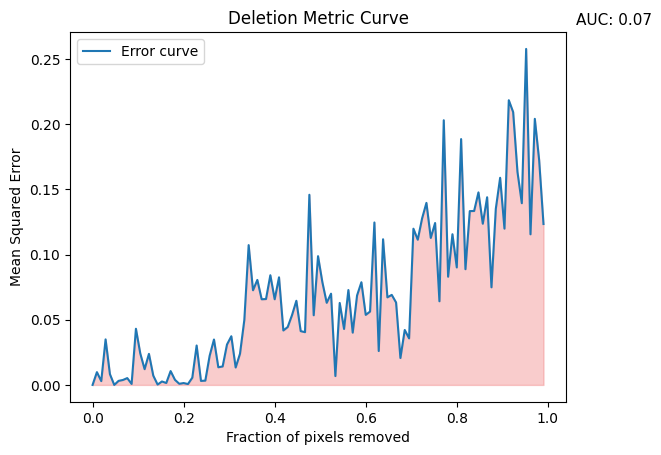

Errors: [0.0, 0.009804654, 0.002921051, 0.03491901, 0.008263819, 6.5923757e-07, 0.0031160708, 0.0037987726, 0.005239236, 0.000756383, 0.043066237, 0.02413265, 0.012073896, 0.023820145, 0.0071114623, 0.000264001, 0.0026450313, 0.0014867198, 0.010614068, 0.0039102742, 0.0008611941, 0.0014357121, 0.00067084737, 0.005547705, 0.03022944, 0.0030678674, 0.003296839, 0.022350183, 0.034831874, 0.013543966, 0.014173675, 0.030973356, 0.037333217, 0.013378107, 0.023890922, 0.049827725, 0.10721681, 0.07259971, 0.08051869, 0.065685764, 0.065859385, 0.084136486, 0.065674916, 0.08251019, 0.041761696, 0.044381294, 0.053528644, 0.06453378, 0.041258387, 0.040454775, 0.14582077, 0.05341802, 0.098733544, 0.0787825, 0.06298834, 0.06996786, 0.0067893416, 0.06285963, 0.042919785, 0.0727677, 0.0401006, 0.06860507, 0.07874804, 0.053729482, 0.056254577, 0.12457529, 0.025995795, 0.11170089, 0.067156576, 0.06905239, 0.06320363, 0.020643353, 0.04213844, 0.035689693, 0.11980652, 0.111358956, 0.12772125, 0.13960779, 

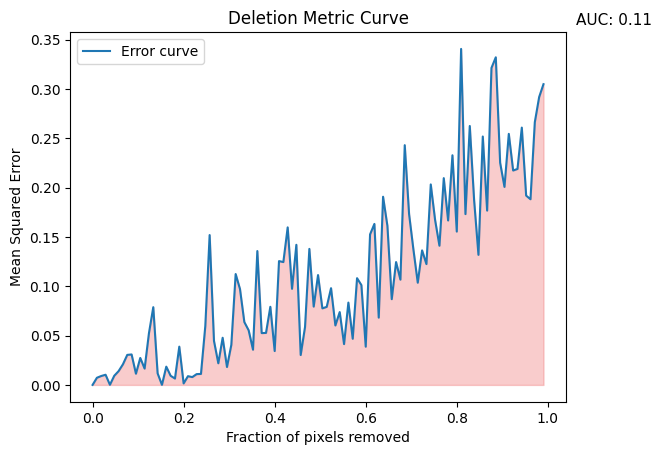

Errors: [0.0, 0.007263034, 0.009043451, 0.010316249, 0.000111834335, 0.00927275, 0.013974862, 0.020888593, 0.030435188, 0.030881615, 0.011363977, 0.027329532, 0.016553171, 0.05234914, 0.07879334, 0.011747896, 7.1071e-05, 0.01851654, 0.009270936, 0.006477219, 0.03878304, 0.0015332919, 0.008855505, 0.007941445, 0.010950379, 0.011152871, 0.05968395, 0.15189326, 0.044620145, 0.021919034, 0.047790978, 0.018128661, 0.04057696, 0.11240329, 0.09719003, 0.06372883, 0.055325344, 0.035692304, 0.13568258, 0.052527834, 0.052722488, 0.07918376, 0.034335732, 0.12550291, 0.124521054, 0.15967171, 0.09740864, 0.1420206, 0.03030406, 0.058731146, 0.13786115, 0.07938076, 0.11133302, 0.077594966, 0.07911273, 0.098068066, 0.060268536, 0.073838525, 0.041372344, 0.08344091, 0.046781413, 0.10818516, 0.10119844, 0.038755108, 0.15255311, 0.1631832, 0.06821287, 0.19072916, 0.16126652, 0.08690647, 0.12455067, 0.10670799, 0.24299249, 0.17313486, 0.13718526, 0.10360837, 0.13635881, 0.12244975, 0.20320587, 0.16715902,

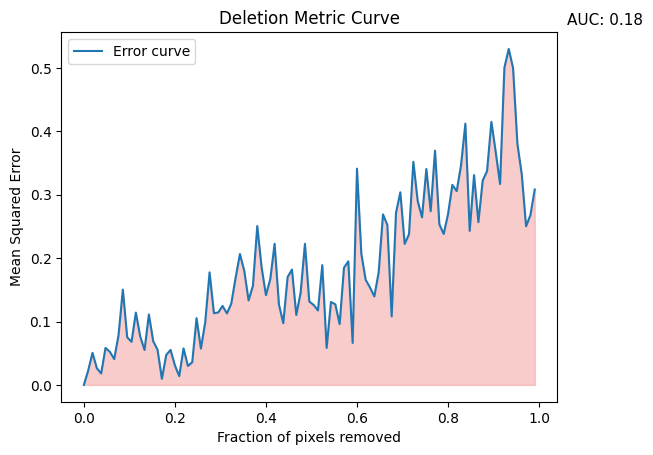

Errors: [0.0, 0.022578847, 0.050580174, 0.0263582, 0.018141055, 0.058375303, 0.052258298, 0.040752925, 0.07847611, 0.15029342, 0.075061, 0.06796846, 0.11400402, 0.07656257, 0.055108696, 0.11114428, 0.069027245, 0.055507865, 0.009653584, 0.04724688, 0.055223774, 0.030891296, 0.013957563, 0.057560872, 0.029930394, 0.035807166, 0.10524206, 0.057314884, 0.09900106, 0.17751081, 0.11304872, 0.11429884, 0.12461804, 0.1127307, 0.12803057, 0.16871421, 0.20646338, 0.17991242, 0.13323423, 0.1563315, 0.25049585, 0.18535188, 0.14159782, 0.16665733, 0.2224927, 0.12673528, 0.09737482, 0.17010725, 0.18192479, 0.11032852, 0.14519618, 0.22247183, 0.13154937, 0.12615395, 0.117407836, 0.18894891, 0.05837288, 0.13076235, 0.12716682, 0.095963426, 0.18490739, 0.1948781, 0.06622919, 0.34098026, 0.206845, 0.16581313, 0.15368024, 0.13954766, 0.17748761, 0.26895276, 0.2522749, 0.10814736, 0.27140003, 0.30367562, 0.2223056, 0.23767579, 0.3518683, 0.2902134, 0.2642129, 0.34046867, 0.273994, 0.36943954, 0.253149, 0

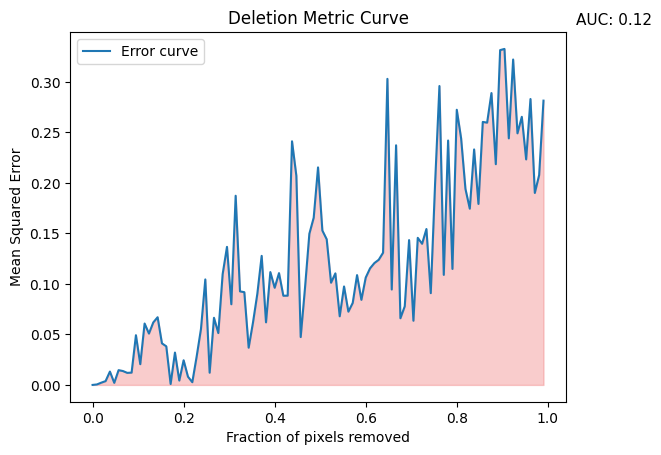

Errors: [0.0, 0.0004635731, 0.002219854, 0.0037720897, 0.013224372, 0.00206192, 0.014623363, 0.013744536, 0.011936906, 0.0121823875, 0.049212363, 0.020534497, 0.06077654, 0.050836537, 0.06185959, 0.067012325, 0.04114947, 0.0382107, 0.00094051287, 0.03202219, 0.0043041627, 0.024414062, 0.008166123, 0.0026902484, 0.027988687, 0.055399336, 0.104446135, 0.012096515, 0.066479824, 0.05133246, 0.1096985, 0.13668472, 0.07986339, 0.18729319, 0.092612825, 0.09181404, 0.0368636, 0.06184755, 0.090238236, 0.12777553, 0.061967023, 0.11173699, 0.096186236, 0.110701874, 0.08829204, 0.08837771, 0.24120569, 0.20705873, 0.047386076, 0.09632907, 0.1496697, 0.16553709, 0.21536563, 0.15284052, 0.14418408, 0.10117736, 0.11044901, 0.06795143, 0.09746524, 0.072539434, 0.08118103, 0.10870169, 0.08422801, 0.1062885, 0.11544573, 0.12065174, 0.123917304, 0.13088773, 0.30301926, 0.094474524, 0.23725915, 0.06599005, 0.077819206, 0.14339013, 0.06354629, 0.14562981, 0.13973525, 0.1543646, 0.09085472, 0.19956973, 0.295

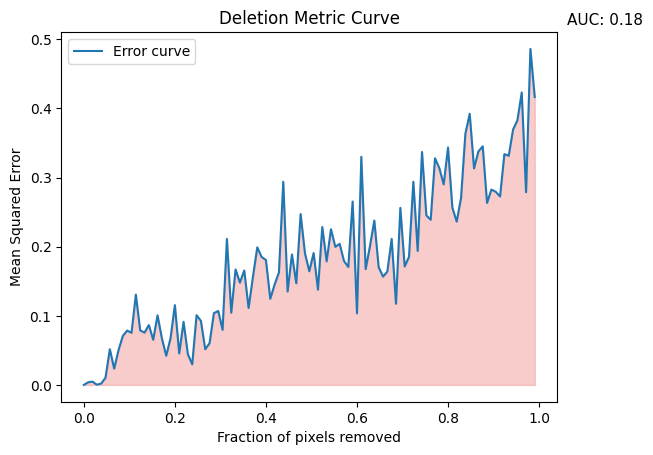

Errors: [0.0, 0.003820994, 0.0047343383, 0.00028061768, 0.0019149951, 0.010525679, 0.051689703, 0.023615956, 0.050358, 0.07099588, 0.07866697, 0.07540151, 0.13061522, 0.07883136, 0.075701326, 0.08655851, 0.065286994, 0.100675255, 0.06758239, 0.04218411, 0.06761419, 0.11542872, 0.04555106, 0.0912661, 0.0443359, 0.029837454, 0.100809425, 0.09272394, 0.051635403, 0.060357712, 0.10385314, 0.10697541, 0.0796622, 0.21113665, 0.1044916, 0.16702282, 0.14791682, 0.16556077, 0.11133202, 0.15616147, 0.19898447, 0.18514834, 0.18068855, 0.12459102, 0.14508937, 0.16282377, 0.29389635, 0.13514473, 0.18866247, 0.14706309, 0.24718675, 0.19063905, 0.16439453, 0.19083746, 0.1378635, 0.22840804, 0.17875189, 0.22526763, 0.19981158, 0.20408046, 0.17930883, 0.17066354, 0.26535523, 0.103539355, 0.32998845, 0.16753408, 0.20085326, 0.23774216, 0.17042437, 0.15669492, 0.1640187, 0.21116048, 0.117401466, 0.256126, 0.17140293, 0.18529086, 0.29389563, 0.19377355, 0.33695492, 0.24517833, 0.23894699, 0.3279275, 0.313

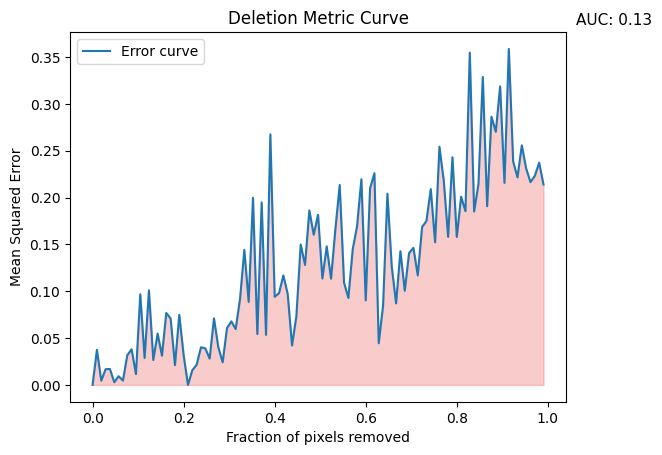

Errors: [0.0, 0.037513163, 0.0045216666, 0.01678295, 0.01704219, 0.0028367005, 0.009339841, 0.004666015, 0.03166596, 0.038062595, 0.011587428, 0.09677209, 0.028758746, 0.100962624, 0.026612306, 0.05485679, 0.031255506, 0.076841354, 0.07092297, 0.021132924, 0.074846186, 0.03183419, 7.734147e-06, 0.015734266, 0.021502854, 0.040206134, 0.03906494, 0.028093887, 0.07104588, 0.04029587, 0.0241438, 0.060696922, 0.067860596, 0.059683774, 0.09137122, 0.14416942, 0.08867977, 0.19981574, 0.054323357, 0.19487184, 0.053431716, 0.267553, 0.09414841, 0.09793995, 0.11694297, 0.09717353, 0.042137653, 0.07321989, 0.1499014, 0.12813297, 0.18628512, 0.16039571, 0.18163641, 0.11359577, 0.14793603, 0.11338007, 0.16633473, 0.21347865, 0.10911697, 0.092806, 0.14492092, 0.16943786, 0.21960823, 0.0902987, 0.20987229, 0.22601187, 0.04452501, 0.08476081, 0.20418857, 0.12640533, 0.087057896, 0.14278044, 0.10054019, 0.14082776, 0.14637415, 0.11691492, 0.16860063, 0.17504877, 0.20911294, 0.15226182, 0.25435716, 0.21

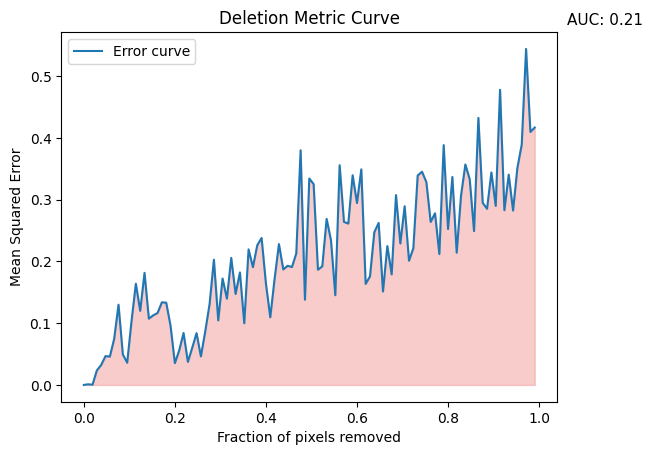

Errors: [0.0, 0.001030798, 0.00031183846, 0.023452537, 0.032327022, 0.046718214, 0.045887165, 0.07469044, 0.13000725, 0.04940629, 0.035961717, 0.10342477, 0.16395439, 0.120056495, 0.18161334, 0.107354805, 0.112776406, 0.11650612, 0.13384847, 0.13331753, 0.09587083, 0.03535089, 0.05590351, 0.08422835, 0.03729584, 0.06024782, 0.08391672, 0.0461958, 0.08663752, 0.130819, 0.20295322, 0.10458526, 0.17241776, 0.13976774, 0.20576923, 0.1473851, 0.18228272, 0.09992622, 0.21959153, 0.19084017, 0.22635522, 0.23814014, 0.16430967, 0.10958016, 0.17190257, 0.22820657, 0.1871304, 0.19303733, 0.1910501, 0.2131433, 0.38019317, 0.13812912, 0.33447254, 0.32538337, 0.18666555, 0.19227047, 0.26898643, 0.23467556, 0.14534512, 0.3559928, 0.26418167, 0.26145467, 0.3397544, 0.29474697, 0.34934774, 0.16372597, 0.17584975, 0.24751034, 0.26247758, 0.15133728, 0.22499664, 0.17915063, 0.3076078, 0.22918786, 0.28953826, 0.20128982, 0.22157888, 0.3393347, 0.3454793, 0.32870322, 0.26409945, 0.27818057, 0.21202962, 0.

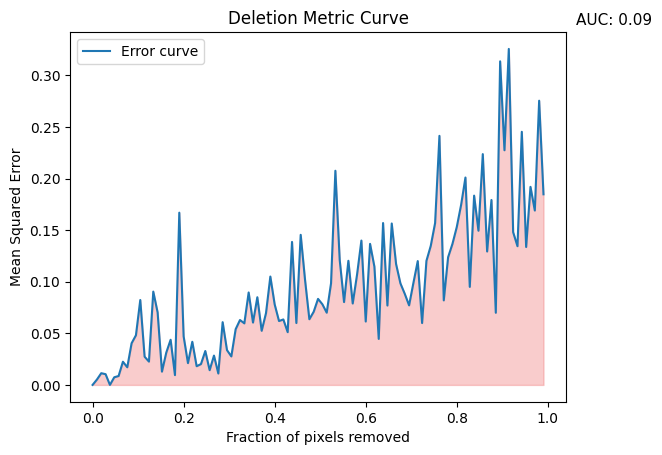

Errors: [0.0, 0.0051862528, 0.011367637, 0.010412197, 1.252175e-05, 0.0074205166, 0.0086376835, 0.022486512, 0.01710618, 0.04038877, 0.048130523, 0.0822973, 0.027345853, 0.022610815, 0.09043315, 0.07032751, 0.0128924, 0.0313646, 0.04376889, 0.009502989, 0.16694283, 0.047066294, 0.021119894, 0.04181804, 0.018129947, 0.020209415, 0.032874893, 0.0142948795, 0.028432742, 0.011085695, 0.06081287, 0.03374261, 0.027633827, 0.054022726, 0.06291428, 0.05967, 0.08959609, 0.060461257, 0.084973484, 0.052452017, 0.06963707, 0.105029576, 0.07801517, 0.061922844, 0.063463315, 0.051116154, 0.13859014, 0.059995916, 0.14547287, 0.101901144, 0.06365654, 0.07094621, 0.08339521, 0.07820044, 0.070012614, 0.098538406, 0.20757519, 0.121021286, 0.08030147, 0.120321155, 0.07893509, 0.10694305, 0.13991913, 0.061458256, 0.13670851, 0.11465253, 0.044599093, 0.15690516, 0.07695113, 0.15646693, 0.11717455, 0.0984469, 0.08832676, 0.077120274, 0.098917656, 0.12002506, 0.059964854, 0.12022805, 0.13480635, 0.15687877, 0

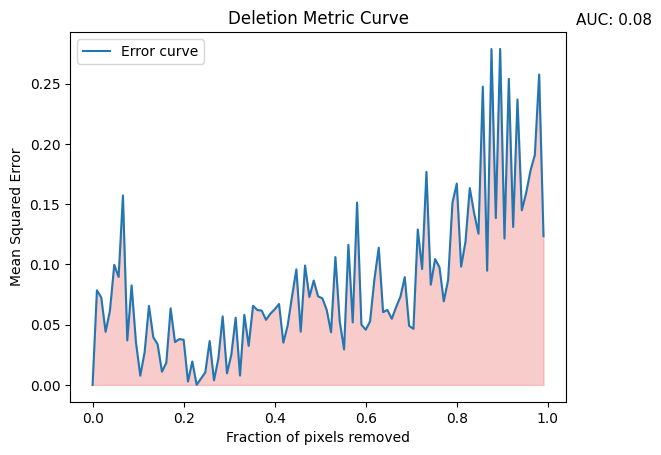

Errors: [0.0, 0.07848422, 0.07246679, 0.04408277, 0.061589513, 0.099616475, 0.089552596, 0.15717632, 0.03693947, 0.08259893, 0.035427697, 0.0077205715, 0.027115852, 0.06557683, 0.03953188, 0.03366737, 0.0109698735, 0.018352484, 0.06353033, 0.035551842, 0.038032528, 0.037469927, 0.0028393422, 0.019479252, 7.12822e-05, 0.0052328357, 0.010458593, 0.036418453, 0.0038514137, 0.021795172, 0.056857035, 0.0096458085, 0.025126016, 0.055785023, 0.007786492, 0.058162417, 0.032385305, 0.06565174, 0.06216256, 0.06164683, 0.05400696, 0.059078883, 0.06271664, 0.06708959, 0.035077527, 0.049458344, 0.0734583, 0.09587309, 0.04414975, 0.099062316, 0.07295195, 0.08659956, 0.07350596, 0.07184318, 0.06219454, 0.043687448, 0.10602504, 0.05282987, 0.029462144, 0.116253905, 0.051874, 0.1512522, 0.049976185, 0.04580694, 0.05273713, 0.08760418, 0.113846295, 0.060356747, 0.062203016, 0.054882087, 0.06451146, 0.07319205, 0.08943855, 0.04907964, 0.04654111, 0.12896933, 0.0961489, 0.17676654, 0.08310203, 0.10439894,

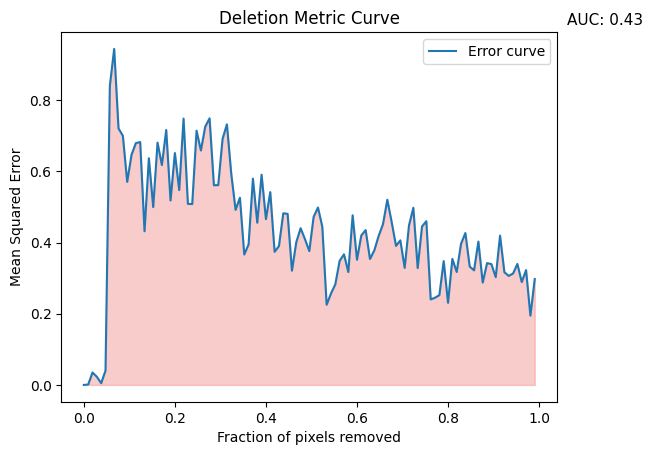

Errors: [0.0, 0.0010468429, 0.03495794, 0.022923183, 0.004876427, 0.0401745, 0.84086823, 0.9443552, 0.7207061, 0.70032746, 0.5707457, 0.6469804, 0.67962986, 0.68267804, 0.43195233, 0.6372647, 0.49976644, 0.6810446, 0.61800796, 0.7166101, 0.5184368, 0.6517141, 0.5477212, 0.7485605, 0.50903714, 0.5082457, 0.7144785, 0.65885055, 0.72586226, 0.7492979, 0.5611863, 0.56158173, 0.69159806, 0.7323703, 0.5936322, 0.49205065, 0.5261161, 0.36659372, 0.39494142, 0.5797578, 0.45594677, 0.59073246, 0.46610856, 0.5419231, 0.3741588, 0.39028436, 0.48229644, 0.4809019, 0.32119164, 0.40112144, 0.440524, 0.40972275, 0.3761117, 0.47240797, 0.4986789, 0.44475073, 0.22545451, 0.25688127, 0.2827231, 0.34880027, 0.36711818, 0.31737393, 0.47678354, 0.35187122, 0.42021745, 0.43515828, 0.3539266, 0.37824407, 0.41892222, 0.45177683, 0.52050984, 0.45766857, 0.39081508, 0.40625805, 0.32895595, 0.44865245, 0.4979202, 0.32839924, 0.44550082, 0.46019614, 0.2403063, 0.24518241, 0.25235713, 0.34804273, 0.23091546, 0.354

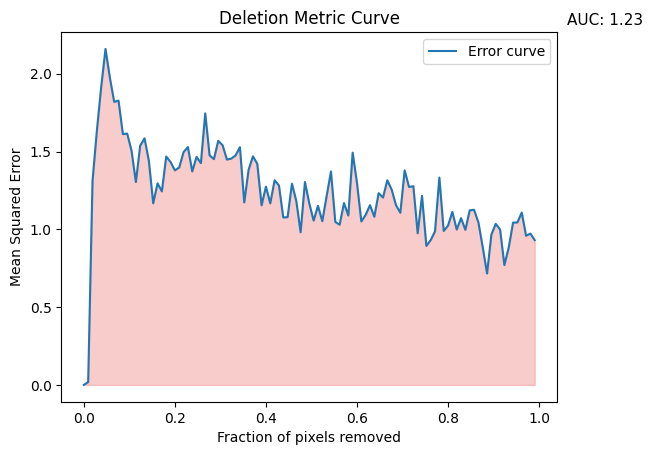

Errors: [0.0, 0.018552838, 1.3092891, 1.632085, 1.9137533, 2.1594267, 1.9754063, 1.8193105, 1.827375, 1.6121588, 1.6151781, 1.5056013, 1.3040469, 1.5379356, 1.5847543, 1.4392455, 1.1673089, 1.2955637, 1.2436935, 1.4678802, 1.4324529, 1.379077, 1.3977886, 1.4959297, 1.5289191, 1.3722924, 1.4655913, 1.4255532, 1.7451713, 1.4760206, 1.4509611, 1.568464, 1.5405493, 1.4483715, 1.4545467, 1.4750298, 1.5280937, 1.1729318, 1.382693, 1.4688755, 1.4217396, 1.154491, 1.2745168, 1.1671209, 1.3153174, 1.2818264, 1.0763034, 1.0783136, 1.2934906, 1.1824981, 0.9811431, 1.3043813, 1.166304, 1.0559986, 1.1513401, 1.0523701, 1.2135314, 1.3716006, 1.047326, 1.0297406, 1.1687728, 1.0886673, 1.4926332, 1.2983631, 1.0503874, 1.0928353, 1.1554381, 1.0808138, 1.2323533, 1.2041354, 1.3153975, 1.2550893, 1.1550785, 1.1065115, 1.3792295, 1.2721695, 1.2772974, 0.9748866, 1.21498, 0.8934939, 0.9311314, 0.9872514, 1.3325092, 0.98963195, 1.0239415, 1.1120182, 0.9987319, 1.0716907, 0.9965601, 1.1219499, 1.1258488, 1.0

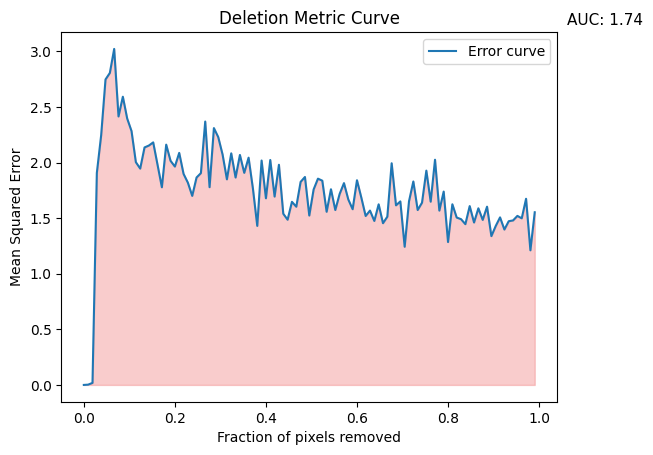

Errors: [0.0, 0.002433425, 0.018403795, 1.9063318, 2.2464716, 2.7473173, 2.8056843, 3.0219314, 2.4146225, 2.5921001, 2.3959959, 2.283182, 2.0034122, 1.9456547, 2.135886, 2.1528754, 2.1813138, 1.9800779, 1.7777293, 2.1611662, 2.015696, 1.9640648, 2.0869656, 1.8982244, 1.8186564, 1.7002376, 1.8654671, 1.904786, 2.3688033, 1.7783377, 2.309941, 2.2289772, 2.0724328, 1.8492002, 2.0830681, 1.8652977, 2.0684202, 1.9075108, 2.0438874, 1.7658728, 1.4302089, 2.0183089, 1.6786602, 2.0228858, 1.6939511, 1.9800239, 1.5395956, 1.4859595, 1.6468083, 1.6028153, 1.825952, 1.8702755, 1.5235422, 1.7579029, 1.8550917, 1.8369087, 1.5574383, 1.7598937, 1.5730178, 1.7173547, 1.8149762, 1.6678007, 1.580259, 1.8409756, 1.6852348, 1.5194441, 1.568018, 1.4748126, 1.6242883, 1.4544793, 1.5130564, 1.9936001, 1.6151927, 1.6505562, 1.2426214, 1.651489, 1.8298621, 1.573055, 1.6390604, 1.9272232, 1.6480528, 2.02528, 1.5679144, 1.7387583, 1.2850901, 1.62479, 1.5051804, 1.4909049, 1.4458425, 1.6083949, 1.4607936, 1.5884

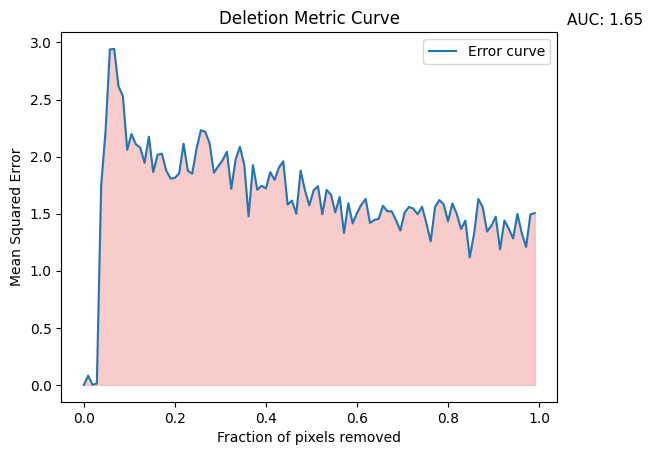

Errors: [0.0, 0.081395365, 0.0010690952, 0.01253173, 1.75092, 2.219223, 2.938933, 2.9433346, 2.6142662, 2.5324435, 2.060971, 2.1987216, 2.1075518, 2.0788317, 1.9463948, 2.1749773, 1.8640491, 2.0166261, 2.025877, 1.8774037, 1.8083425, 1.8135729, 1.854753, 2.1128762, 1.8748258, 1.850835, 2.072807, 2.2310786, 2.217348, 2.1170394, 1.8591274, 1.9164686, 1.9674919, 2.0430877, 1.7180105, 1.9733862, 2.0862207, 1.9277339, 1.4766802, 1.9256973, 1.7097102, 1.7450687, 1.7214273, 1.8643942, 1.7962743, 1.9048913, 1.9588842, 1.579106, 1.6146821, 1.4988052, 1.8773022, 1.7042619, 1.5727046, 1.7054224, 1.7418746, 1.4952542, 1.7080479, 1.6665797, 1.5121567, 1.6470193, 1.3305374, 1.5913726, 1.4153155, 1.504519, 1.5794697, 1.628899, 1.419417, 1.4456584, 1.4549992, 1.5693182, 1.5218164, 1.5209926, 1.4441074, 1.3521894, 1.511996, 1.5595021, 1.543909, 1.4949117, 1.5616891, 1.4164811, 1.2578329, 1.5579605, 1.6199381, 1.5816188, 1.4329683, 1.5902209, 1.4998019, 1.3666915, 1.4397907, 1.1168731, 1.3225036, 1.6288

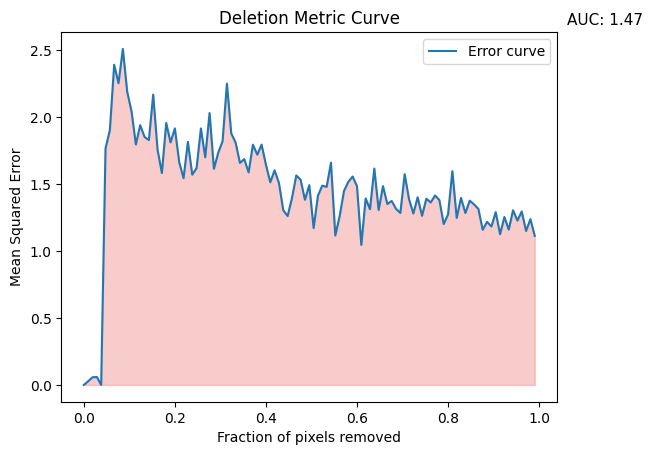

Errors: [0.0, 0.027451193, 0.056907598, 0.05943089, 5.5877015e-05, 1.765383, 1.9007671, 2.3892558, 2.252397, 2.5075433, 2.187893, 2.042381, 1.7946217, 1.938562, 1.8508765, 1.8273832, 2.1670911, 1.7562248, 1.5814536, 1.9546484, 1.8098223, 1.914531, 1.6623937, 1.5426549, 1.8141692, 1.5690204, 1.6178968, 1.9142084, 1.6989778, 2.029051, 1.6132905, 1.7329882, 1.8185056, 2.2486978, 1.8774903, 1.8092797, 1.6570381, 1.685349, 1.5859425, 1.7926563, 1.7186725, 1.7932485, 1.6432989, 1.5121503, 1.6017692, 1.5074513, 1.3034819, 1.2602971, 1.393382, 1.5631605, 1.5307318, 1.382045, 1.4911722, 1.1703647, 1.4127951, 1.4874119, 1.4779747, 1.6588807, 1.1151879, 1.2592705, 1.4472519, 1.5155746, 1.5554243, 1.4831234, 1.0452665, 1.391819, 1.311225, 1.6147348, 1.3057942, 1.4837085, 1.350171, 1.3730835, 1.3143357, 1.2833971, 1.5728418, 1.3866922, 1.2794831, 1.4005355, 1.2626324, 1.3893483, 1.3615414, 1.4136329, 1.3800694, 1.2010672, 1.2718759, 1.5953467, 1.2467682, 1.3953999, 1.2828894, 1.3751423, 1.3474411, 

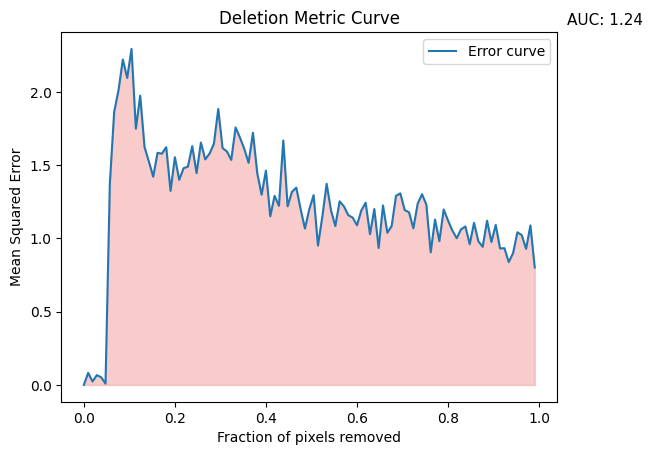

Errors: [0.0, 0.08241557, 0.02359911, 0.06702047, 0.052185297, 0.008974061, 1.3749181, 1.8645208, 2.0118363, 2.221132, 2.095463, 2.2932143, 1.7484964, 1.974366, 1.6229212, 1.5250714, 1.4211011, 1.5841115, 1.5780902, 1.6228967, 1.3243974, 1.5541184, 1.3999611, 1.4790064, 1.489933, 1.6299067, 1.4455739, 1.6543108, 1.5393558, 1.579209, 1.6465958, 1.8832431, 1.6161733, 1.5935069, 1.5355079, 1.7575132, 1.6885905, 1.6117837, 1.5160387, 1.7208227, 1.4453205, 1.2978907, 1.4628218, 1.1513913, 1.2903471, 1.22238, 1.6683642, 1.2191628, 1.317739, 1.3465, 1.1998564, 1.0670912, 1.1990632, 1.2953813, 0.9513024, 1.146393, 1.372934, 1.1922716, 1.0842122, 1.2532072, 1.2180525, 1.1583049, 1.1421199, 1.0898079, 1.1908225, 1.2437565, 1.0288908, 1.2004515, 0.934641, 1.2250904, 1.0384153, 1.0849847, 1.2904248, 1.3075461, 1.1934658, 1.178713, 1.0690999, 1.23692, 1.3018721, 1.2302074, 0.90493536, 1.1284063, 0.98126554, 1.1975085, 1.1220009, 1.053875, 1.0012463, 1.0620947, 1.081408, 0.960324, 1.106202, 0.980128

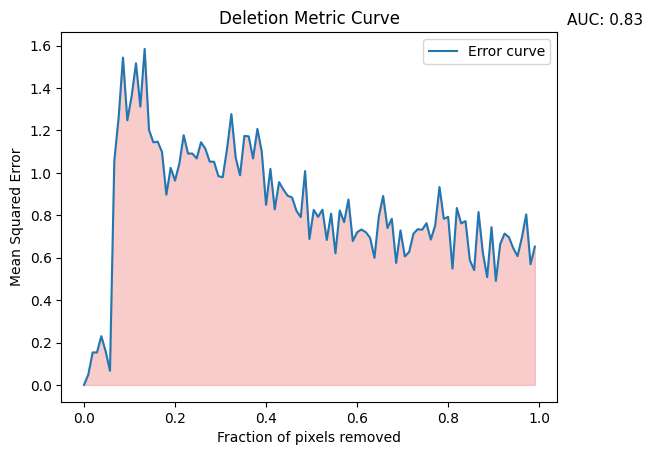

Errors: [0.0, 0.048645683, 0.15310894, 0.1532329, 0.22987583, 0.1585318, 0.06674285, 1.0574623, 1.2620832, 1.5435116, 1.2480307, 1.362092, 1.516582, 1.3122696, 1.5843395, 1.202925, 1.1439133, 1.1472592, 1.0988783, 0.8974813, 1.0235456, 0.9636203, 1.044204, 1.1776543, 1.0910743, 1.0910718, 1.0680776, 1.1443117, 1.1134732, 1.0529711, 1.0522656, 0.9845122, 0.9795159, 1.1133273, 1.2769814, 1.0705721, 0.98848385, 1.1740007, 1.1721445, 1.0676397, 1.2071153, 1.1008303, 0.8492235, 1.0187714, 0.8278125, 0.95643795, 0.9209751, 0.8919737, 0.883998, 0.82134956, 0.79114074, 1.0084877, 0.6883117, 0.82543457, 0.7925068, 0.82639205, 0.6836392, 0.8077485, 0.6207394, 0.8223016, 0.7675582, 0.87429065, 0.67830133, 0.7200025, 0.73277104, 0.72037435, 0.69365495, 0.5993813, 0.79320586, 0.89106196, 0.74001527, 0.78368163, 0.57546145, 0.72853655, 0.60619307, 0.62689817, 0.7134959, 0.73451537, 0.73169893, 0.7624592, 0.6854132, 0.7516908, 0.9332448, 0.7833231, 0.79256326, 0.5483222, 0.83424455, 0.7617775, 0.7724

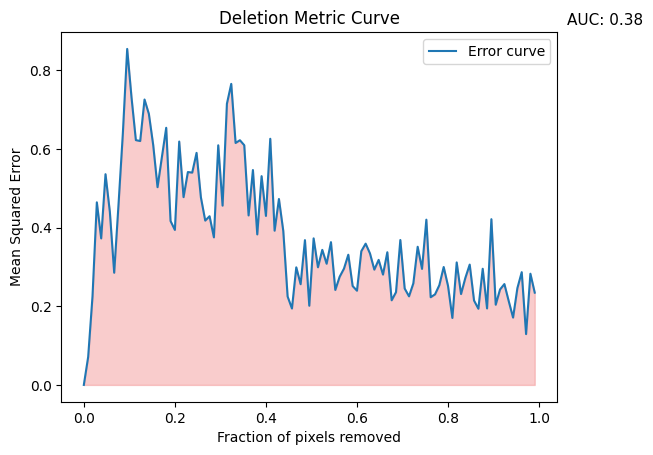

Errors: [0.0, 0.071164675, 0.22508849, 0.46440914, 0.37263286, 0.53594685, 0.4401807, 0.28532457, 0.45878178, 0.6395676, 0.85457194, 0.73101705, 0.62263167, 0.62032807, 0.7259237, 0.6893606, 0.610181, 0.5029447, 0.57924247, 0.6540159, 0.4168792, 0.3942195, 0.6190042, 0.47763503, 0.5414236, 0.5400255, 0.59020436, 0.47715664, 0.4179624, 0.42907774, 0.3753513, 0.6094805, 0.4559765, 0.7150563, 0.76565737, 0.6153688, 0.62234294, 0.6096938, 0.4310766, 0.54656065, 0.3828396, 0.5309862, 0.4298446, 0.626065, 0.39226973, 0.47286215, 0.39169595, 0.22493169, 0.19434044, 0.29910278, 0.2561182, 0.36825785, 0.20141017, 0.37274456, 0.29920933, 0.34348607, 0.30822545, 0.3631016, 0.24152154, 0.27504298, 0.29574993, 0.3311498, 0.25151554, 0.23964006, 0.34009328, 0.35929528, 0.33433327, 0.29325786, 0.3180133, 0.28063783, 0.33744282, 0.21529543, 0.23590022, 0.36859503, 0.24522804, 0.22531788, 0.2583172, 0.3513641, 0.29514086, 0.4202925, 0.22306149, 0.23034051, 0.25377545, 0.29990992, 0.251844, 0.17031682, 

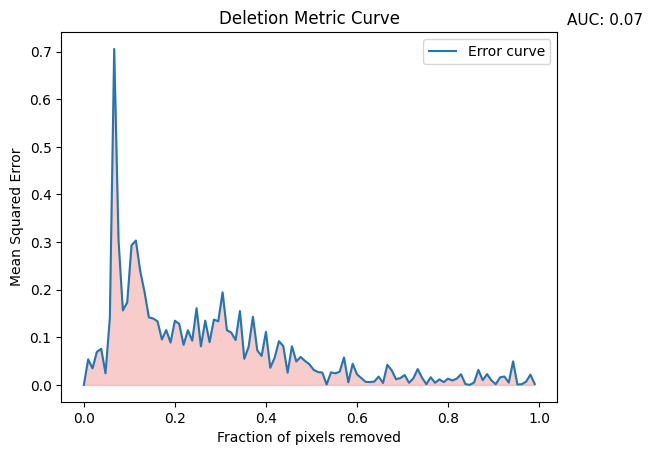

Errors: [0.0, 0.053737827, 0.034838904, 0.06927762, 0.07596026, 0.024457779, 0.14152269, 0.7055608, 0.30408818, 0.15649688, 0.1731814, 0.29323462, 0.30322552, 0.23924643, 0.19495557, 0.14190409, 0.1394684, 0.13358204, 0.09551387, 0.11523116, 0.08906222, 0.13487875, 0.12819442, 0.084180616, 0.11489303, 0.09301944, 0.16106874, 0.081155956, 0.13505341, 0.089772806, 0.13732049, 0.13355964, 0.19441296, 0.11485198, 0.10991299, 0.09423687, 0.15507396, 0.054957405, 0.079736166, 0.14313745, 0.07260771, 0.060891856, 0.11138891, 0.036133323, 0.057033263, 0.092031114, 0.08141284, 0.025822716, 0.081244074, 0.049235318, 0.058706187, 0.05047433, 0.043650355, 0.03169872, 0.027013833, 0.026023634, 0.00088718394, 0.026439704, 0.02439667, 0.027785236, 0.057635143, 0.0054165293, 0.044543628, 0.022393296, 0.014372606, 0.0064389952, 0.005945133, 0.0071770973, 0.017599063, 0.004128077, 0.042213645, 0.030833997, 0.011973663, 0.014454813, 0.020777853, 0.0045047044, 0.013925808, 0.033303946, 0.015236499, 0.0015

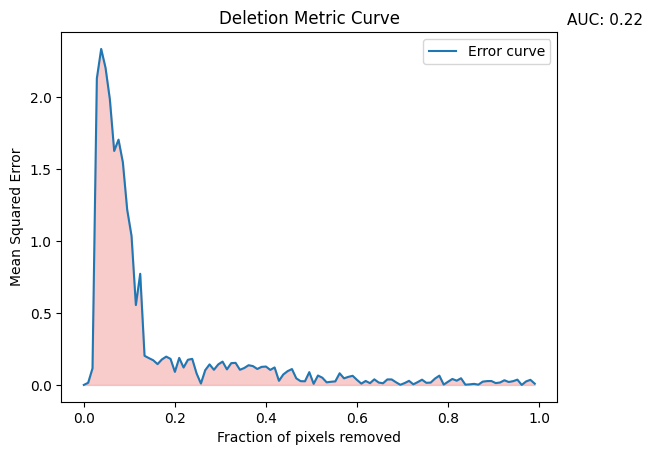

Errors: [0.0, 0.015084054, 0.11540442, 2.1321344, 2.3373165, 2.206613, 1.9874793, 1.6276739, 1.7062379, 1.5483786, 1.2189133, 1.0367391, 0.5556241, 0.77322906, 0.2026771, 0.1867047, 0.17180452, 0.1448499, 0.1772918, 0.19697195, 0.18105231, 0.09098089, 0.18796177, 0.12119042, 0.17504503, 0.18138166, 0.08030087, 0.009796322, 0.10276053, 0.14295802, 0.10533334, 0.1428632, 0.16223186, 0.10833146, 0.15156265, 0.15354034, 0.105441235, 0.11786937, 0.1371586, 0.13113558, 0.11110486, 0.1255634, 0.12797752, 0.104625896, 0.12173808, 0.028617326, 0.07270951, 0.09587475, 0.110555045, 0.045758758, 0.026254643, 0.025508367, 0.08894052, 0.007874786, 0.06543535, 0.050471544, 0.018147832, 0.02195509, 0.024820868, 0.08103321, 0.045892373, 0.05605988, 0.06348164, 0.035064623, 0.009195175, 0.027602408, 0.012354964, 0.038904555, 0.016883885, 0.011581885, 0.038379177, 0.038220536, 0.018563775, 0.0009892395, 0.013151651, 0.028462982, 0.0042643375, 0.01962958, 0.036473572, 0.014686716, 0.016469842, 0.044402692

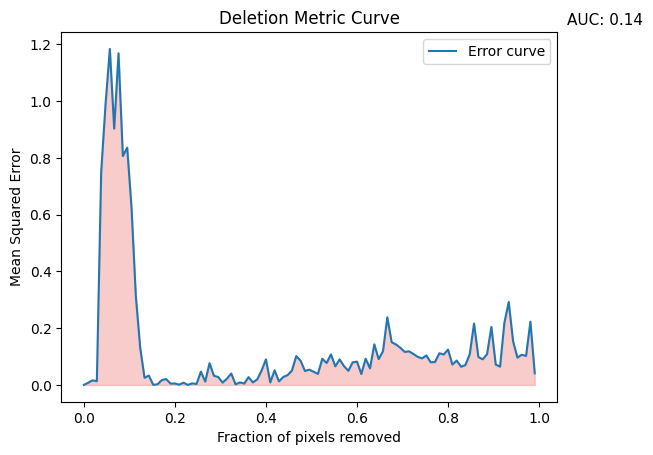

Errors: [0.0, 0.0077315527, 0.01615353, 0.013020383, 0.74935126, 0.9879395, 1.1842892, 0.9034886, 1.16886, 0.806626, 0.8363776, 0.62513536, 0.3118423, 0.13128412, 0.025260432, 0.03295643, 0.00027131833, 0.0023759042, 0.017238555, 0.020555992, 0.004748572, 0.0051815496, 0.0008566941, 0.008004395, 6.770299e-05, 0.005474624, 0.003509291, 0.04682851, 0.0118883485, 0.076827474, 0.032356992, 0.027781222, 0.008232617, 0.02202074, 0.040272612, 0.0020065738, 0.00889832, 0.00483124, 0.027547771, 0.008761123, 0.019783236, 0.050818957, 0.09023853, 0.008780504, 0.051686883, 0.012450738, 0.02803745, 0.03460114, 0.05078623, 0.10182536, 0.08497043, 0.049155045, 0.05393634, 0.046350483, 0.0389772, 0.09231109, 0.07724569, 0.1076614, 0.0655063, 0.09006564, 0.06640546, 0.04982695, 0.07953755, 0.0821917, 0.03866542, 0.09237601, 0.058295317, 0.14301996, 0.090959094, 0.11893275, 0.23846655, 0.15033992, 0.14255634, 0.13089861, 0.11644501, 0.118423104, 0.109276436, 0.099142745, 0.09352958, 0.10386743, 0.079718

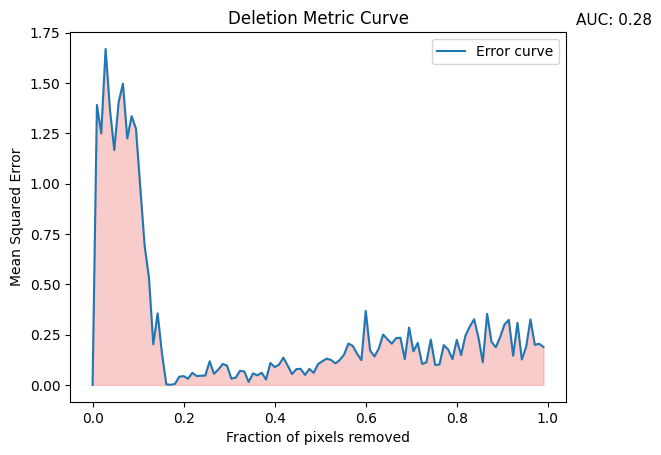

Errors: [0.0, 1.3909357, 1.2490764, 1.669246, 1.3698518, 1.1671789, 1.4032856, 1.4966428, 1.224393, 1.3352002, 1.2737402, 0.9812043, 0.69239485, 0.5328577, 0.20171042, 0.3556044, 0.1564699, 0.0034349181, 0.00065854157, 0.005180348, 0.041154064, 0.04390152, 0.031149544, 0.0600628, 0.04431266, 0.045705833, 0.04672883, 0.11729586, 0.055500112, 0.076631986, 0.10392476, 0.09622084, 0.031501766, 0.036039572, 0.070501745, 0.06673438, 0.01485219, 0.057525642, 0.047508743, 0.060573105, 0.027107649, 0.109027684, 0.08913211, 0.10056817, 0.13544816, 0.09598492, 0.054082565, 0.07883919, 0.07968037, 0.049703825, 0.07951557, 0.060285043, 0.103605956, 0.11800512, 0.130742, 0.123919696, 0.1071418, 0.1237305, 0.15059128, 0.20535792, 0.19426267, 0.15520026, 0.1228886, 0.36768094, 0.17163932, 0.14157288, 0.18014286, 0.25041217, 0.22726569, 0.20506123, 0.2324971, 0.23464859, 0.12830865, 0.28506172, 0.16664137, 0.2083234, 0.1045027, 0.11259721, 0.22538036, 0.09951033, 0.10112125, 0.19780189, 0.17661391, 0.1

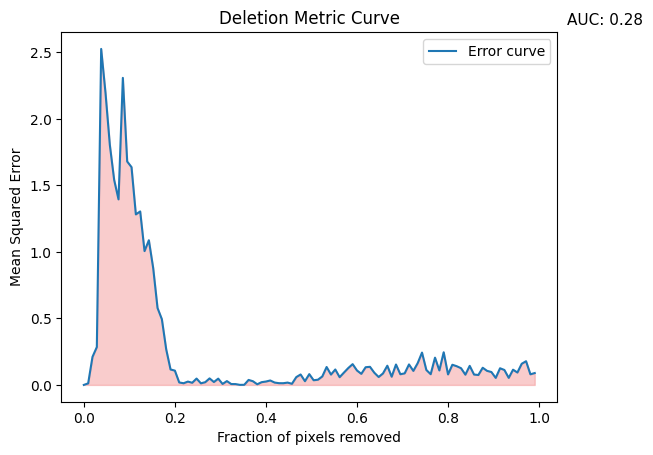

Errors: [0.0, 0.0115873255, 0.2110839, 0.2847012, 2.5264218, 2.1960554, 1.8042653, 1.5410843, 1.395289, 2.3087902, 1.6799018, 1.6375605, 1.2823063, 1.304412, 1.0061762, 1.0879611, 0.8782182, 0.5783727, 0.49420458, 0.2674528, 0.11617872, 0.10750859, 0.018670933, 0.012599896, 0.025098208, 0.016326439, 0.0477569, 0.012034789, 0.02051308, 0.049050387, 0.021837045, 0.04731884, 0.007320589, 0.028805746, 0.0065102647, 0.006226486, 0.0003961272, 0.00089527667, 0.037549373, 0.027728394, 0.004809076, 0.02066429, 0.025440251, 0.033444673, 0.0179177, 0.013120008, 0.01290036, 0.017556231, 0.008542136, 0.058690187, 0.078550324, 0.0280815, 0.08114204, 0.03524813, 0.03920365, 0.063707225, 0.13476294, 0.077887796, 0.116021685, 0.058252785, 0.093099155, 0.12713298, 0.15625608, 0.10851076, 0.08336964, 0.13316001, 0.13610044, 0.09168542, 0.059535455, 0.08643251, 0.1444443, 0.06180866, 0.153449, 0.08033566, 0.08697413, 0.1541379, 0.1054616, 0.16363077, 0.24310751, 0.11228414, 0.080704376, 0.2049957, 0.1088

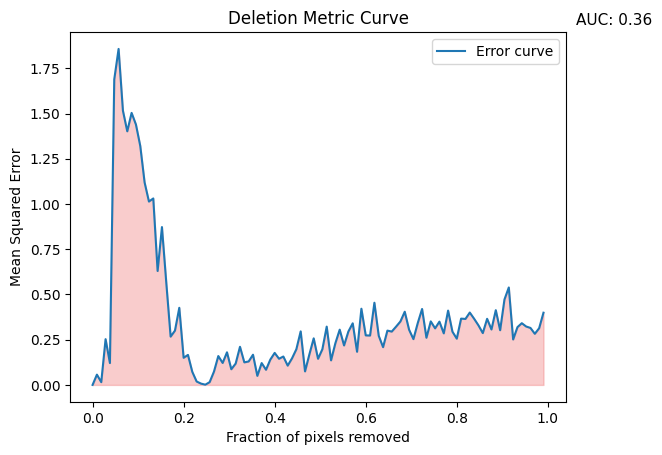

Errors: [0.0, 0.05685132, 0.015211347, 0.2528788, 0.12087962, 1.6886401, 1.8569461, 1.5156943, 1.4016132, 1.5034293, 1.4392695, 1.3204808, 1.1189289, 1.0134714, 1.0305403, 0.6296637, 0.8724157, 0.5648055, 0.26691857, 0.3001523, 0.42616412, 0.15002938, 0.16582474, 0.07224019, 0.018845076, 0.007363531, 0.0012632939, 0.015286481, 0.073735096, 0.15957083, 0.121377155, 0.18023556, 0.08664594, 0.118033215, 0.2106846, 0.12474398, 0.12974922, 0.16689491, 0.050092656, 0.120763354, 0.08375352, 0.14026581, 0.17695966, 0.14468381, 0.15700991, 0.10665476, 0.14691511, 0.19728138, 0.296035, 0.074721724, 0.1682974, 0.2574191, 0.1445603, 0.19712542, 0.32213837, 0.13572443, 0.23054859, 0.30540538, 0.21816851, 0.2952468, 0.3405178, 0.18330441, 0.42110002, 0.27383983, 0.27299097, 0.4541814, 0.27148214, 0.20873223, 0.3001245, 0.29482877, 0.32210508, 0.35068932, 0.40457475, 0.3050866, 0.25315067, 0.3418009, 0.4197424, 0.26072475, 0.3511058, 0.3127411, 0.34976852, 0.2849605, 0.41084743, 0.29428104, 0.2556788

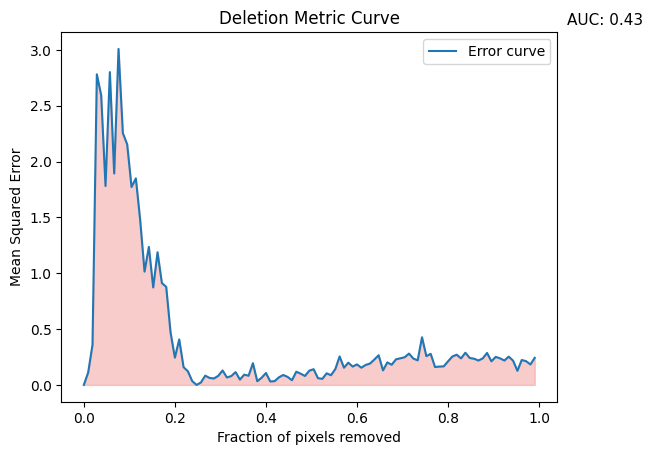

Errors: [0.0, 0.111069895, 0.35914093, 2.7812154, 2.5940447, 1.7812315, 2.8012974, 1.8933082, 3.0087605, 2.254872, 2.1541839, 1.772227, 1.849793, 1.4745799, 1.0146497, 1.2359968, 0.87285984, 1.1882792, 0.9124147, 0.87841725, 0.47056705, 0.24407671, 0.40732303, 0.15924776, 0.12197695, 0.03395957, 0.00010627017, 0.021930791, 0.082955115, 0.06278882, 0.05766199, 0.08128145, 0.1293484, 0.06709968, 0.079206474, 0.11498598, 0.047946844, 0.09212886, 0.082523815, 0.19460423, 0.0332588, 0.06425964, 0.10651909, 0.030893391, 0.033675157, 0.06826297, 0.0890554, 0.07196368, 0.04190443, 0.11839652, 0.10101536, 0.0802525, 0.12755592, 0.14080316, 0.06055345, 0.054456636, 0.103902005, 0.08711418, 0.14158149, 0.255398, 0.15429847, 0.19954534, 0.16453134, 0.1838272, 0.15458874, 0.17891526, 0.19146508, 0.2273082, 0.26582366, 0.1303615, 0.20176472, 0.18078631, 0.22935201, 0.23847866, 0.24822456, 0.28060916, 0.23591469, 0.220184, 0.42679083, 0.25751832, 0.2786464, 0.16025004, 0.16455203, 0.16633017, 0.21128

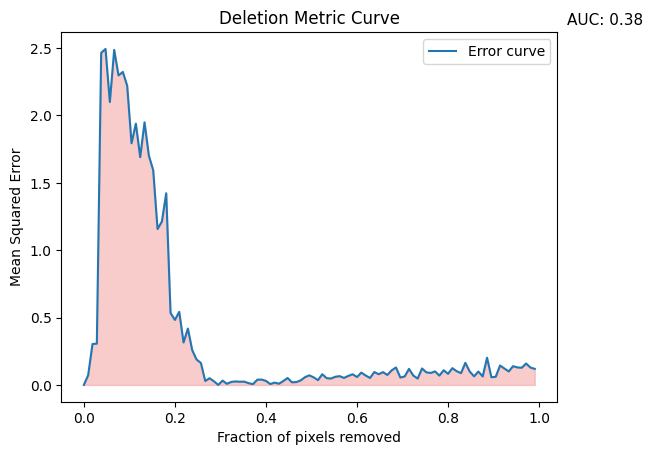

Errors: [0.0, 0.07233358, 0.303778, 0.30642512, 2.464832, 2.4938588, 2.0994904, 2.486384, 2.2973783, 2.3230114, 2.2202091, 1.7936608, 1.9393399, 1.690578, 1.9492222, 1.7016679, 1.5938368, 1.1569021, 1.2127081, 1.4226471, 0.5340659, 0.48255923, 0.5422523, 0.31511837, 0.41834027, 0.2578452, 0.18863964, 0.16284493, 0.029377084, 0.049642824, 0.027106196, 4.436035e-06, 0.032150697, 0.0082734665, 0.022455597, 0.025890881, 0.023666985, 0.024606703, 0.013002135, 0.0058315215, 0.038393006, 0.0399645, 0.029964268, 0.0066610617, 0.01723671, 0.009000402, 0.02869627, 0.05126755, 0.019509345, 0.02118616, 0.033394378, 0.057250176, 0.07128376, 0.05628506, 0.035652004, 0.07938452, 0.050395835, 0.047497936, 0.060606793, 0.065221764, 0.052086975, 0.0670995, 0.07916119, 0.058592845, 0.09131804, 0.06995503, 0.051705204, 0.095814146, 0.07940118, 0.09487162, 0.074050136, 0.108278416, 0.1296847, 0.055073835, 0.062638, 0.11898825, 0.069485456, 0.04728944, 0.12208897, 0.09358909, 0.088757955, 0.10029518, 0.0693

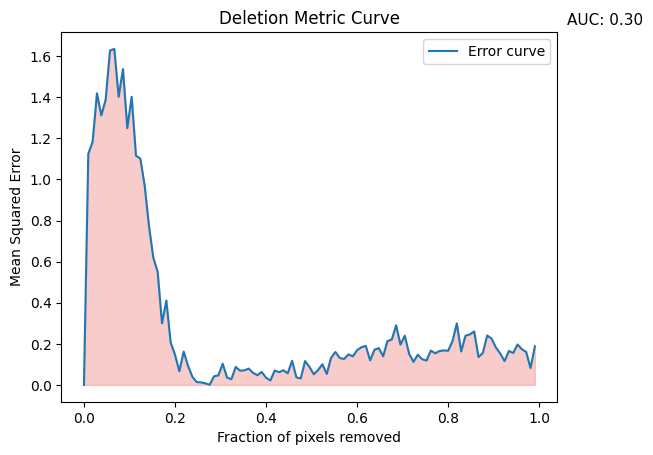

Errors: [0.0, 1.1245409, 1.1837376, 1.4194821, 1.3118607, 1.387928, 1.6271799, 1.6353426, 1.402543, 1.5374802, 1.2492671, 1.4023374, 1.1156092, 1.1018848, 0.97084415, 0.7732096, 0.61909705, 0.5504886, 0.2998141, 0.4106746, 0.2063868, 0.1466682, 0.0667979, 0.1623649, 0.09323379, 0.039685547, 0.013978189, 0.012550327, 0.0077945306, 0.00077147986, 0.042066082, 0.046668857, 0.103303276, 0.03601586, 0.027829446, 0.087837316, 0.06930803, 0.07139259, 0.07933314, 0.058859542, 0.047535095, 0.06303753, 0.03512711, 0.021891829, 0.07028168, 0.06211287, 0.07123666, 0.056672107, 0.11756965, 0.036839295, 0.031844825, 0.11621659, 0.08799651, 0.051722664, 0.07291228, 0.10042857, 0.053660724, 0.132662, 0.16021405, 0.13101824, 0.12639211, 0.148641, 0.13892478, 0.16911675, 0.18348104, 0.19021456, 0.11967522, 0.17137787, 0.17928728, 0.13952726, 0.2135143, 0.22122242, 0.2903175, 0.19616933, 0.23958655, 0.15158525, 0.11236053, 0.14706223, 0.12508398, 0.11863406, 0.16727163, 0.15407906, 0.16490214, 0.1680534,

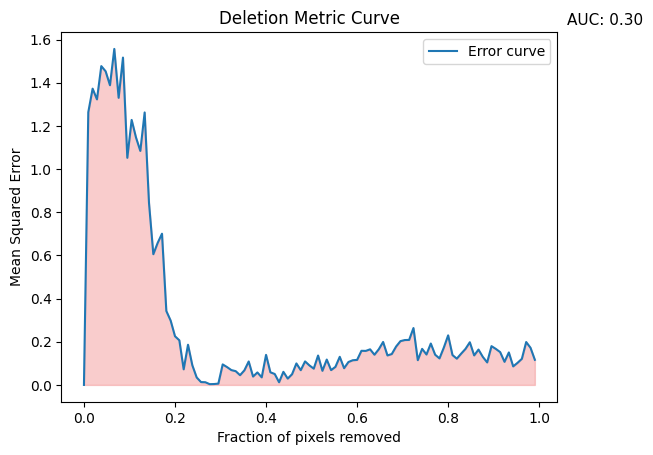

Errors: [0.0, 1.2633877, 1.3725191, 1.3228586, 1.4769447, 1.4528412, 1.3883752, 1.5565461, 1.3300886, 1.5164479, 1.0521401, 1.2277458, 1.146615, 1.0840464, 1.2622705, 0.8436481, 0.6055418, 0.6578598, 0.7005479, 0.34246874, 0.2977809, 0.22549254, 0.20672596, 0.07232031, 0.18623738, 0.09082389, 0.034615334, 0.0131969135, 0.012459998, 0.0035369005, 0.0040769195, 0.006096663, 0.095027216, 0.082705244, 0.06870071, 0.06375935, 0.045128886, 0.06750736, 0.10868059, 0.038824465, 0.057803947, 0.03506989, 0.13925529, 0.058499333, 0.050645504, 0.012422528, 0.060666207, 0.029290924, 0.04962322, 0.099549815, 0.068316616, 0.108997926, 0.09037842, 0.07546692, 0.1361812, 0.06542462, 0.11749195, 0.06852878, 0.08377881, 0.13026455, 0.07746757, 0.10617295, 0.114312544, 0.1158702, 0.15805823, 0.15759064, 0.16492188, 0.1399696, 0.16514213, 0.19903031, 0.13658755, 0.14313538, 0.17796746, 0.20282933, 0.2078976, 0.20850094, 0.2635223, 0.114635535, 0.1670411, 0.14091286, 0.19176836, 0.13997331, 0.12289374, 0.17

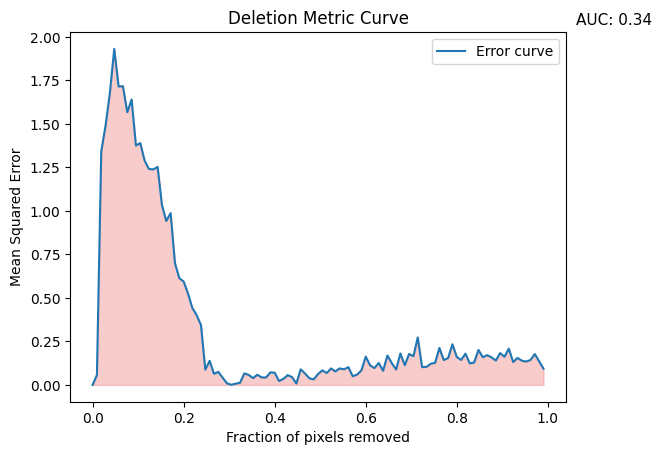

Errors: [0.0, 0.0569863, 1.3417879, 1.4915093, 1.6803082, 1.9309651, 1.7151349, 1.7168145, 1.5668428, 1.6401478, 1.3756708, 1.3902134, 1.2888848, 1.2410285, 1.2383273, 1.2527895, 1.0330381, 0.9420776, 0.9874819, 0.7002412, 0.61356175, 0.59445226, 0.52613664, 0.44263268, 0.4011049, 0.34452787, 0.087857805, 0.1383486, 0.06383499, 0.074994326, 0.04150649, 0.009092606, 0.00087742513, 0.0072657573, 0.012105432, 0.06619266, 0.057691965, 0.038998008, 0.058599252, 0.04298088, 0.042730004, 0.07218681, 0.07016195, 0.022695, 0.03479744, 0.0562111, 0.045179825, 0.007885643, 0.08971935, 0.06598074, 0.038104795, 0.031947825, 0.062641166, 0.08368957, 0.068496644, 0.094870776, 0.07765356, 0.09492354, 0.08981803, 0.10200769, 0.049931664, 0.05914836, 0.08322937, 0.16252466, 0.11260421, 0.09678633, 0.12620726, 0.0814477, 0.16921291, 0.12591459, 0.08903163, 0.18067497, 0.113438725, 0.1778501, 0.16515692, 0.2733208, 0.102406785, 0.10361375, 0.121793285, 0.12743206, 0.21250278, 0.14279918, 0.15466337, 0.233

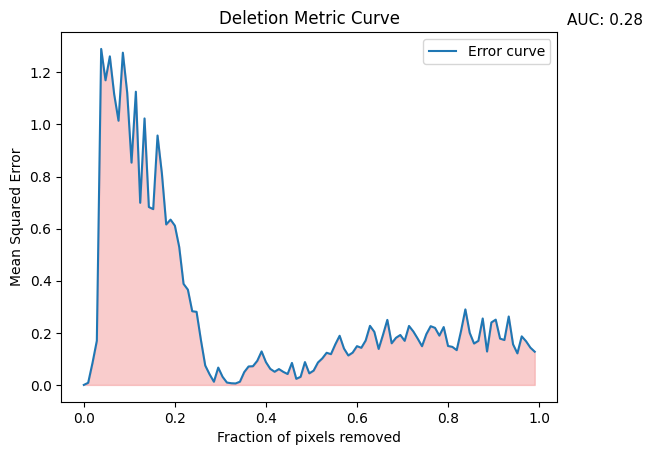

Errors: [0.0, 0.008103805, 0.08446891, 0.1695395, 1.2901499, 1.1697844, 1.2616496, 1.1159168, 1.0144088, 1.2757741, 1.1224172, 0.8535075, 1.1258839, 0.6992924, 1.0232861, 0.68307555, 0.6749989, 0.9577147, 0.8126388, 0.6161471, 0.6347345, 0.61145455, 0.5295211, 0.38799775, 0.3656355, 0.28294975, 0.2807218, 0.17291619, 0.07456598, 0.040934436, 0.012210456, 0.066567145, 0.031184142, 0.009157742, 0.0064564166, 0.0056419717, 0.012309716, 0.049325243, 0.07089243, 0.07178583, 0.09243576, 0.12866196, 0.08758749, 0.061702695, 0.05057248, 0.060848888, 0.050209053, 0.04183969, 0.08450168, 0.023368599, 0.031144494, 0.08765394, 0.044406865, 0.0549284, 0.086092226, 0.10183159, 0.123426765, 0.11811375, 0.15573977, 0.18876055, 0.1398, 0.11312396, 0.12399965, 0.1488778, 0.14254427, 0.17038693, 0.2269133, 0.20382194, 0.13817067, 0.19228788, 0.24977617, 0.15988885, 0.18096223, 0.1917653, 0.16925366, 0.22648494, 0.2051968, 0.17790908, 0.14863747, 0.19497536, 0.22551122, 0.21908967, 0.18934616, 0.22220017,

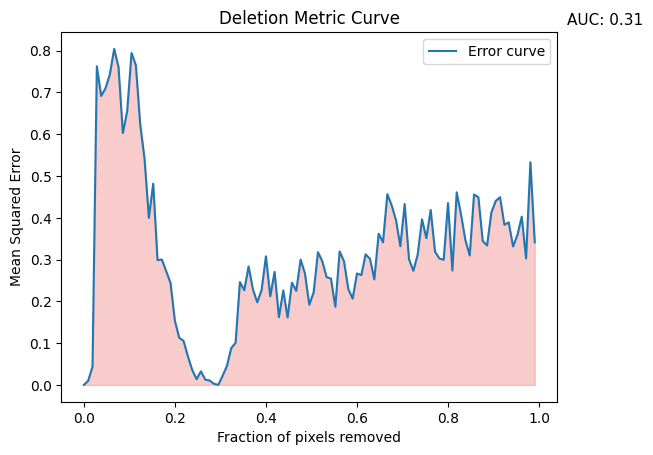

Errors: [0.0, 0.0099306265, 0.043560095, 0.76273006, 0.69155055, 0.7101618, 0.7430333, 0.8041618, 0.7606555, 0.6029, 0.6552423, 0.79442245, 0.76527876, 0.6237557, 0.5419032, 0.39987162, 0.4817773, 0.29869348, 0.3001041, 0.2720387, 0.24380787, 0.15342079, 0.11293427, 0.105482966, 0.06830864, 0.035853516, 0.013837098, 0.032623783, 0.012592885, 0.010660026, 0.0028415532, 1.3667609e-06, 0.021774586, 0.04537075, 0.088118844, 0.10084175, 0.2461775, 0.22664864, 0.28357786, 0.22865725, 0.1976701, 0.22715698, 0.30786803, 0.21211767, 0.27051523, 0.16212831, 0.22603025, 0.16144207, 0.24476136, 0.22510324, 0.30001596, 0.26668537, 0.19189087, 0.2214951, 0.31772715, 0.2960437, 0.25782764, 0.25449023, 0.18711174, 0.3194979, 0.29621243, 0.22946821, 0.20640013, 0.2667105, 0.2628715, 0.3127229, 0.30172998, 0.25253996, 0.3619235, 0.3412483, 0.4565735, 0.42990556, 0.394309, 0.3318938, 0.43309045, 0.3007311, 0.27326813, 0.3118239, 0.39644343, 0.35117933, 0.41873306, 0.31917098, 0.30265445, 0.29948717, 0.43

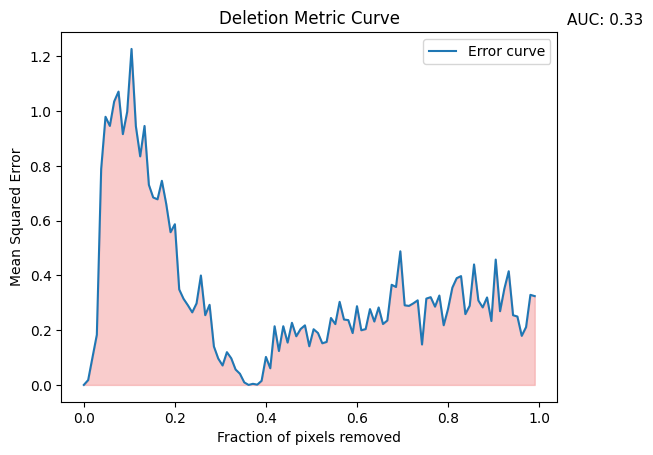

Errors: [0.0, 0.01771289, 0.10080753, 0.18305339, 0.78885233, 0.9796167, 0.9462313, 1.0355555, 1.0716234, 0.91622007, 0.9975787, 1.2275103, 0.9452603, 0.8349904, 0.9461112, 0.73104906, 0.6847848, 0.67806023, 0.7457778, 0.66145635, 0.5579374, 0.5870841, 0.34872052, 0.31455275, 0.29098874, 0.26505214, 0.2979425, 0.39975387, 0.25481638, 0.29270926, 0.1404466, 0.09638273, 0.07102746, 0.11969444, 0.09731501, 0.056339715, 0.04085816, 0.009283681, 3.805855e-06, 0.0040365267, 0.0009987106, 0.014927075, 0.10226999, 0.06079382, 0.2142941, 0.123719566, 0.21448134, 0.15468976, 0.2269429, 0.17777349, 0.20425321, 0.21766067, 0.14119053, 0.20343383, 0.1896923, 0.15211171, 0.15710904, 0.24459426, 0.22222327, 0.303553, 0.23889135, 0.23680641, 0.18941037, 0.28756228, 0.19968382, 0.20400044, 0.27696455, 0.23159334, 0.2829791, 0.22253115, 0.23526867, 0.36584604, 0.35776618, 0.48817205, 0.29082605, 0.2887078, 0.2980573, 0.30905262, 0.1477329, 0.3153443, 0.32056895, 0.28595307, 0.32656613, 0.21795575, 0.277

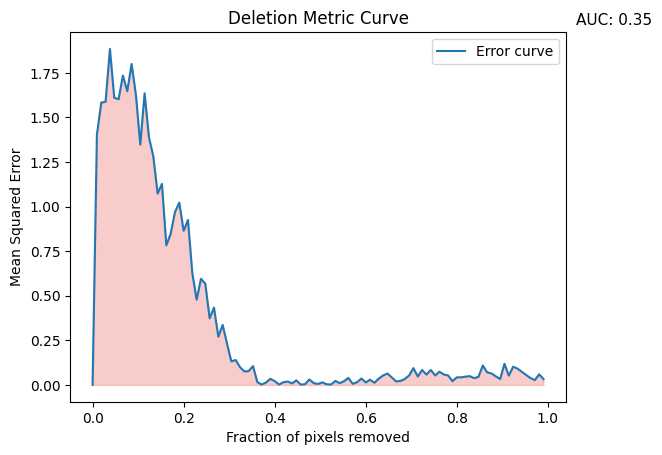

Errors: [0.0, 1.4041, 1.5830941, 1.5880055, 1.8841095, 1.6098366, 1.602223, 1.734451, 1.6468874, 1.7996595, 1.62512, 1.3477633, 1.6354417, 1.3885946, 1.2822964, 1.073201, 1.1273484, 0.782907, 0.8470133, 0.969296, 1.022096, 0.8644541, 0.9248572, 0.6264639, 0.4781768, 0.59514016, 0.5675242, 0.37327695, 0.43343192, 0.27061278, 0.33637834, 0.23248444, 0.13170992, 0.13961598, 0.09952913, 0.07585247, 0.07744501, 0.10538163, 0.015973251, 0.0018569574, 0.013395734, 0.034301747, 0.021512993, 0.002248495, 0.014917187, 0.019215213, 0.008516077, 0.025413467, 0.0020342174, 0.0037563357, 0.030505542, 0.010157019, 0.0054604854, 0.014354533, 0.0036982584, 0.0019319712, 0.02231628, 0.00998711, 0.02093676, 0.039348025, 0.006255096, 0.015476981, 0.035641585, 0.013903689, 0.029361313, 0.012184519, 0.035266418, 0.05309936, 0.06396387, 0.042215556, 0.019848766, 0.022226296, 0.033262122, 0.052679744, 0.09442218, 0.047178086, 0.0836595, 0.058025967, 0.08417505, 0.05307409, 0.07381119, 0.05873097, 0.053301208,

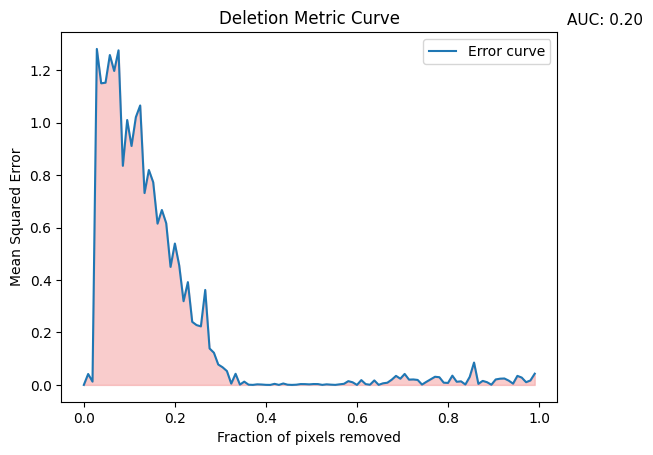

Errors: [0.0, 0.04170403, 0.012593995, 1.2814741, 1.1503758, 1.1526744, 1.258238, 1.1974005, 1.2761326, 0.8356508, 1.0103472, 0.9113615, 1.0213641, 1.0659076, 0.73181003, 0.8197302, 0.77305573, 0.61510646, 0.66718835, 0.616768, 0.45016918, 0.5392935, 0.45574823, 0.31925592, 0.39201698, 0.24050018, 0.22823453, 0.22332484, 0.36223337, 0.13911702, 0.12279401, 0.07785939, 0.06739683, 0.05294142, 0.0050161947, 0.04250153, 0.0011270643, 0.01256092, 0.00090079237, 0.00013348534, 0.0022508414, 0.0015501659, 0.0003043269, 7.748774e-05, 0.0041169324, 8.653867e-05, 0.0054606264, 0.0008180883, 8.826497e-05, 0.0008120915, 0.0032045287, 0.0030417168, 0.002123492, 0.003367814, 0.0031904539, 0.00019439608, 0.0022557813, 0.0010116932, 0.00018601834, 0.0023056348, 0.0042353193, 0.014444381, 0.010011273, 1.513471e-05, 0.018396875, 0.0031180407, 0.0007220873, 0.017207125, 0.00026900234, 0.006133653, 0.0083992, 0.019795345, 0.034518566, 0.023768824, 0.04192498, 0.02023257, 0.020909773, 0.018981574, 0.00133

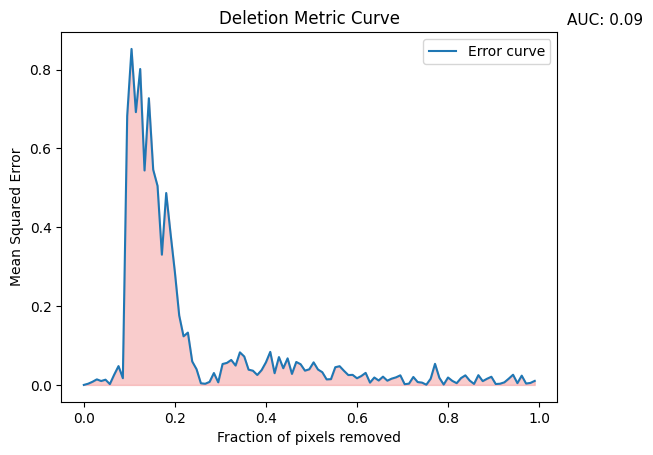

Errors: [0.0, 0.0030547548, 0.00799562, 0.014120242, 0.0099093495, 0.013301375, 0.0020815076, 0.025946671, 0.047762368, 0.01706755, 0.68252236, 0.8525327, 0.6921492, 0.8016277, 0.5441158, 0.7274791, 0.54612535, 0.505042, 0.3305047, 0.486948, 0.38434678, 0.28627855, 0.17598374, 0.1233797, 0.1327294, 0.05953016, 0.039773416, 0.004156342, 0.0029346228, 0.0077124666, 0.030185597, 0.0065704323, 0.05309601, 0.055873014, 0.063378476, 0.04912595, 0.0826394, 0.0720681, 0.03868905, 0.036096986, 0.025267595, 0.037545238, 0.057304185, 0.083815284, 0.029751875, 0.07066754, 0.042362887, 0.06744914, 0.027964361, 0.058249734, 0.0525036, 0.036212068, 0.039598297, 0.057275392, 0.039147023, 0.03229698, 0.014040539, 0.0146683445, 0.04489754, 0.047511708, 0.03583501, 0.025053639, 0.025522096, 0.016918445, 0.022582214, 0.030596973, 0.0058595934, 0.018803924, 0.011214316, 0.020965125, 0.010745332, 0.015917916, 0.019226236, 0.024353825, 0.0018800788, 0.0032467763, 0.020234859, 0.0072029037, 0.0058738007, 0.00

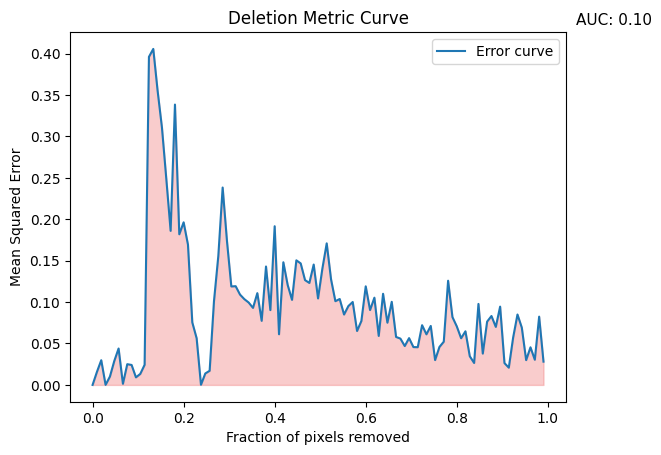

Errors: [0.0, 0.015647396, 0.02982574, 5.3956333e-05, 0.010092899, 0.028786732, 0.043961998, 0.0013442015, 0.025038349, 0.024103234, 0.009163144, 0.013279126, 0.02426563, 0.39600745, 0.405578, 0.35496882, 0.31065655, 0.2489746, 0.18596312, 0.33841333, 0.18182626, 0.19627231, 0.16930923, 0.07542086, 0.0563469, 0.00017223283, 0.013828728, 0.017078001, 0.10104245, 0.1556241, 0.23827821, 0.17348523, 0.11886793, 0.11917411, 0.10907409, 0.10356885, 0.0994487, 0.09298967, 0.110787004, 0.07736889, 0.14294904, 0.09031245, 0.19155544, 0.061143655, 0.14804046, 0.12059008, 0.10266468, 0.1503861, 0.14669129, 0.1265085, 0.123096086, 0.14532273, 0.10441516, 0.14038053, 0.17086773, 0.12748185, 0.10106837, 0.10372901, 0.084966846, 0.095208034, 0.100108236, 0.065103754, 0.077186964, 0.11898727, 0.09039333, 0.10530456, 0.059153084, 0.11001289, 0.07509239, 0.100302726, 0.057918217, 0.055909455, 0.046938155, 0.05648641, 0.045684427, 0.045534577, 0.072089195, 0.06107567, 0.07119693, 0.02999624, 0.045791097,

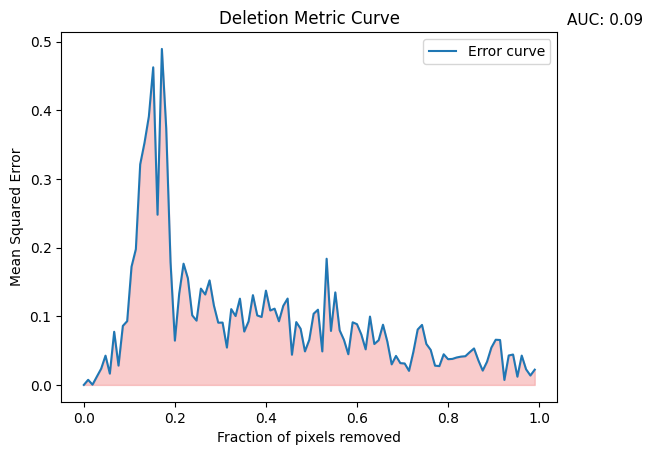

Errors: [0.0, 0.0074414494, 0.00034081252, 0.012072652, 0.02364863, 0.04261292, 0.016425734, 0.07740587, 0.02811856, 0.08593434, 0.0928898, 0.1721227, 0.19762404, 0.32114348, 0.35280702, 0.39095452, 0.46248934, 0.24783564, 0.48925, 0.3739541, 0.17861547, 0.06451239, 0.13297507, 0.1765364, 0.15525964, 0.101334535, 0.09360127, 0.1402268, 0.13167475, 0.1522349, 0.11566553, 0.09062727, 0.09079537, 0.054417808, 0.110375844, 0.10030447, 0.12563437, 0.07771805, 0.09259951, 0.13076042, 0.10117311, 0.09893543, 0.13731669, 0.108387105, 0.111051224, 0.092706226, 0.11517775, 0.12576462, 0.043973137, 0.09150117, 0.08180862, 0.048834182, 0.06568888, 0.10362821, 0.10954287, 0.048815746, 0.18376113, 0.07861883, 0.13472049, 0.07956808, 0.06555113, 0.044680245, 0.09120813, 0.088464595, 0.073517695, 0.05181065, 0.0995089, 0.059559107, 0.06511221, 0.0876628, 0.06316849, 0.029959647, 0.042243753, 0.03171657, 0.031236392, 0.020494953, 0.047896504, 0.080661945, 0.08740068, 0.059632413, 0.051034417, 0.0280420

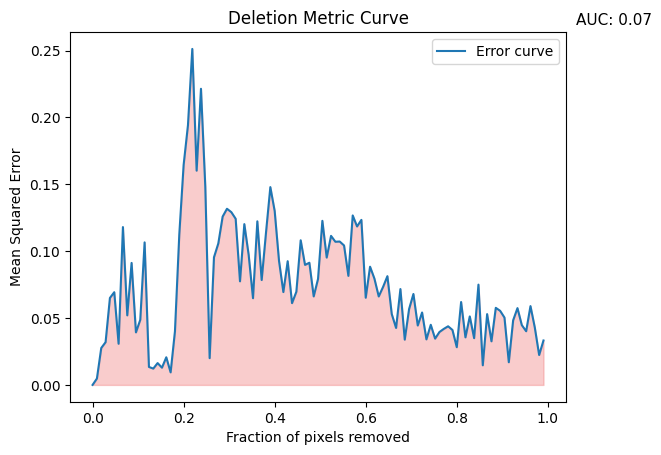

Errors: [0.0, 0.004776576, 0.027597455, 0.03196546, 0.06501716, 0.06932443, 0.030778905, 0.11802539, 0.05201331, 0.091227084, 0.039281048, 0.048665717, 0.106579654, 0.013440917, 0.012211418, 0.01632988, 0.012897733, 0.020666799, 0.0093847625, 0.040111914, 0.1125205, 0.16449706, 0.19421029, 0.2512269, 0.16020738, 0.22142863, 0.14810903, 0.020018235, 0.09543029, 0.10578723, 0.12586612, 0.13171528, 0.12918793, 0.12424328, 0.07746153, 0.12023095, 0.09722865, 0.06482944, 0.122334056, 0.078427956, 0.11390414, 0.14790455, 0.13006167, 0.09278003, 0.069431856, 0.0925116, 0.061144892, 0.06967422, 0.10814705, 0.0897387, 0.09134895, 0.06616616, 0.07924949, 0.12269123, 0.095225945, 0.11144414, 0.107049465, 0.107215874, 0.10427557, 0.08154285, 0.1267312, 0.11848748, 0.1234065, 0.06519449, 0.08839033, 0.079530895, 0.06615212, 0.07326296, 0.0813147, 0.05301726, 0.04259128, 0.07168353, 0.033862762, 0.05669598, 0.06800116, 0.04443186, 0.05414926, 0.0340576, 0.044965893, 0.03462518, 0.03955077, 0.0418804

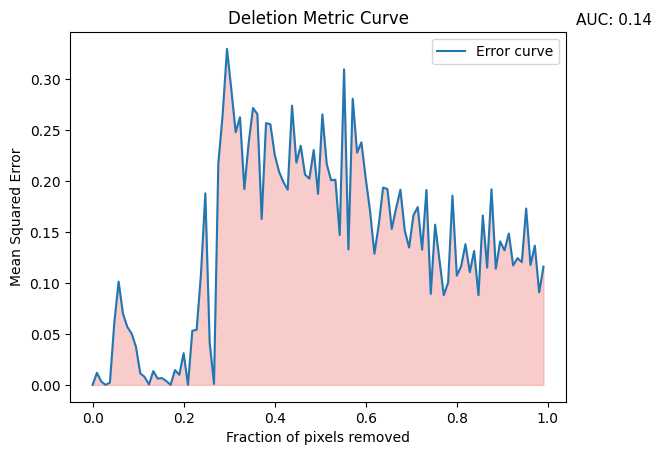

Errors: [0.0, 0.011928325, 0.00330587, 7.3240017e-06, 0.002340603, 0.0604921, 0.10126762, 0.069991894, 0.056892827, 0.050410874, 0.037385497, 0.011311972, 0.0078001725, 0.00041131844, 0.013543772, 0.006239389, 0.0067107882, 0.003798552, 9.396054e-05, 0.014573743, 0.009917522, 0.031121647, 9.776593e-05, 0.053106636, 0.054128345, 0.10883296, 0.18782508, 0.04192868, 0.00096131343, 0.2170642, 0.26508522, 0.32929736, 0.2893991, 0.24764493, 0.26235133, 0.19201213, 0.23742682, 0.27143934, 0.26550993, 0.16263415, 0.25652668, 0.25549105, 0.22583243, 0.2090852, 0.19886415, 0.19137616, 0.27363962, 0.2178793, 0.2344385, 0.2061115, 0.20216963, 0.23019585, 0.18729602, 0.26506448, 0.21663803, 0.20059417, 0.20111598, 0.14693786, 0.30933726, 0.13274133, 0.2805819, 0.22767784, 0.23776402, 0.20221025, 0.17032415, 0.12856337, 0.15705332, 0.1933956, 0.19204682, 0.15292242, 0.17318845, 0.19128355, 0.15136789, 0.13468711, 0.16628894, 0.17431208, 0.13257957, 0.19107746, 0.089287885, 0.15705758, 0.1225435, 0.0

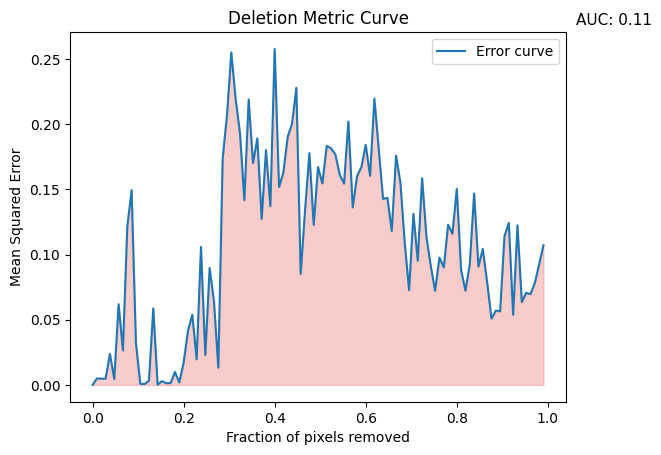

Errors: [0.0, 0.0049846005, 0.004780952, 0.004788728, 0.023788685, 0.004522532, 0.061903328, 0.026423404, 0.121125735, 0.14934862, 0.032091152, 0.0008352908, 0.0006494249, 0.0032642023, 0.058623407, 0.00020025269, 0.002908562, 0.0013168812, 0.0014621734, 0.009947122, 0.001909011, 0.017089952, 0.041592278, 0.053831603, 0.019630106, 0.10577058, 0.022908317, 0.08968525, 0.06399019, 0.013216065, 0.17346767, 0.20706035, 0.2549776, 0.21907097, 0.19286616, 0.14167081, 0.21888153, 0.17013124, 0.18906526, 0.12732123, 0.18009576, 0.13707283, 0.25763416, 0.15172309, 0.16272223, 0.19017775, 0.2002587, 0.22784543, 0.08508253, 0.13376388, 0.17773367, 0.1226878, 0.16705844, 0.15450706, 0.18329951, 0.18137586, 0.17669709, 0.16118711, 0.15436913, 0.20198019, 0.13611671, 0.16012064, 0.16704305, 0.1840379, 0.16031203, 0.21960007, 0.18088745, 0.14258416, 0.14347976, 0.11806156, 0.1758105, 0.15501152, 0.10870177, 0.07268633, 0.13117866, 0.09525159, 0.15856364, 0.11346639, 0.091194846, 0.07218986, 0.0976523

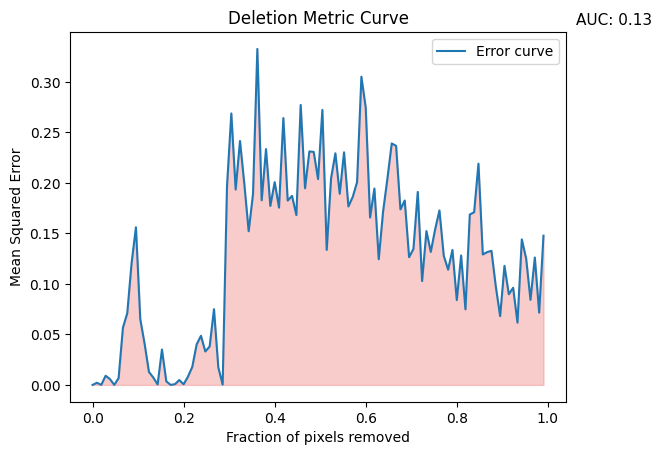

Errors: [0.0, 0.0021645953, 2.3985556e-05, 0.00908244, 0.0057951966, 3.46954e-05, 0.0067078248, 0.0567147, 0.07109484, 0.12078939, 0.15602806, 0.06509096, 0.040675968, 0.012872719, 0.0073160864, 0.00044439352, 0.03503243, 0.0036018137, 6.509399e-07, 0.0007450476, 0.00484023, 0.0006005456, 0.008242987, 0.01793295, 0.04009351, 0.04862987, 0.033088855, 0.038067386, 0.07496488, 0.017318951, 0.0003235219, 0.19653094, 0.2686844, 0.19338141, 0.24142098, 0.1989101, 0.15211052, 0.18892282, 0.33252814, 0.18271822, 0.23338626, 0.17716496, 0.20069848, 0.17548034, 0.26410845, 0.18244219, 0.18710299, 0.16811779, 0.2770762, 0.19465438, 0.23107839, 0.23063327, 0.20372732, 0.2721586, 0.13365296, 0.20433234, 0.22923702, 0.18917805, 0.2302303, 0.17662531, 0.1860953, 0.20062959, 0.3049988, 0.27437708, 0.16571692, 0.19432113, 0.124404624, 0.17147675, 0.20419964, 0.23899423, 0.23658888, 0.17376, 0.18252677, 0.12644048, 0.13458613, 0.19102778, 0.102787875, 0.15225607, 0.13163714, 0.15382712, 0.17266993, 0.12

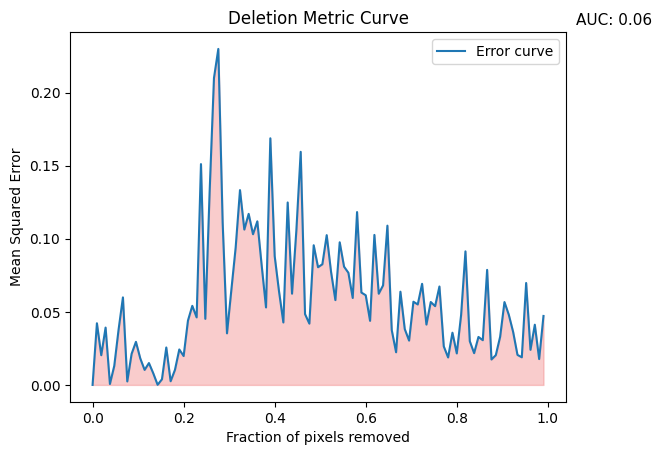

Errors: [0.0, 0.042172655, 0.020326244, 0.039215725, 0.00064500776, 0.013008661, 0.037910562, 0.05987111, 0.002387464, 0.02125432, 0.029468754, 0.018141296, 0.010273721, 0.014963829, 0.007927864, 7.80091e-05, 0.0038565497, 0.02560202, 0.002520601, 0.010304411, 0.02425681, 0.019758705, 0.044023544, 0.0540869, 0.04619492, 0.15103371, 0.0451946, 0.13215663, 0.20994836, 0.22980723, 0.1110848, 0.035289783, 0.06476656, 0.09392582, 0.13324463, 0.10625636, 0.11699793, 0.10306495, 0.11190565, 0.08174259, 0.05300598, 0.16867833, 0.08810614, 0.064000115, 0.04272389, 0.12479434, 0.06240488, 0.10556781, 0.15943234, 0.048434455, 0.041923515, 0.095531, 0.08050074, 0.0825419, 0.10243631, 0.07737735, 0.05801537, 0.09755257, 0.08089176, 0.076709226, 0.05948006, 0.118231565, 0.06318886, 0.06133151, 0.043837402, 0.10260071, 0.062381234, 0.06809237, 0.10893225, 0.03751771, 0.02234188, 0.06376865, 0.03822163, 0.030314477, 0.056903377, 0.055042926, 0.06913882, 0.041290037, 0.056712385, 0.0538718, 0.06731499,

In [ ]:
# DELETION, starting from the original instance and progressively removing the most important frames!

# Statistics for deletion with elements of the form: [frames, auc]
temporal_deletion_stats_vott_norm_all_lstm = []

models = vott_lstm_models_loaded

for i, top_frames_i in enumerate(vott_norm_all_istances_important_frames):
  print(f"Deletion of 21 top frames for Instance number {i} ")  # Note: "Errors" here is misleading; it refers to all frames.
  nr_instance = i
  errors, auc = get_errors_from_deletion(vottignasco_test_image, vottingasco_test_OHE, nr_instance, top_frames_i, models)
  temporal_deletion_stats_vott_norm_all_lstm.append(np.array([errors, auc], dtype=object))
  print(f"Errors: {errors}")
  print(f"AUC: {auc}")
  print("#############################################################", "\n")


Mean Errors for Nr of Pixel Removed, Vottignasco: 
 [0.         0.06443477 0.10296772 0.20499313 0.29608282 0.33879803
 0.38401278 0.40736084 0.41034752 0.42922965 0.40888606 0.40516811
 0.38090395 0.38400538 0.35587322 0.34573541 0.32419246 0.30339504
 0.28804465 0.27248885 0.23971406 0.22846127 0.21403045 0.20490635
 0.19141351 0.18963044 0.1921701  0.1925301  0.19289753 0.18510525
 0.18003479 0.18485225 0.17895448 0.19479964 0.1881454  0.19207758
 0.19678623 0.20372437 0.20186782 0.22498211 0.22534002 0.24233789
 0.25614237 0.26682375 0.29120576 0.32850463 0.33669646 0.3646275
 0.39149984 0.430781   0.45171583 0.49402567 0.51031524 0.56800644
 0.57699749 0.61225452 0.61173878 0.62638915 0.61692118 0.65089964
 0.65742403 0.65236772 0.66633017 0.66432982 0.66446854 0.66490515
 0.67046687 0.67475526 0.68660942 0.68521895 0.68861757 0.69970011
 0.68304438 0.70576892 0.6915613  0.68497747 0.70410749 0.69202714
 0.69982657 0.69730248 0.68926249 0.69274817 0.69098426 0.70979568
 0.69558293

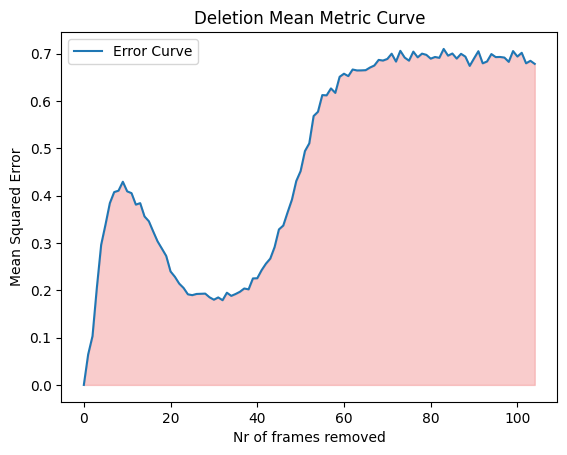

In [ ]:
# Mean errors for Deletion

# Extract only the frame data for deletion statistics
only_errors_deletion_vott_norm = [errors for errors, _ in temporal_deletion_stats_vott_norm_all_lstm]

# Calculate the mean of the frame statistics
tempora_mean_errors_for_deletion_vott = np.mean(only_errors_deletion_vott_norm, axis=0)
print("Mean Errors for Number of Frames Removed, Vottignasco: \n", tempora_mean_errors_for_deletion_vott)

# Plot the error curve and area under the curve (AUC)
x = np.arange(0, 105)
plt.plot(x, tempora_mean_errors_for_deletion_vott, label='Error Curve')  # Note: "Error Curve" refers to the mean squared error for removed frames.
plt.fill_between(x, tempora_mean_errors_for_deletion_vott, color='lightcoral', alpha=0.4)
plt.xlabel('Number of frames removed')
plt.ylabel('Mean Squared Error')
plt.title('Deletion Mean Metric Curve')
plt.legend()
plt.show()
